In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import glob
import pickle
from Bio.Seq import Seq
from matplotlib import cm
import matplotlib.pyplot as plt
from matplotlib import collections  as mc
from scipy.special import expit
from scipy.stats import percentileofscore
import torch
from collections import defaultdict
from Bio.Seq import Seq
from Bio.SeqUtils.ProtParam import ProteinAnalysis
from gctree.utils import hamming_distance

# DMS data

Single mutant scores

In [2]:
dms_df = pd.read_csv("https://media.githubusercontent.com/media/jbloomlab/Ab-CGGnaive_DMS/main/results/final_variant_scores/final_variant_scores.csv", index_col="mutation", dtype=dict(position_IMGT=pd.Int16Dtype()))
# remove linker sites
dms_df = dms_df[dms_df.chain != "link"]
# add indicator for wildtype data
dms_df["WT"] = dms_df.wildtype == dms_df.mutant
assert dms_df.position_IMGT.max() < 1000
dms_df["site"] = [f"{chain}-{str(pos).zfill(3)}" for chain, pos in zip(dms_df.chain, dms_df.position_IMGT)]
dms_df

,target,wildtype,position,position_IMGT,chain,mutant,codon,single_nt,bind,delta_bind,...,expr,delta_expr,n_bc_expr,n_libs_expr,psr,delta_psr,n_bc_psr,n_libs_psr,WT,site
mutation,,,,,,,,,,,,,,,,,,,,,
E1(H)A,CGG_naive,E,1,1,H,A,GAG,True,10.48829,0.03110,...,10.44614,-0.00453,19.0,2.0,6.78608,-0.07452,17.0,2.0,False,H-001
E1(H)C,CGG_naive,E,1,1,H,C,GAG,False,10.44477,-0.01243,...,10.32364,-0.12703,20.0,2.0,7.44234,0.58174,17.0,2.0,False,H-001
E1(H)D,CGG_naive,E,1,1,H,D,GAG,True,10.42771,-0.02948,...,10.51618,0.06551,16.0,2.0,6.95940,0.09880,13.0,2.0,False,H-001
E1(H)E,CGG_naive,E,1,1,H,E,GAG,True,10.45719,0.00000,...,10.45067,0.00000,21170.0,2.0,6.86060,0.00000,18910.0,2.0,True,H-001
E1(H)F,CGG_naive,E,1,1,H,F,GAG,False,10.51899,0.06180,...,10.33163,-0.11904,24.0,2.0,6.91372,0.05313,21.0,2.0,False,H-001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
R124(L)S,CGG_naive,R,235,124,L,S,CGT,True,10.44756,-0.00963,...,10.54313,0.09246,39.0,2.0,6.93925,0.07866,33.0,2.0,False,L-124
R124(L)T,CGG_naive,R,235,124,L,T,CGT,False,10.43023,-0.02696,...,10.53860,0.08793,36.0,2.0,6.88956,0.02896,34.0,2.0,False,L-124
R124(L)V,CGG_naive,R,235,124,L,V,CGT,False,10.38231,-0.07488,...,10.48707,0.03640,27.0,2.0,6.78160,-0.07899,24.0,2.0,False,L-124


## Position maps for scFv

In [3]:
pos_df = pd.read_csv("https://raw.githubusercontent.com/jbloomlab/Ab-CGGnaive_DMS/main/data/CGGnaive_sites.csv", dtype=dict(site=pd.Int16Dtype()), index_col="site_scFv")
pos_df

,amino_acid,chain,site,KI_codon
site_scFv,,,,
1,E,H,1,GAG
2,V,H,2,GTG
3,Q,H,3,CAG
4,L,H,4,CTT
5,Q,H,5,CAG
...,...,...,...,...
231,L,L,120,CTA
232,E,L,121,GAA
233,I,L,122,ATA


In [4]:
pos_df[(pos_df.chain=="L")]

,amino_acid,chain,site,KI_codon
site_scFv,,,,
128,D,L,1,GAC
129,I,L,2,ATT
130,V,L,3,GTG
131,M,L,4,ATG
132,T,L,5,ACT
...,...,...,...,...
231,L,L,120,CTA
232,E,L,121,GAA
233,I,L,122,ATA


### Add CDR/FWR annotations from IMGT VQUEST

In [5]:
pos_df.loc[(pos_df.chain == "H") & (pos_df.site <= 26), "region"] = "FR1"
pos_df.loc[(pos_df.chain == "H") & (27 <= pos_df.site) & (pos_df.site <= 38), "region"] = "CDR1"
pos_df.loc[(pos_df.chain == "H") & (39 <= pos_df.site) & (pos_df.site <= 55), "region"] = "FR2"
pos_df.loc[(pos_df.chain == "H") & (56 <= pos_df.site) & (pos_df.site <= 65), "region"] = "CDR2"
pos_df.loc[(pos_df.chain == "H") & (66 <= pos_df.site) & (pos_df.site <= 104), "region"] = "FR3"
pos_df.loc[(pos_df.chain == "H") & (105 <= pos_df.site) & (pos_df.site <= 110), "region"] = "CDR3"
pos_df.loc[(pos_df.chain == "H") & (111 <= pos_df.site), "region"] = "FR4"

pos_df.loc[(pos_df.chain == "L") & (pos_df.site <= 26), "region"] = "FR1"
pos_df.loc[(pos_df.chain == "L") & (27 <= pos_df.site) & (pos_df.site <= 38), "region"] = "CDR1"
pos_df.loc[(pos_df.chain == "L") & (39 <= pos_df.site) & (pos_df.site <= 55), "region"] = "FR2"
pos_df.loc[(pos_df.chain == "L") & (56 <= pos_df.site) & (pos_df.site <= 65), "region"] = "CDR2"
pos_df.loc[(pos_df.chain == "L") & (66 <= pos_df.site) & (pos_df.site <= 104), "region"] = "FR3"
pos_df.loc[(pos_df.chain == "L") & (105 <= pos_df.site) & (pos_df.site <= 113), "region"] = "CDR3"
pos_df.loc[(pos_df.chain == "L") & (114 <= pos_df.site) & (pos_df.site <= 123), "region"] = "FR4"

pos_df.to_csv("output/CGGnaive_sites_annotated.csv")
pos_df

,amino_acid,chain,site,KI_codon,region
site_scFv,,,,,
1,E,H,1,GAG,FR1
2,V,H,2,GTG,FR1
3,Q,H,3,CAG,FR1
4,L,H,4,CTT,FR1
5,Q,H,5,CAG,FR1
...,...,...,...,...,...
231,L,L,120,CTA,FR4
232,E,L,121,GAA,FR4
233,I,L,122,ATA,FR4


In [6]:
igh_pos_map = pos_df.loc[pos_df.chain == "H", "site"].reset_index(drop=True)
igk_pos_map = pos_df.loc[pos_df.chain == "L", "site"].reset_index(drop=True)

## Heatmaps indicating inaccessible first-step mutations

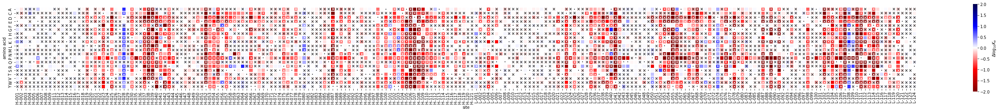

In [7]:
bind_df = dms_df.pivot(index="mutant", columns="site", values="delta_bind")

accessible_df = dms_df.pivot(index="mutant", columns="site", values="single_nt")
wt_df = dms_df.pivot(index="mutant", columns="site", values="WT")

annot = pd.DataFrame(np.empty_like(bind_df, dtype=str), index=bind_df.index, columns=bind_df.columns)
annot.iloc[wt_df.values.astype(bool)] = "\u00B7"
annot.iloc[~accessible_df.values.astype(bool)] = "\u00D7"

vmax = 2
vmin = -2

plt.figure(figsize=(50, 4))
sns.heatmap(bind_df, center=0, vmin=vmin, vmax=vmax, annot=annot, fmt="", annot_kws=dict(fontweight="bold"),
            cmap="seismic_r", cbar_kws=dict(label=r"$\Delta\log_{10} K_a$"), linewidths=.1, square=True)
plt.xlabel("site")
plt.ylabel("amino acid")
plt.savefig("output/plots/bind_heatmap.pdf")
plt.show()

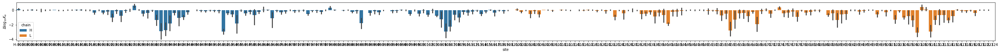

In [8]:
plt.figure(figsize=(50, 2))
sns.barplot(data=dms_df[(~dms_df.WT) & dms_df.single_nt], x="site", y="delta_bind", hue="chain", dodge=False)
plt.ylabel(r"$\Delta\log_{10} K_a$")
plt.savefig("output/plots/bind_boxplot.pdf")
plt.show()

In [9]:
pa = ProteinAnalysis("".join(pos_df.amino_acid))

gravy_naive = pa.gravy()
charge_naive = pa.charge_at_pH(7.4)
weight_naive = pa.molecular_weight()
aromaticity_naive = pa.aromaticity()

for row_idx, row in dms_df.iterrows():
    aa_seq = pos_df.amino_acid.copy()
    assert aa_seq.loc[row.position] == row.wildtype
    aa_seq.loc[row.position] = row.mutant
    pa = ProteinAnalysis("".join(aa_seq))
    dms_df.loc[row_idx, "delta_hydrophobicity"] = pa.gravy() - gravy_naive
    dms_df.loc[row_idx, "delta_charge"] = pa.charge_at_pH(7.4) - charge_naive
    dms_df.loc[row_idx, "delta_weight"] = pa.molecular_weight() - weight_naive
    dms_df.loc[row_idx, "delta_aromaticity"] = pa.aromaticity() - aromaticity_naive
    region = pos_df.region[(pos_df.chain == dms_df.loc[row_idx, "chain"]) & (pos_df.site == dms_df.loc[row_idx, "position_IMGT"])]
    assert len(region) == 1
    dms_df.loc[row_idx, "region"] = region.values[0]
dms_df["region type"] = dms_df.region.str[:-1]

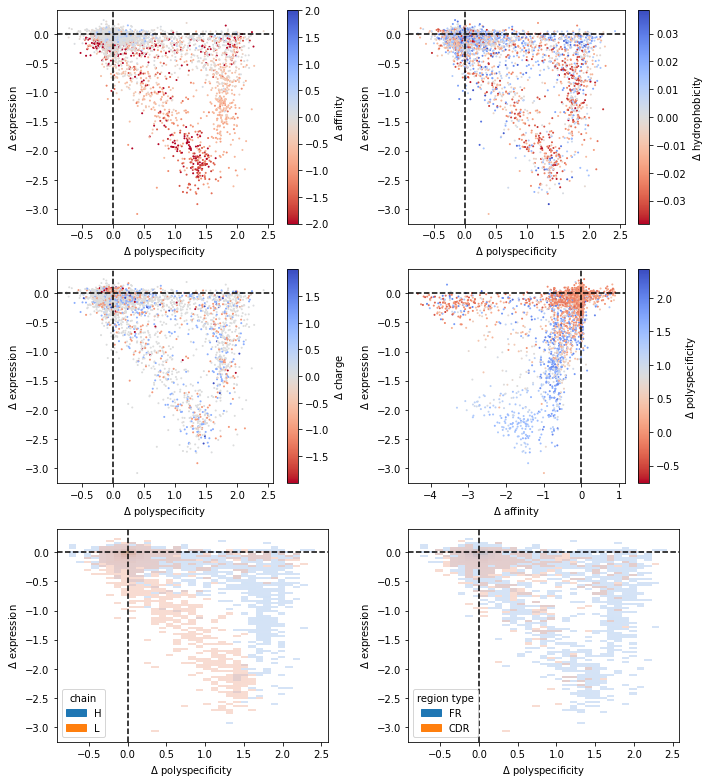

In [10]:
plt.figure(figsize=(10, 11))

plt.subplot(3, 2, 1)
order = np.argsort(dms_df.delta_bind)
plt.scatter(dms_df.delta_psr.iloc[order], dms_df.delta_expr.iloc[order], c=dms_df.delta_bind.iloc[order], s=1, cmap="coolwarm_r", vmin=vmin, vmax=vmax)
plt.axvline(0, ls="--", c="k")
plt.axhline(0, ls="--", c="k")
plt.xlabel(r"$\Delta$ polyspecificity")
plt.ylabel(r"$\Delta$ expression")
plt.colorbar(label=r"$\Delta$ affinity")

plt.subplot(3, 2, 2)
plt.scatter(dms_df.delta_psr, dms_df.delta_expr, c=dms_df.delta_hydrophobicity, s=1, cmap="coolwarm_r")#, vmin=-0.04, vmax=0.04)
plt.axvline(0, ls="--", c="k")
plt.axhline(0, ls="--", c="k")
plt.xlabel(r"$\Delta$ polyspecificity")
plt.ylabel(r"$\Delta$ expression")
plt.colorbar(label=r"$\Delta$ hydrophobicity")

plt.subplot(3, 2, 3)
plt.scatter(dms_df.delta_psr, dms_df.delta_expr, c=dms_df.delta_charge, s=1, cmap="coolwarm_r")#, vmin=-2, vmax=2)
plt.axvline(0, ls="--", c="k")
plt.axhline(0, ls="--", c="k")
plt.xlabel(r"$\Delta$ polyspecificity")
plt.ylabel(r"$\Delta$ expression")
plt.colorbar(label=r"$\Delta$ charge")

plt.subplot(3, 2, 4)
plt.scatter(dms_df.delta_bind, dms_df.delta_expr, c=dms_df.delta_psr, s=1, cmap="coolwarm_r")#, vmin=-2, vmax=2)
plt.axvline(0, ls="--", c="k")
plt.axhline(0, ls="--", c="k")
plt.xlabel(r"$\Delta$ affinity")
plt.ylabel(r"$\Delta$ expression")
plt.colorbar(label=r"$\Delta$ polyspecificity")

plt.subplot(3, 2, 5)
sns.histplot(data=dms_df, x="delta_psr", y="delta_expr", hue="chain", alpha=0.5)
plt.axvline(0, ls="--", c="k")
plt.axhline(0, ls="--", c="k")
plt.xlabel(r"$\Delta$ polyspecificity")
plt.ylabel(r"$\Delta$ expression")

plt.subplot(3, 2, 6)
sns.histplot(data=dms_df, x="delta_psr", y="delta_expr", hue="region type", alpha=0.5)
plt.axvline(0, ls="--", c="k")
plt.axhline(0, ls="--", c="k")
plt.xlabel(r"$\Delta$ polyspecificity")
plt.ylabel(r"$\Delta$ expression")


plt.tight_layout()
plt.savefig("output/plots/3Dscatter.pdf")
plt.show()

### sitewise correlations between AA props and phenotypes?

In [11]:
from scipy.stats import linregress

dat = []
for position, group in dms_df.groupby("position"):
    for phenotype in ("delta_bind", "delta_expr", "delta_psr"):
        for aaproperty in ("delta_hydrophobicity", "delta_charge", "delta_weight", "delta_aromaticity"):
            linreg = linregress(group[phenotype], group[aaproperty])
            if linreg.pvalue < 1e-2:
                dat.append([position, pos_df.region[position], phenotype, aaproperty, linreg.slope, linreg.rvalue, -np.log10(linreg.pvalue)])

cor_df = pd.DataFrame(dat, columns=["position", "region", "phenotype", "aa_property", "slope", "correlation", r"$-\log_{10}p$"])

cor_df

,position,region,phenotype,aa_property,slope,correlation,$-\log_{10}p$
0,1,FR1,delta_bind,delta_charge,2.658400,0.789855,4.463537
1,2,FR1,delta_bind,delta_aromaticity,-0.005772,-0.703880,3.273073
2,2,FR1,delta_psr,delta_charge,-0.755128,-0.730699,3.596707
3,4,FR1,delta_expr,delta_hydrophobicity,0.091673,0.846990,5.607145
4,4,FR1,delta_psr,delta_hydrophobicity,-0.016783,-0.822314,5.064171
...,...,...,...,...,...,...,...
278,231,FR4,delta_expr,delta_hydrophobicity,0.015052,0.866435,6.106070
279,231,FR4,delta_psr,delta_hydrophobicity,-0.019995,-0.918190,7.937347
280,233,FR4,delta_expr,delta_charge,-4.736302,-0.612142,2.384986
281,234,FR4,delta_expr,delta_weight,-234.202968,-0.726722,3.546404


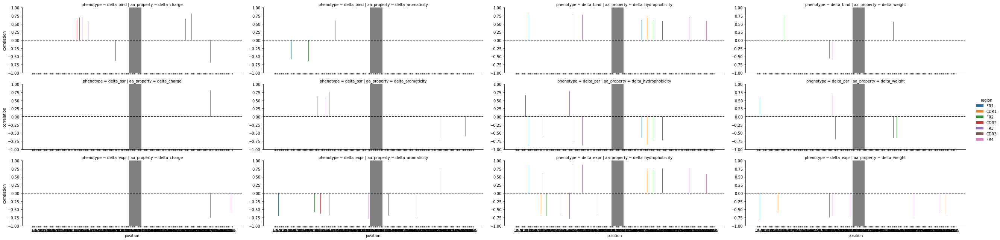

In [12]:
g = sns.catplot(data=cor_df, kind="bar", row="phenotype", col="aa_property", sharey=False,
                x="position", y="correlation", hue="region",
                order=pos_df.index,
                height=3, aspect=3)
g.set(ylim=(-1, 1))

linker_sites = pos_df.loc[pos_df.chain == "link"].index

for ax in g.axes.flatten():
    ax.axhline(0, ls='--', c="k")
    ax.axvspan(linker_sites[0], linker_sites[-1], color="grey")

# Replay tree data

In [13]:
date = "2022-03-22"

def gc_key(file):
    PR_str = file.split("/")[-2].split("-")
    return int(PR_str[1]), int(PR_str[3])

files = sorted(glob.glob(f"../nextflow/results/{date}/gctrees/PR*/gctree.p"), key=gc_key)
trees = {"_".join(f"{x}{y}" for x, y in zip(("mouse", "GC"), gc_key(file))): pickle.load(open(file, "rb"))
         for file in files}

print(f"loaded {len(trees)} GC trees")

loaded 74 GC trees


In [14]:
igh_frame = 1
igk_frame = 1
igk_idx = 336

In [15]:
τ = 1
τ0 = 0.1

In [16]:
def aa(seq, frame):
    return Seq(seq[(frame - 1) : (frame - 1 + (3 * ((len(seq) - (frame - 1)) // 3)))]).translate()

def mutations(naive_aa, aa, pos_map, chain_annotation):
    return [f"{aa1}{pos_map[pos]}{chain_annotation}{aa2}"
            for pos, (aa1, aa2) in enumerate(zip(naive_aa, aa))
            if aa1 != aa2]

def tree_nt_seq_to_dms_aa_seq(sequence):

    igh_aa = aa(sequence[:igk_idx], igh_frame)
    igk_aa = aa(sequence[igk_idx:], igk_frame)

    aa_dms = pos_df.amino_acid.copy()
    aa_dms.iloc[pos_df.chain == "H"] = igh_aa
    # note: replay light chains are shorter than dms seq by one aa
    aa_dms.iloc[(pos_df.chain == "L") & (pos_df.index < pos_df.index[-1])] = igk_aa
    
    return "".join(aa_dms)

In [17]:
tdms_model = torch.load("data/mse.model")
tdms_model.eval()

FileNotFoundError: [Errno 2] No such file or directory: 'data/mse.model'

In [92]:
# Using this as a hack for now to deal with tdms bias problem
tdms_prediction_naive = tdms_model(tdms_model.seq_to_binary(tree_nt_seq_to_dms_aa_seq(trees[next(iter(trees))].tree.sequence))).detach()
tdms_prediction_naive

tensor([-0.1611,  0.2952])

In [93]:
# trees_df = pd.DataFrame()

for gc, tree in trees.items():
    
    # rename tuple names with last element of tuple (possible danger)
    if isinstance(tree.tree.name, tuple):
        tree.tree.name = tree.tree.name[-1]
    
    tree.local_branching(tau=τ, tau0=τ0)

    naive_igh_aa = aa(tree.tree.sequence[:igk_idx], igh_frame)
    naive_igk_aa = aa(tree.tree.sequence[igk_idx:], igk_frame)

    for node in tree.tree.traverse():

        igh_aa = aa(node.sequence[:igk_idx], igh_frame)
        igk_aa = aa(node.sequence[igk_idx:], igk_frame)
        igh_mutations = mutations(naive_igh_aa, igh_aa, igh_pos_map, "(H)")
        igk_mutations = mutations(naive_igk_aa, igk_aa, igk_pos_map, "(L)")        
        all_mutations = igh_mutations + igk_mutations
        if any("*" in x for x in all_mutations):
            delta_bind = np.nan
            delta_expr = np.nan
            delta_psr = np.nan
        else:
            delta_bind = dms_df.delta_bind[all_mutations].sum()
            delta_expr = dms_df.delta_expr[all_mutations].sum()
            delta_psr = dms_df.delta_psr[all_mutations].sum()

        node.add_feature("delta_bind_additive", delta_bind)
        node.add_feature("delta_expr_additive", delta_expr)
        node.add_feature("delta_psr_additive", delta_psr)
            
        tdms_prediction = tdms_model(tdms_model.seq_to_binary(tree_nt_seq_to_dms_aa_seq(node.sequence))).detach() - tdms_prediction_naive
        
        node.add_feature("delta_bind_tdms", tdms_prediction[0].item())
        node.add_feature("delta_expr_tdms", tdms_prediction[1].item())

In [313]:
min((node.delta_bind_additive, (gc, node.name)) for gc, tree in trees.items() for node in tree.tree.traverse() if node.abundance)
        

(-12.195310000000001, ('mouse8_GC87', 'seq21'))

## Color map $\Delta\log_{10} K_a$ on trees

- Warm colors indicate $\Delta\log_{10} K_a < 0$
- Cool colors indicate $\Delta\log_{10} K_a > 0$

mouse1_GC1


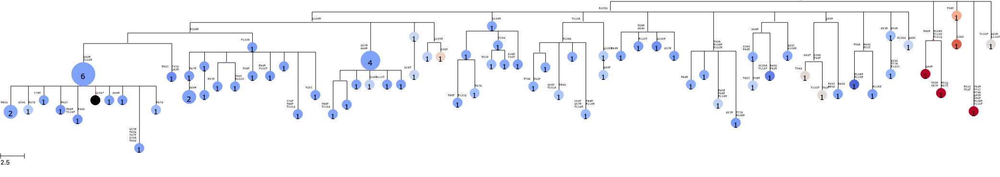

mouse1_GC2


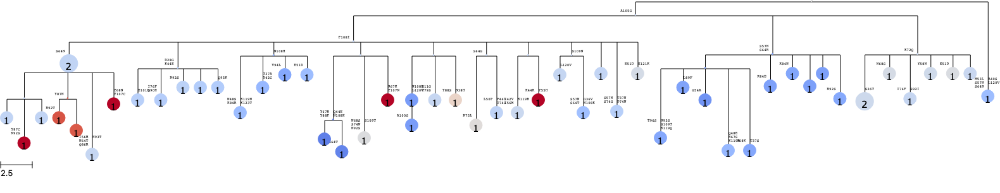

mouse1_GC3


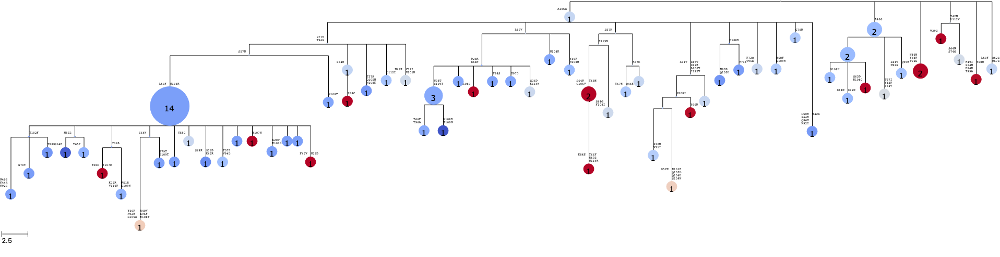

mouse1_GC4


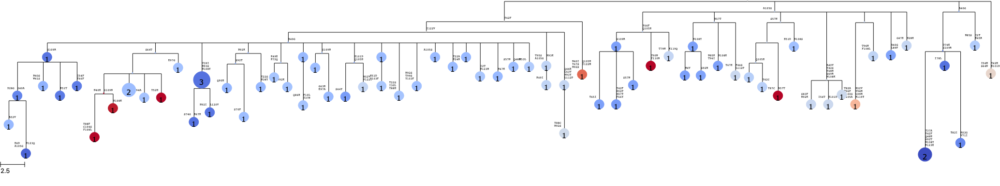

mouse1_GC5


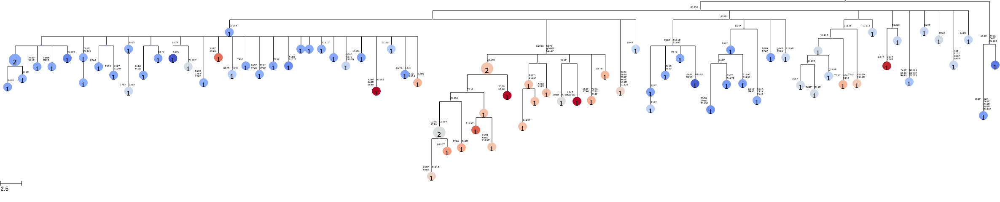

mouse1_GC6


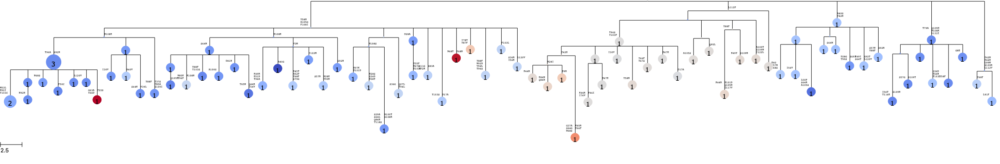

mouse1_GC7


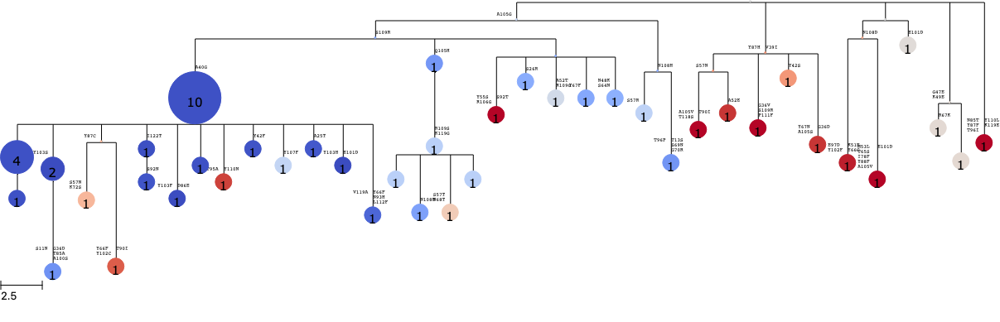

mouse1_GC11


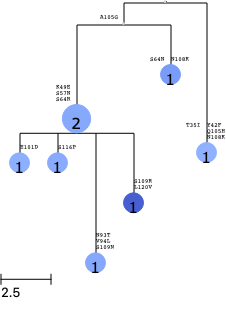

mouse1_GC12


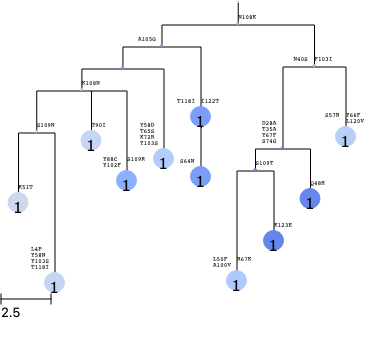

mouse1_GC13


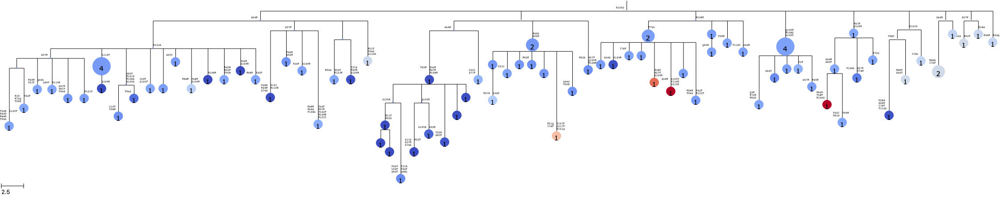

mouse1_GC14


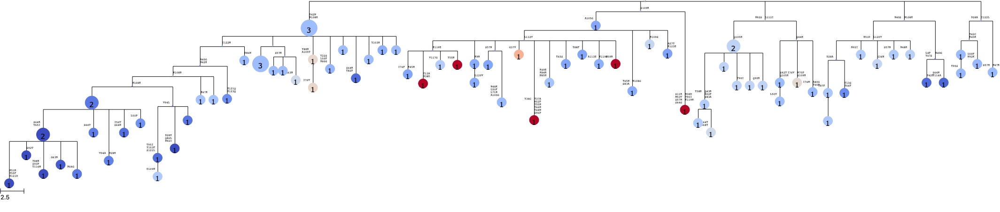

mouse1_GC15


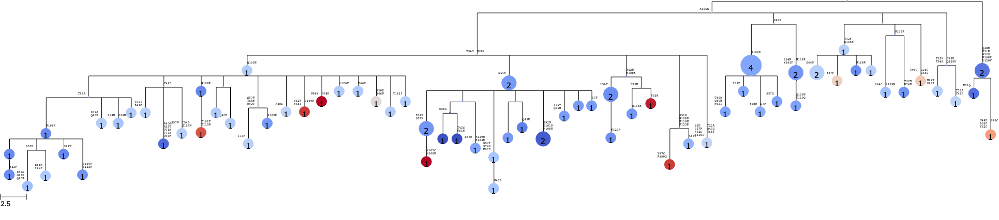

mouse1_GC16


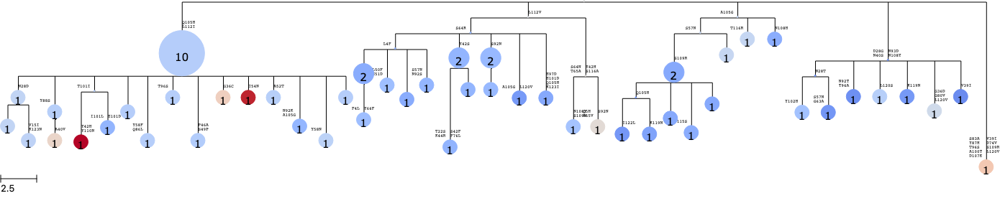

mouse1_GC17


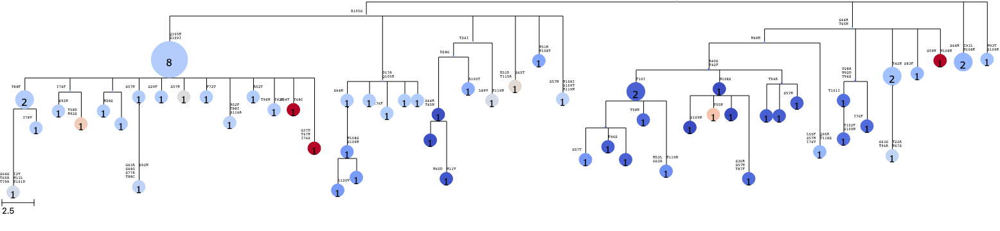

mouse1_GC18


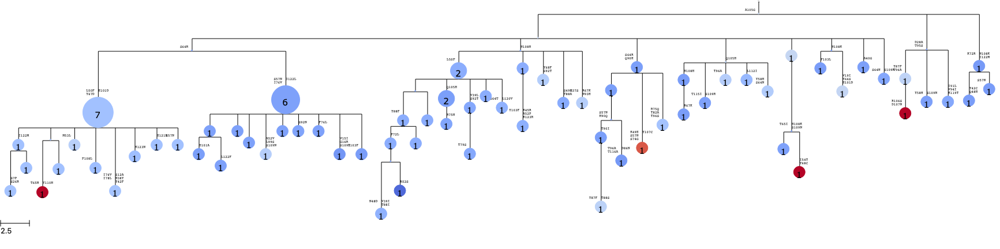

mouse1_GC19


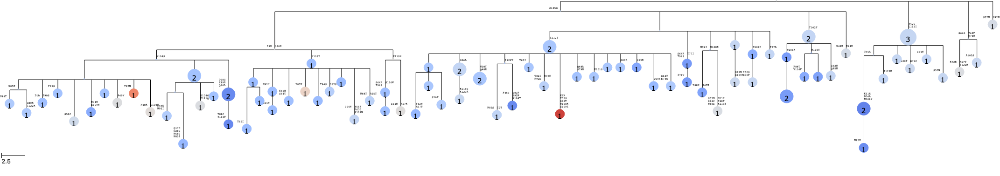

mouse1_GC20


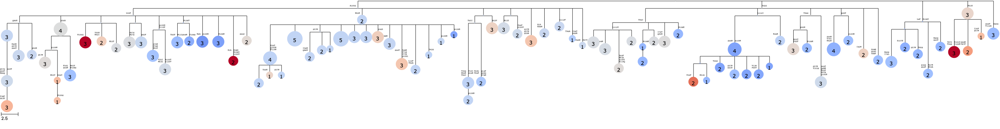

mouse2_GC21


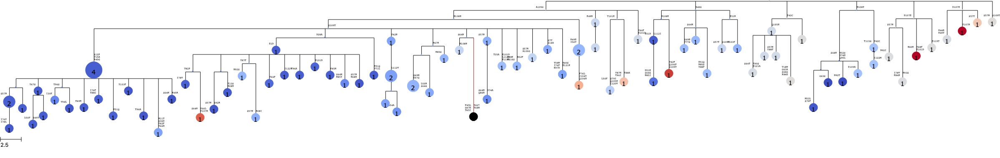

mouse2_GC22


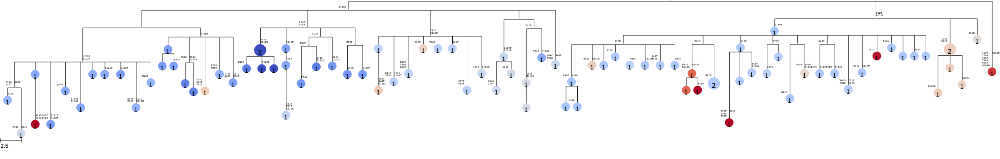

mouse2_GC23


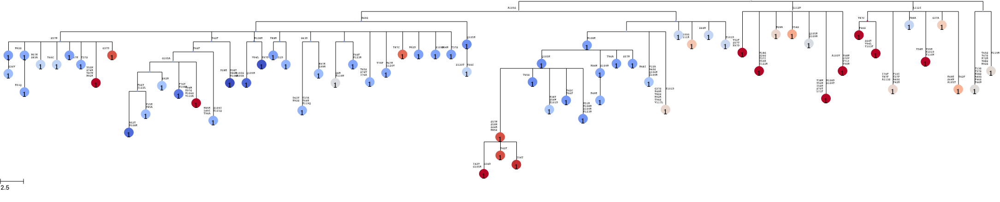

mouse2_GC24


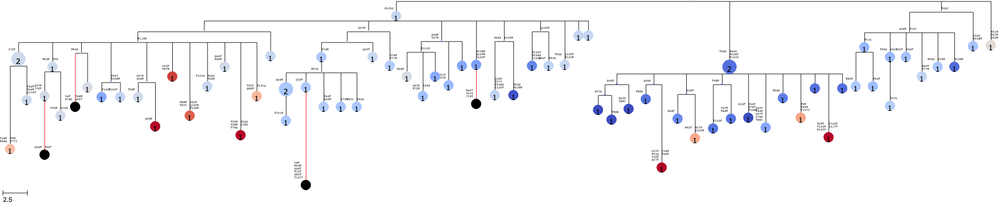

mouse2_GC25


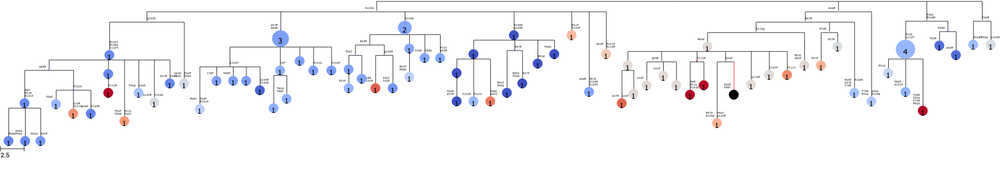

mouse2_GC26


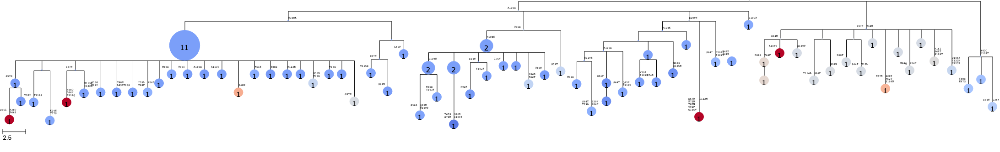

mouse2_GC28


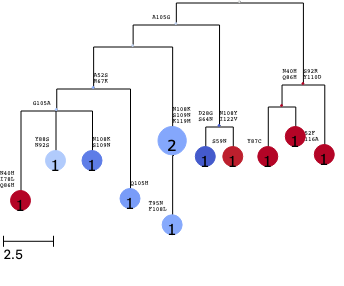

mouse2_GC29


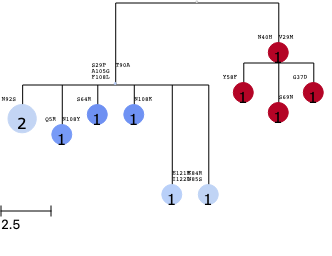

mouse2_GC30


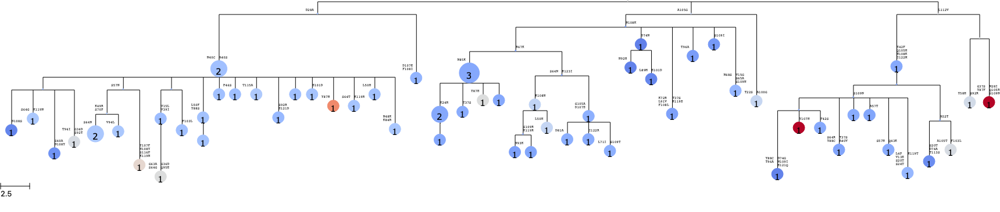

mouse2_GC31


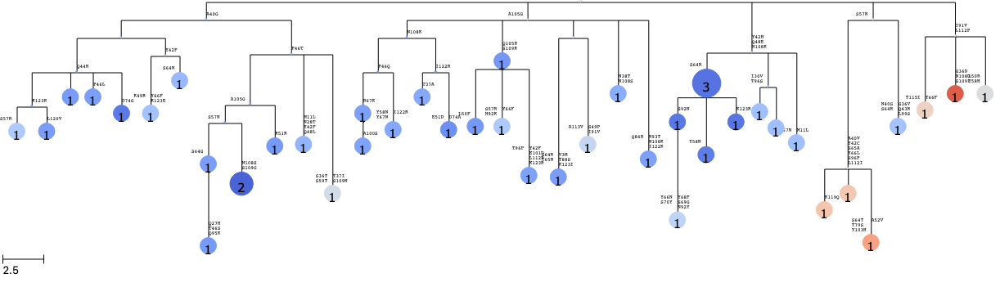

mouse2_GC32


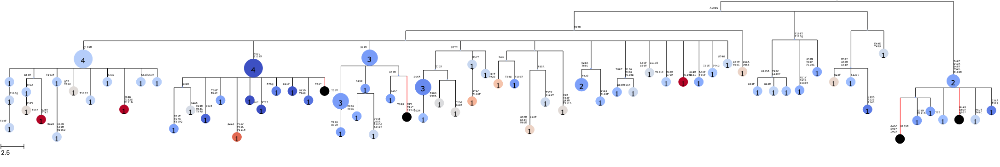

mouse2_GC34


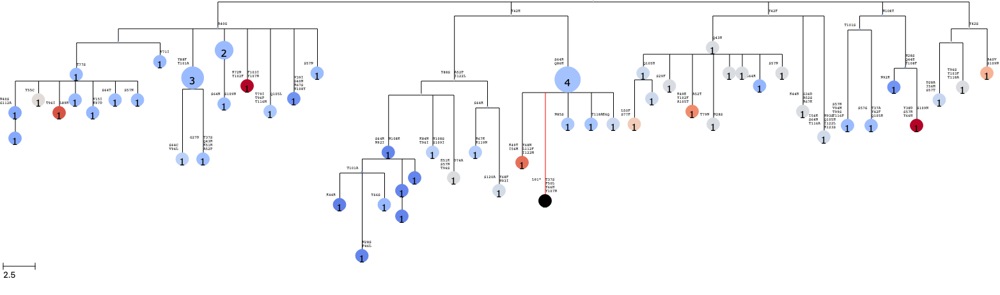

mouse2_GC38


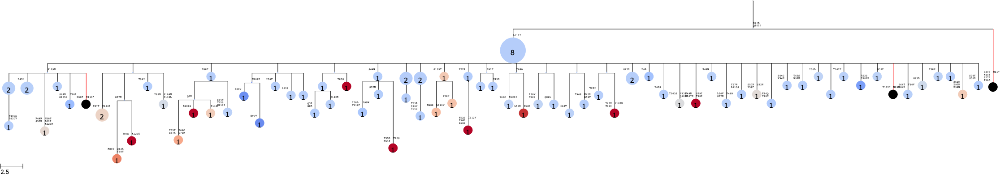

mouse2_GC39


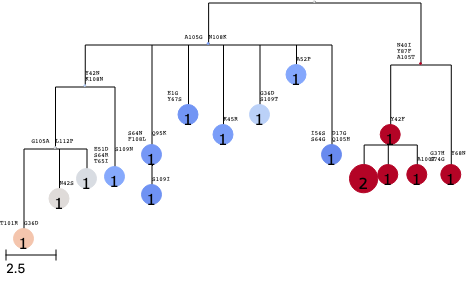

mouse2_GC40


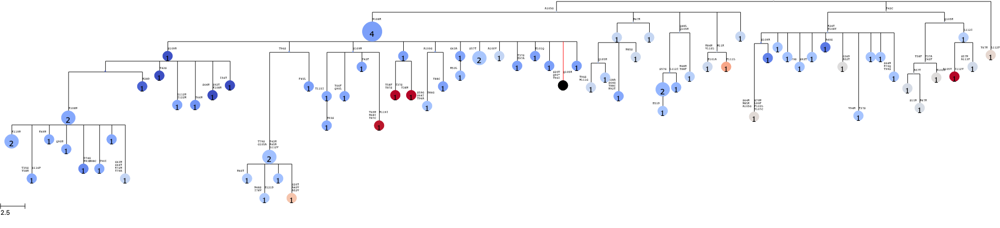

mouse3_GC41


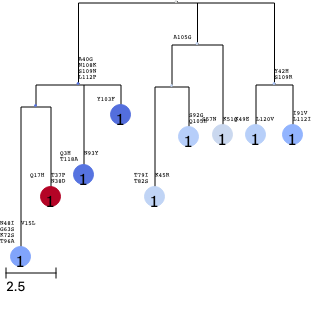

mouse3_GC42


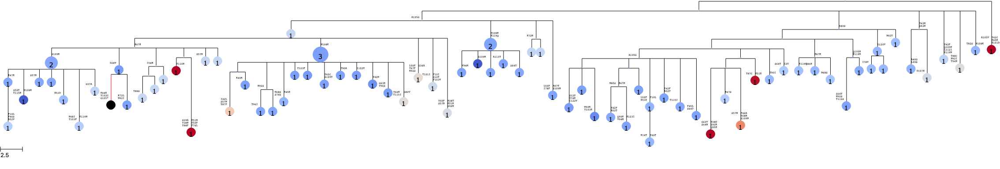

mouse3_GC43


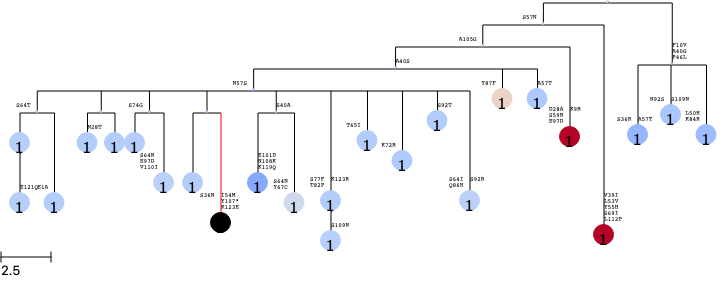

mouse3_GC44


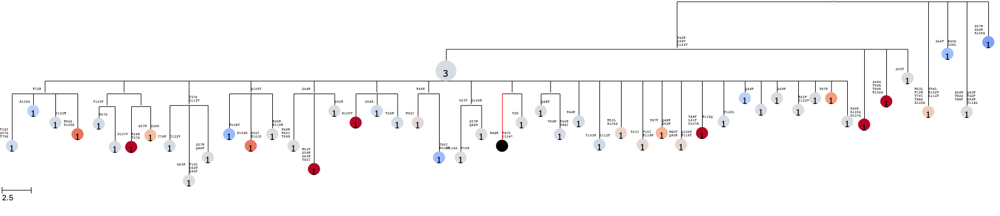

mouse3_GC45


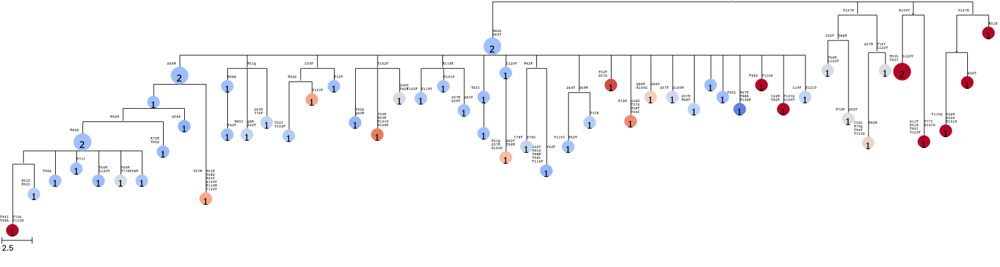

mouse3_GC46


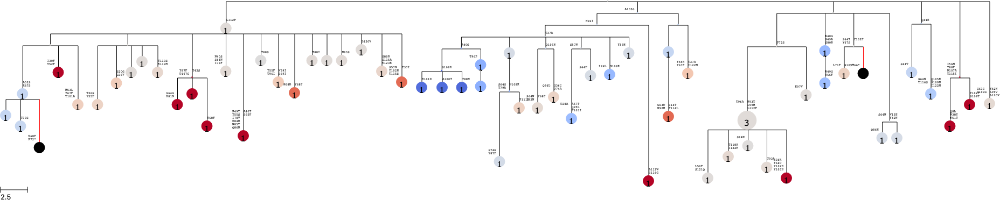

mouse3_GC55


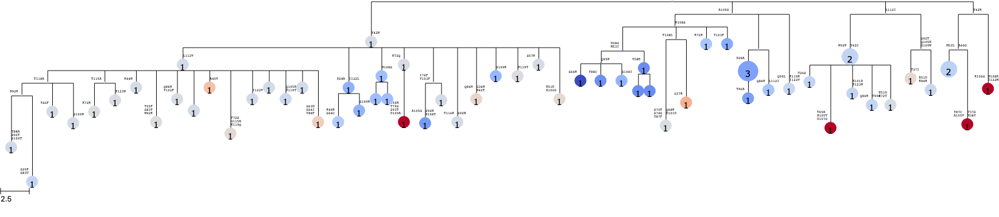

mouse3_GC56


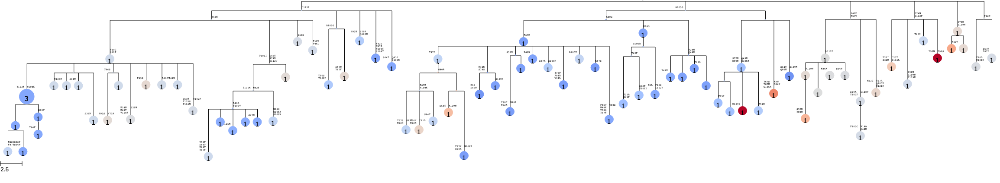

mouse3_GC57


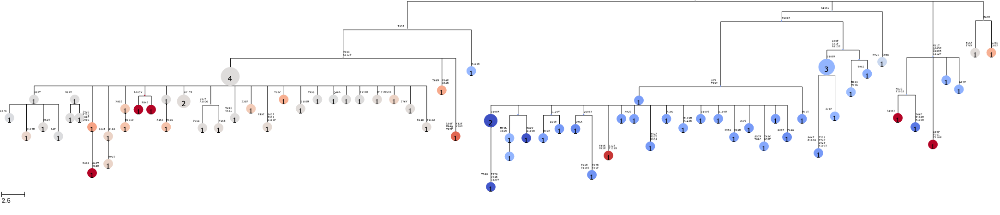

mouse3_GC58


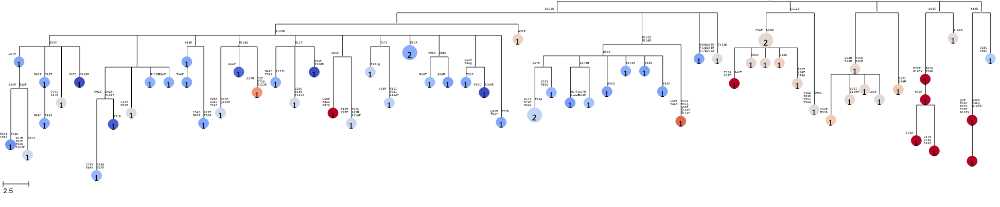

mouse3_GC59


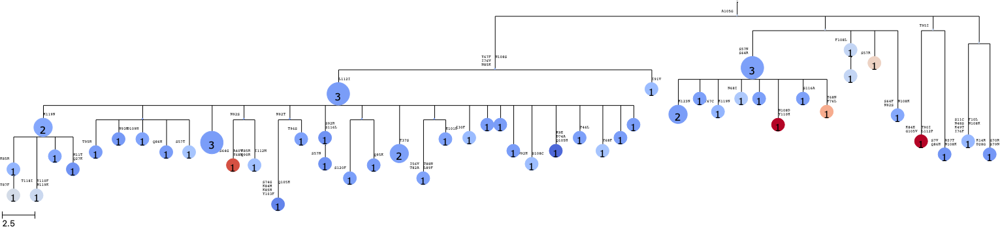

mouse3_GC64


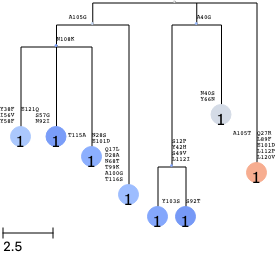

mouse3_GC65


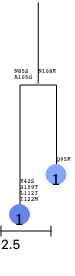

mouse3_GC66


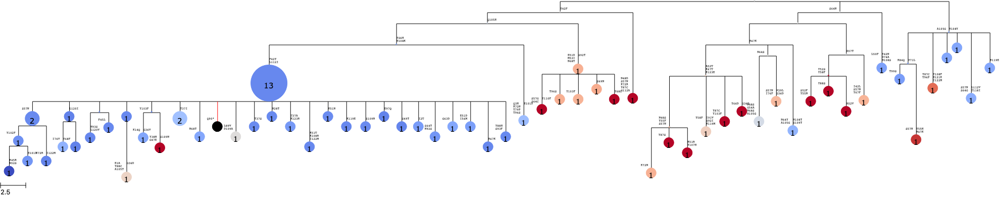

mouse3_GC72


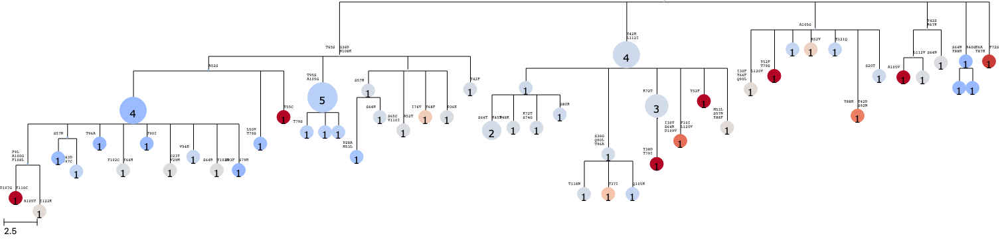

mouse4_GC47


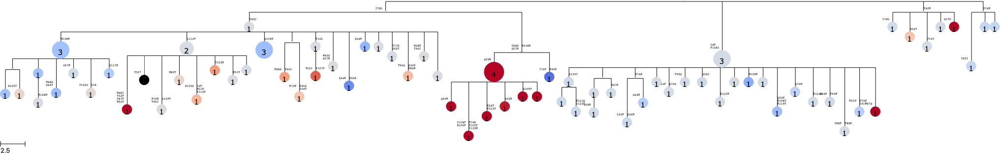

mouse4_GC48


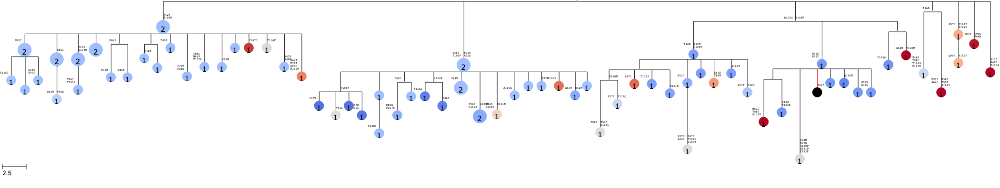

mouse4_GC50


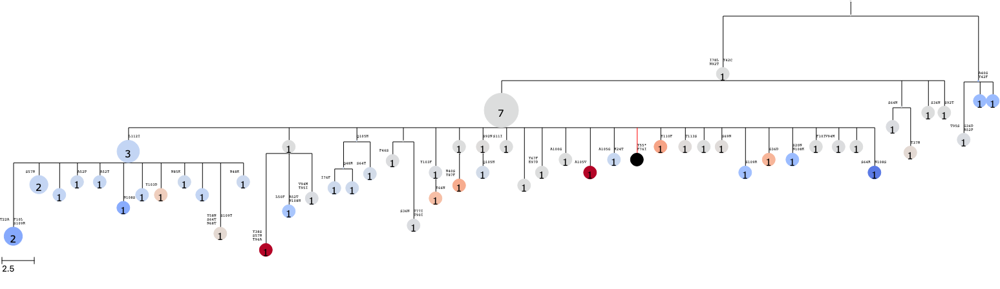

mouse4_GC63


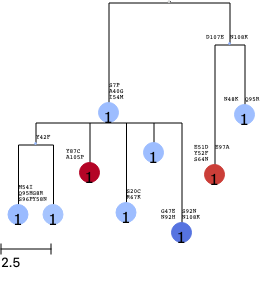

mouse4_GC67


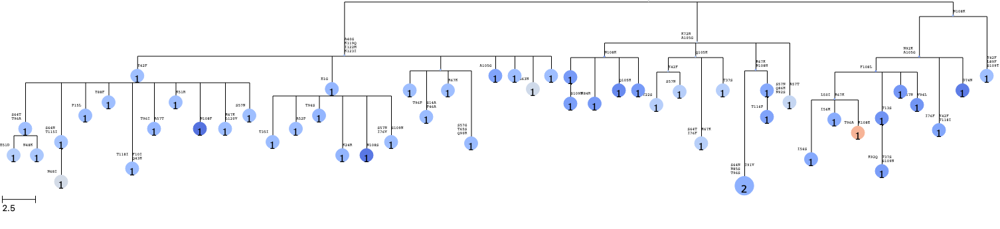

mouse4_GC68


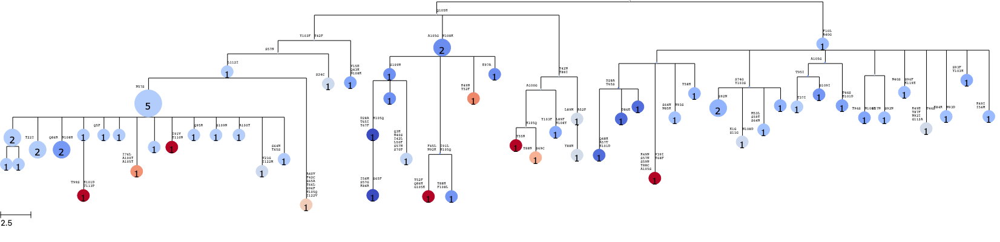

mouse4_GC69


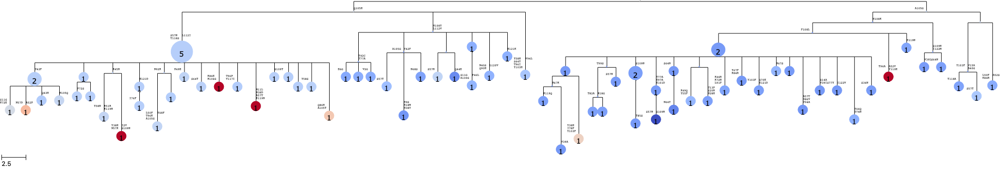

mouse4_GC70


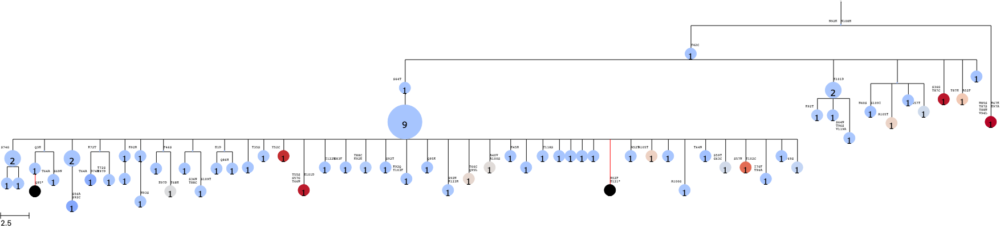

mouse4_GC71


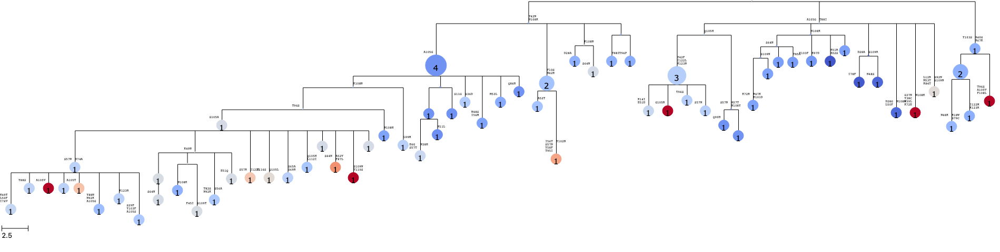

mouse4_GC73


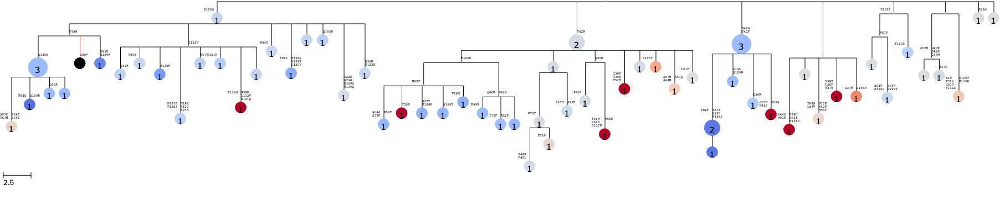

mouse5_GC78


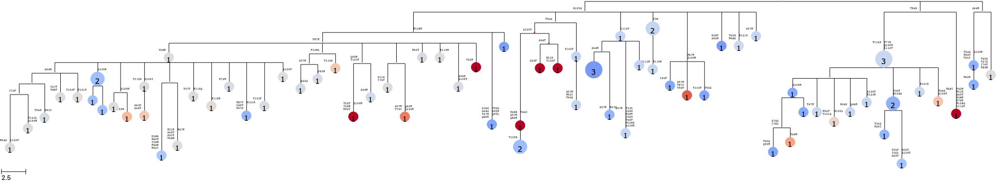

mouse5_GC79


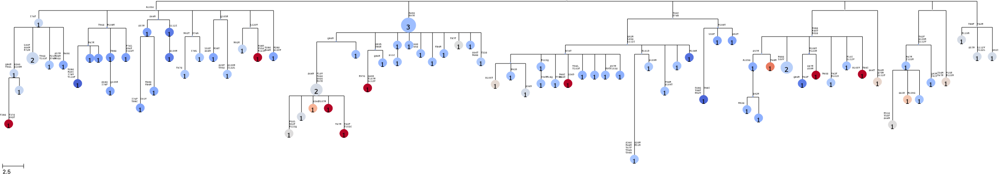

mouse5_GC80


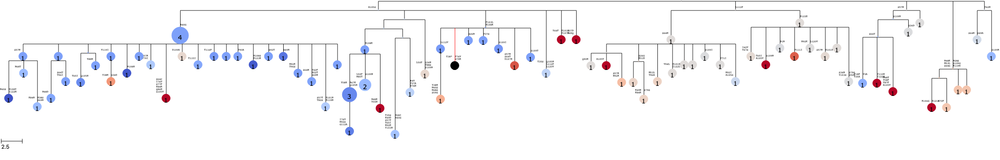

mouse5_GC81


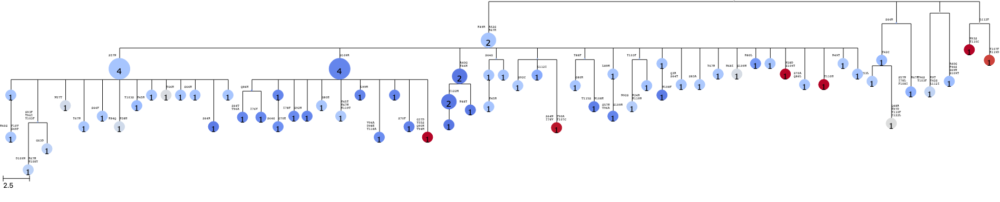

mouse5_GC82


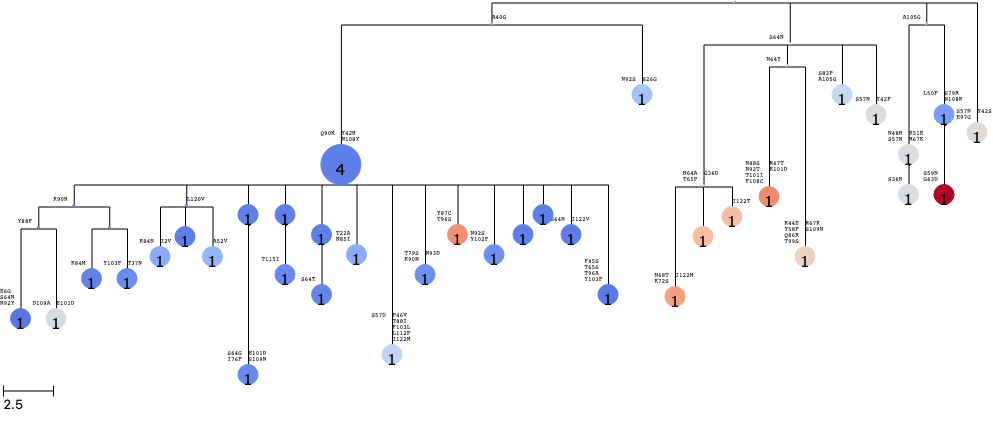

mouse5_GC83


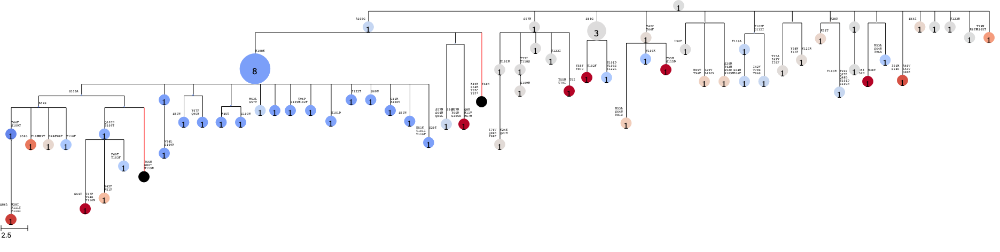

mouse6_GC74


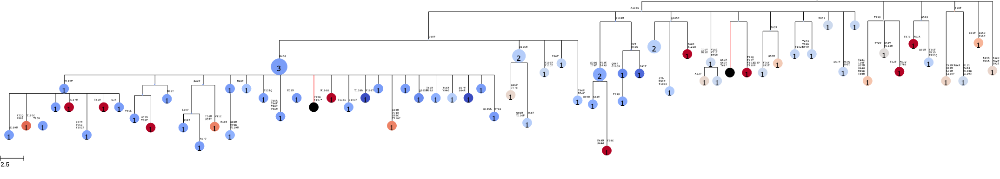

mouse6_GC75


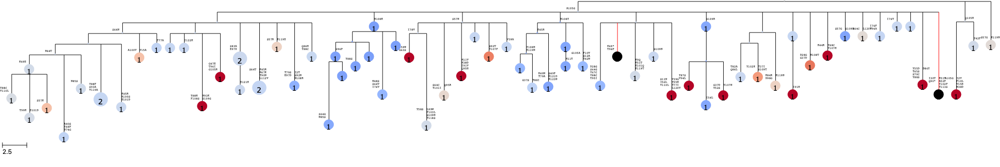

mouse6_GC76


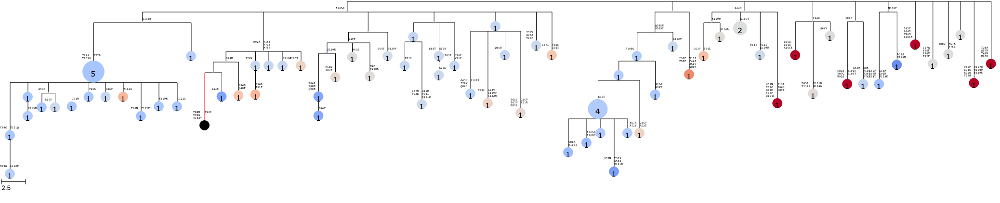

mouse6_GC77


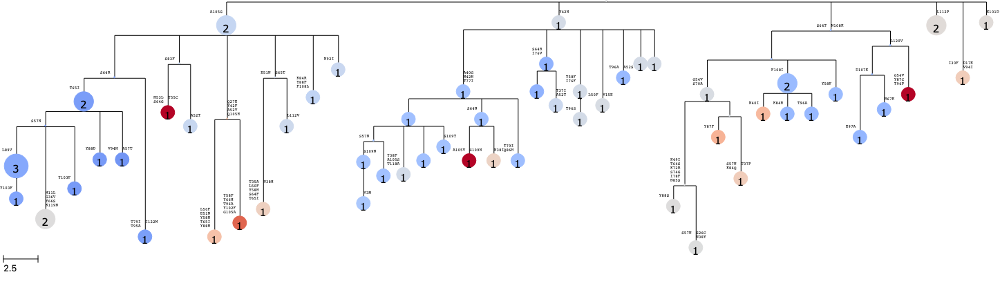

mouse7_GC90


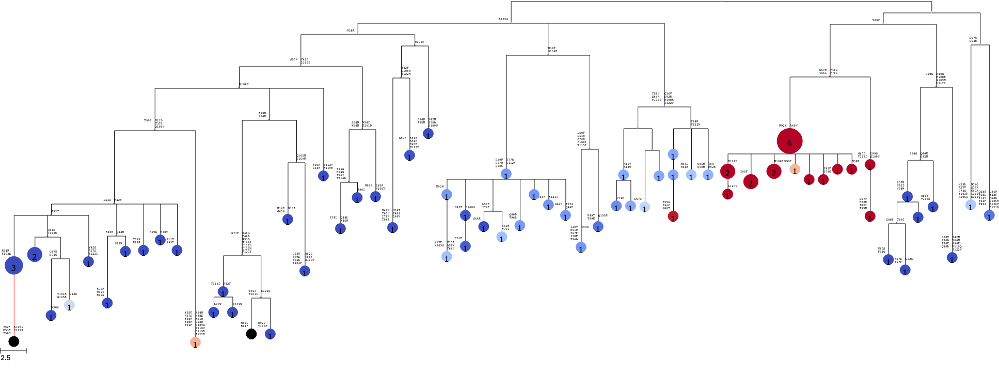

mouse8_GC84


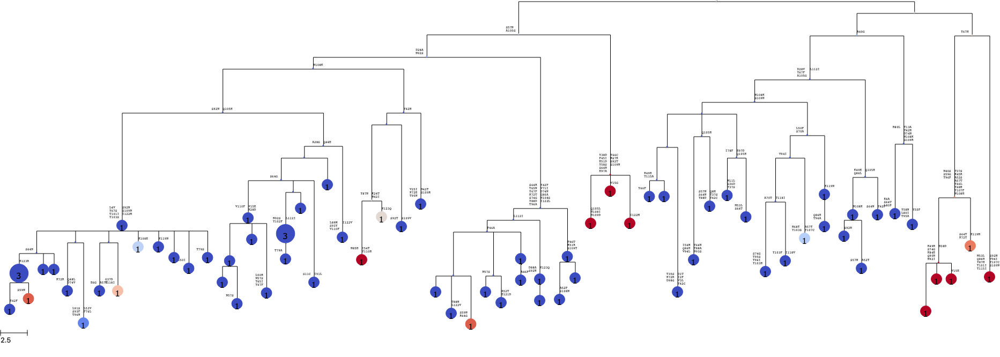

mouse8_GC85


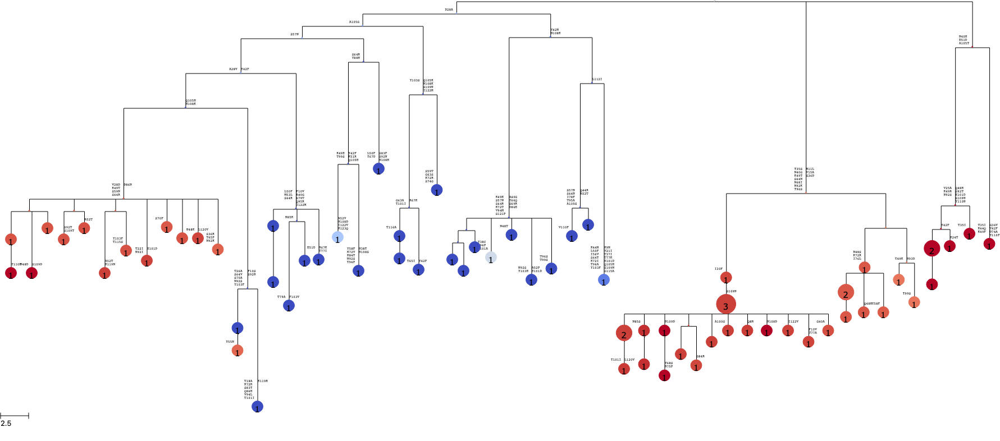

mouse8_GC86


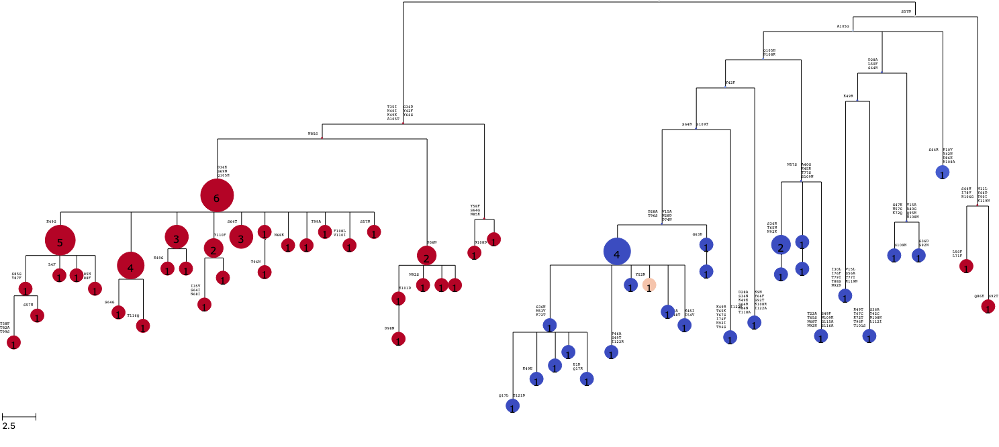

mouse8_GC87


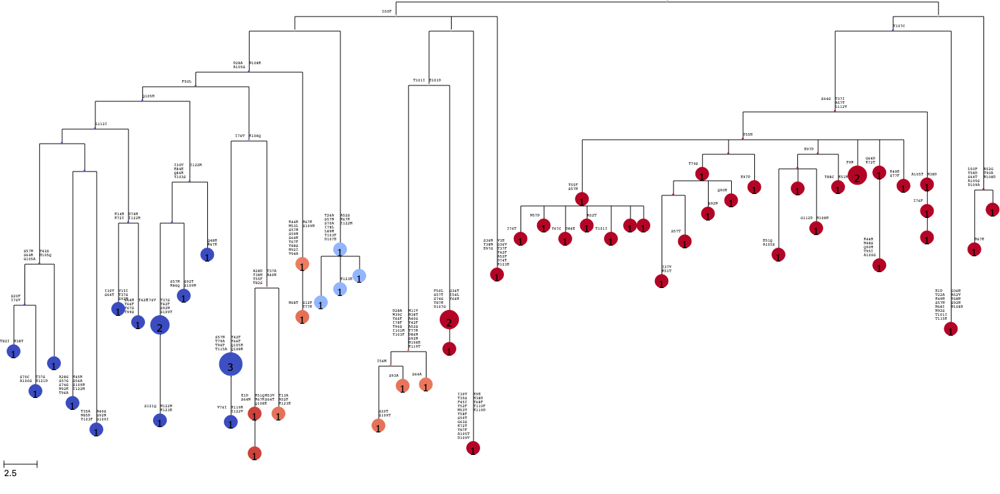

mouse8_GC88


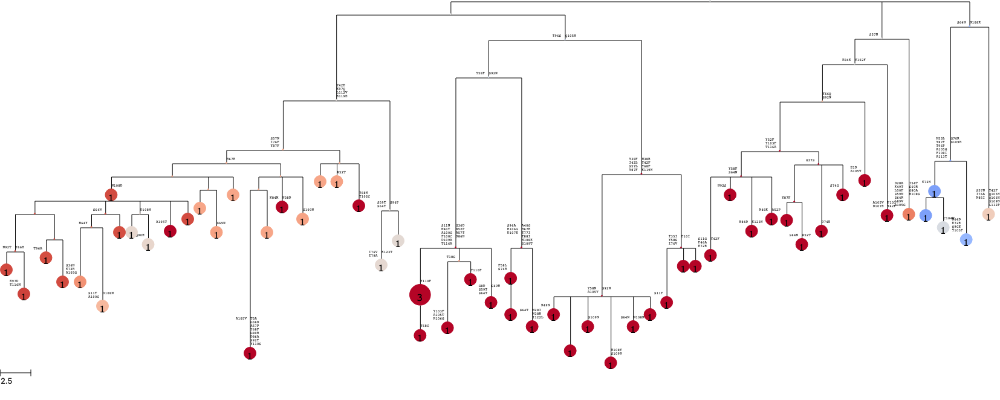

mouse8_GC89


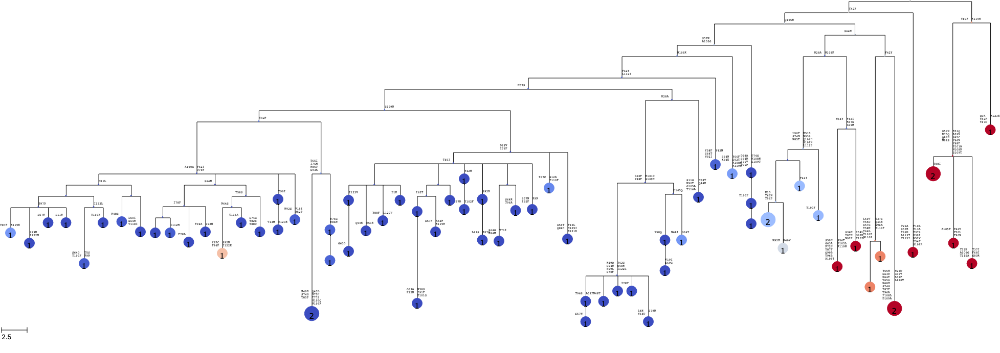

In [274]:
for gc, tree in trees.items():
    print(gc)
    colormap = tree.feature_colormap("delta_bind_additive", cmap='coolwarm_r', vmin=-2, vmax=2)
    # need this loop to render to svg and notebook
    for file in (f"output/plots/colormapped_gctrees/{gc}.delta_bind.svg", "%%inline"):
        rendering = tree.render(file,
                            # scale=None, branch_margin=-5,
                            scale=20, frame=igh_frame, frame2=igk_frame, chain_split=igk_idx,
                            colormap=colormap,
                            position_map=igh_pos_map, position_map2=igk_pos_map)
    display(rendering)

## Color map $\Delta$ expression

mouse1_GC1


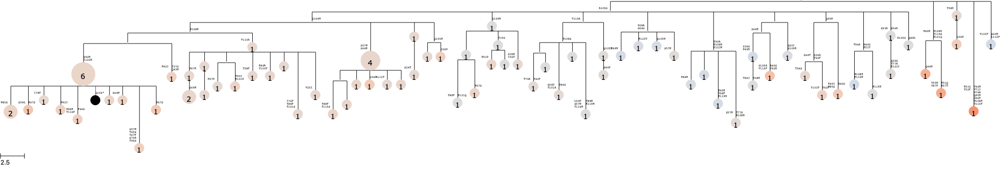

mouse1_GC2


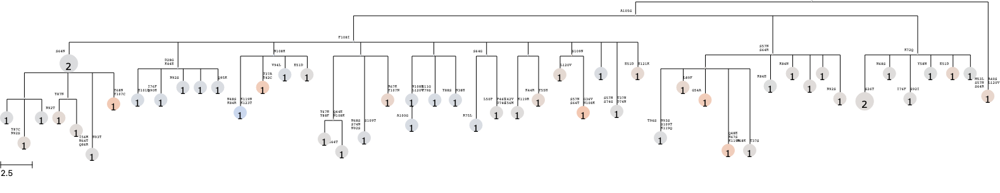

mouse1_GC3


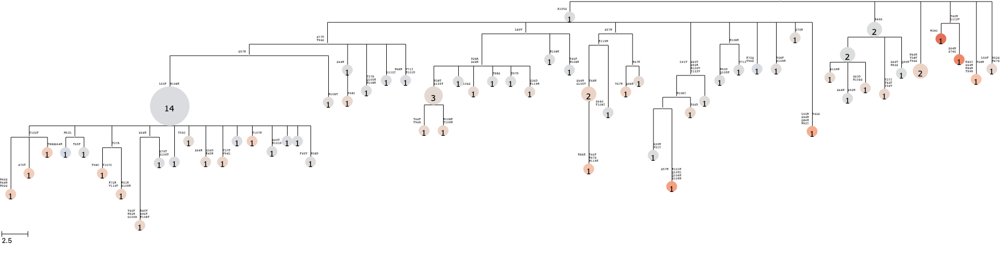

mouse1_GC4


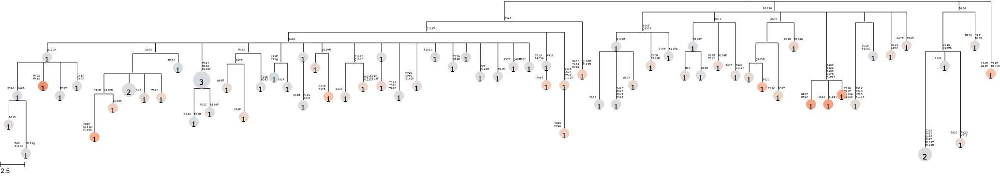

mouse1_GC5


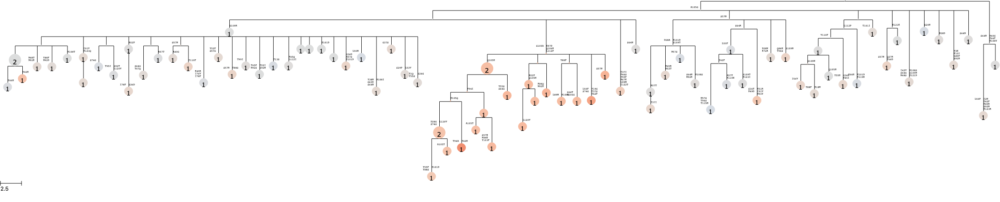

mouse1_GC6


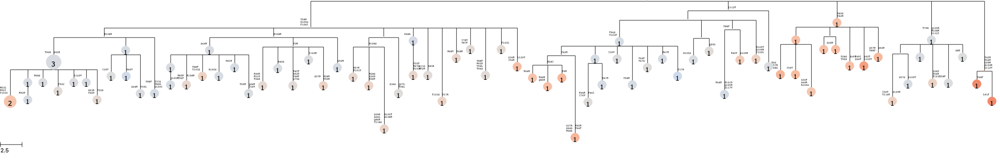

mouse1_GC7


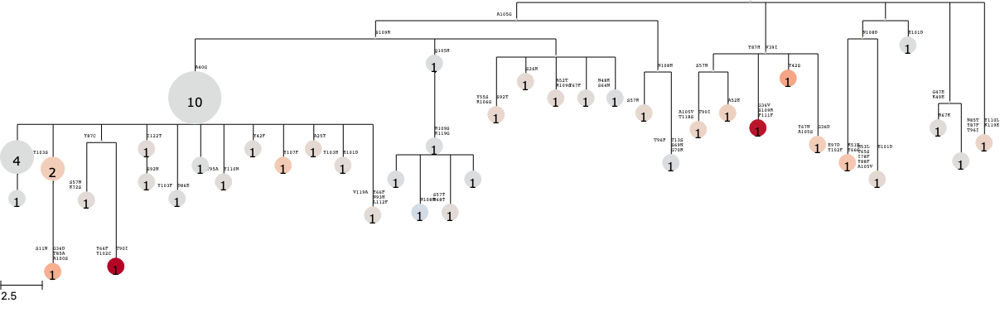

mouse1_GC11


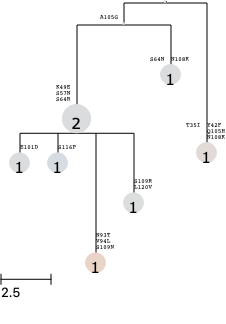

mouse1_GC12


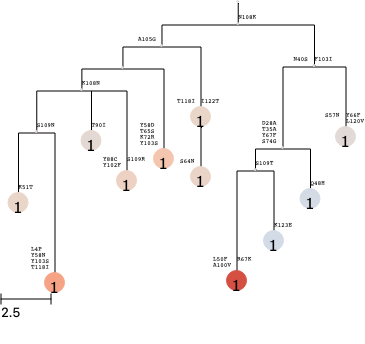

mouse1_GC13


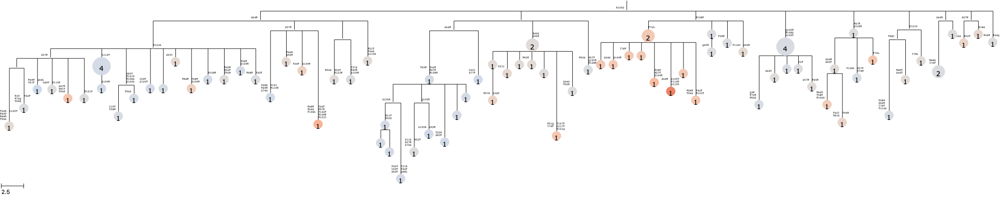

mouse1_GC14


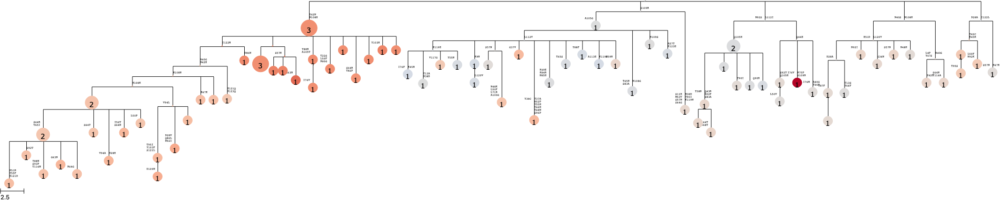

mouse1_GC15


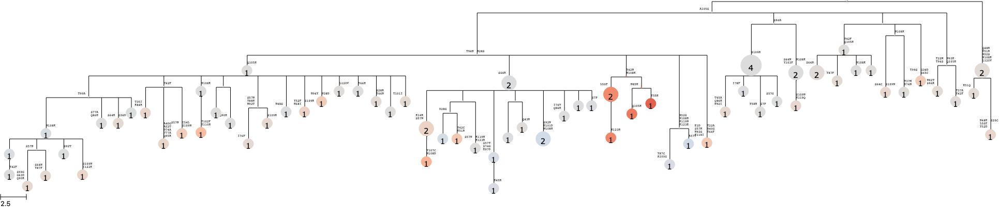

mouse1_GC16


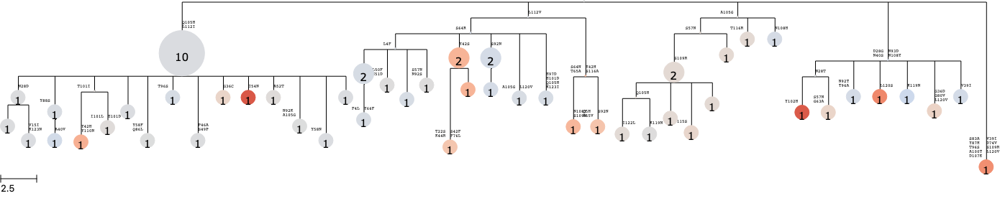

mouse1_GC17


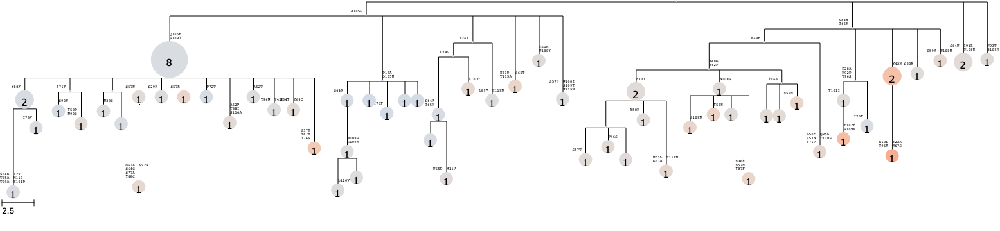

mouse1_GC18


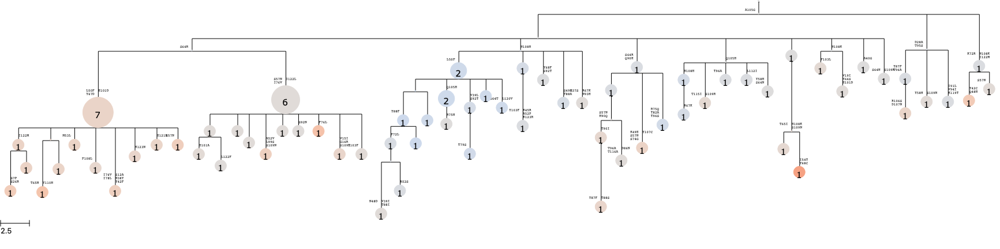

mouse1_GC19


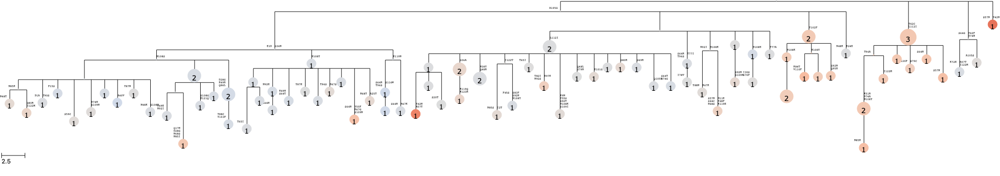

mouse1_GC20


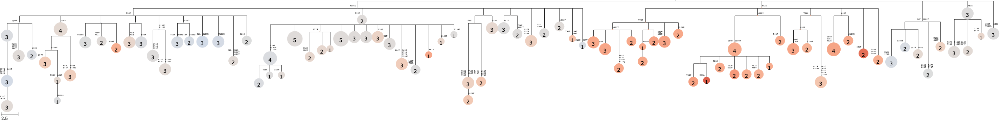

mouse2_GC21


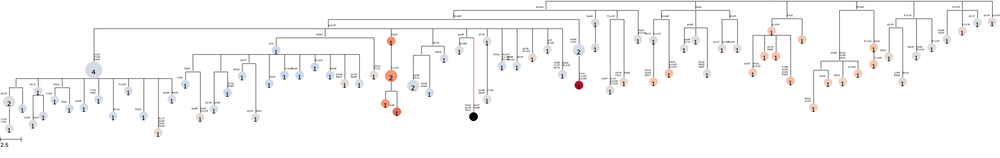

mouse2_GC22


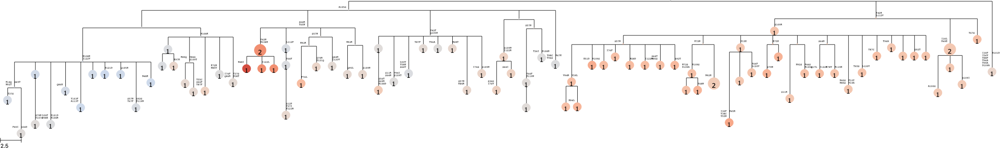

mouse2_GC23


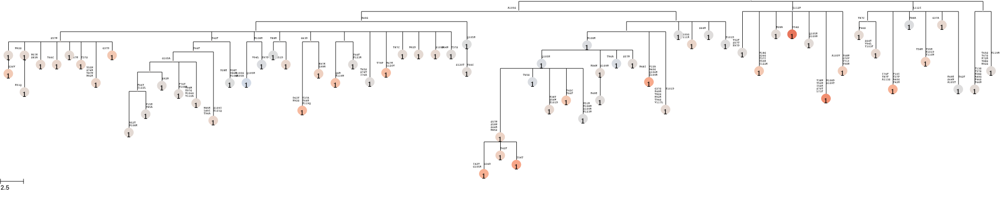

mouse2_GC24


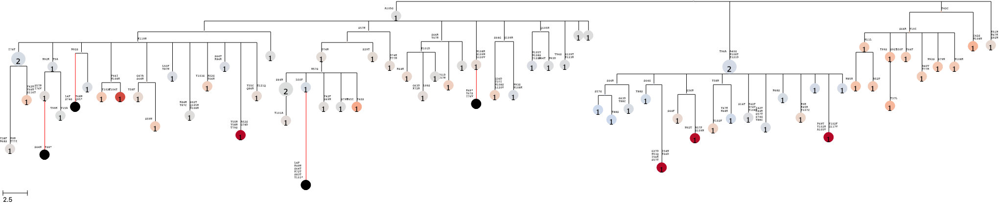

mouse2_GC25


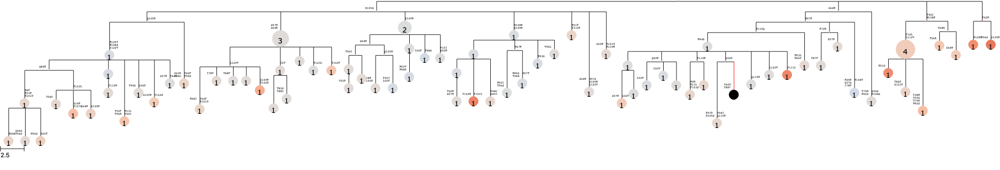

mouse2_GC26


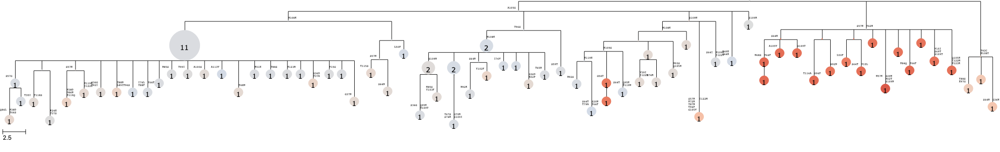

mouse2_GC28


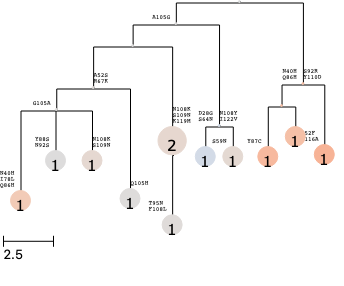

mouse2_GC29


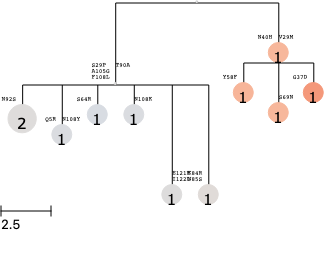

mouse2_GC30


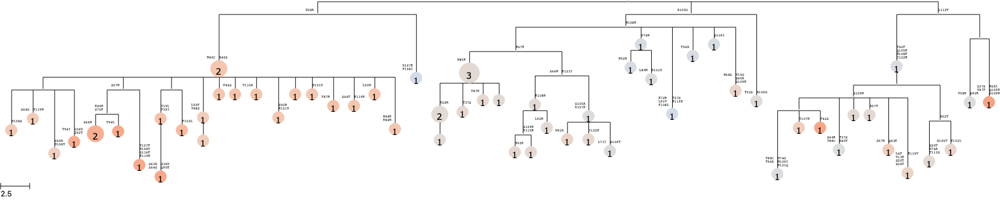

mouse2_GC31


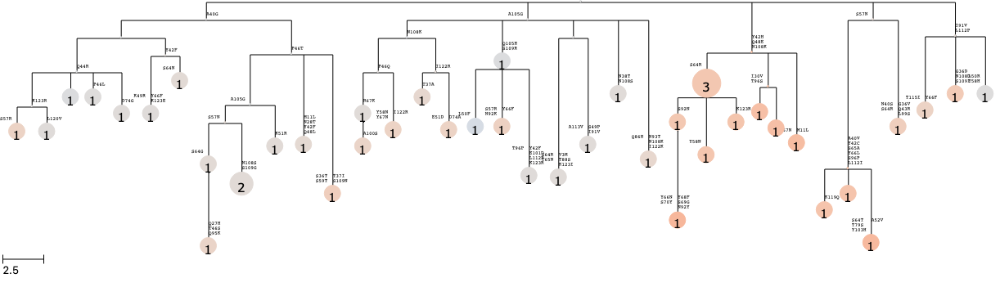

mouse2_GC32


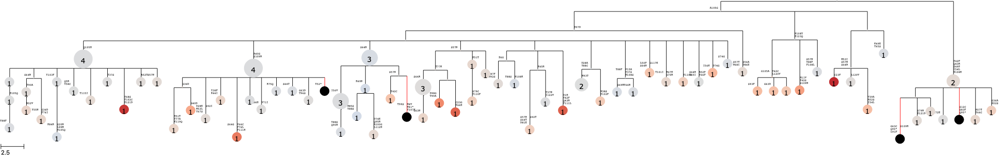

mouse2_GC34


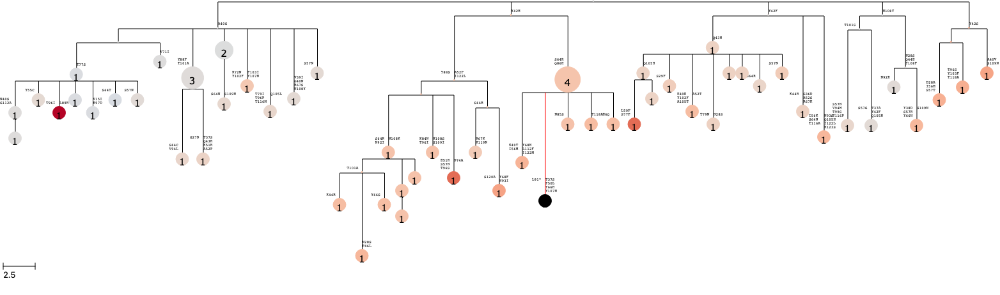

mouse2_GC38


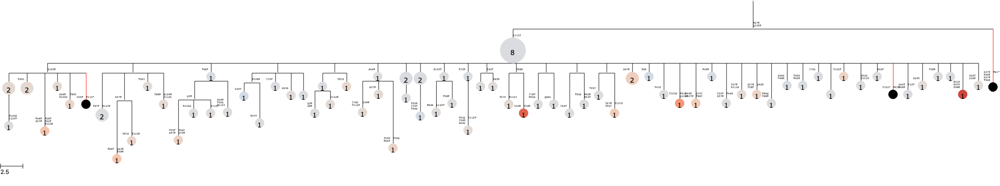

mouse2_GC39


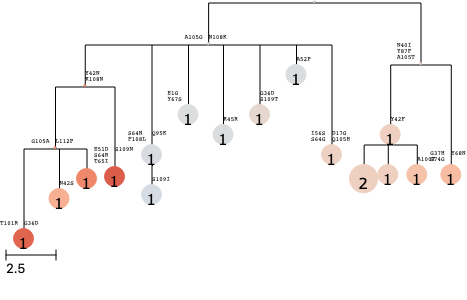

mouse2_GC40


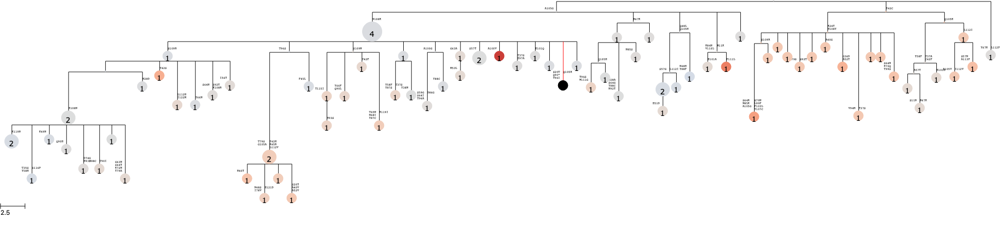

mouse3_GC41


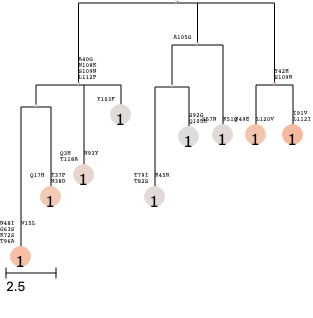

mouse3_GC42


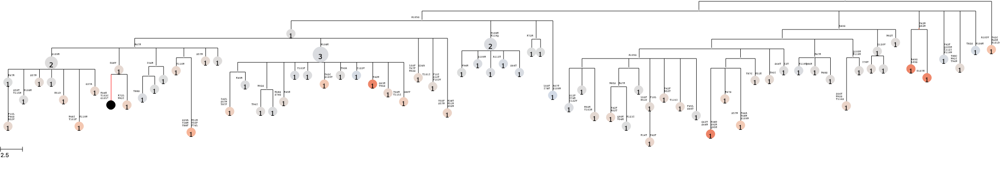

mouse3_GC43


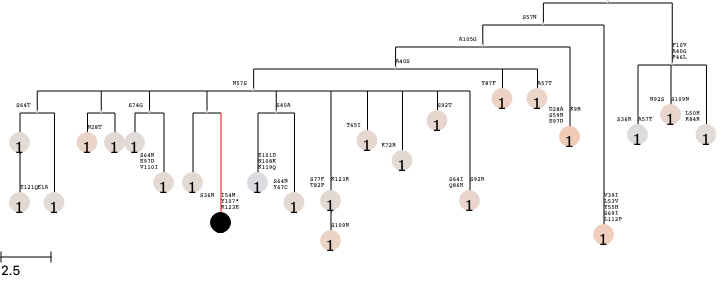

mouse3_GC44


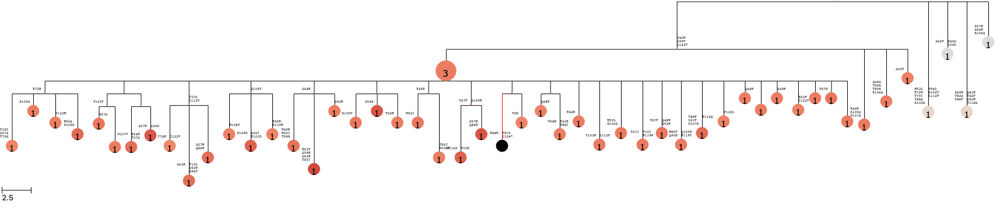

mouse3_GC45


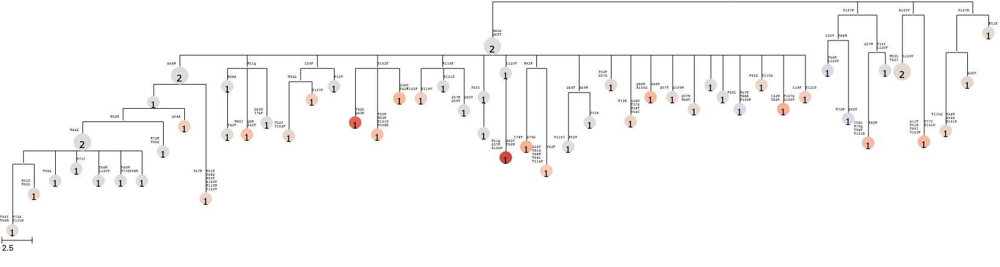

mouse3_GC46


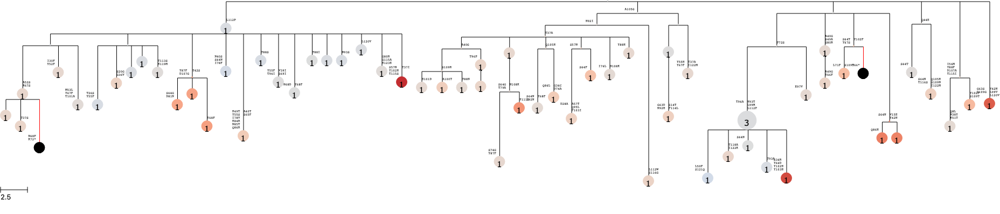

mouse3_GC55


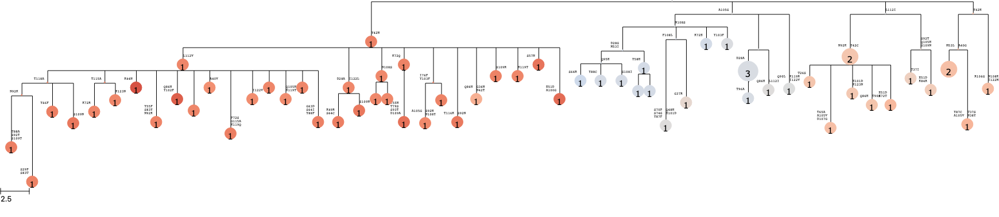

mouse3_GC56


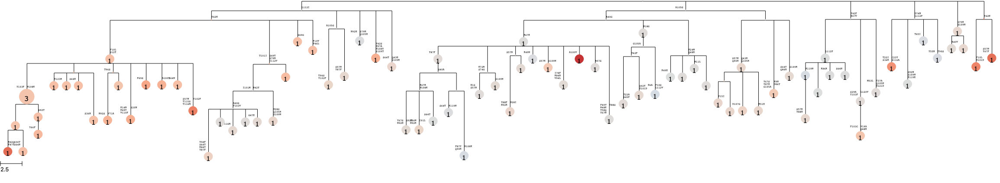

mouse3_GC57


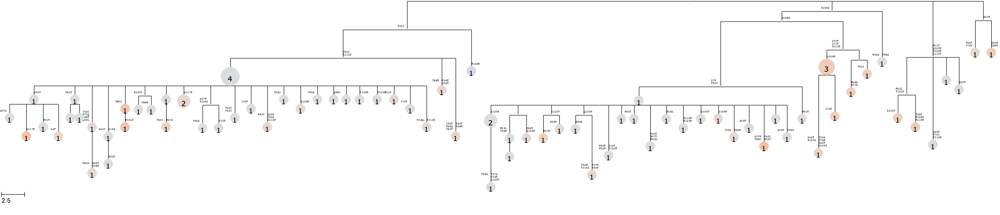

mouse3_GC58


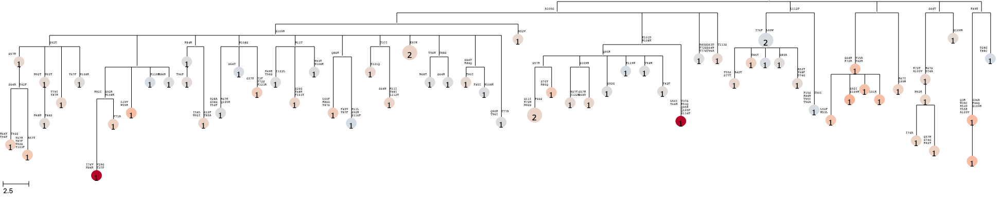

mouse3_GC59


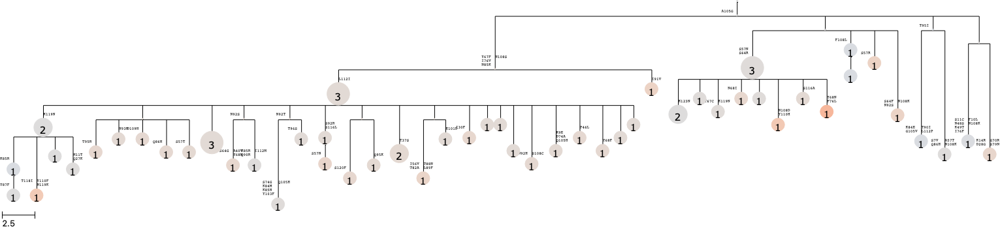

mouse3_GC64


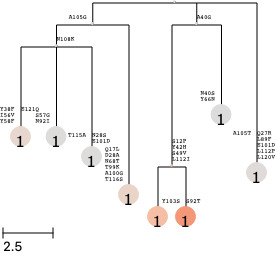

mouse3_GC65


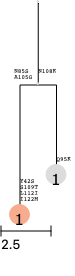

mouse3_GC66


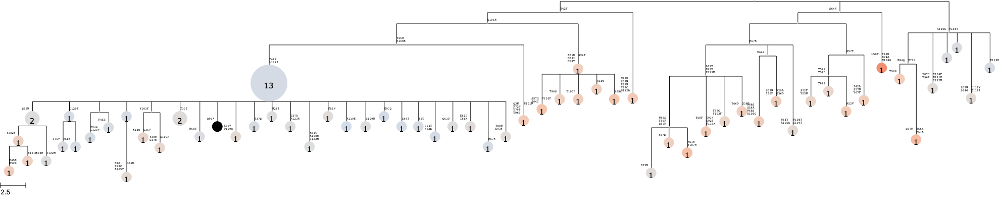

mouse3_GC72


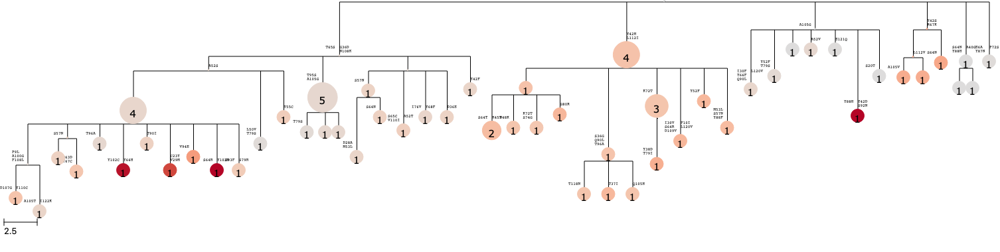

mouse4_GC47


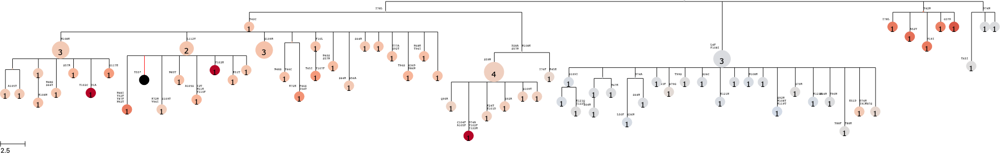

mouse4_GC48


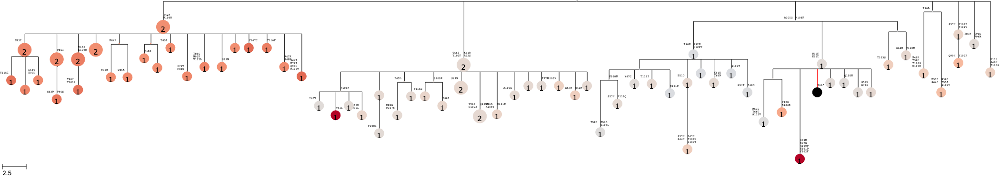

mouse4_GC50


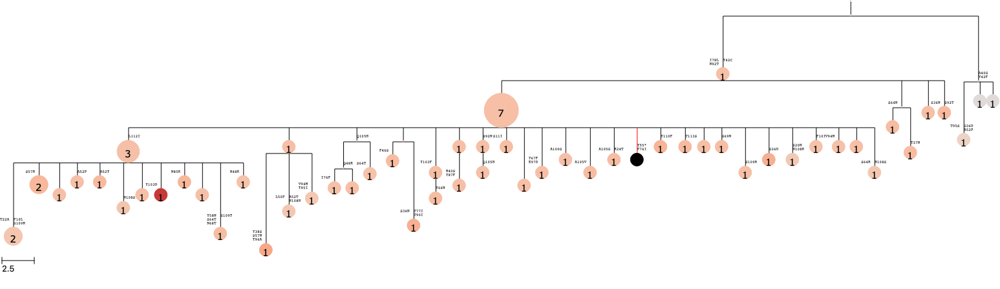

mouse4_GC63


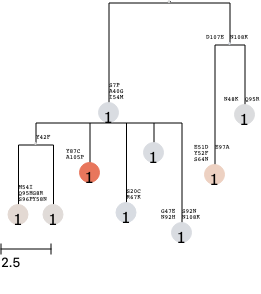

mouse4_GC67


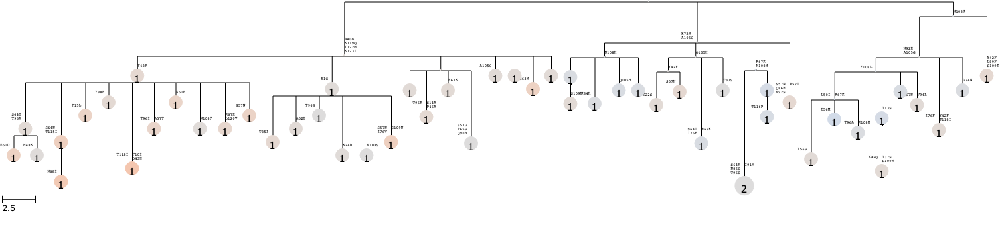

mouse4_GC68


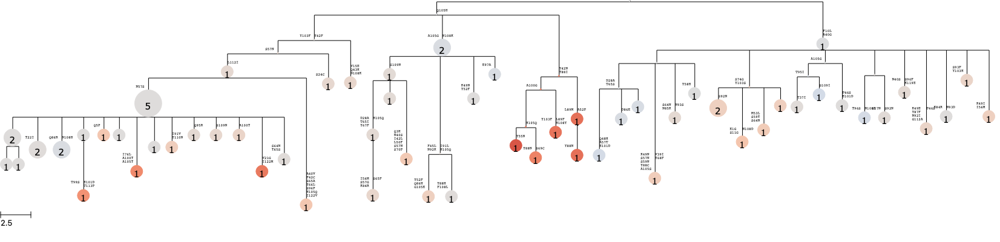

mouse4_GC69


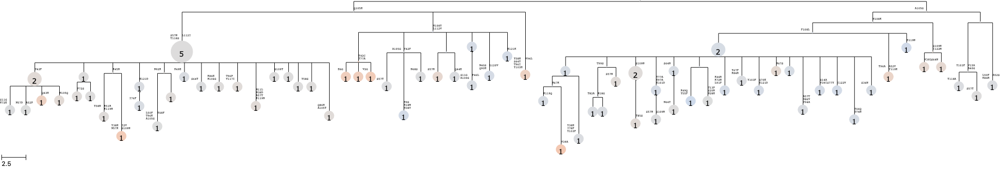

mouse4_GC70


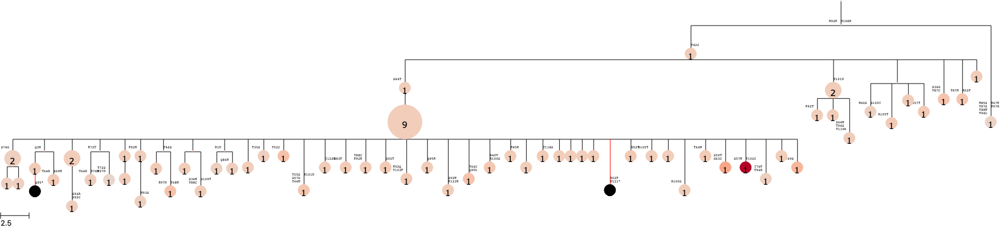

mouse4_GC71


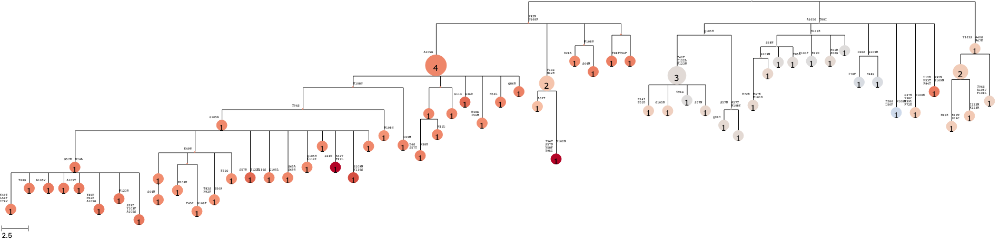

mouse4_GC73


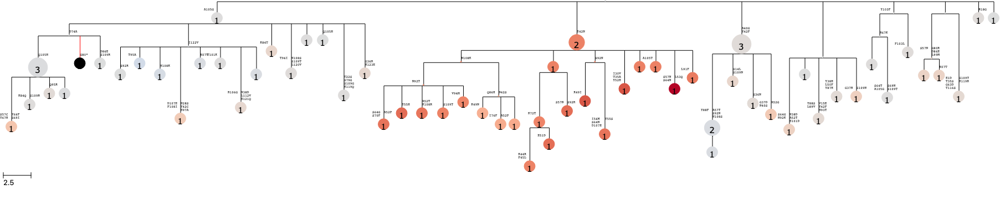

mouse5_GC78


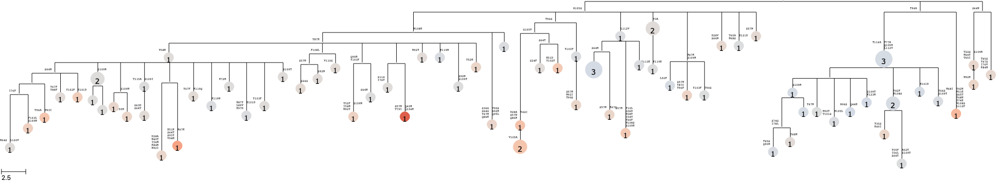

mouse5_GC79


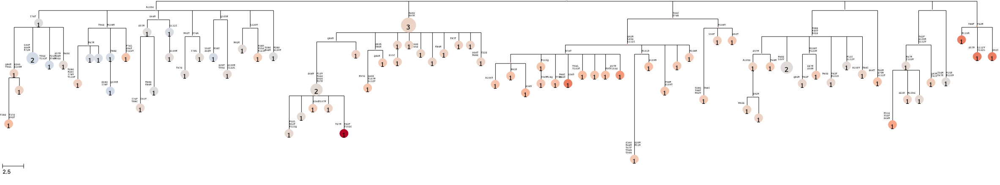

mouse5_GC80


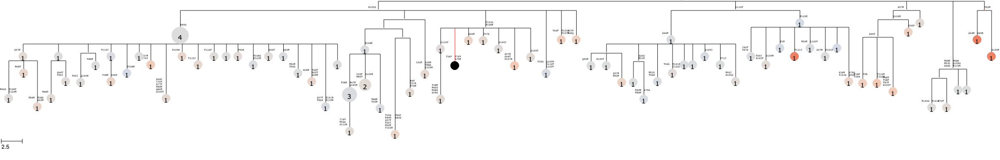

mouse5_GC81


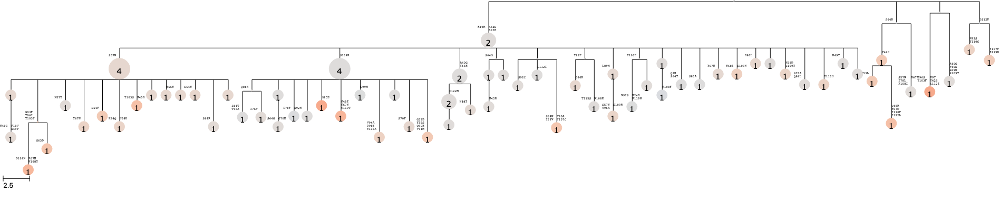

mouse5_GC82


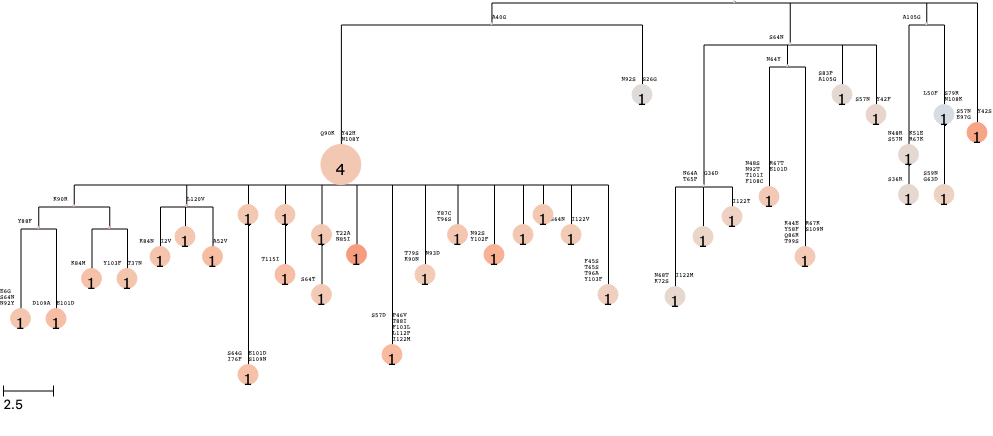

mouse5_GC83


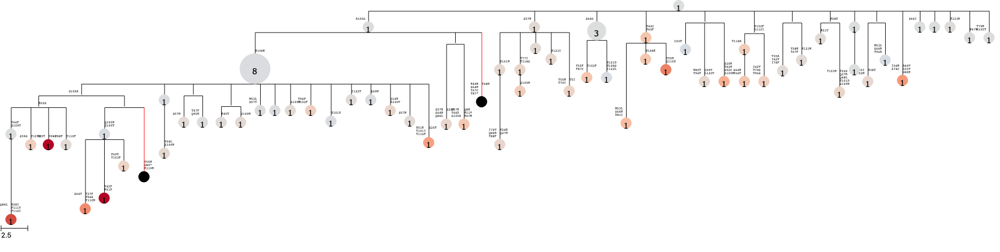

mouse6_GC74


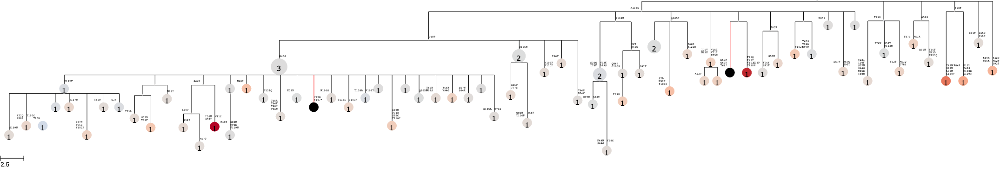

mouse6_GC75


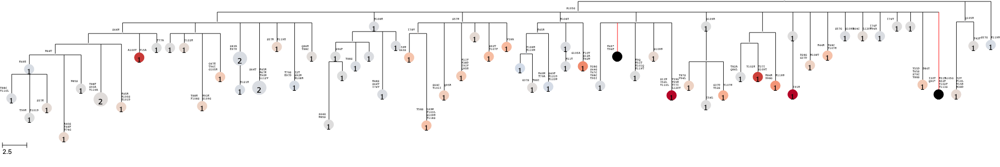

mouse6_GC76


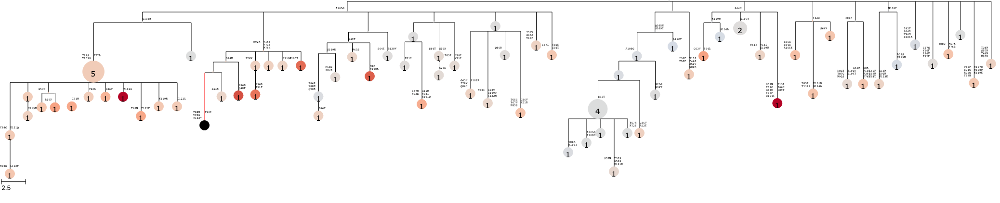

mouse6_GC77


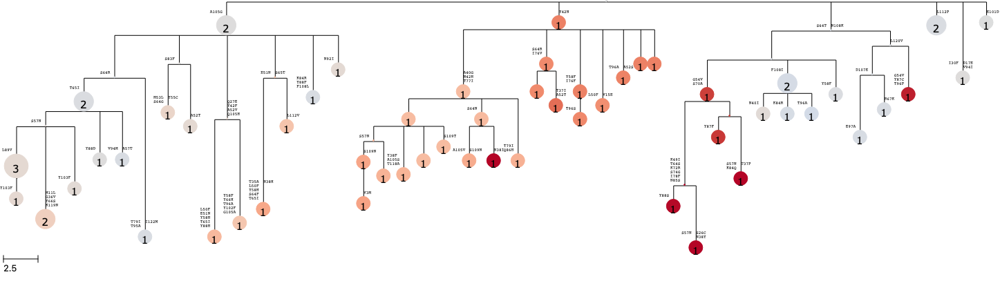

mouse7_GC90


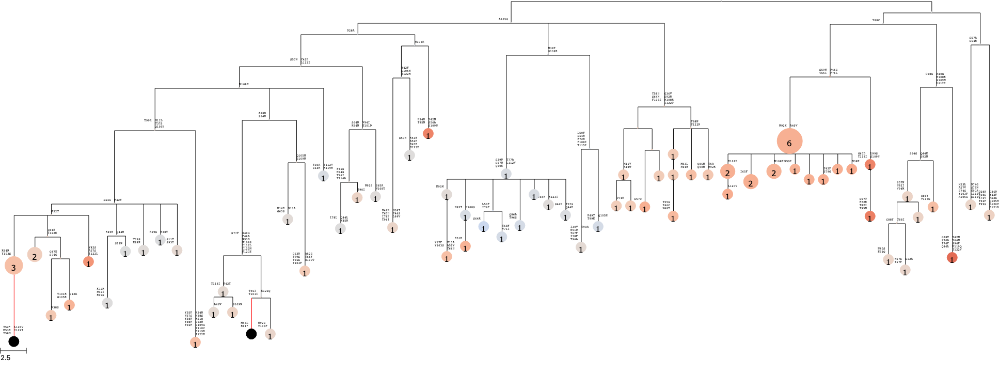

mouse8_GC84


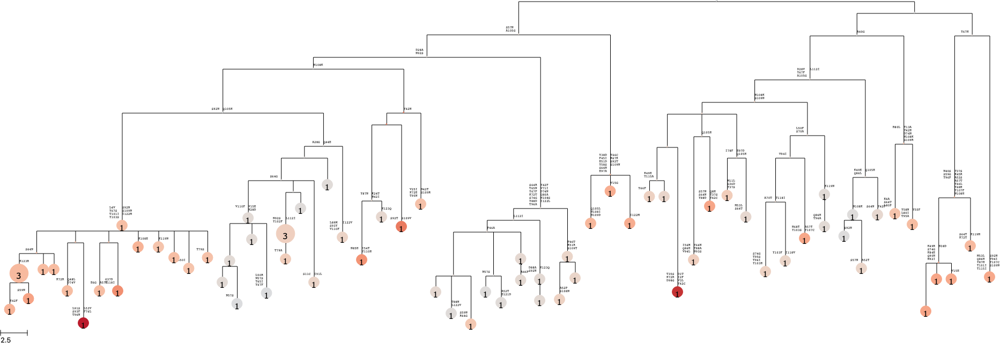

mouse8_GC85


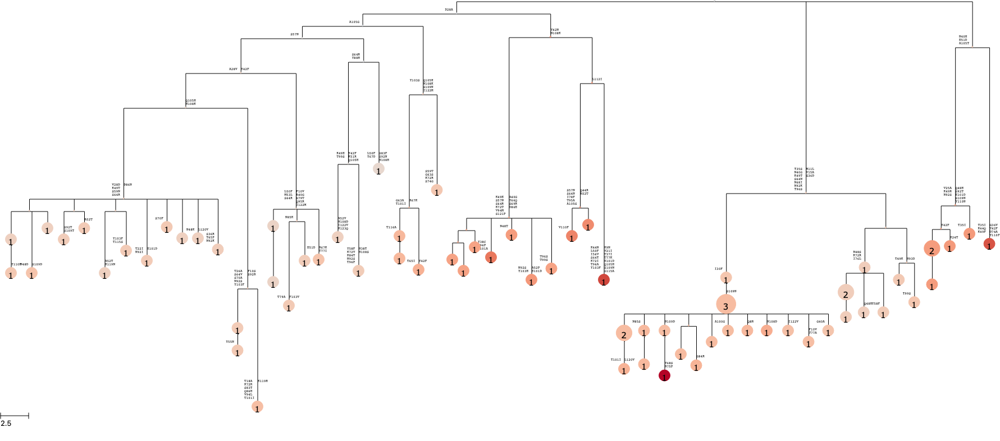

mouse8_GC86


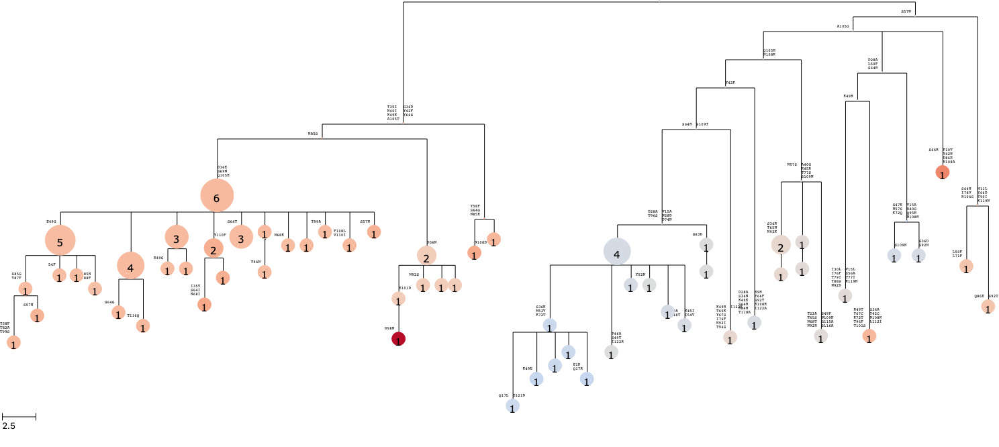

mouse8_GC87


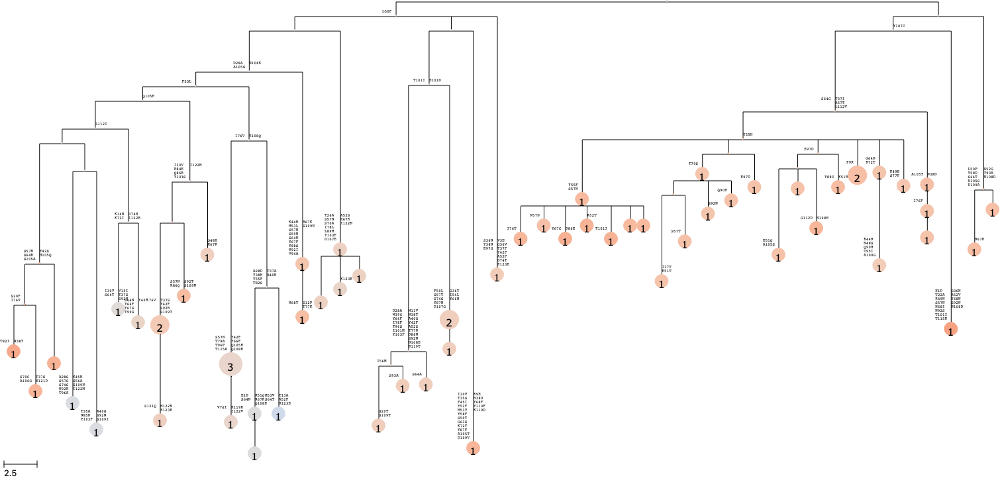

mouse8_GC88


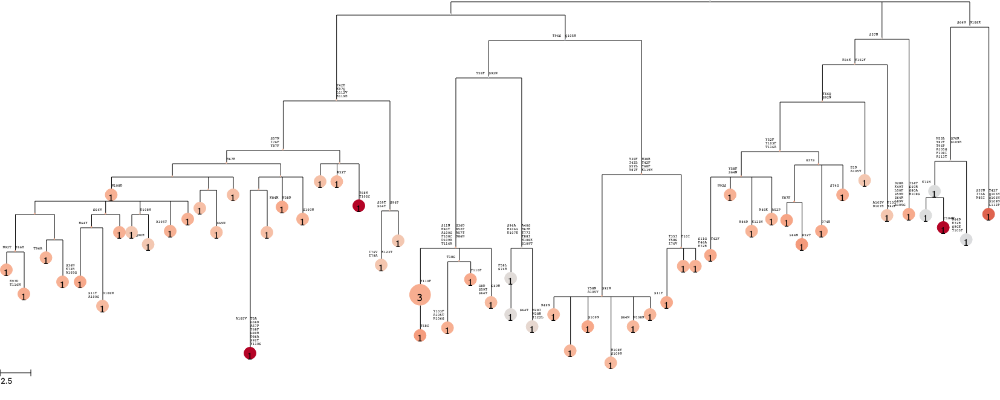

mouse8_GC89


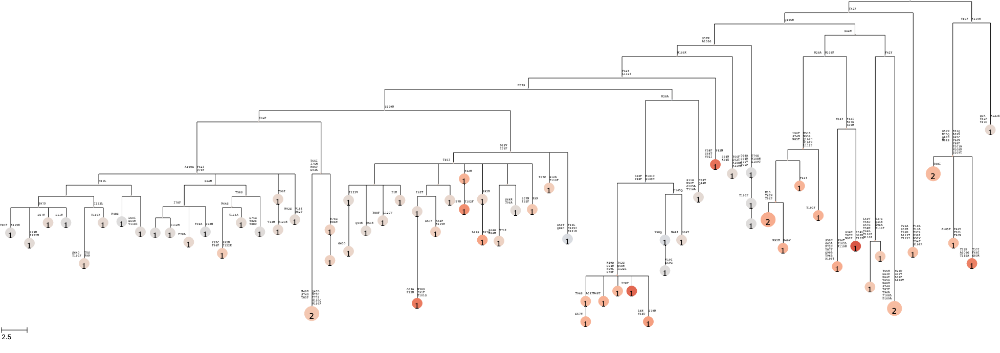

In [267]:
for gc, tree in trees.items():
    print(gc)
    colormap = tree.feature_colormap("delta_expr_additive", cmap='coolwarm_r', vmin=-2, vmax=2)
    for file in (f"output/plots/colormapped_gctrees/{gc}.delta_expr.svg", "%%inline"):
        rendering = tree.render(file, scale=20,
                            colormap=colormap,
                            frame=igh_frame, frame2=igk_frame, chain_split=igk_idx,
                            position_map=igh_pos_map, position_map2=igk_pos_map)
    display(rendering)

## Color map $\Delta$ polyspecificity

NOTE: colors inverted (blue still means "good")

mouse1_GC1


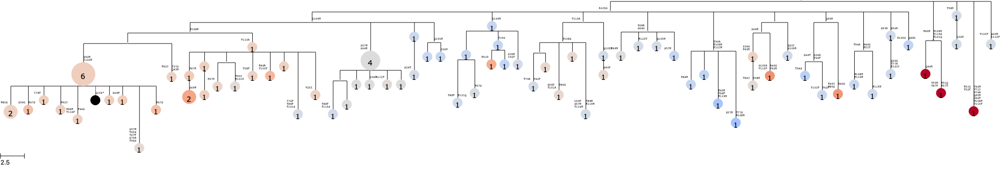

mouse1_GC2


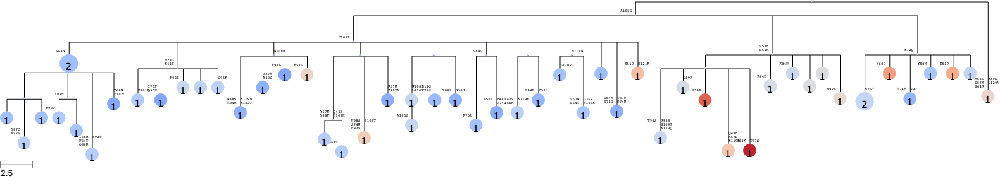

mouse1_GC3


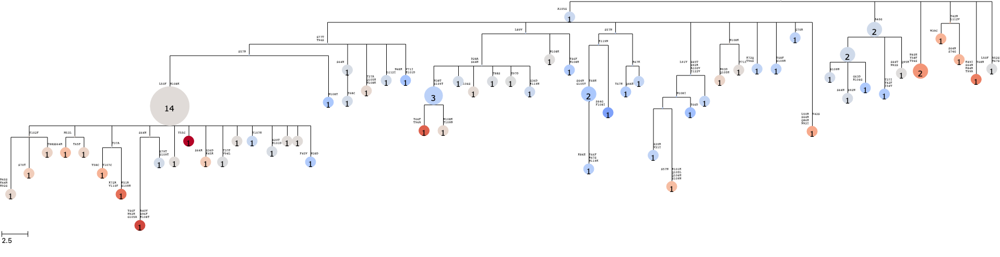

mouse1_GC4


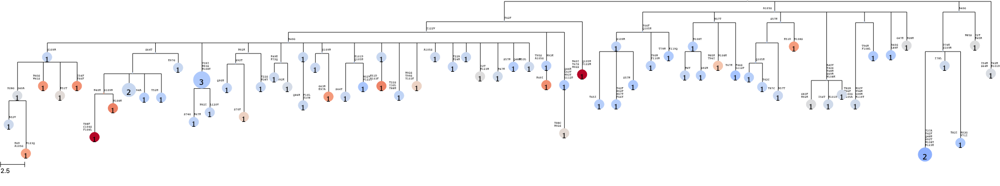

mouse1_GC5


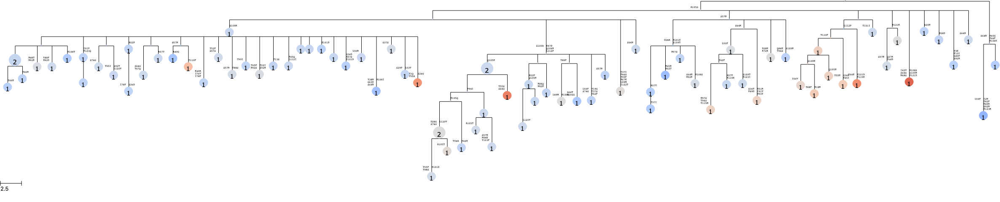

mouse1_GC6


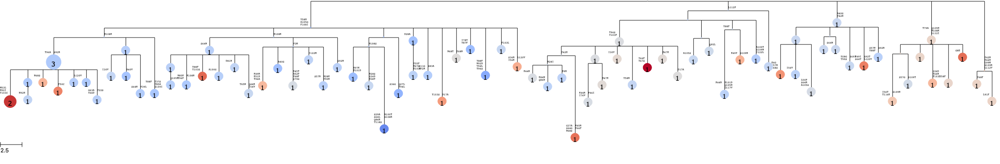

mouse1_GC7


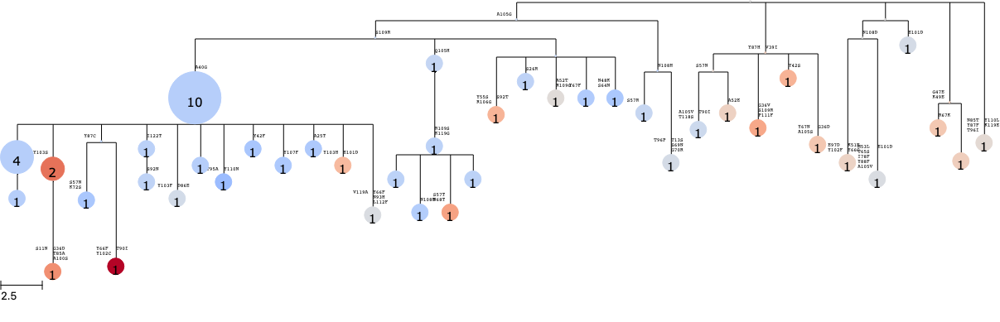

mouse1_GC11


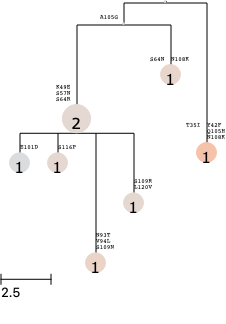

mouse1_GC12


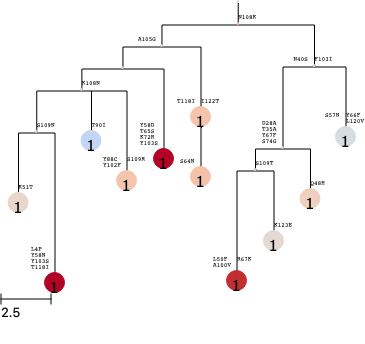

mouse1_GC13


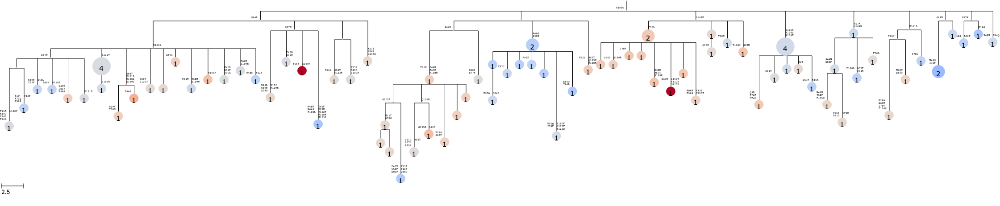

mouse1_GC14


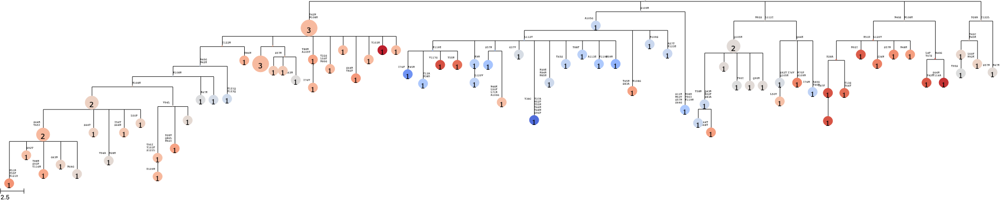

mouse1_GC15


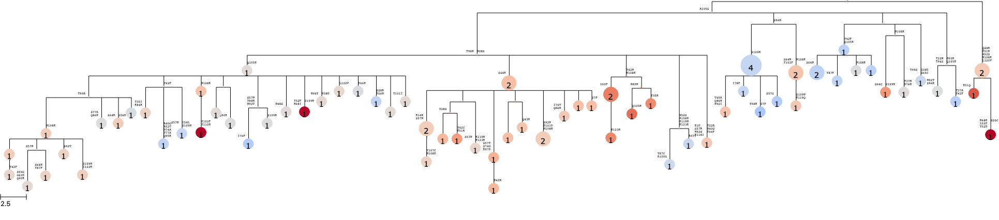

mouse1_GC16


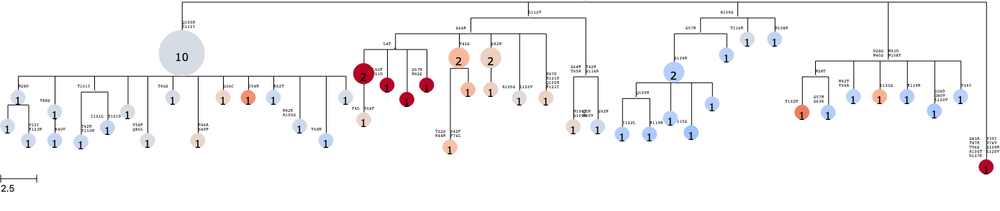

mouse1_GC17


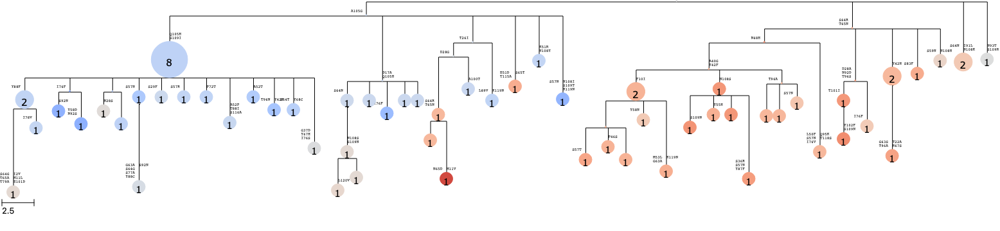

mouse1_GC18


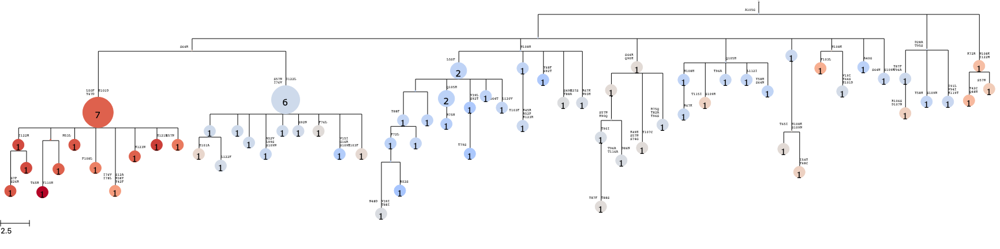

mouse1_GC19


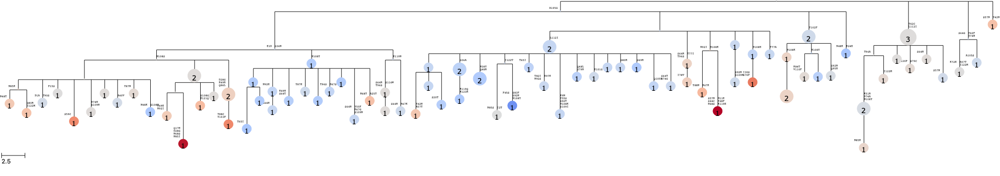

mouse1_GC20


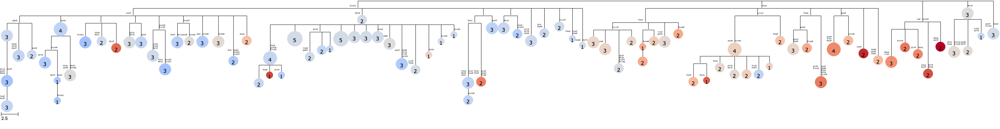

mouse2_GC21


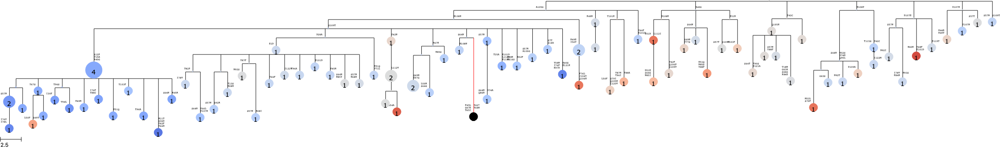

mouse2_GC22


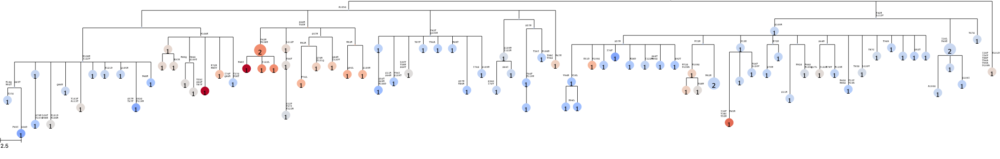

mouse2_GC23


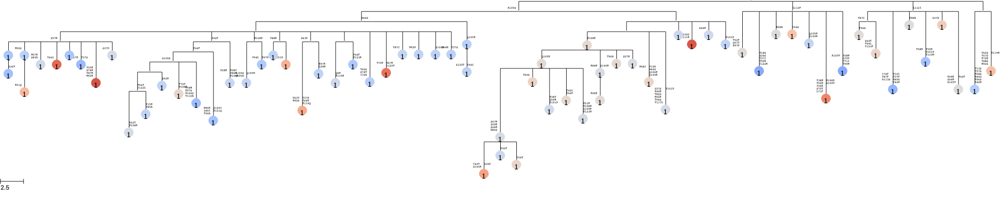

mouse2_GC24


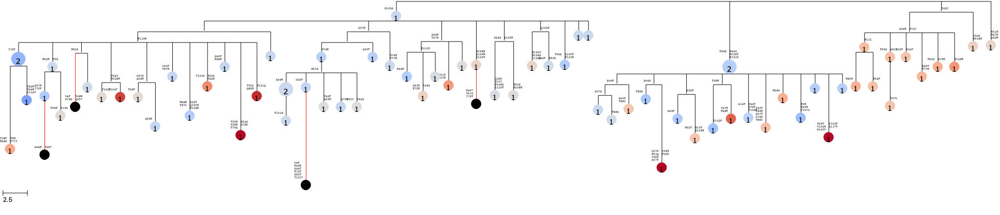

mouse2_GC25


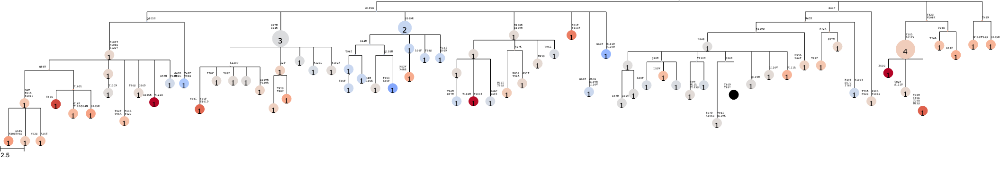

mouse2_GC26


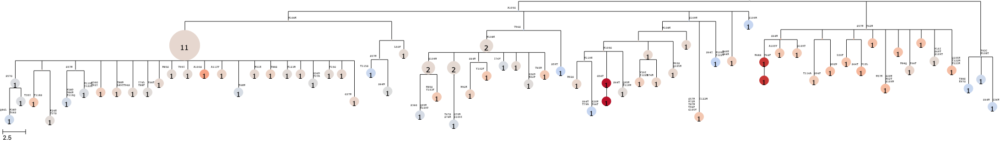

mouse2_GC28


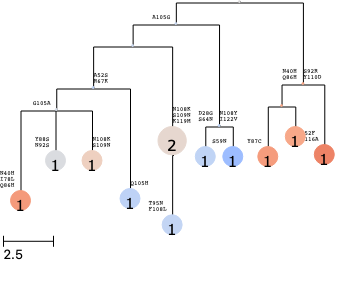

mouse2_GC29


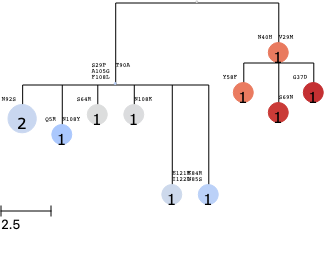

mouse2_GC30


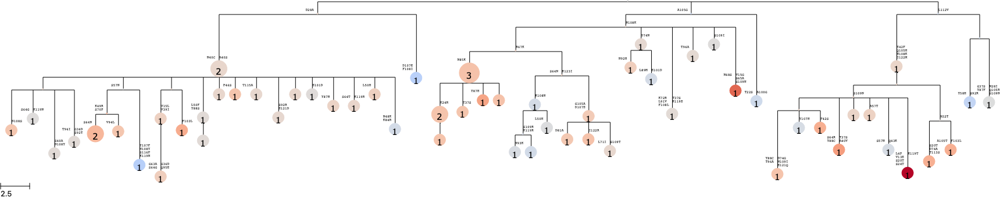

mouse2_GC31


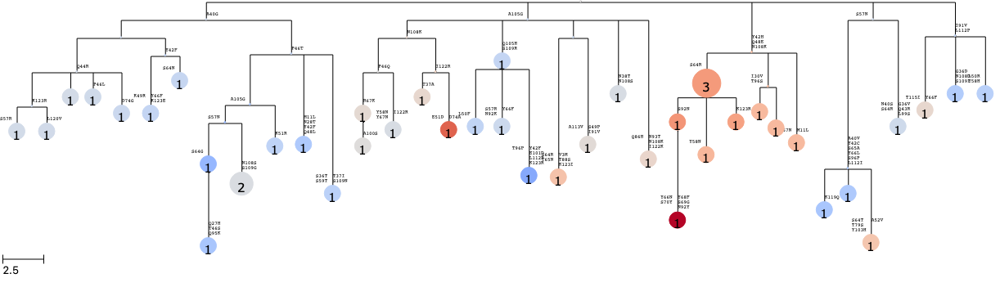

mouse2_GC32


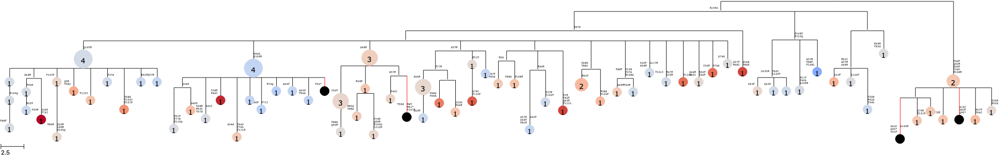

mouse2_GC34


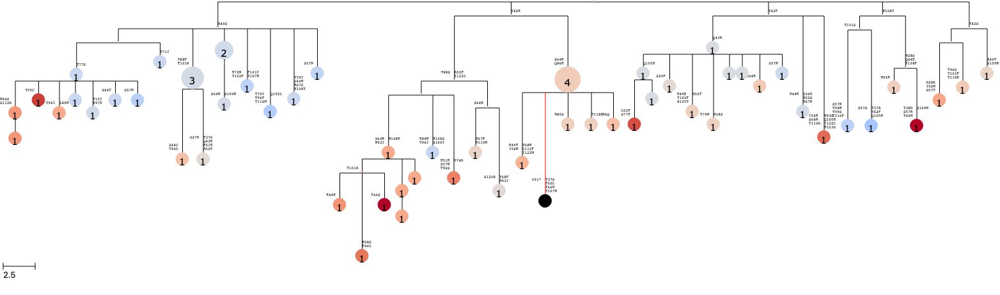

mouse2_GC38


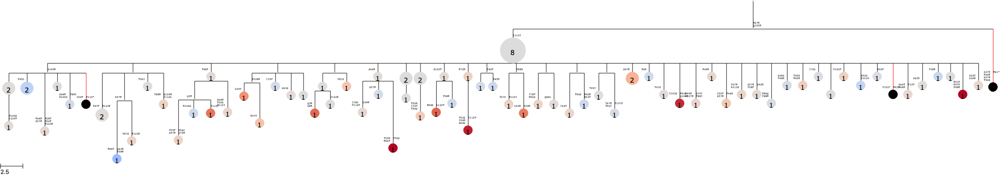

mouse2_GC39


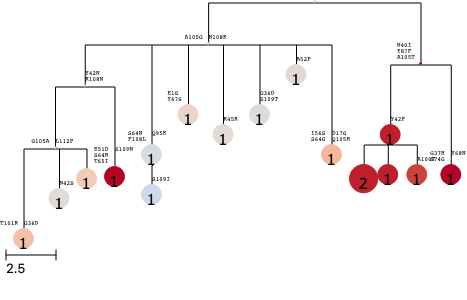

mouse2_GC40


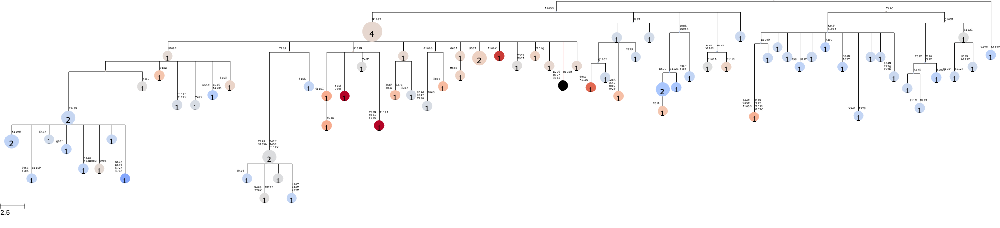

mouse3_GC41


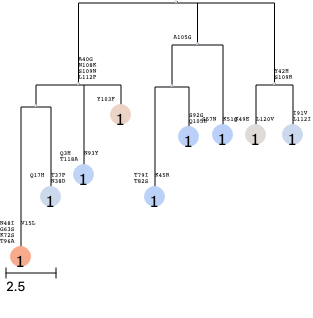

mouse3_GC42


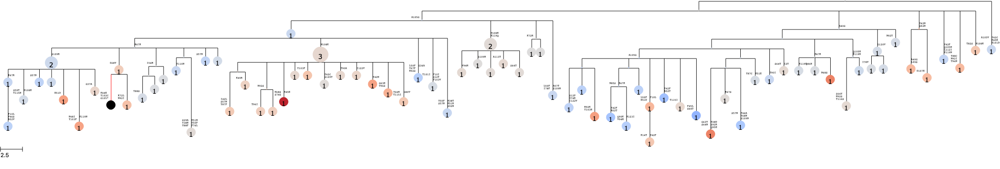

mouse3_GC43


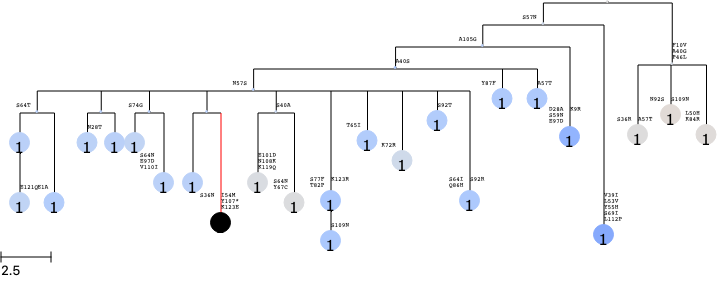

mouse3_GC44


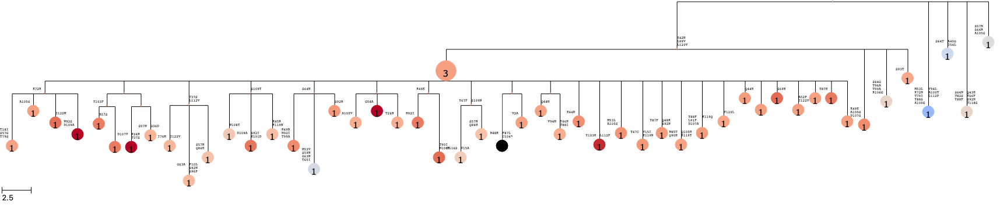

mouse3_GC45


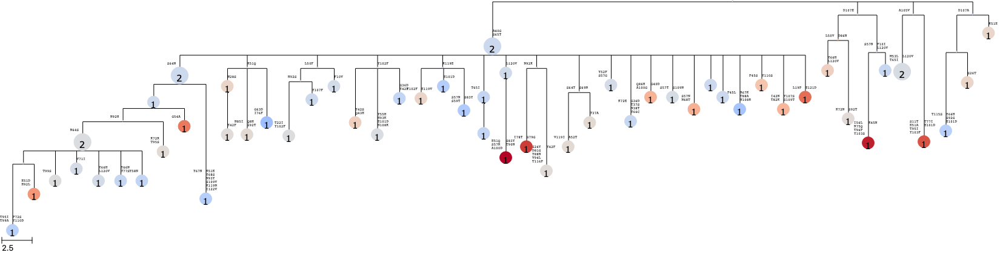

mouse3_GC46


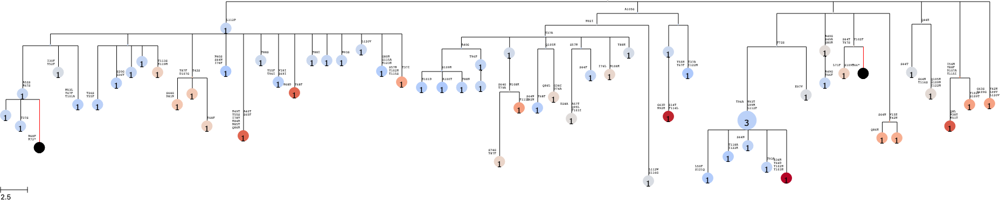

mouse3_GC55


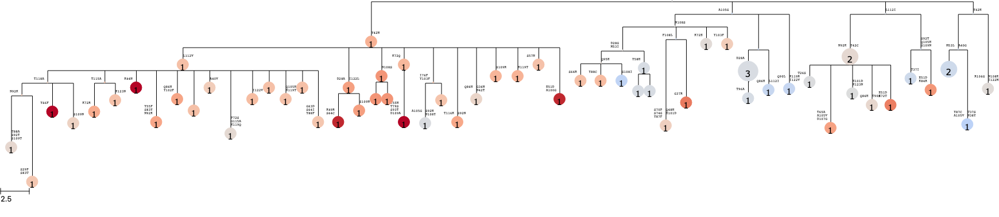

mouse3_GC56


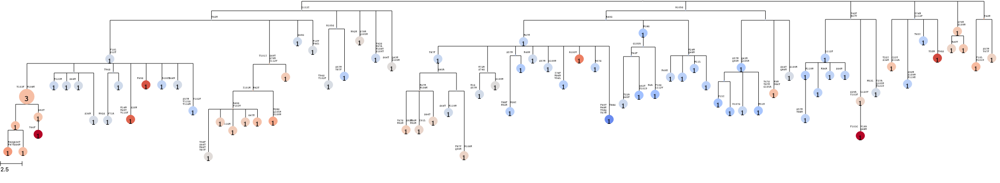

mouse3_GC57


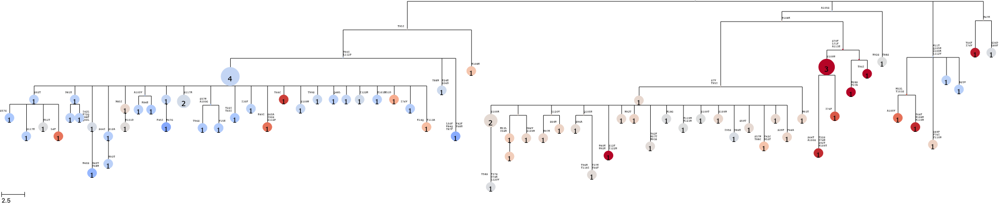

mouse3_GC58


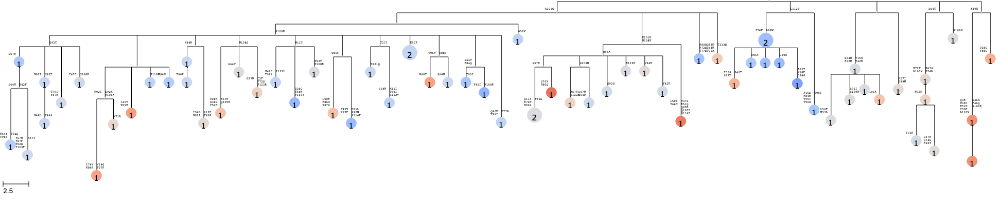

mouse3_GC59


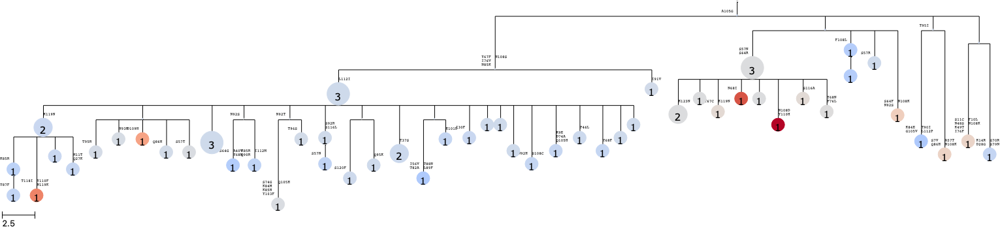

mouse3_GC64


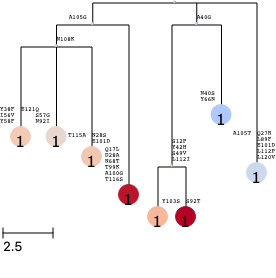

mouse3_GC65


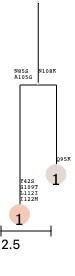

mouse3_GC66


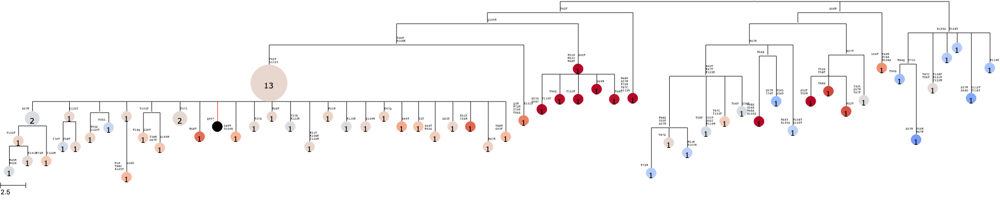

mouse3_GC72


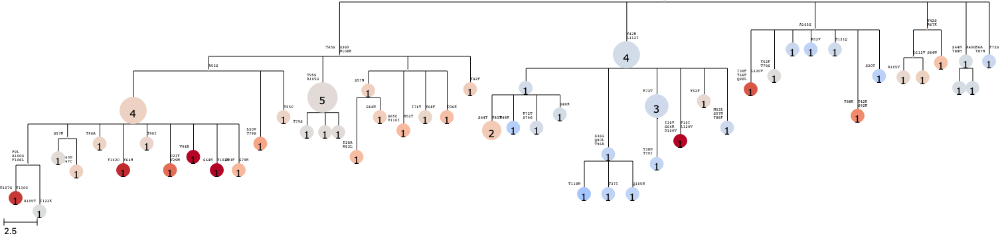

mouse4_GC47


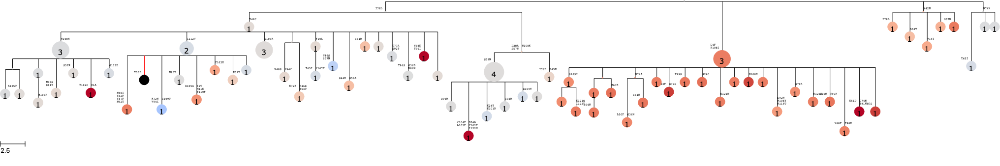

mouse4_GC48


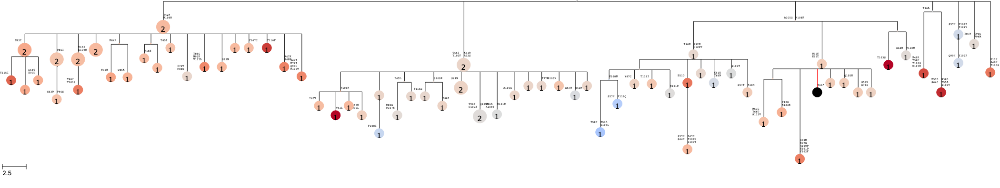

mouse4_GC50


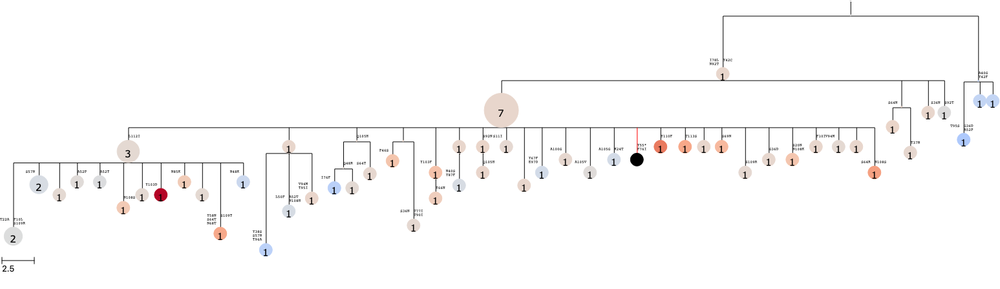

mouse4_GC63


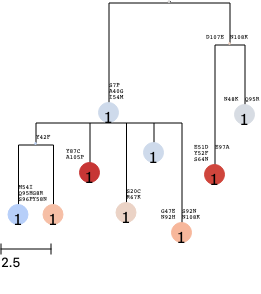

mouse4_GC67


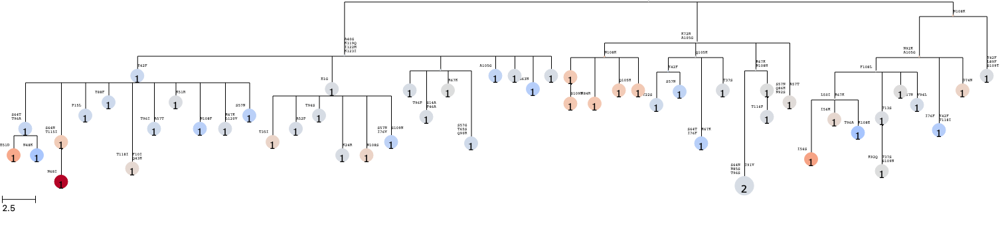

mouse4_GC68


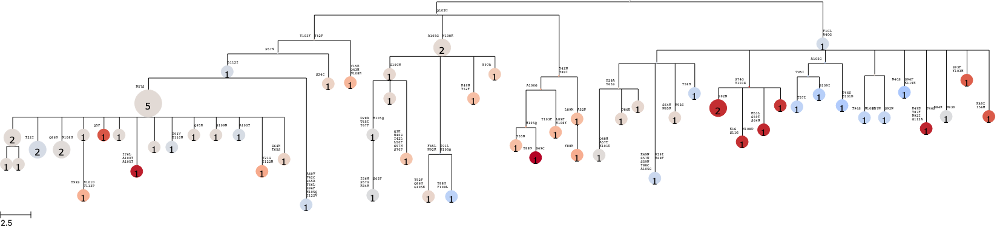

mouse4_GC69


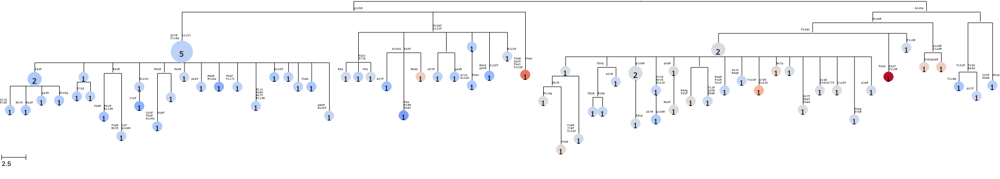

mouse4_GC70


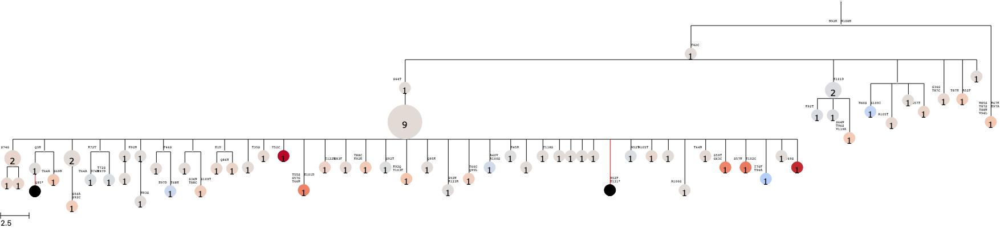

mouse4_GC71


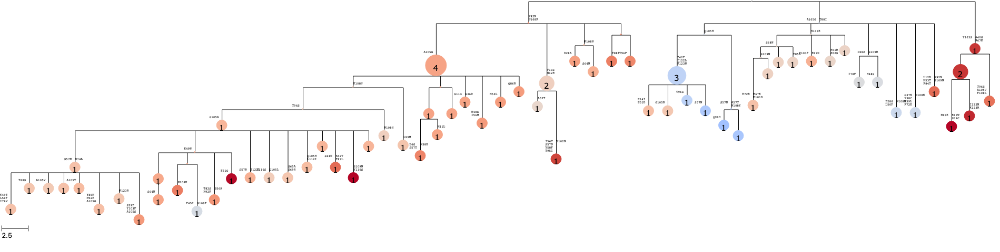

mouse4_GC73


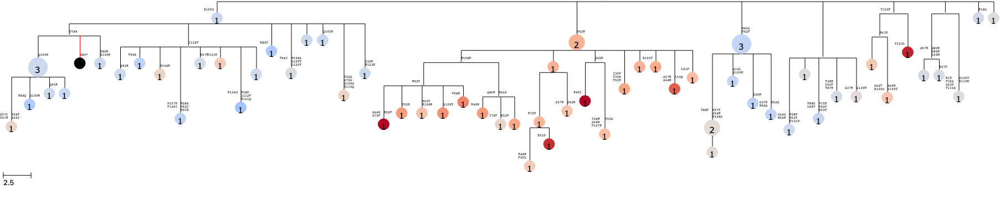

mouse5_GC78


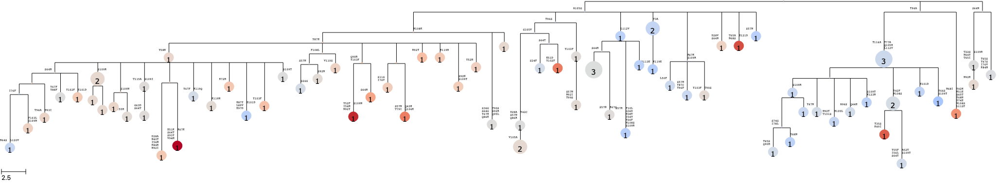

mouse5_GC79


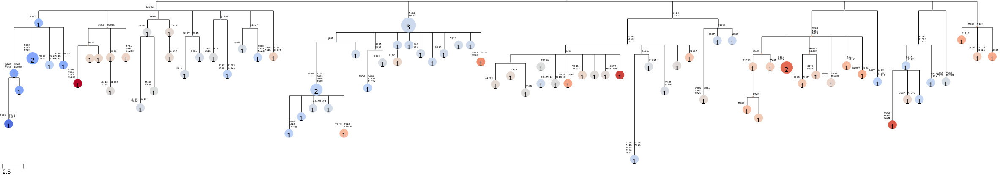

mouse5_GC80


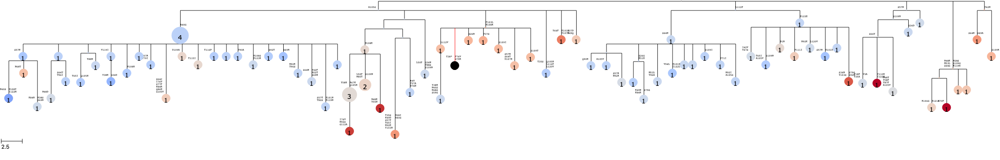

mouse5_GC81


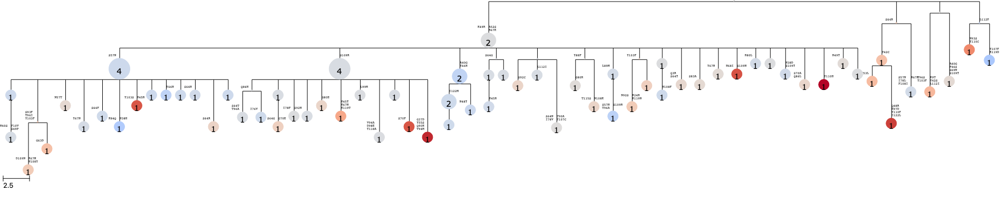

mouse5_GC82


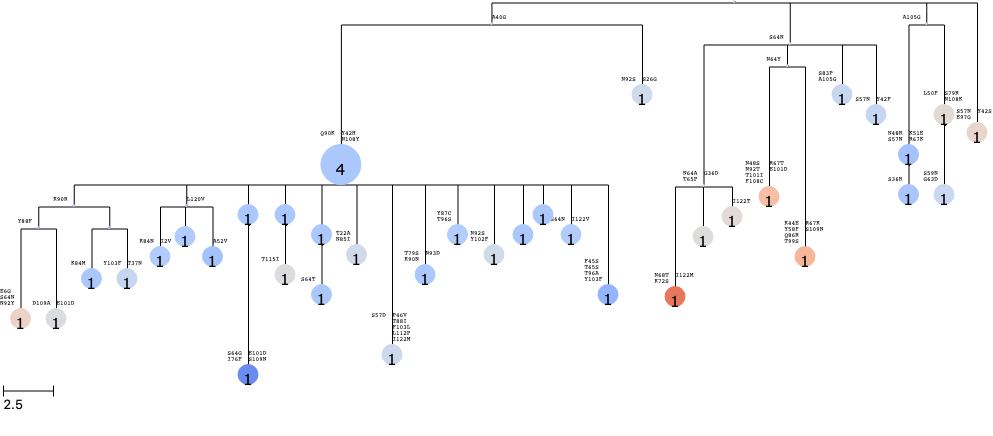

mouse5_GC83


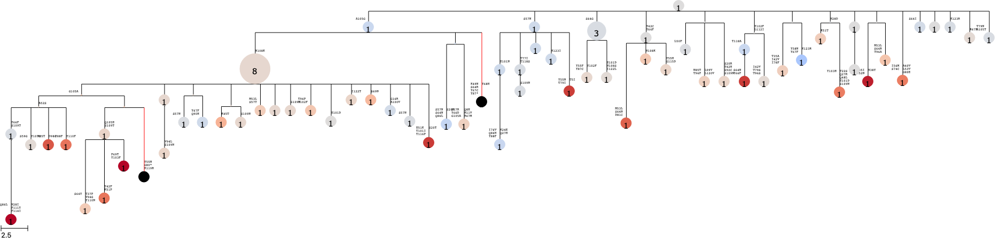

mouse6_GC74


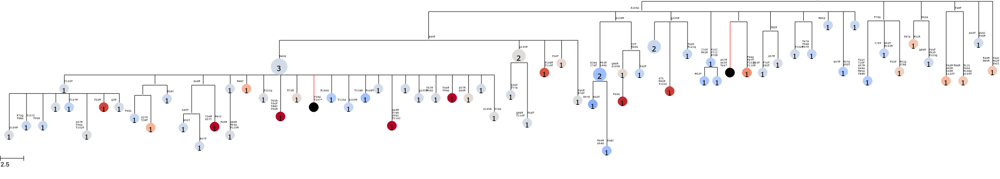

mouse6_GC75


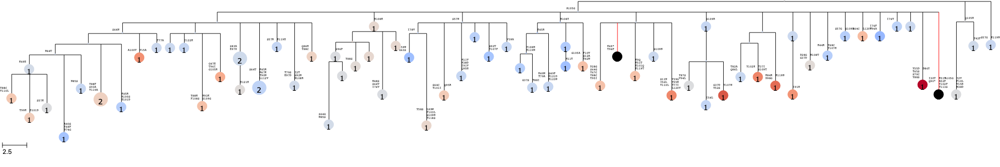

mouse6_GC76


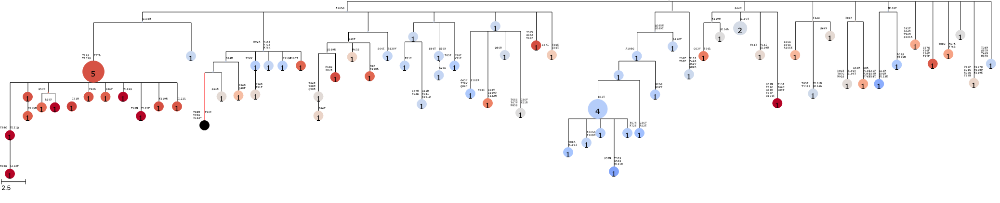

mouse6_GC77


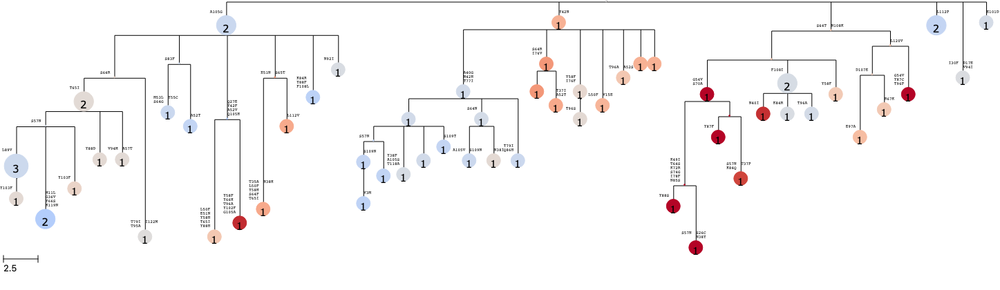

mouse7_GC90


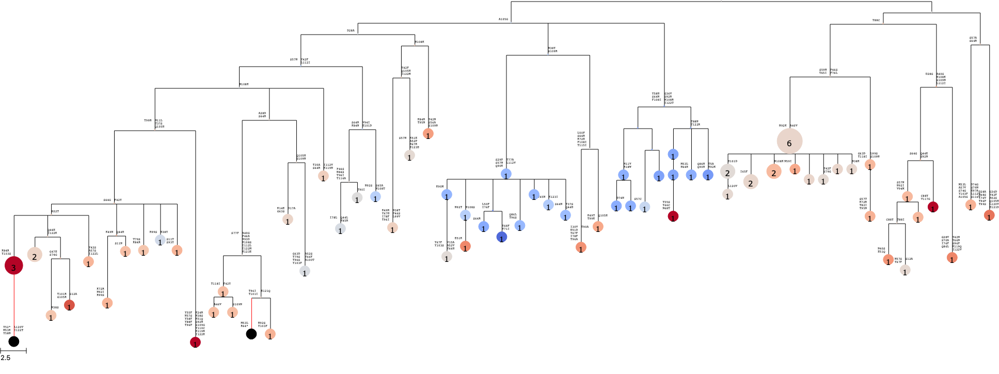

mouse8_GC84


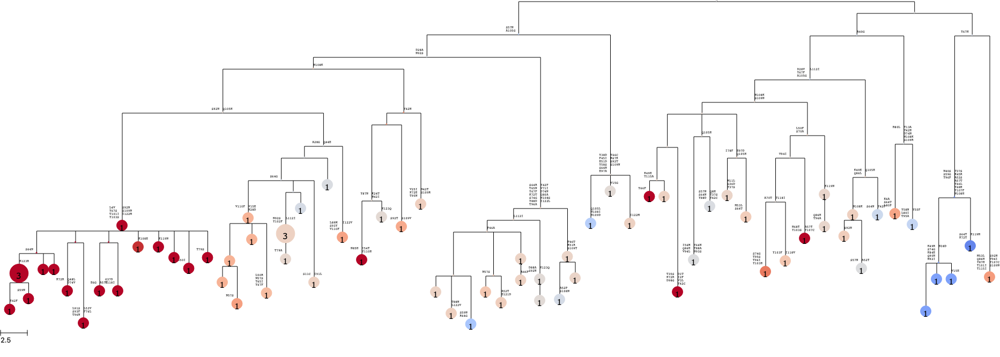

mouse8_GC85


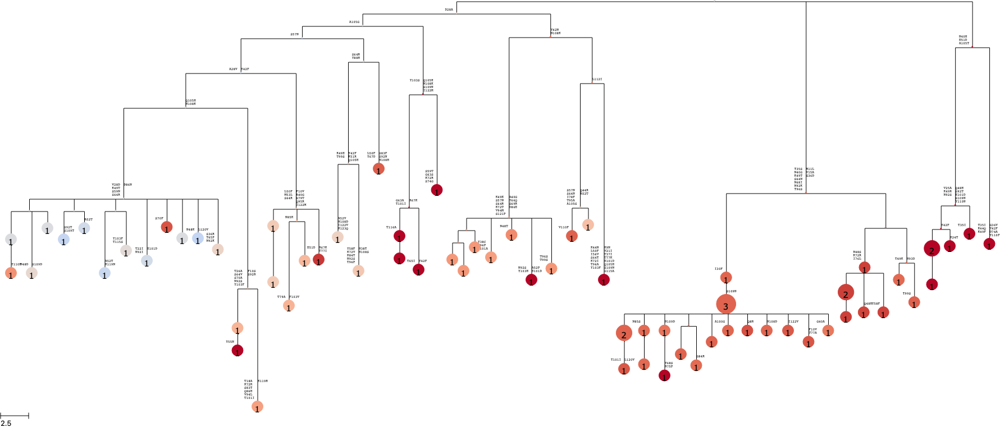

mouse8_GC86


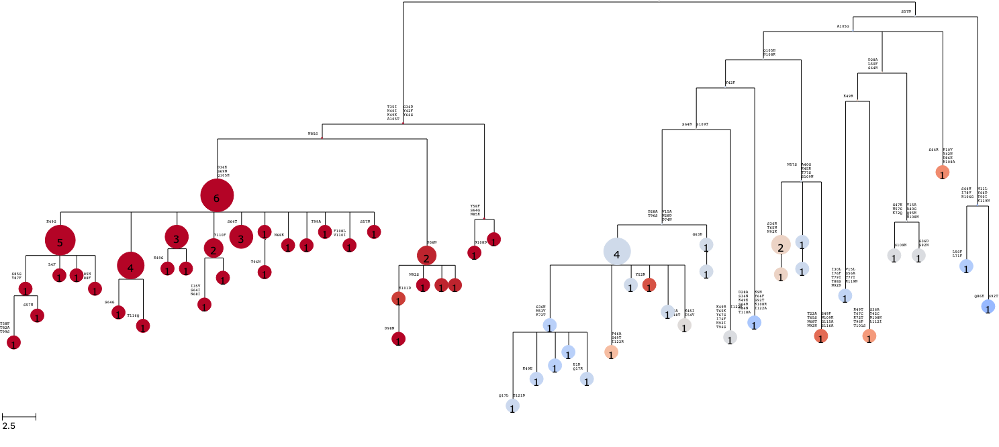

mouse8_GC87


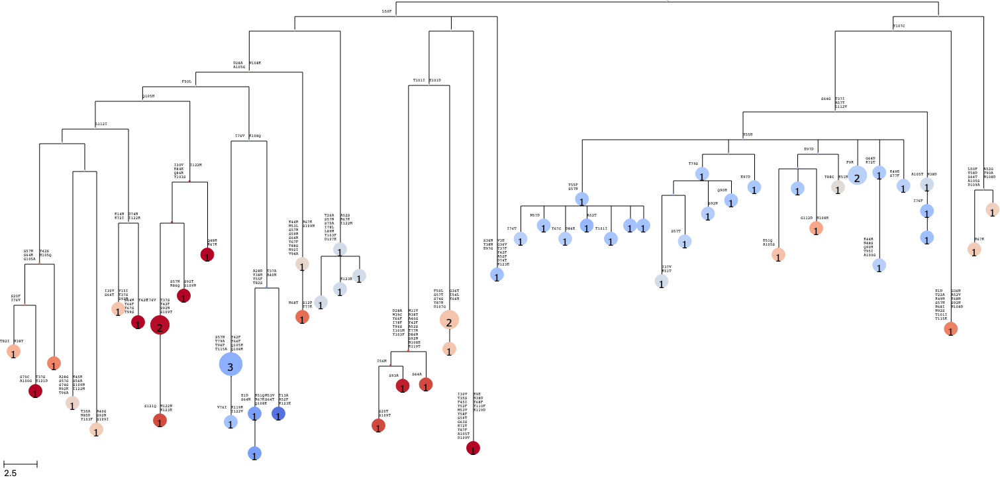

mouse8_GC88


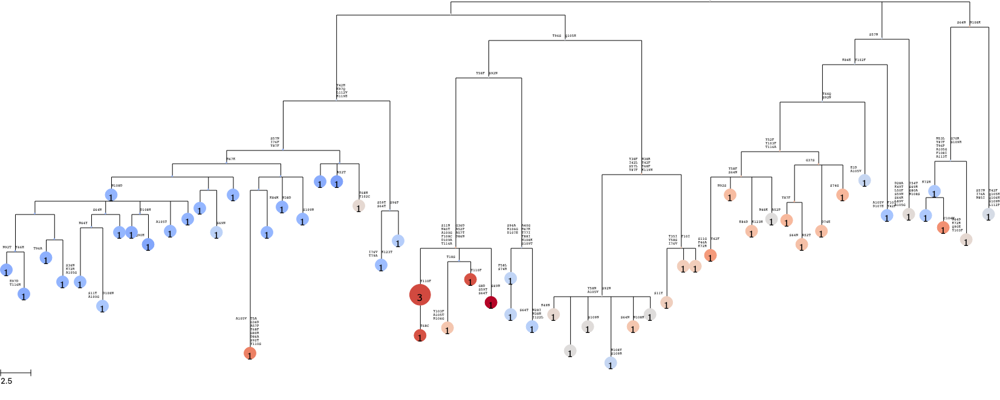

mouse8_GC89


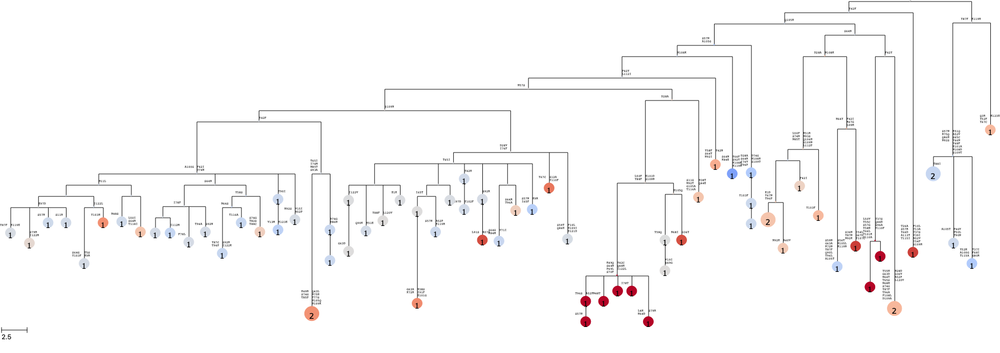

In [268]:
for gc, tree in trees.items():
    print(gc)
    colormap = tree.feature_colormap("delta_psr_additive", cmap='coolwarm', vmin=-2, vmax=2)
    for file in (f"output/plots/colormapped_gctrees/{gc}.delta_psr.svg", "%%inline"):
        rendering = tree.render(file, scale=20,
                            colormap=colormap,
                            frame=igh_frame, frame2=igk_frame, chain_split=igk_idx,
                            position_map=igh_pos_map, position_map2=igk_pos_map)
    display(rendering)

## Color map local branching index (LBI or LBR)

mouse1_GC1


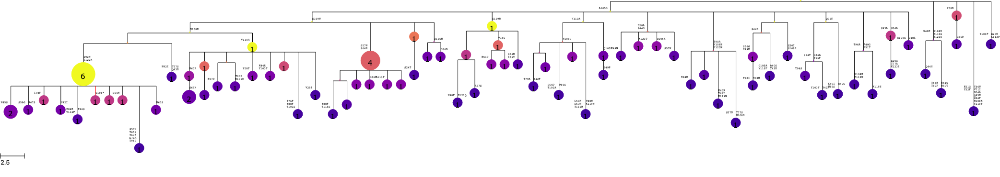

mouse1_GC2


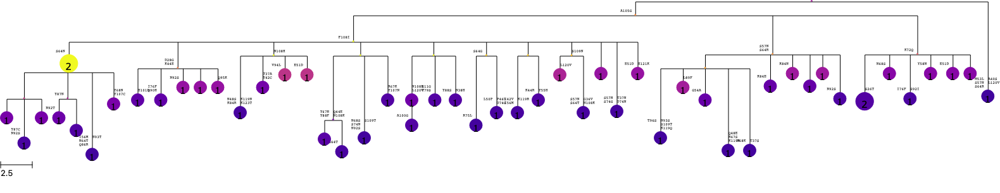

mouse1_GC3


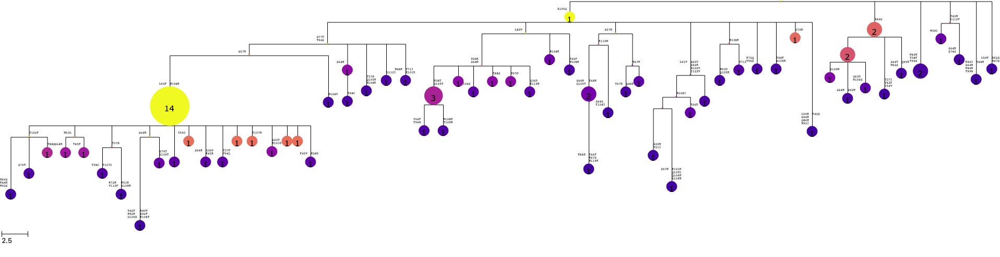

mouse1_GC4


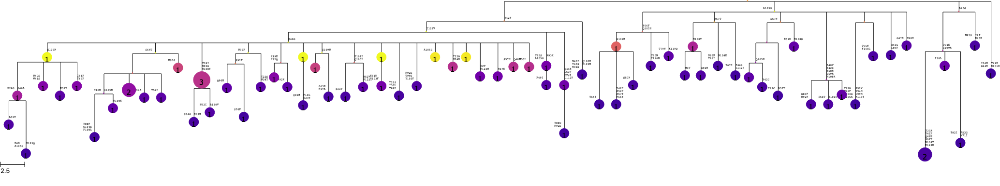

mouse1_GC5


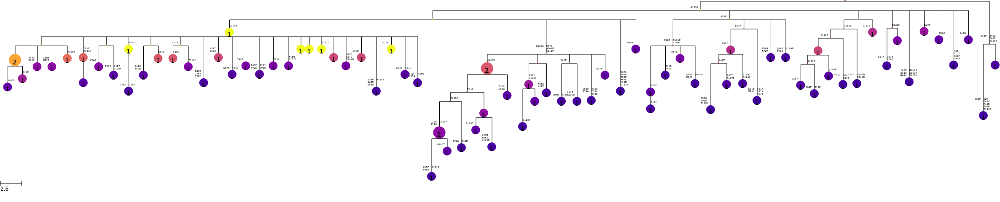

mouse1_GC6


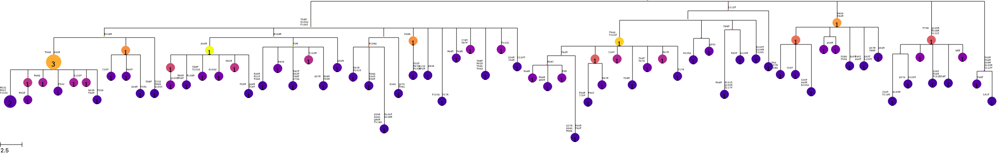

mouse1_GC7


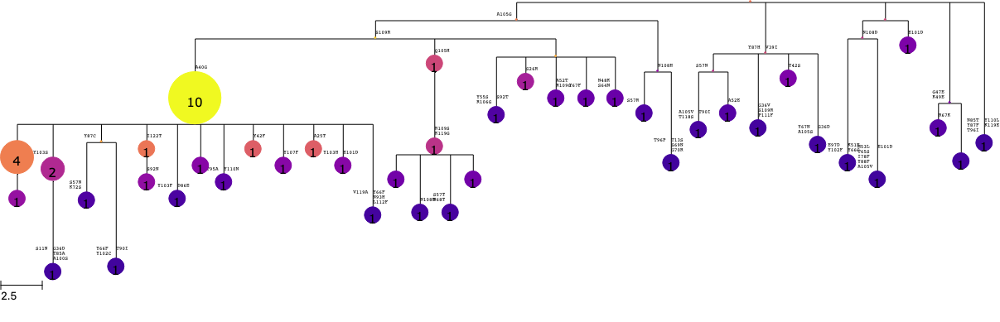

mouse1_GC11


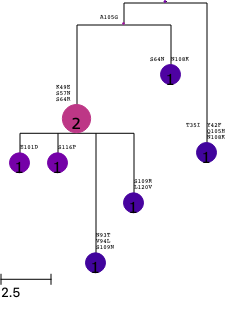

mouse1_GC12


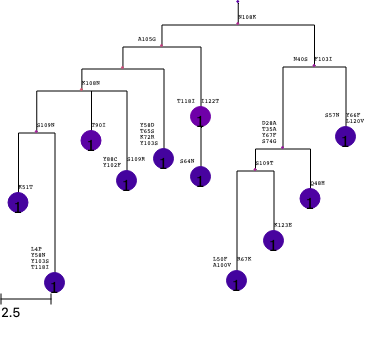

mouse1_GC13


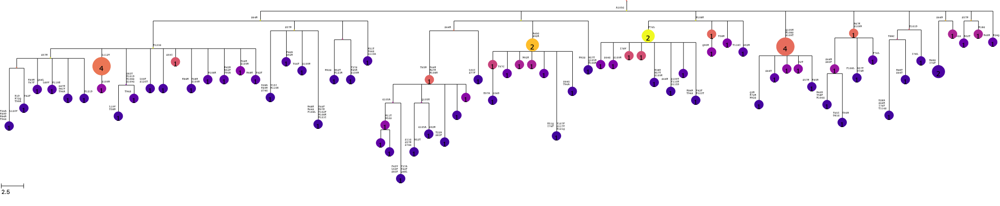

mouse1_GC14


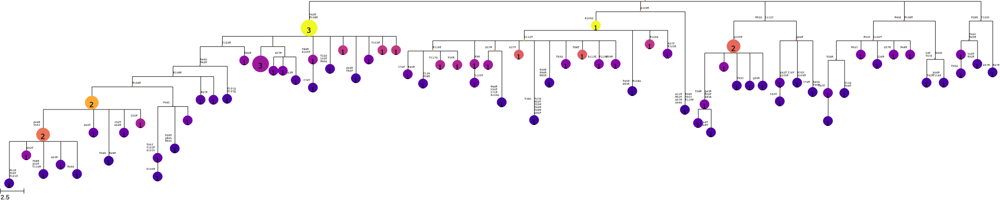

mouse1_GC15


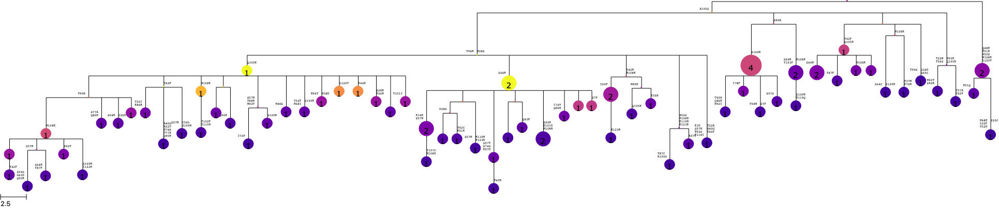

mouse1_GC16


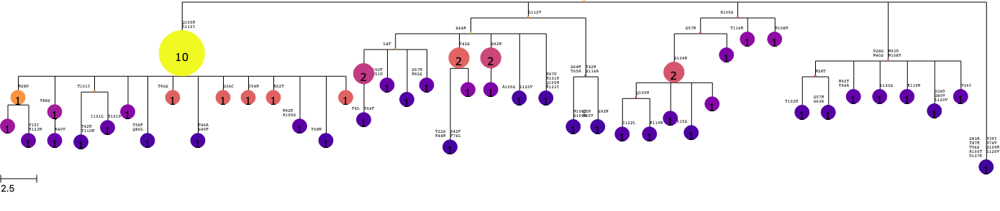

mouse1_GC17


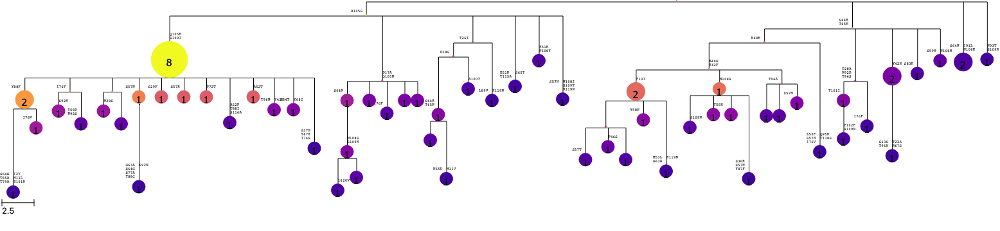

mouse1_GC18


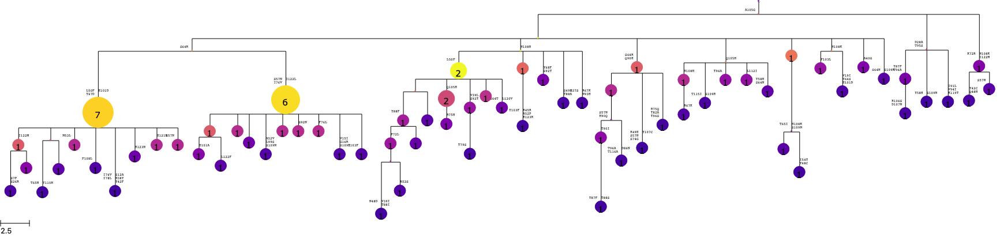

mouse1_GC19


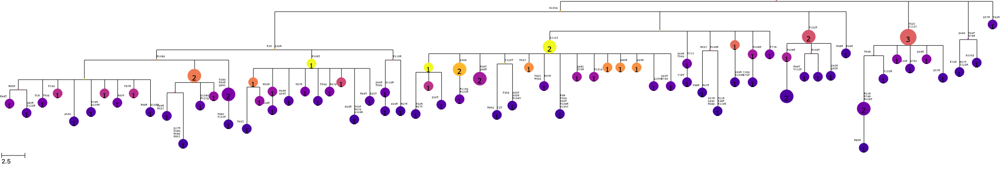

mouse1_GC20


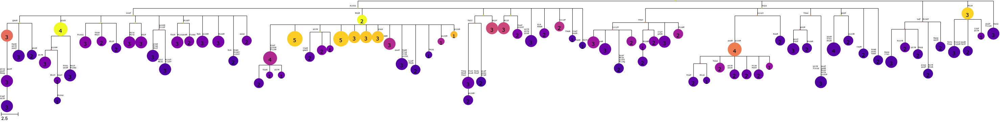

mouse2_GC21


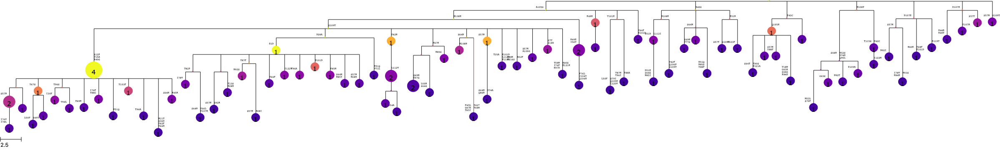

mouse2_GC22


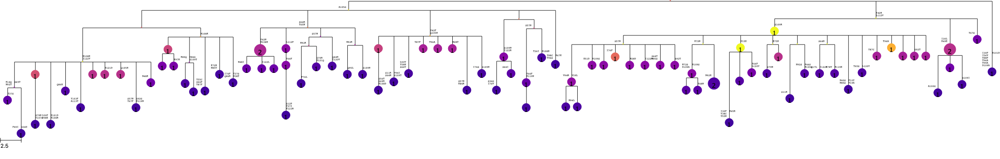

mouse2_GC23


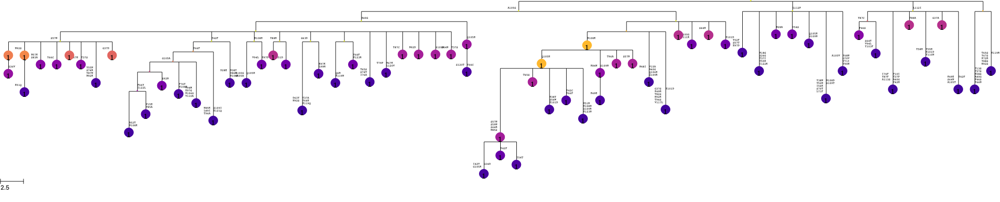

mouse2_GC24


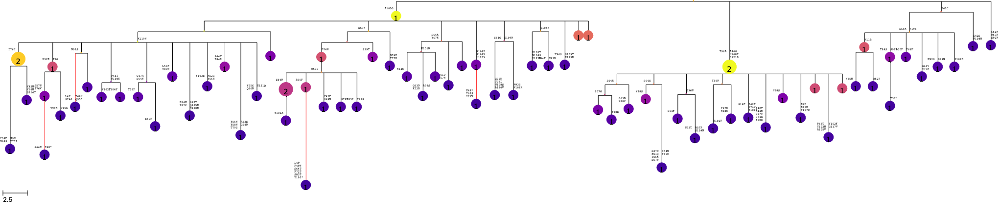

mouse2_GC25


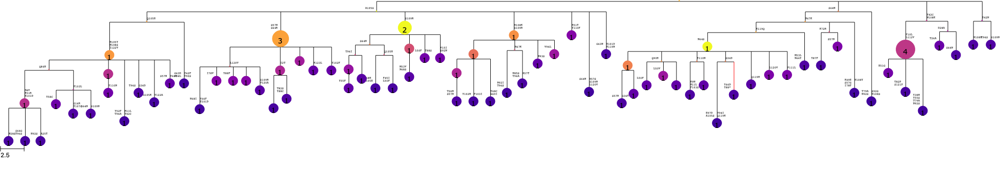

mouse2_GC26


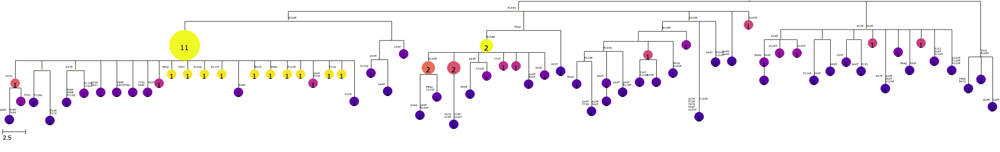

mouse2_GC28


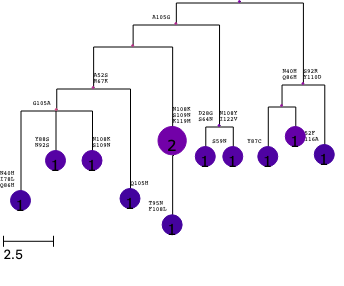

mouse2_GC29


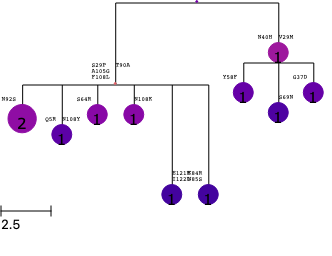

mouse2_GC30


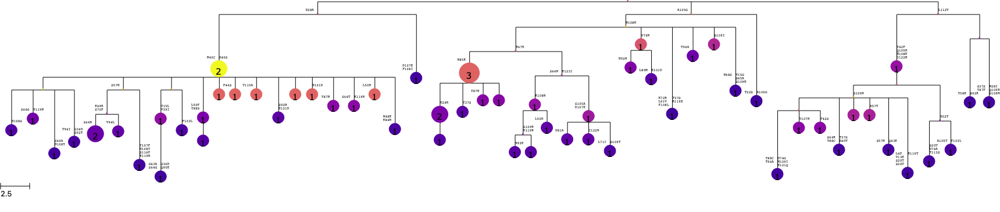

mouse2_GC31


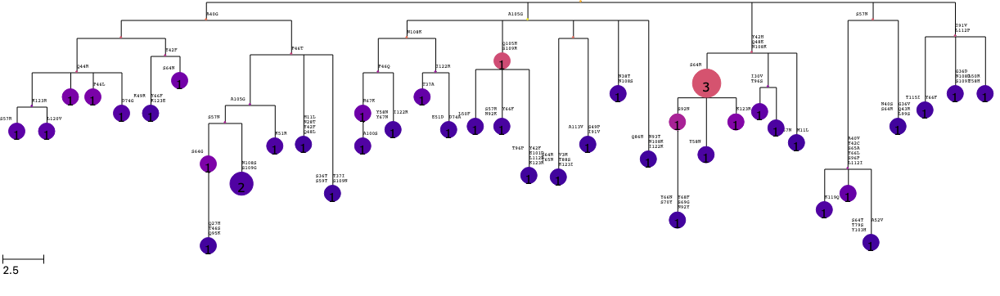

mouse2_GC32


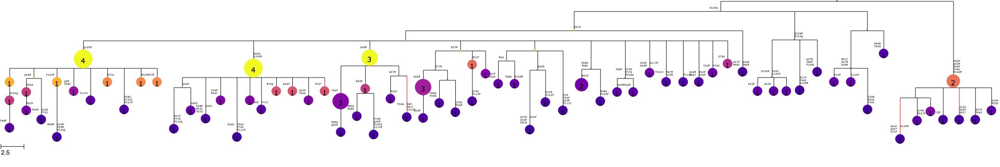

mouse2_GC34


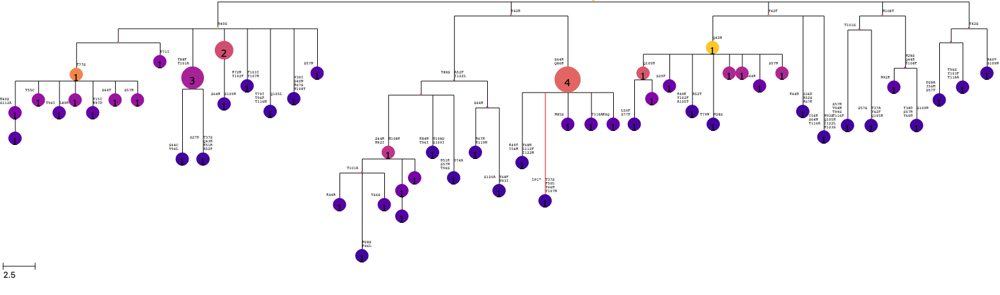

mouse2_GC38


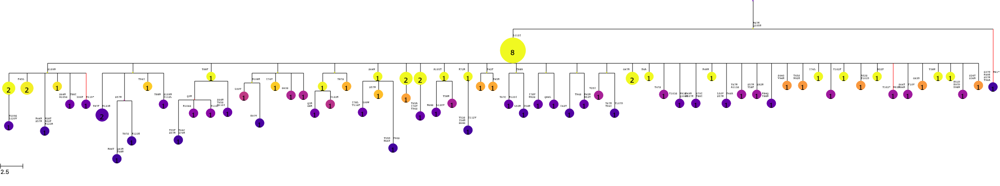

mouse2_GC39


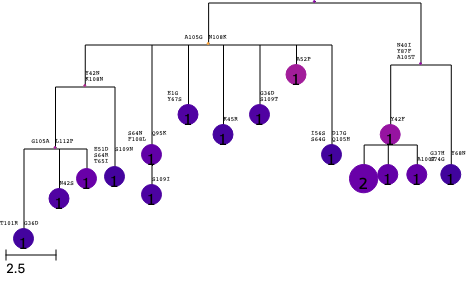

mouse2_GC40


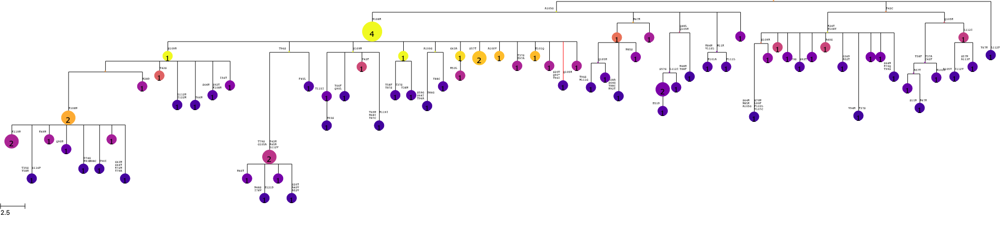

mouse3_GC41


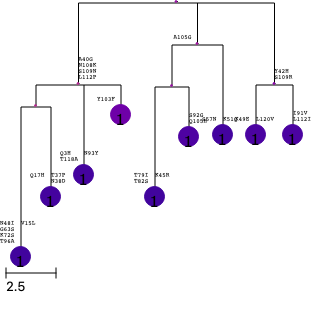

mouse3_GC42


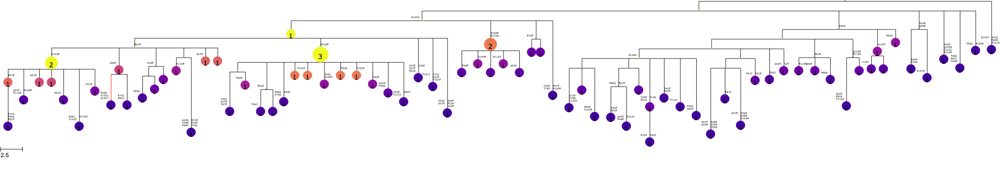

mouse3_GC43


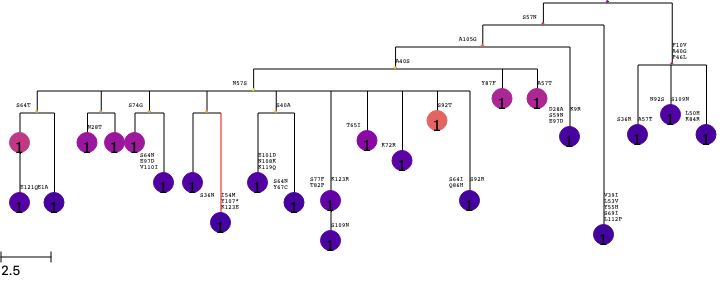

mouse3_GC44


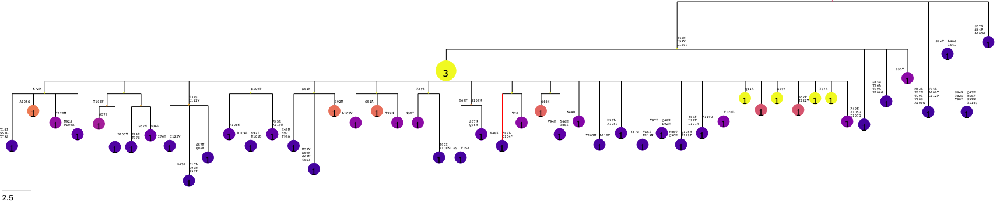

mouse3_GC45


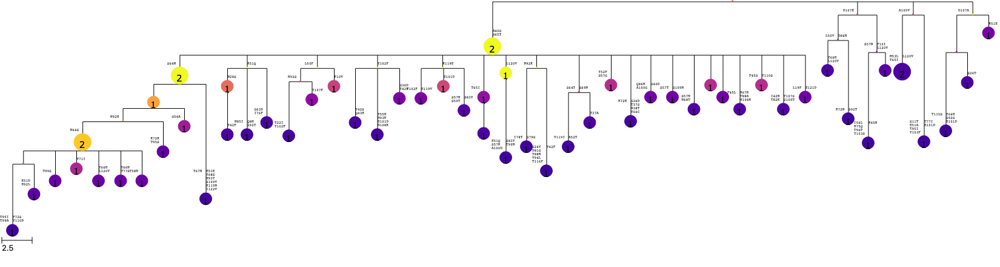

mouse3_GC46


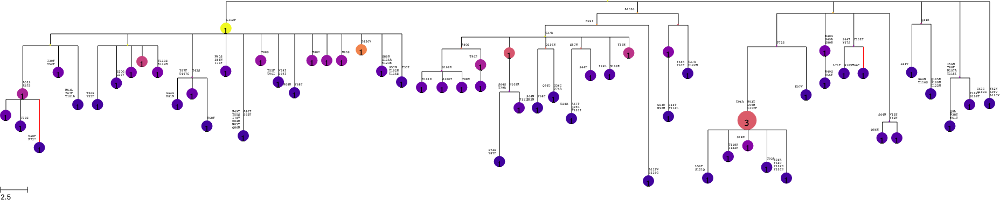

mouse3_GC55


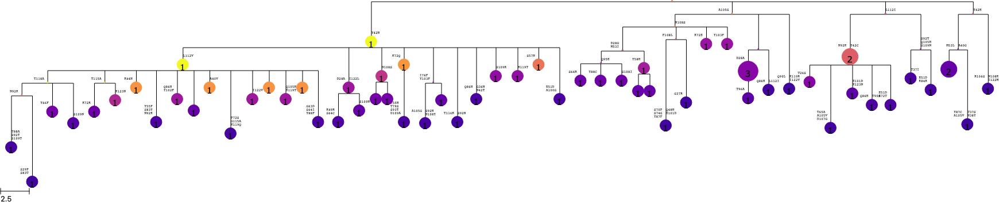

mouse3_GC56


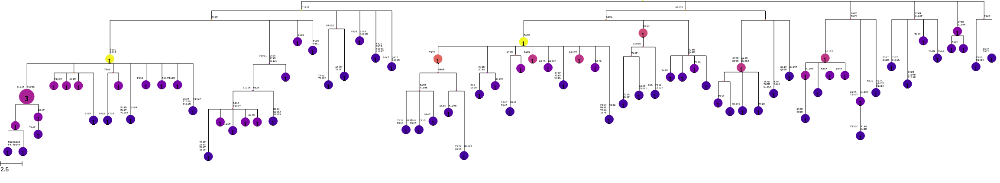

mouse3_GC57


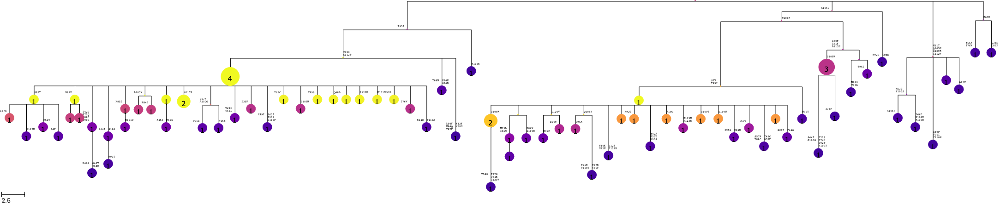

mouse3_GC58


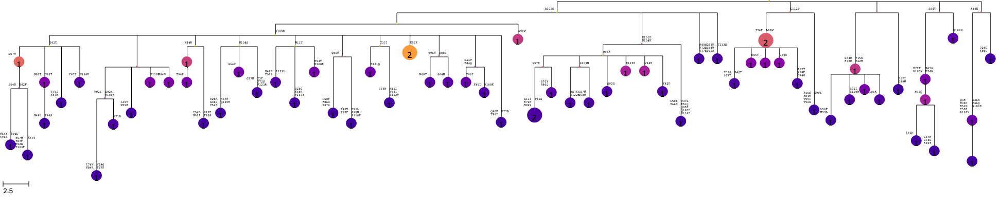

mouse3_GC59


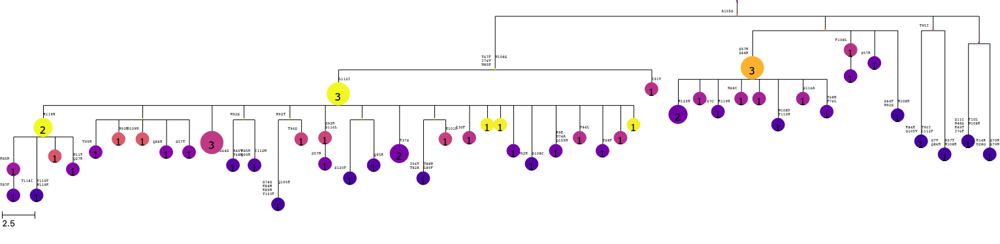

mouse3_GC64


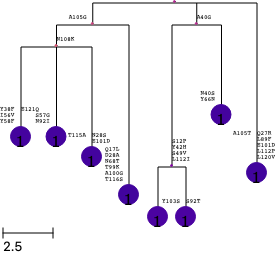

mouse3_GC65


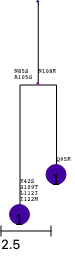

mouse3_GC66


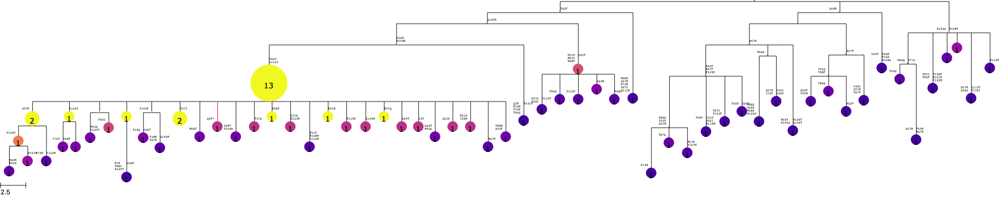

mouse3_GC72


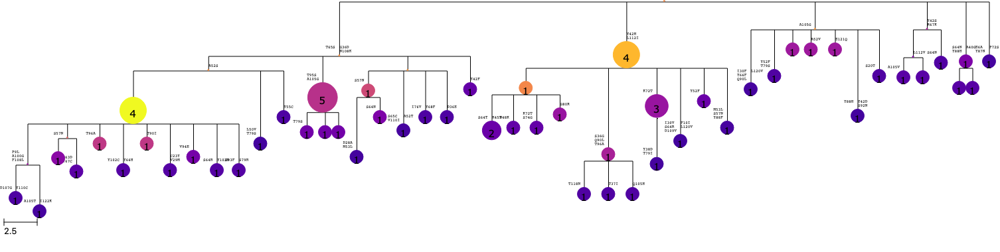

mouse4_GC47


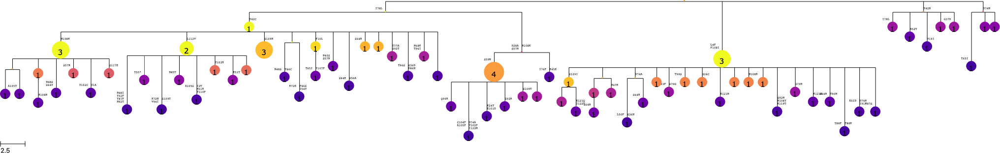

mouse4_GC48


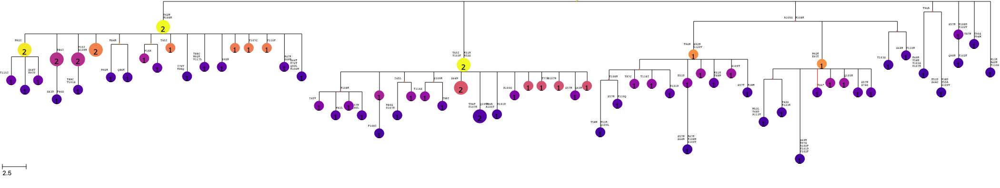

mouse4_GC50


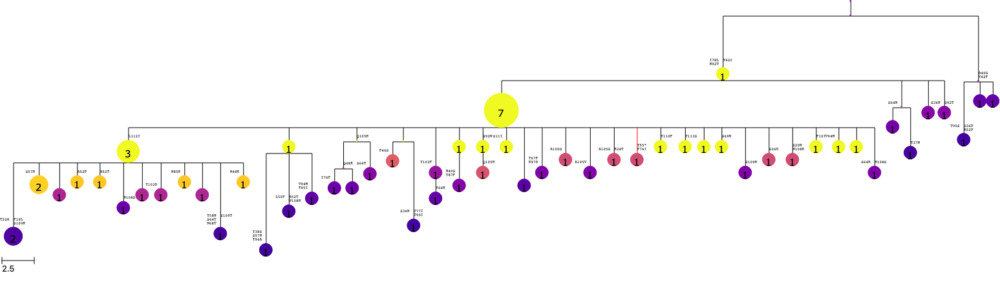

mouse4_GC63


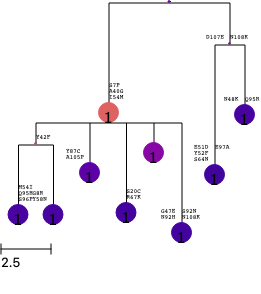

mouse4_GC67


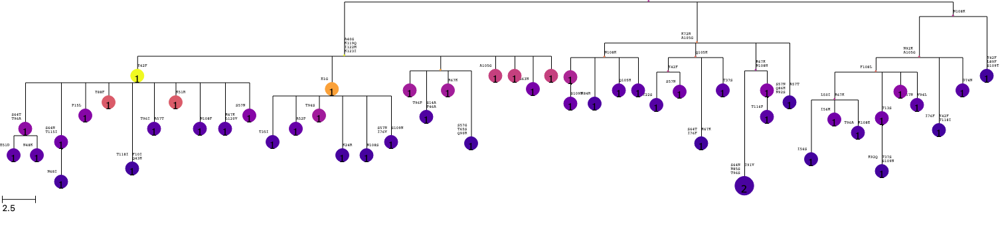

mouse4_GC68


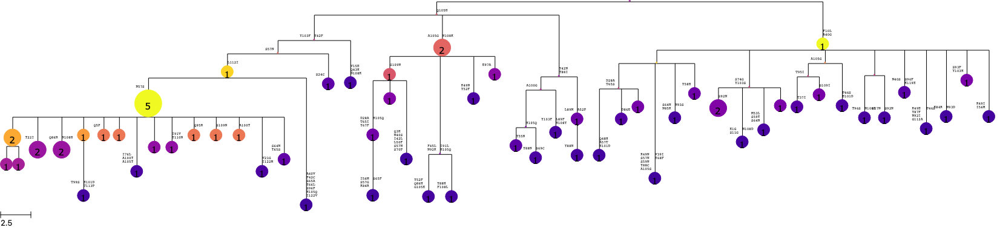

mouse4_GC69


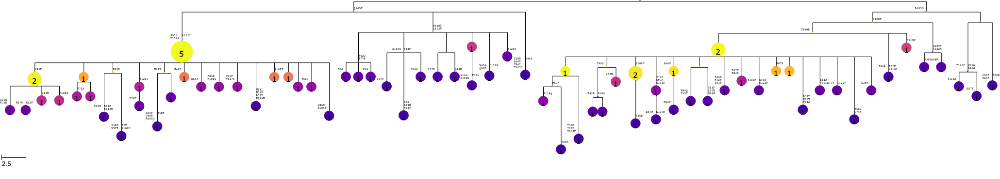

mouse4_GC70


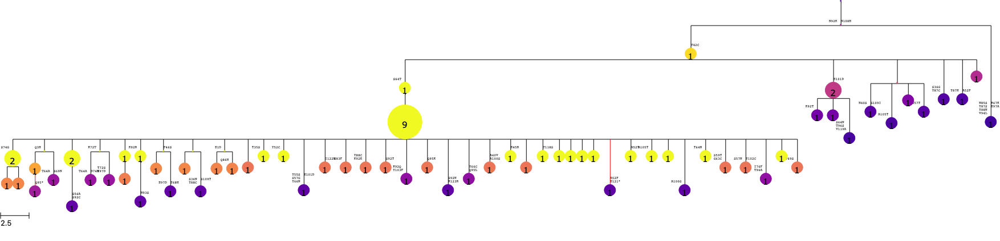

mouse4_GC71


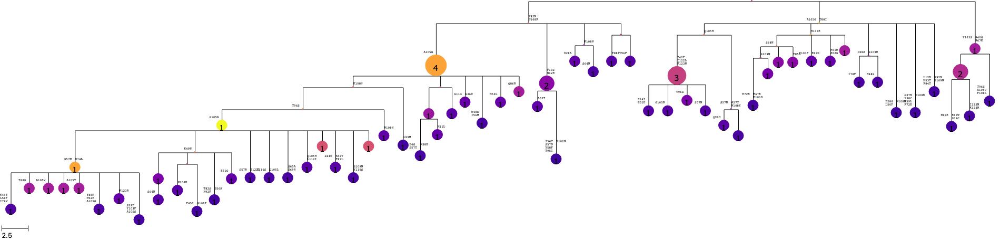

mouse4_GC73


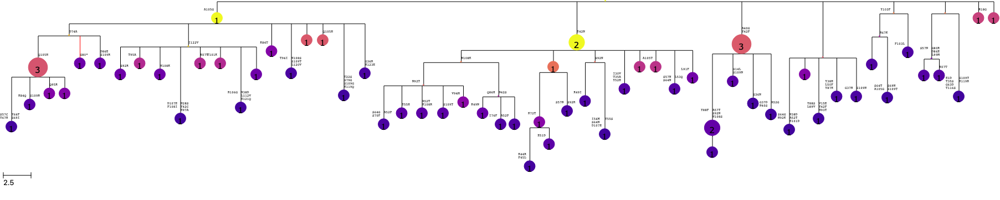

mouse5_GC78


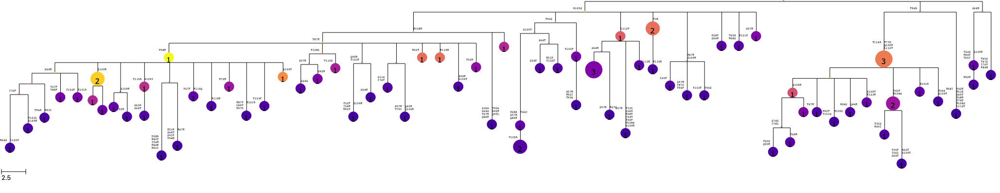

mouse5_GC79


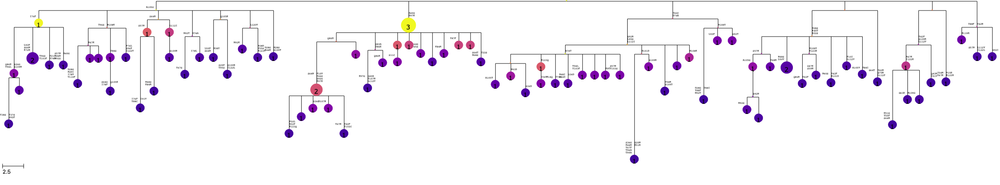

mouse5_GC80


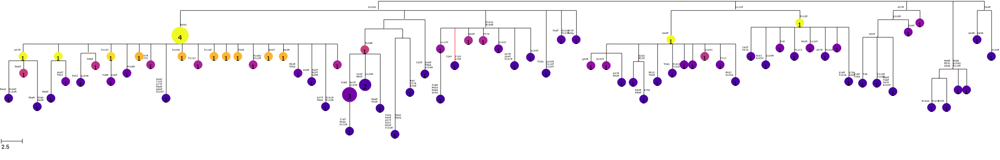

mouse5_GC81


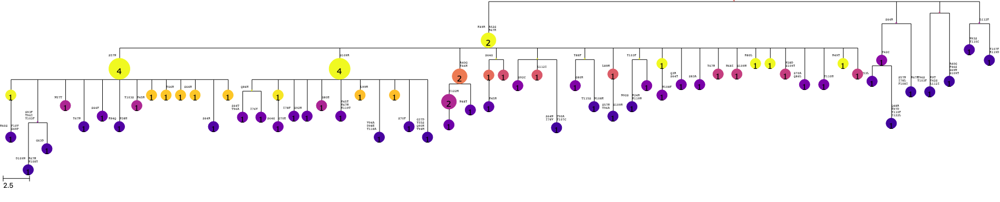

mouse5_GC82


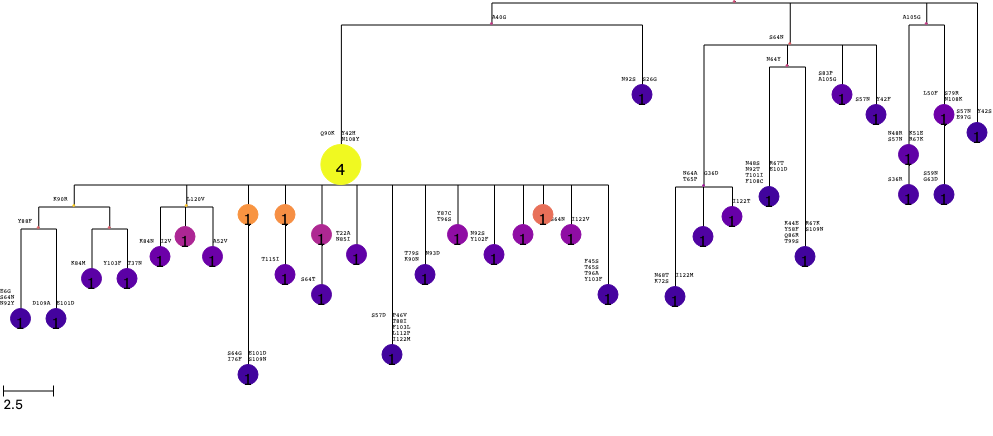

mouse5_GC83


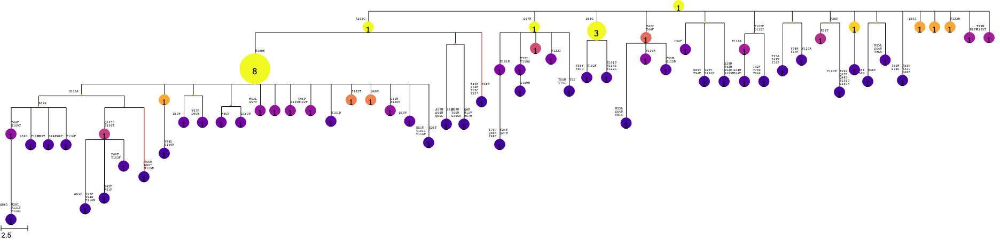

mouse6_GC74


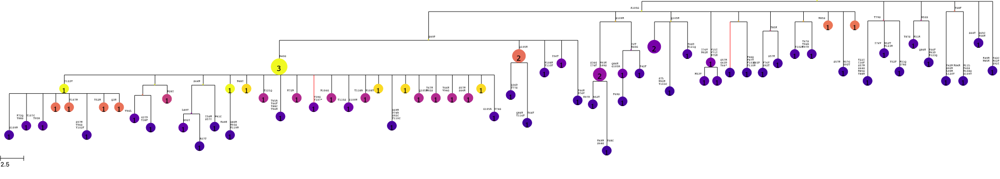

mouse6_GC75


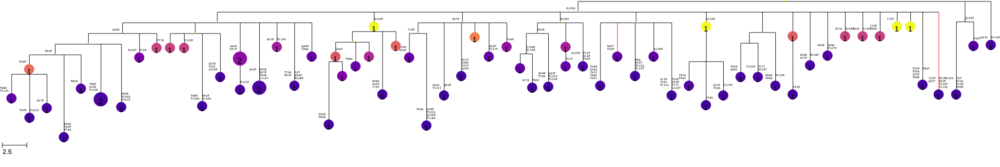

mouse6_GC76


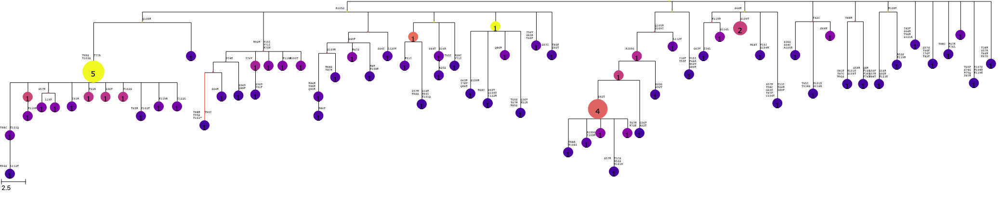

mouse6_GC77


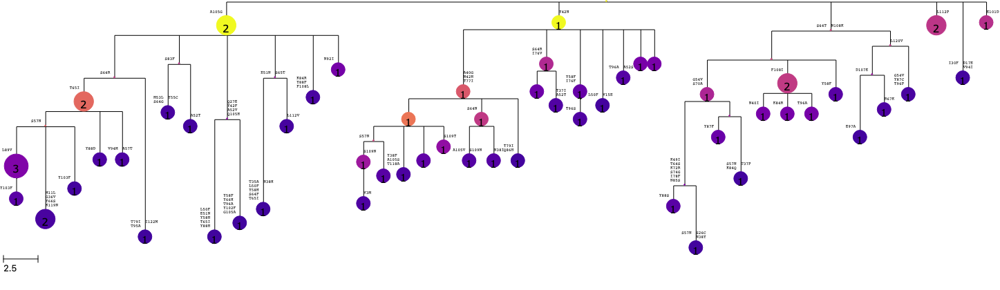

mouse7_GC90


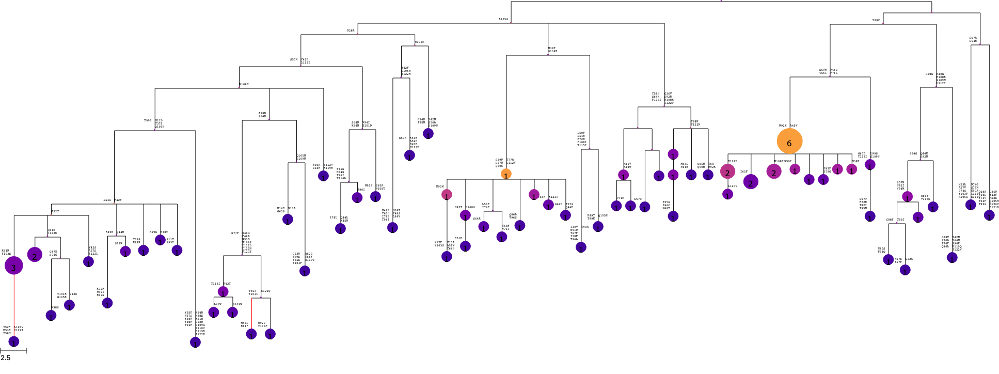

mouse8_GC84


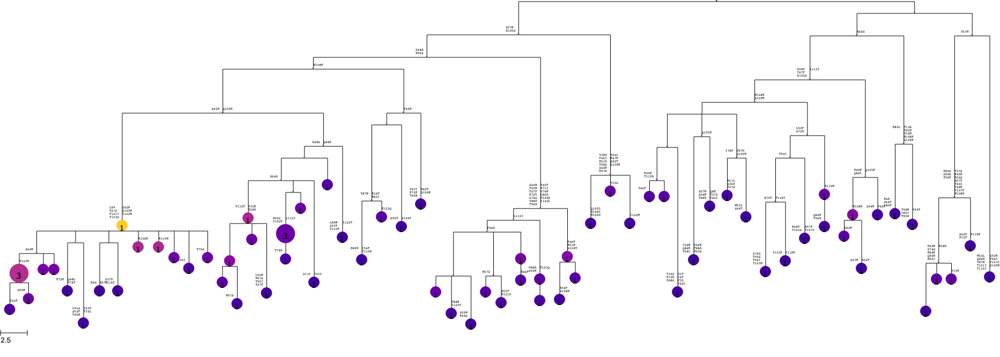

mouse8_GC85


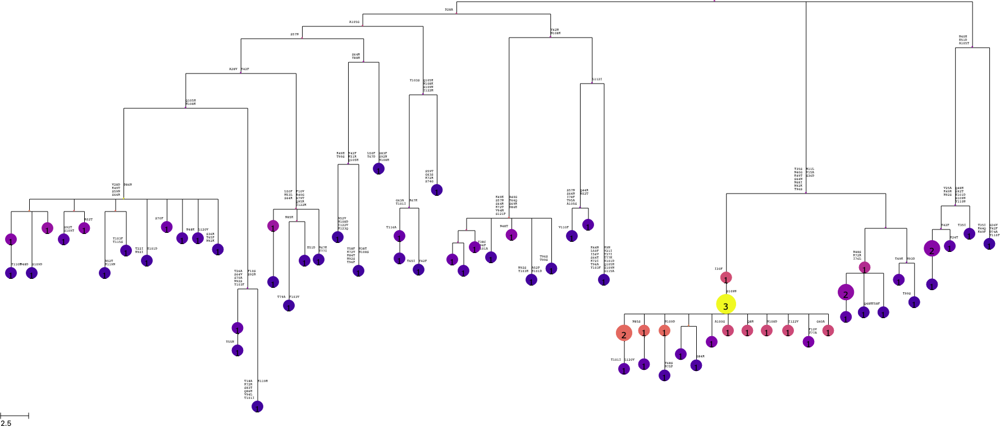

mouse8_GC86


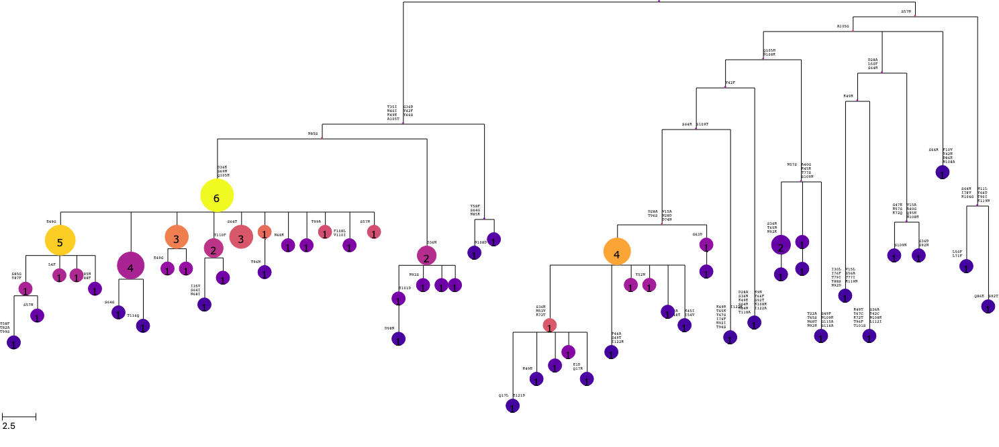

mouse8_GC87


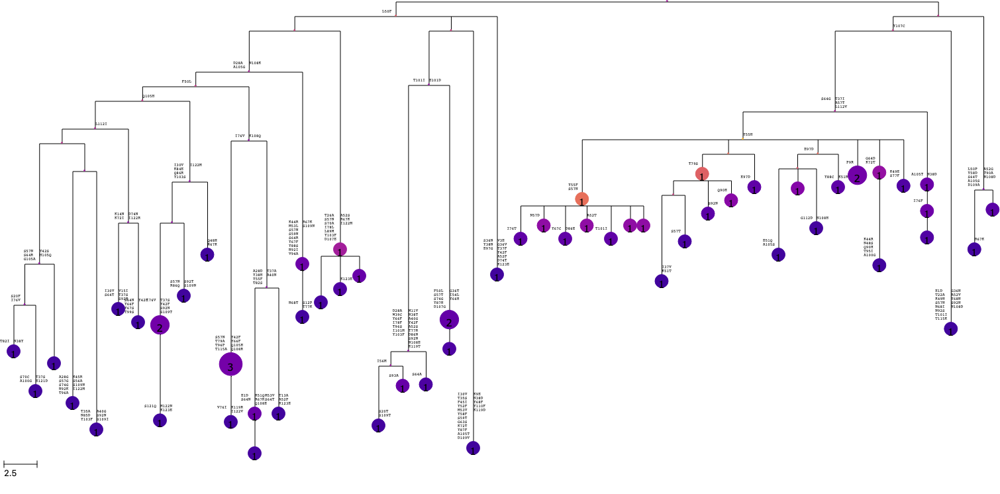

mouse8_GC88


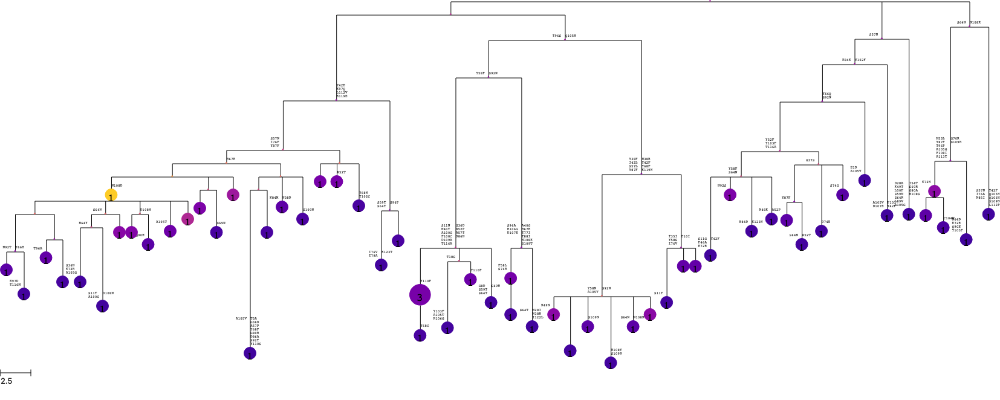

mouse8_GC89


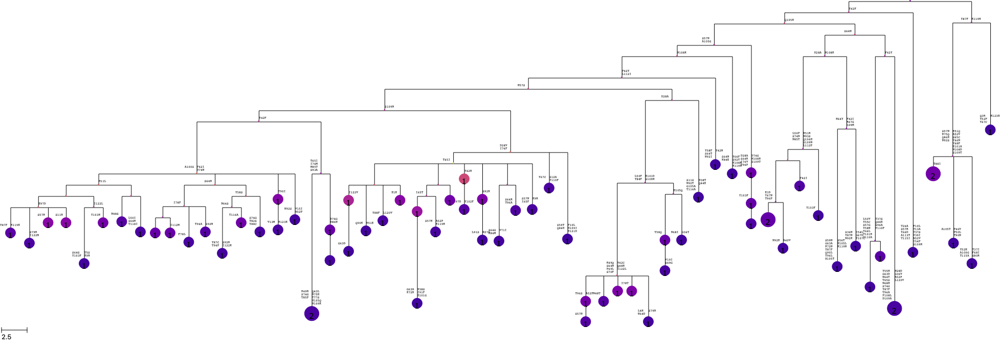

In [269]:
vmin_LB = 0
vmax_LB = 10
for gc, tree in trees.items():
    print(gc)
    colormap = tree.feature_colormap("LBI", cmap='plasma', vmin=vmin_LB, vmax=vmax_LB)
    for file in (f"output/plots/colormapped_gctrees/{gc}.LBI.svg", "%%inline"):
        rendering = tree.render(file, scale=20,
                            colormap=colormap,
                            frame=igh_frame, frame2=igk_frame, chain_split=igk_idx,
                            position_map=igh_pos_map, position_map2=igk_pos_map)
    display(rendering)

mouse1_GC1


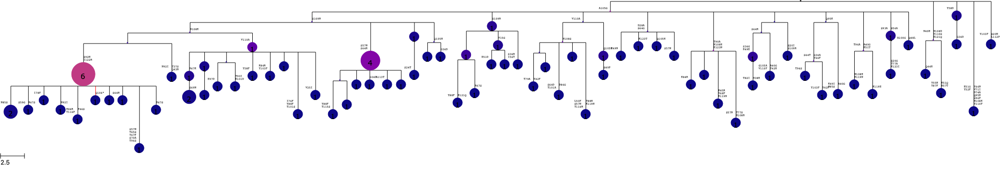

mouse1_GC2


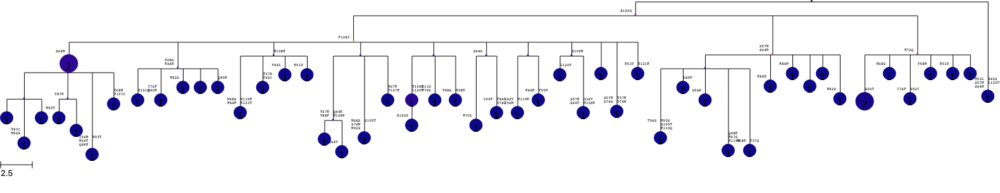

mouse1_GC3


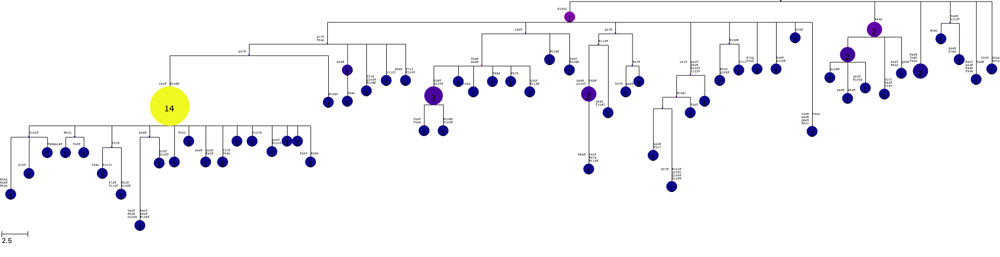

mouse1_GC4


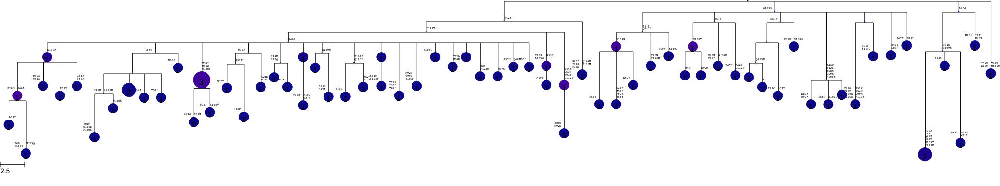

mouse1_GC5


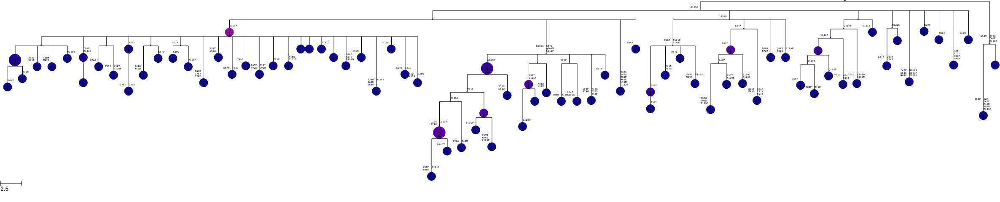

mouse1_GC6


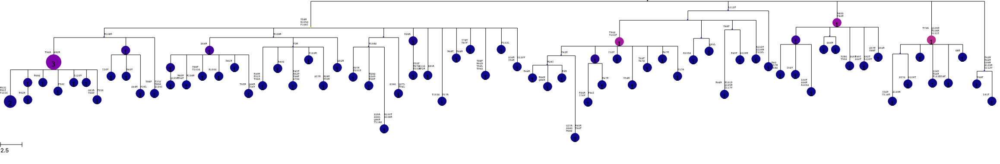

mouse1_GC7


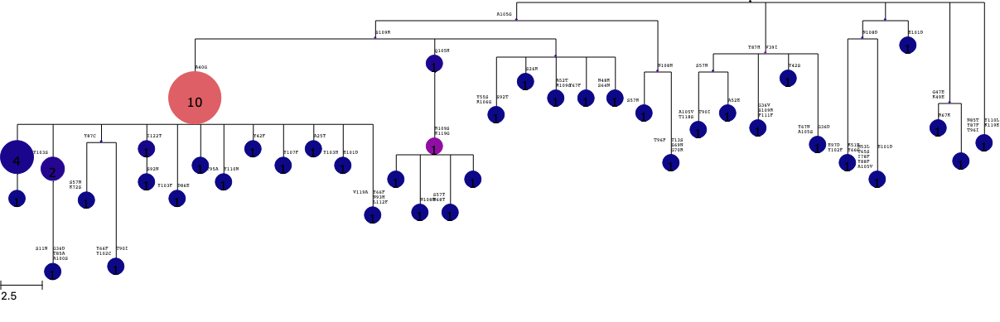

mouse1_GC11


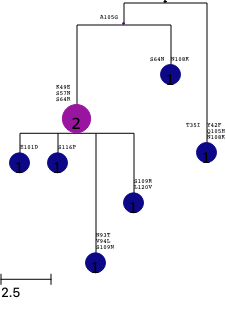

mouse1_GC12


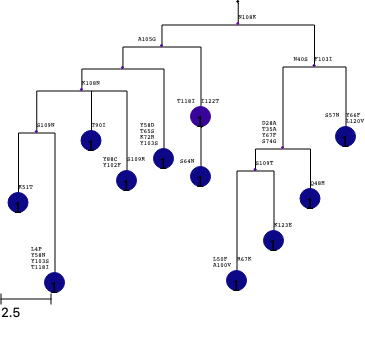

mouse1_GC13


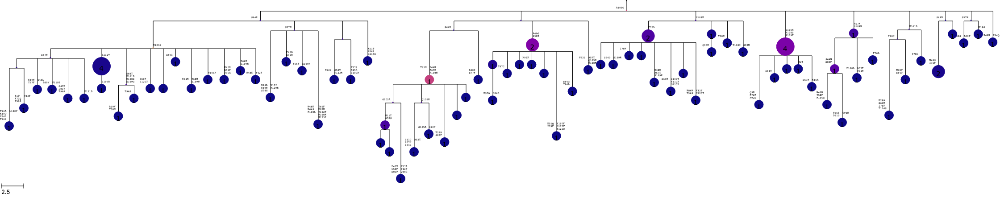

mouse1_GC14


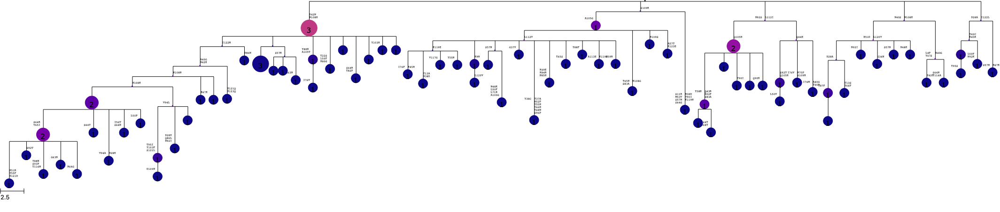

mouse1_GC15


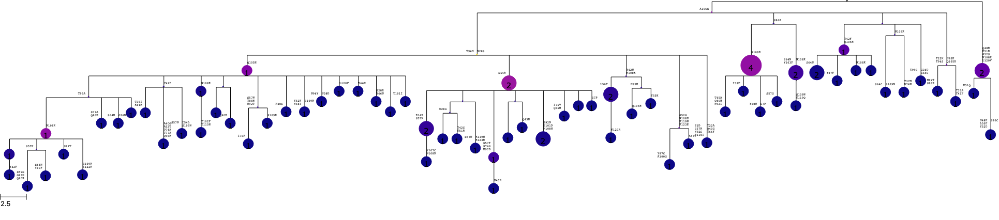

mouse1_GC16


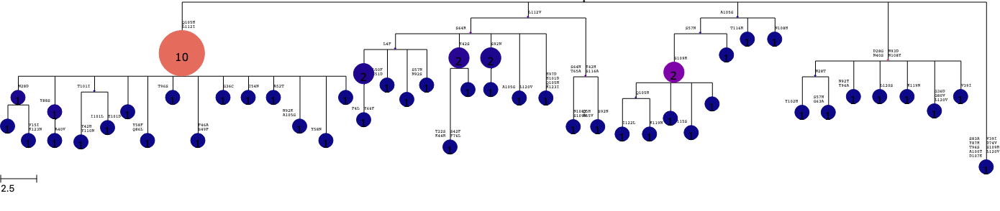

mouse1_GC17


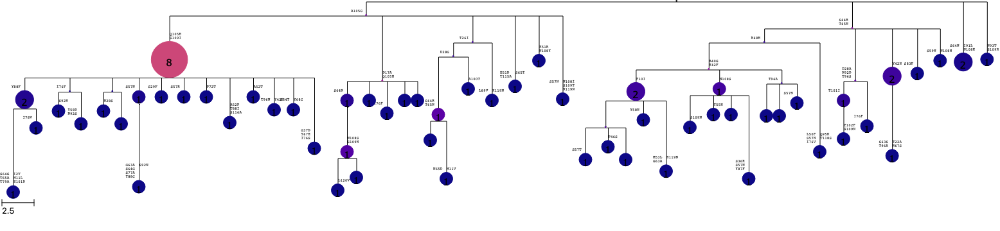

mouse1_GC18


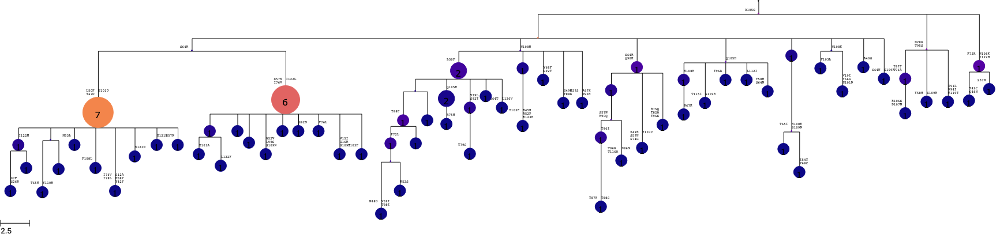

mouse1_GC19


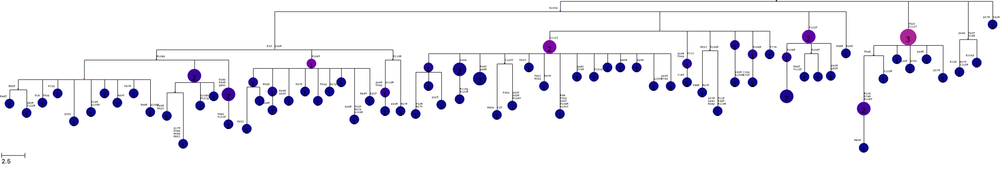

mouse1_GC20


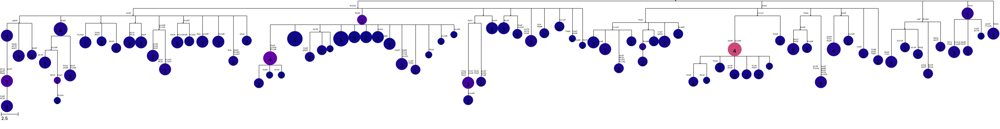

mouse2_GC21


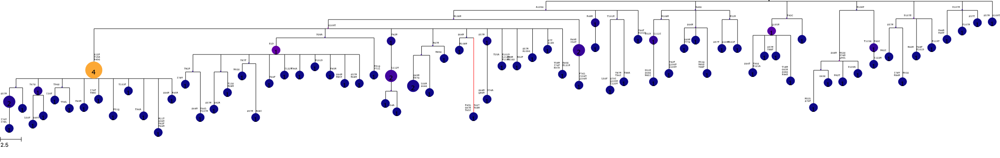

mouse2_GC22


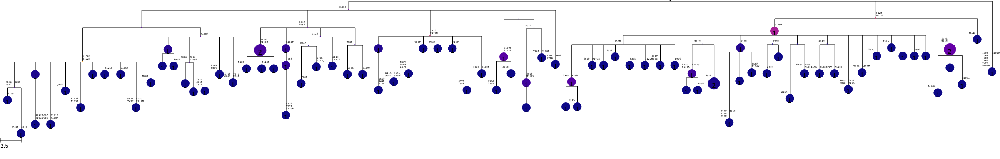

mouse2_GC23


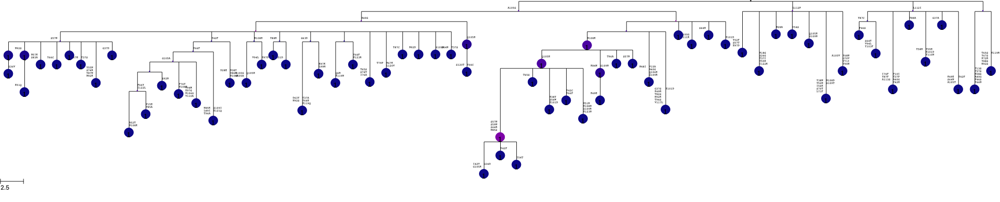

mouse2_GC24


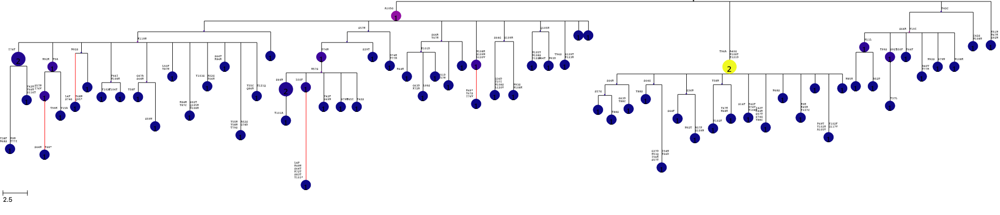

mouse2_GC25


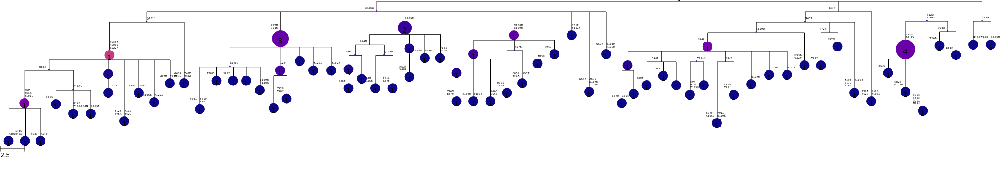

mouse2_GC26


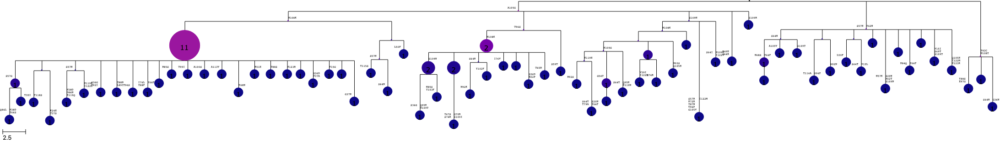

mouse2_GC28


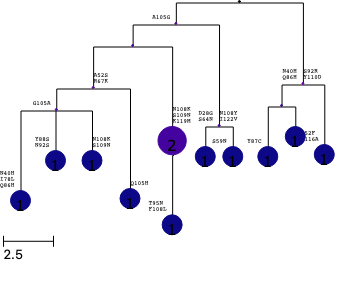

mouse2_GC29


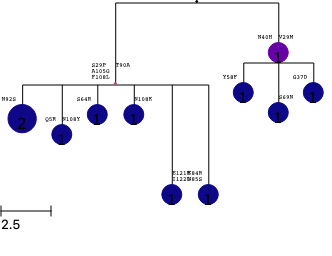

mouse2_GC30


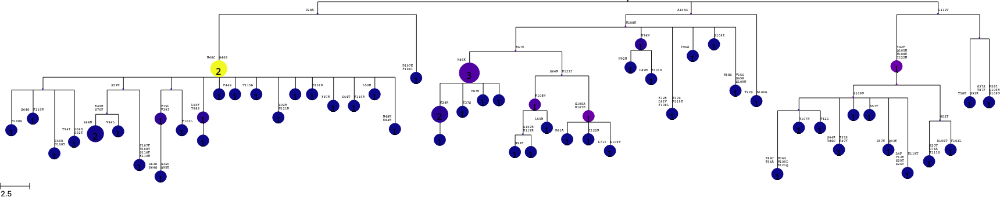

mouse2_GC31


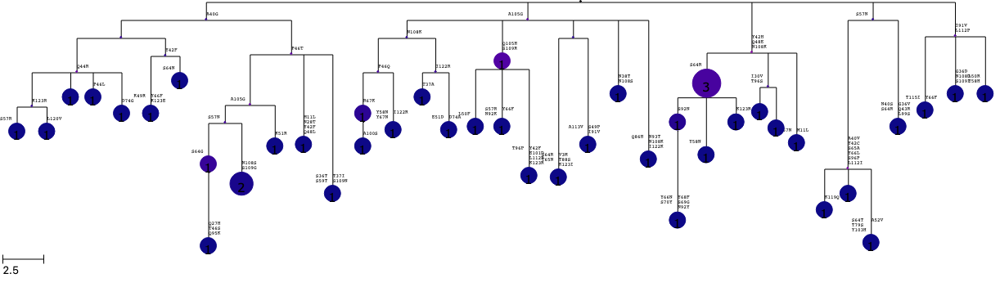

mouse2_GC32


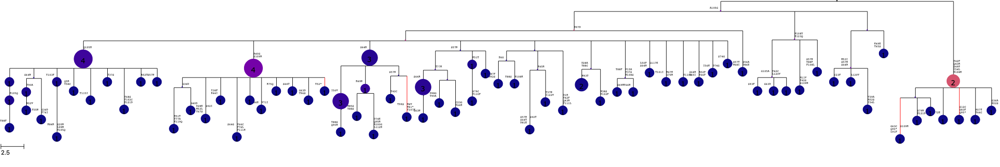

mouse2_GC34


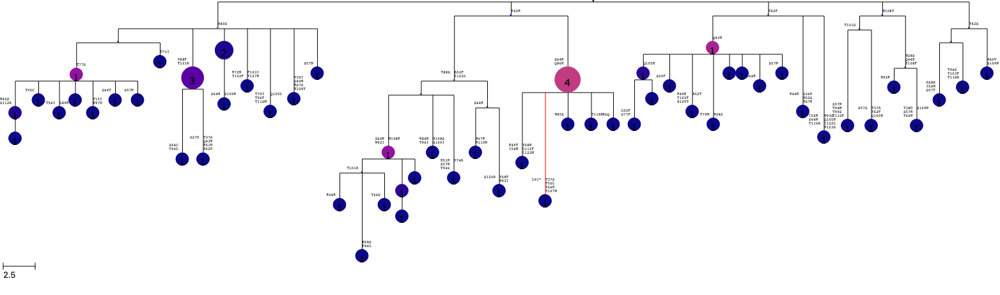

mouse2_GC38


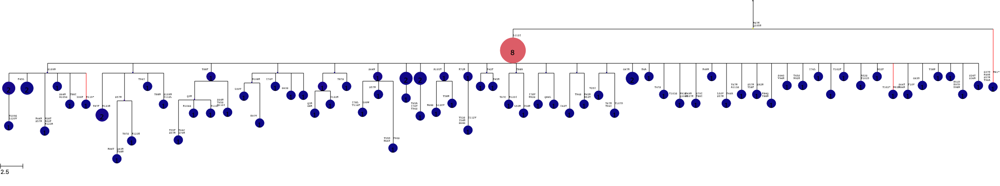

mouse2_GC39


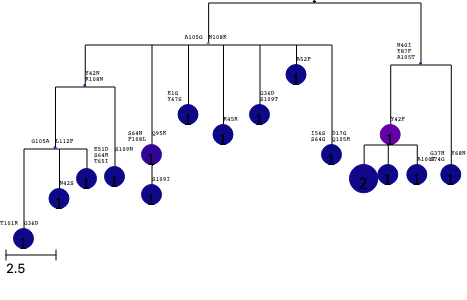

mouse2_GC40


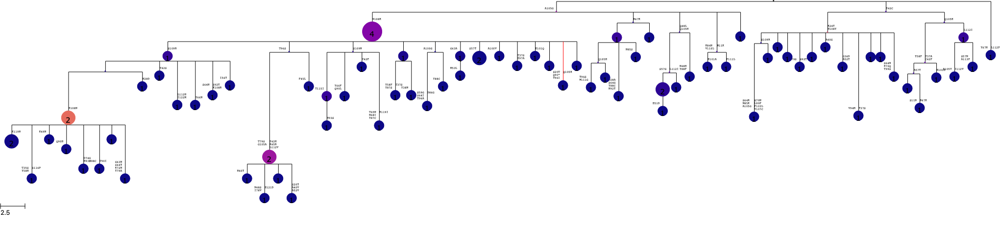

mouse3_GC41


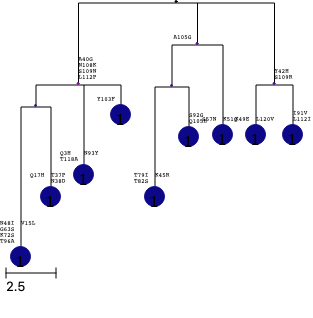

mouse3_GC42


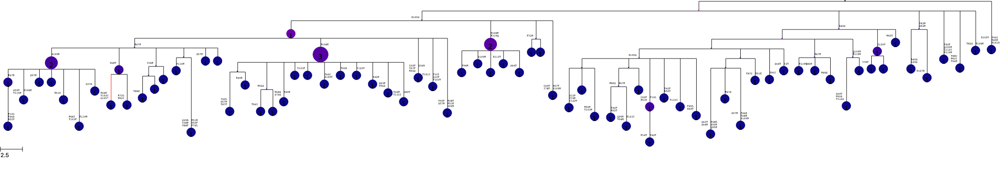

mouse3_GC43


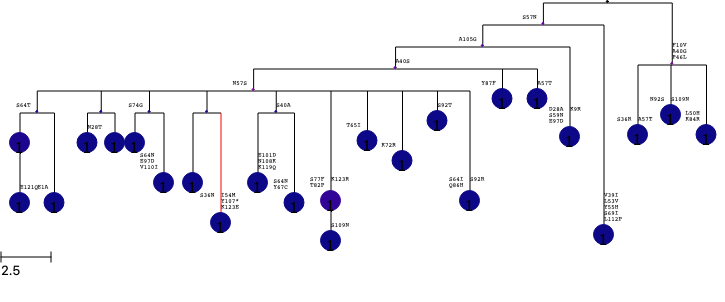

mouse3_GC44


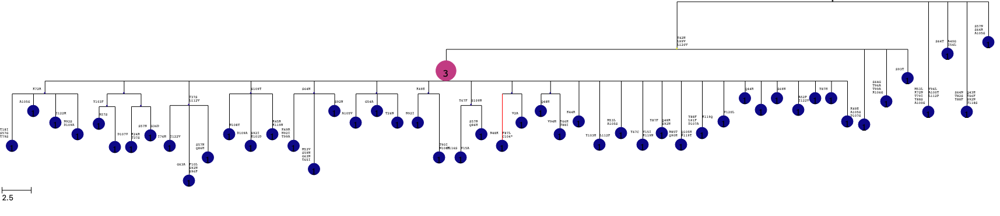

mouse3_GC45


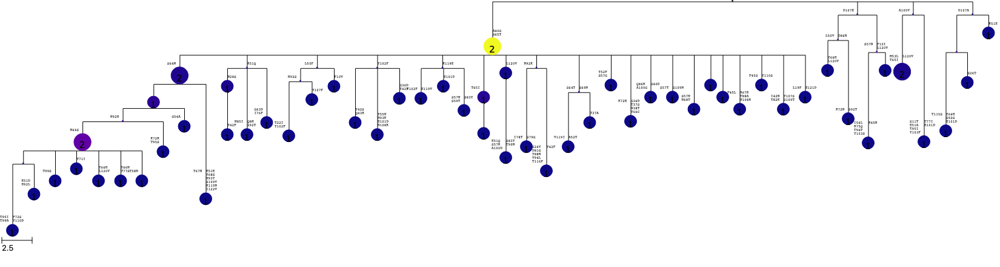

mouse3_GC46


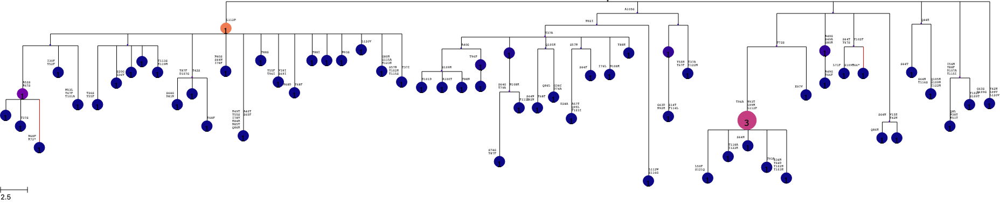

mouse3_GC55


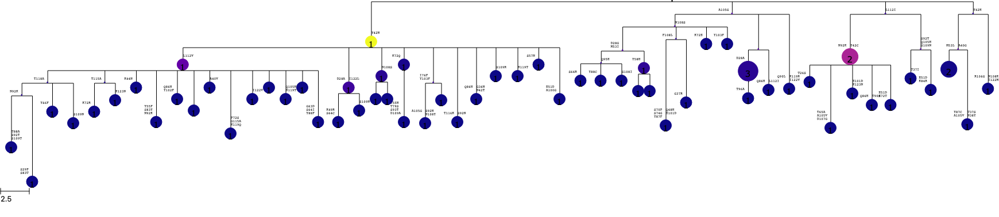

mouse3_GC56


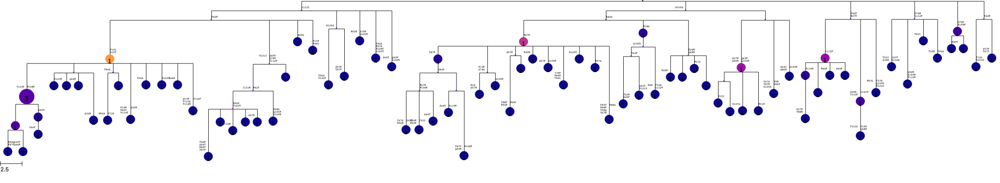

mouse3_GC57


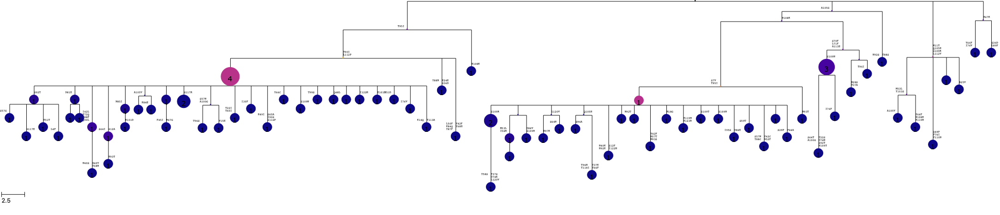

mouse3_GC58


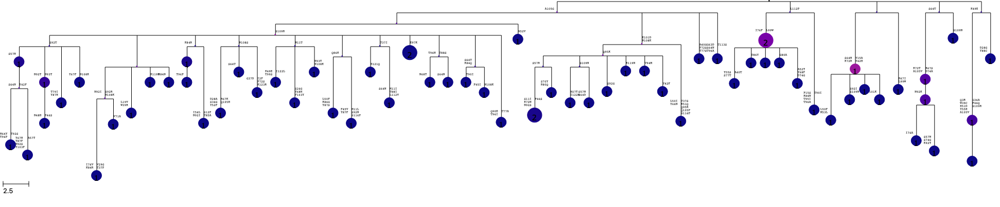

mouse3_GC59


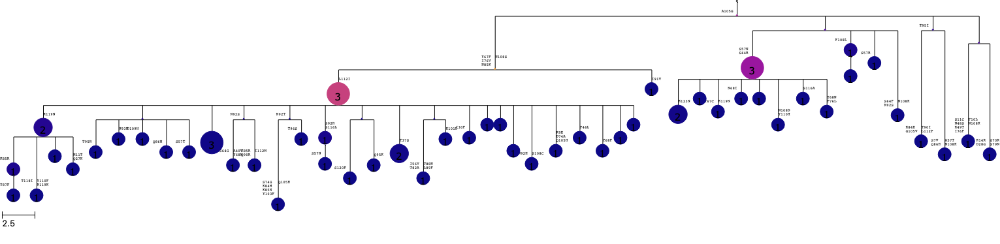

mouse3_GC64


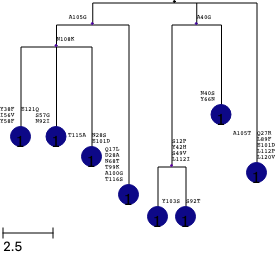

mouse3_GC65


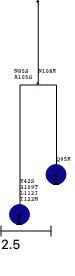

mouse3_GC66


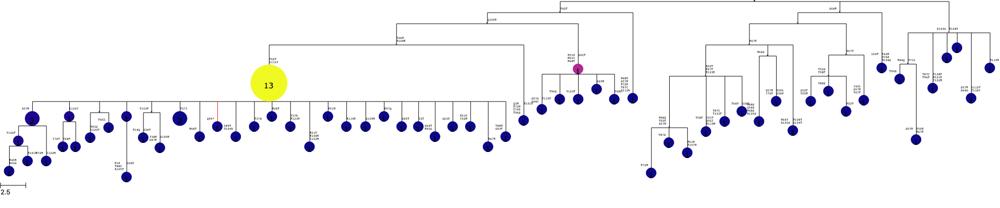

mouse3_GC72


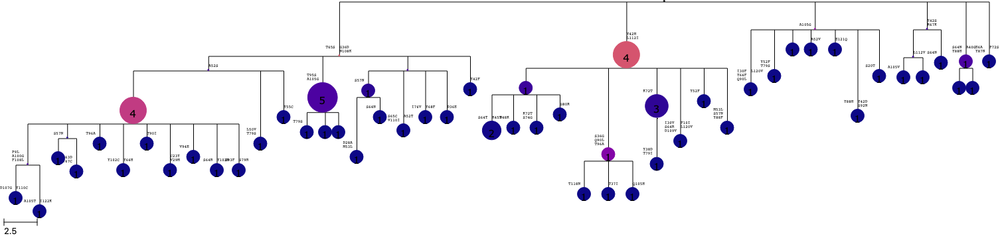

mouse4_GC47


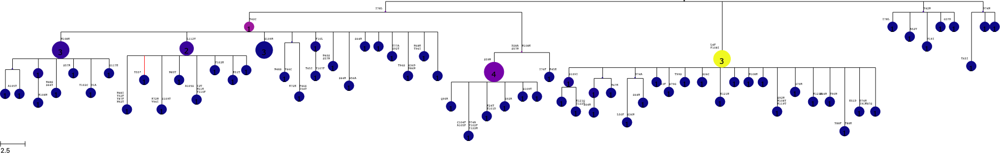

mouse4_GC48


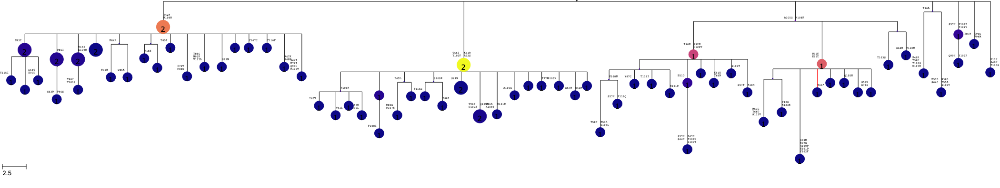

mouse4_GC50


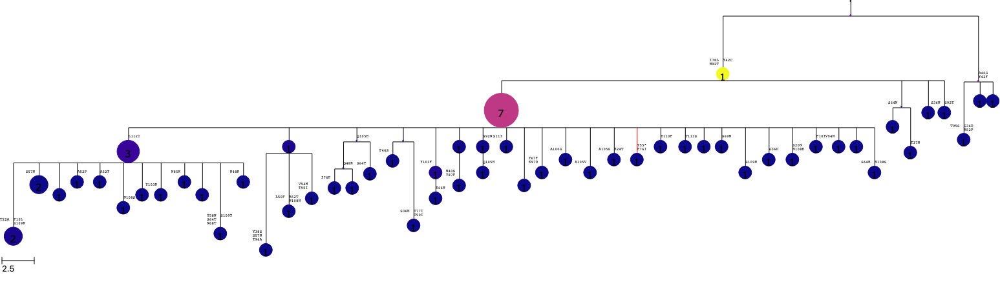

mouse4_GC63


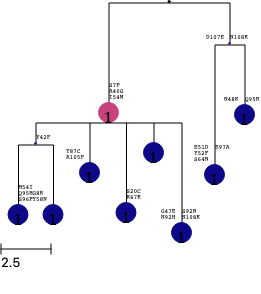

mouse4_GC67


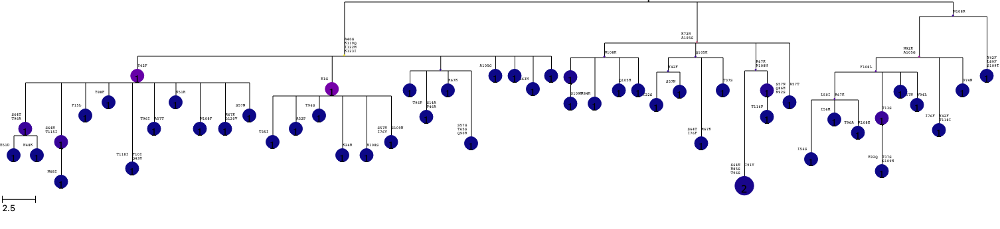

mouse4_GC68


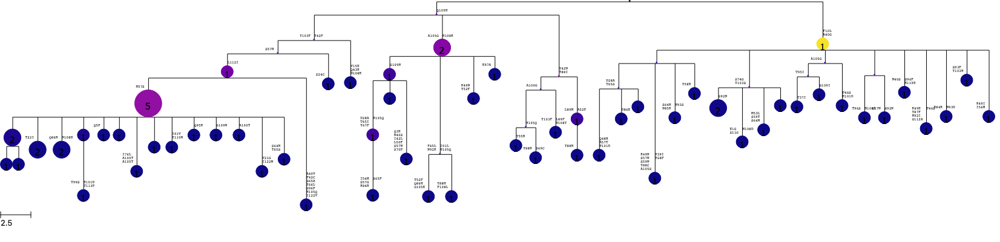

mouse4_GC69


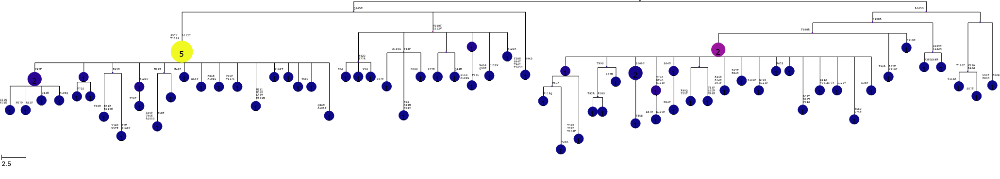

mouse4_GC70


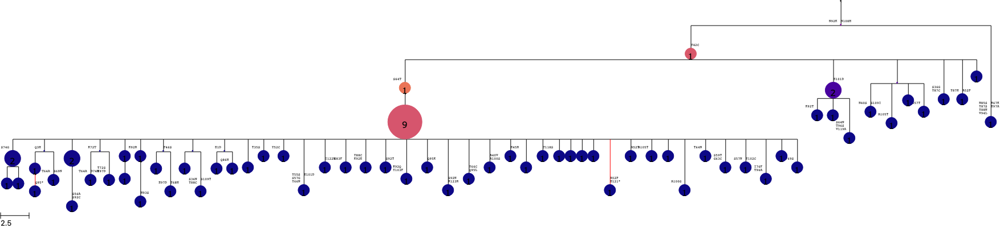

mouse4_GC71


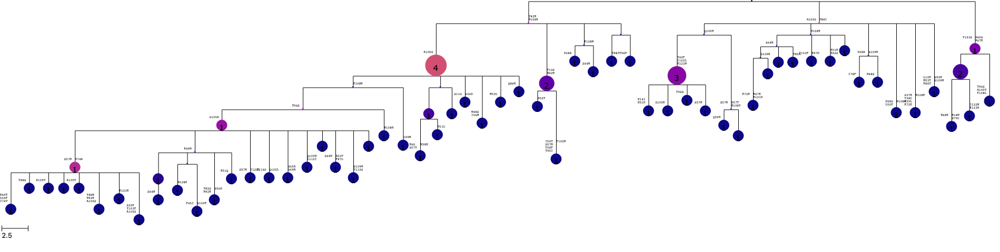

mouse4_GC73


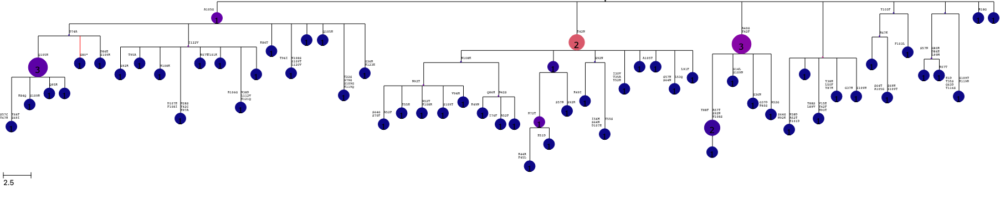

mouse5_GC78


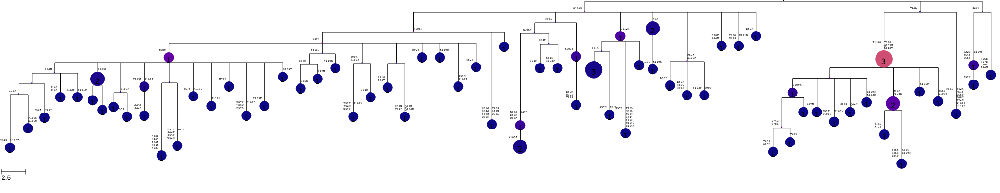

mouse5_GC79


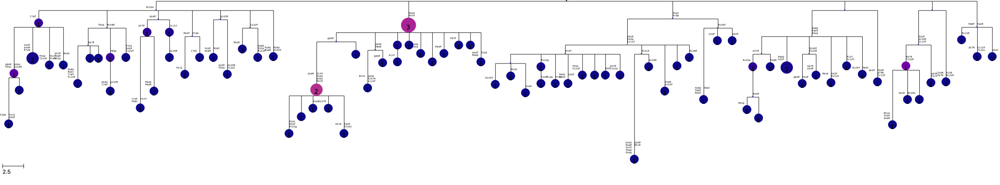

mouse5_GC80


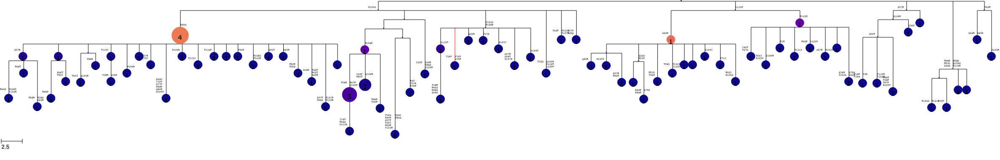

mouse5_GC81


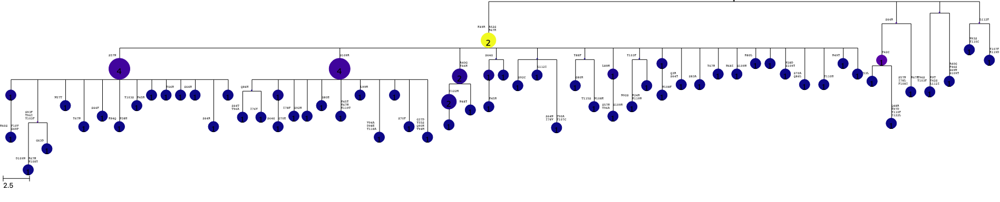

mouse5_GC82


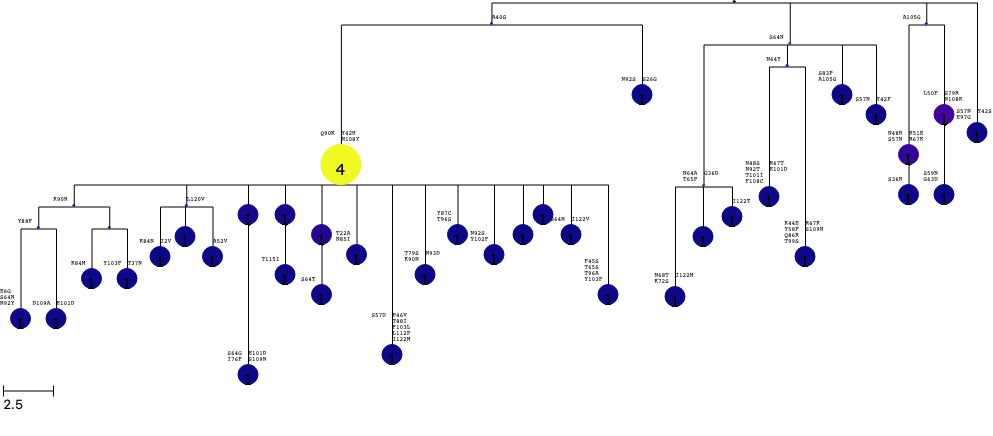

mouse5_GC83


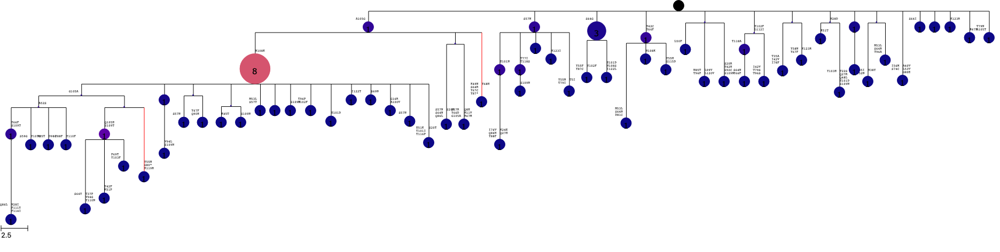

mouse6_GC74


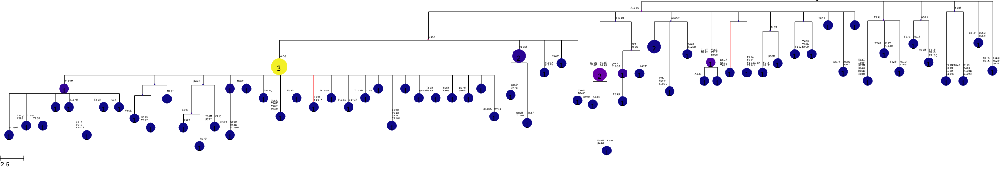

mouse6_GC75


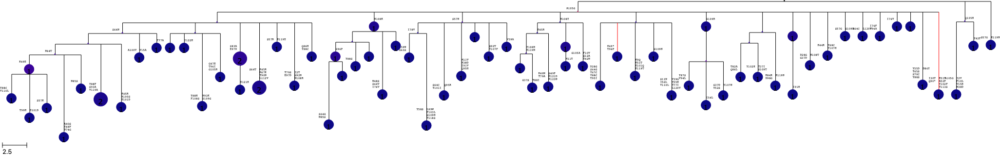

mouse6_GC76


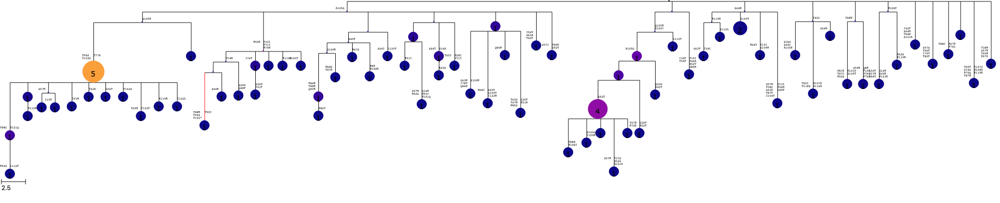

mouse6_GC77


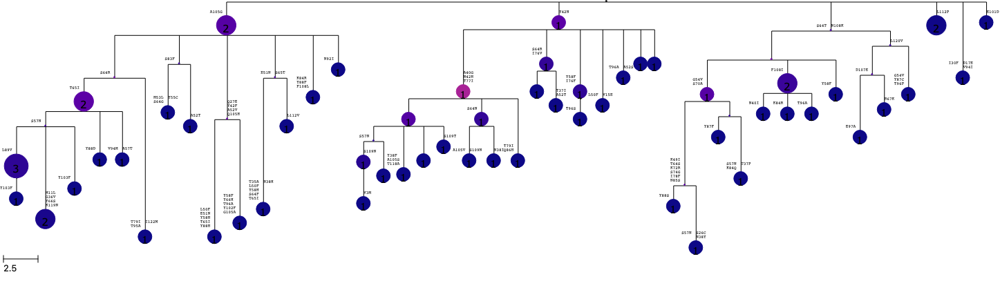

mouse7_GC90


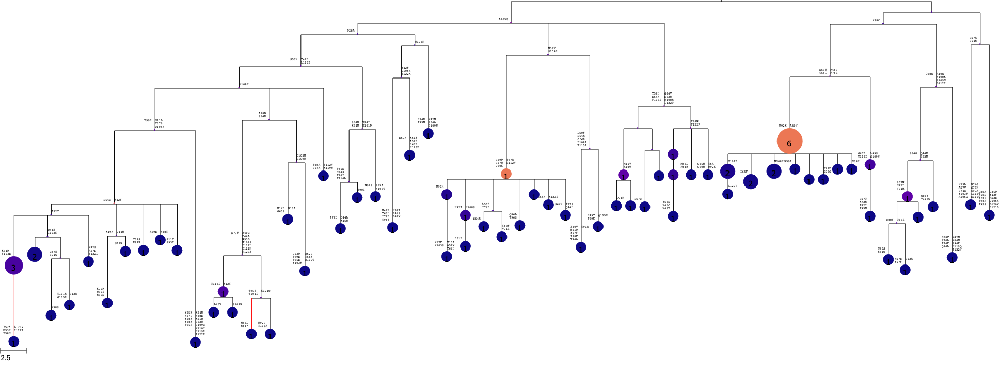

mouse8_GC84


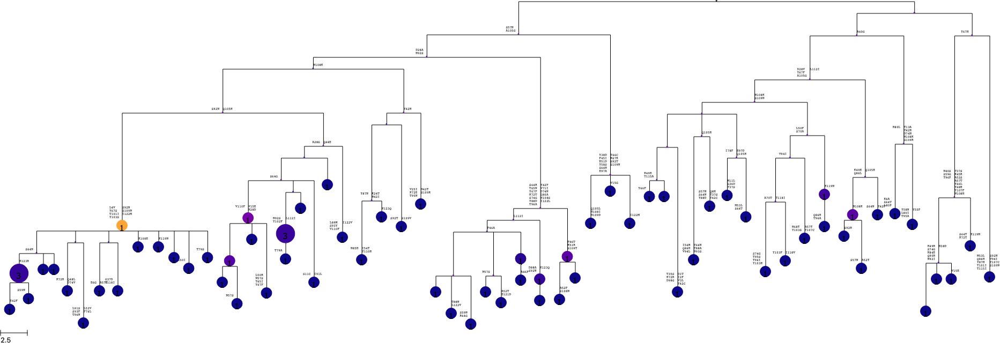

mouse8_GC85


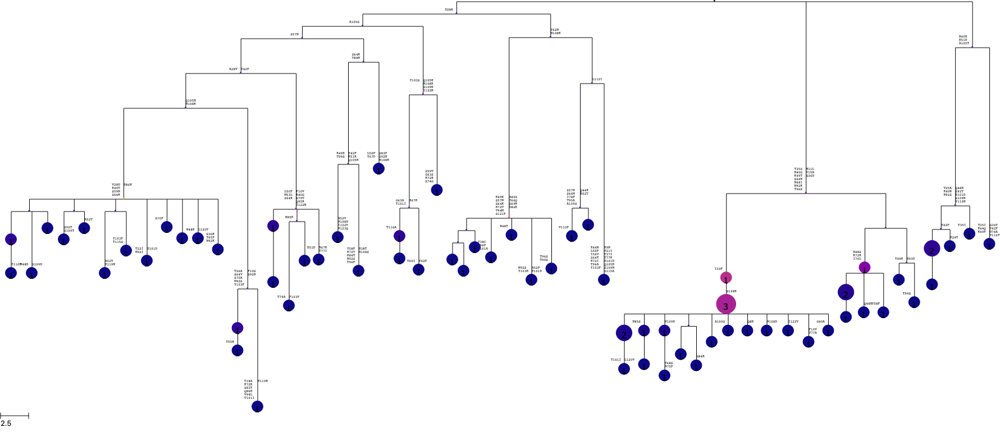

mouse8_GC86


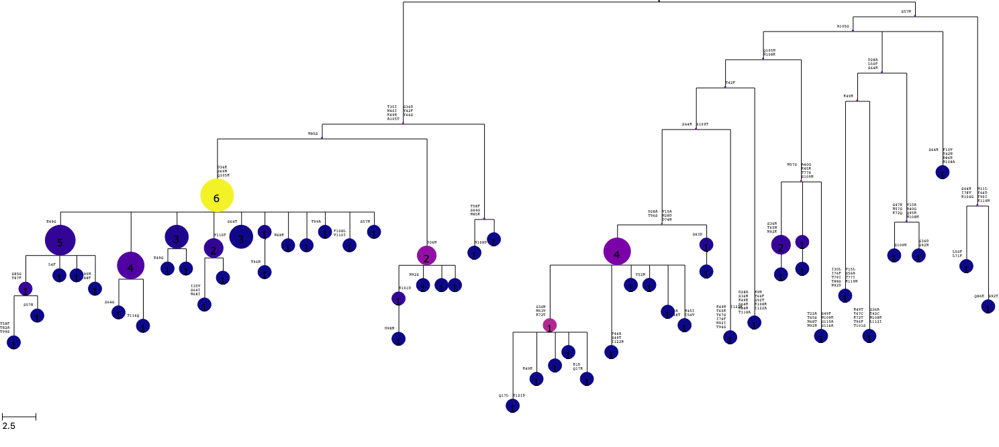

mouse8_GC87


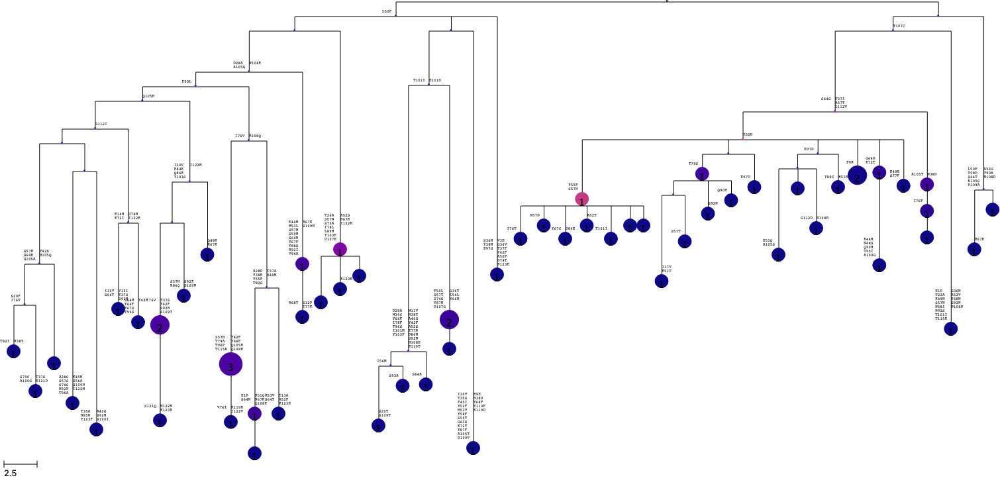

mouse8_GC88


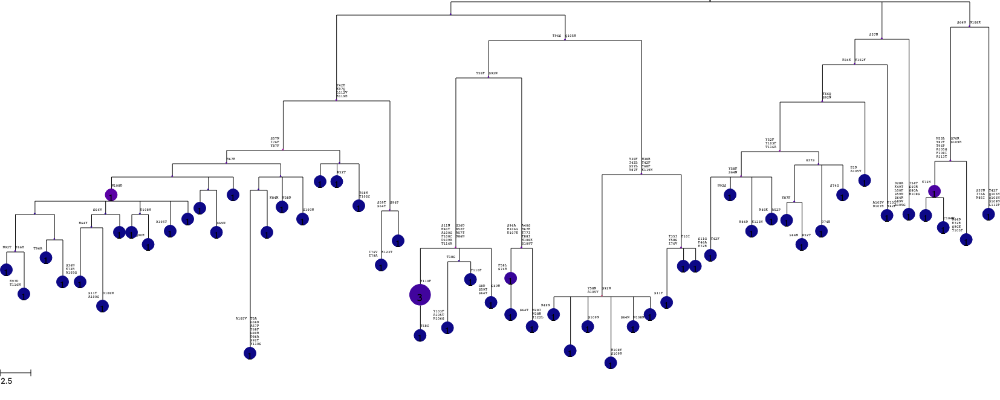

mouse8_GC89


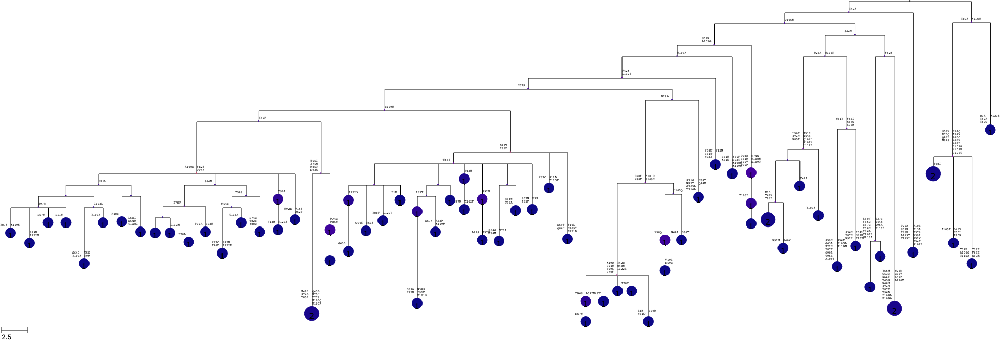

In [270]:
for gc, tree in trees.items():
    print(gc)
    colormap = tree.feature_colormap("LBR", cmap='plasma', vmin=vmin_LB, vmax=vmax_LB)
    for file in (f"output/plots/colormapped_gctrees/{gc}.LBR.svg", "%%inline"):
        rendering = tree.render(file, scale=20,
                            colormap=colormap,
                            frame=igh_frame, frame2=igk_frame, chain_split=igk_idx,
                            position_map=igh_pos_map, position_map2=igk_pos_map)
    display(rendering)

## Compare TorchDMS to naive additive model

on tree nodes

In [99]:
rows = []
for gc, tree in trees.items():
    for node in tree.tree.traverse():
        if node.abundance:
            rows.append([node.delta_bind_tdms, node.delta_bind_additive, node.delta_expr_tdms, node.delta_expr_additive])
tdmsVSadditive_df = pd.DataFrame(rows, columns=["delta_bind_tdms", "delta_bind_additive", "delta_expr_tdms", "delta_expr_additive"])
tdmsVSadditive_df

,delta_bind_tdms,delta_bind_additive,delta_expr_tdms,delta_expr_additive
0,0.217069,-0.06082,-0.463159,0.14827
1,-0.666148,-3.45668,-4.993756,-1.05627
2,-0.531296,-0.80796,-0.484772,-0.15104
3,-1.288873,-1.52301,-1.168497,-0.34882
4,-2.820110,-9.09012,-3.062262,-0.81985
...,...,...,...,...
4362,1.375150,1.85844,-2.768892,-0.21270
4363,1.321078,2.05805,-2.627425,-0.02356
4364,1.333047,2.05647,-2.658383,-0.14268
4365,1.367573,2.11229,-2.727252,-0.08620


...and for single mutants

In [100]:
def single_mut_seq(row):
    aa_seq = pos_df.amino_acid.copy()
    assert aa_seq[row.position] == row.wildtype
    aa_seq[row.position] = row.mutant
    aa_seq = "".join(aa_seq)
    tdms_prediction = tdms_model(tdms_model.seq_to_binary(aa_seq)).detach() - tdms_prediction_naive
    return tdms_prediction

dms_df[["delta_bind_tdms", "delta_expr_tdms"]] = dms_df.apply(single_mut_seq, axis=1, result_type="expand")
dms_df

,target,wildtype,position,position_IMGT,chain,mutant,codon,single_nt,bind,delta_bind,...,WT,site,delta_hydrophobicity,delta_charge,delta_weight,delta_aromaticity,region,region type,delta_bind_tdms,delta_expr_tdms
mutation,,,,,,,,,,,,,,,,,,,,,
E1(H)A,CGG_naive,E,1,1.0,H,A,GAG,True,10.48829,0.03110,...,False,H-1.0,0.022553,0.940401,-58.0361,0.000000,FR1,FR,0.244597,-0.186581
E1(H)C,CGG_naive,E,1,1.0,H,C,GAG,False,10.44477,-0.01243,...,False,H-1.0,0.025532,0.865548,-25.9711,0.000000,FR1,FR,-0.132102,-0.274668
E1(H)D,CGG_naive,E,1,1.0,H,D,GAG,True,10.42771,-0.02948,...,False,H-1.0,0.000000,-0.109502,-14.0266,0.000000,FR1,FR,0.252542,-0.218353
E1(H)E,CGG_naive,E,1,1.0,H,E,GAG,True,10.45719,0.00000,...,True,H-1.0,0.000000,0.000000,0.0000,0.000000,FR1,FR,0.000000,0.000000
E1(H)F,CGG_naive,E,1,1.0,H,F,GAG,False,10.51899,0.06180,...,False,H-1.0,0.026809,0.890051,18.0598,0.004255,FR1,FR,0.177597,-0.237737
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
R124(L)S,CGG_naive,R,235,124.0,L,S,CGT,True,10.44756,-0.00963,...,False,L-124.0,0.015745,-0.999975,-69.1084,0.000000,NaN,NaN,-0.024307,-0.131894
R124(L)T,CGG_naive,R,235,124.0,L,T,CGT,False,10.43023,-0.02696,...,False,L-124.0,0.016170,-0.999975,-55.0818,0.000000,NaN,NaN,0.085354,-0.293233
R124(L)V,CGG_naive,R,235,124.0,L,V,CGT,False,10.38231,-0.07488,...,False,L-124.0,0.037021,-0.999975,-57.0547,0.000000,NaN,NaN,0.260967,-0.262684


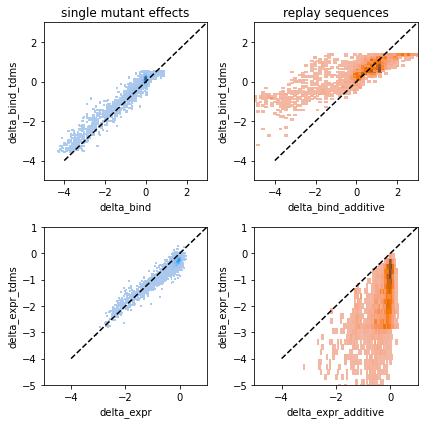

In [101]:
plt.figure(figsize=(6, 6))

plt.subplot(2, 2, 1)
g = sns.histplot(data=dms_df, x="delta_bind", y="delta_bind_tdms", color="C0")
plt.plot((-4, 4), (-4, 4), 'k--',)
g.set_xlim(-5, 3)
g.set_ylim(-5, 3)
plt.title("single mutant effects")

plt.subplot(2, 2, 2)
g = sns.histplot(data=tdmsVSadditive_df, x="delta_bind_additive", y="delta_bind_tdms", color="C1")
plt.plot((-4, 4), (-4, 4), 'k--',)
# plt.ylim(tdmsVSadditive_df.delta_bind_tdms.min(), tdmsVSadditive_df.delta_bind_tdms.max())
g.set_xlim(-5, 3)
g.set_ylim(-5, 3)
plt.title("replay sequences")

plt.subplot(2, 2, 3)
g = sns.histplot(data=dms_df, x="delta_expr", y="delta_expr_tdms", color="C0")
plt.plot((-4, 4), (-4, 4), 'k--',)
g.set_xlim(-5, 1)
g.set_ylim(-5, 1)

plt.subplot(2, 2, 4)
g = sns.histplot(data=tdmsVSadditive_df, x="delta_expr_additive", y="delta_expr_tdms", color="C1")
plt.plot((-4, 4), (-4, 4), 'k--',)
# plt.ylim(tdmsVSadditive_df.delta_bind_tdms.min(), tdmsVSadditive_df.delta_bind_tdms.max())
g.set_xlim(-5, 1)
g.set_ylim(-5, 1)

plt.tight_layout()
plt.savefig("output/plots/tdms_Vs_additive.pdf")
plt.show()


## Resample mutations, with a tolerance to recapitulate expression

In [275]:
mutability = pd.read_csv("mutability/MK_RS5NF_mutability.csv", index_col=0, squeeze=True)
substitution = pd.read_csv("mutability/MK_RS5NF_substitution.csv", index_col=0)

naive = tree.tree.sequence

def mutate(sequence):
    sequence_H = "NN" + sequence[:igk_idx] + "NN"
    sequence_K = "NN" + sequence[igk_idx:] + "NN"
    # mutabilities of each nucleotide
    contexts = [sequence_H[(i - 2) : (i + 3)]
                    for i in range(2, len(sequence_H) - 2)
                   ] + [sequence_K[(i - 2) : (i + 3)]
                        for i in range(2, len(sequence_K) - 2)
                       ]
    mutabilities = np.array([mutability[context] for context in contexts])
    i = np.random.choice(len(mutabilities), p=mutabilities / sum(mutabilities))
    sequence = sequence[:i] + np.random.choice(substitution.columns, p=substitution.loc[contexts[i]].fillna(0)) + sequence[(i + 1):]
    return sequence

<ipython-input-275-5a290766d4e2>:1: FutureWarning: The squeeze argument has been deprecated and will be removed in a future version. Append .squeeze("columns") to the call to squeeze.


  mutability = pd.read_csv("mutability/MK_RS5NF_mutability.csv", index_col=0, squeeze=True)


In [42]:
sim_trees = defaultdict(lambda: ([], []))
expression_threshold = 0.1 #np.inf
for gc, tree in trees.items():
    print(f"GC {gc}")
    for expression_matching in (False, True):
        replicate = 1
        dead = False
        while replicate <= 10:
            print(f"  {'expression matched ' if expression_matching else ''}replicate {replicate}", end="   \r")
            new_tree = tree.tree.copy()
            for node, node_new in zip(tree.tree.traverse(strategy="preorder"), new_tree.traverse(strategy="preorder")):
                assert node.name == node_new.name
                if not node.is_root():
                    success = False
                    closest = np.inf
                    for tries in range(100):
                        node_new.sequence = node_new.up.sequence
                        for _ in range(int(node.dist)):
                            node_new.sequence = mutate(node_new.sequence)
                            igh_aa = aa(node_new.sequence[:igk_idx], igh_frame)
                            igk_aa = aa(node_new.sequence[igk_idx:], igk_frame)
                            igh_mutations = mutations(naive_igh_aa, igh_aa, igh_pos_map, "(H)")
                            igk_mutations = mutations(naive_igk_aa, igk_aa, igk_pos_map, "(L)")        
                            all_mutations = igh_mutations + igk_mutations
                            if any("*" in x for x in all_mutations):
                                node_new.delta_bind_additive = None
                                node_new.delta_expr_additive = None
                                node_new.delta_psr_additive = None
                            else:
                                node_new.delta_bind_additive = dms_df.delta_bind[all_mutations].sum()
                                node_new.delta_expr_additive = dms_df.delta_expr[all_mutations].sum()
                                node_new.delta_psr_additive = dms_df.delta_psr[all_mutations].sum()
                        # note: selecting on additive expression estimate
                        # tdms_prediction_new = tdms_model(tdms_model.seq_to_binary(tree_nt_seq_to_dms_aa_seq(node_new.sequence))).detach() - tdms_prediction_naive
                        # node_new.delta_bind_tdms = tdms_prediction_new[0].item()
                        # node_new.delta_expr_tdms = tdms_prediction_new[1].item()
                        node_new.delta_bind_tdms = None
                        node_new.delta_expr_tdms = None
                        if node_new.delta_expr_additive is None:
                            continue
                        delta = np.abs(node_new.delta_expr_additive - node.delta_expr_additive)
                        if delta < closest:
                            closest = delta
                            closest_seq = node_new.sequence
                            closest_delta_bind = node_new.delta_bind_additive
                            closest_delta_expr = node_new.delta_expr_additive
                            closest_delta_psr = node_new.delta_psr_additive
                        if not expression_matching or delta < expression_threshold:
                            success = True
                            break
                    if not success:
                        node_new.sequence = closest_seq
                        node_new.delta_bind_additive = closest_delta_bind
                        node_new.delta_expr_additive = closest_delta_expr
                        node_new.delta_psr_additive = closest_delta_psr

            sim_trees[gc][expression_matching].append(new_tree)
            replicate += 1
        print()

GC gc31HK
  replicate 10   
  expression matched replicate 10   
GC gc50HK
  replicate 10   
  expression matched replicate 10   
GC gc59HK
  replicate 10   
  expression matched replicate 10   
GC gc17HK
  replicate 10   
  expression matched replicate 10   
GC gc56HK
  replicate 10   
  expression matched replicate 10   
GC gc39HK
  replicate 10   
  expression matched replicate 10   
GC gc77HK
  replicate 10   
  expression matched replicate 10   
GC gc16HK
  replicate 10   
  expression matched replicate 10   
GC gc46HK
  replicate 10   
  expression matched replicate 10   
GC gc30HK
  replicate 10   
  expression matched replicate 10   
GC gc14HK
  replicate 10   
  expression matched replicate 10   
GC gc6HK
  replicate 10   
  expression matched replicate 10   
GC gc2HK
  replicate 10   
  expression matched replicate 10   
GC gc81HK
  replicate 10   
  expression matched replicate 10   
GC gc1HK
  replicate 10   
  expression matched replicate 10   
GC gc68HK
  replicate 10   


In [81]:
# sim_df = pd.DataFrame()
# replicate = 1
# delta_expr_threshold = -3
# fitness_transition = 10
# while replicate < 100:
#     print(f"replicate {replicate + 1}", end="   \r")
#     sequence = naive
#     n_mutations = 0
#     rep_df = pd.DataFrame()
#     dead = False
#     while n_mutations < 11:
#         if n_mutations:
#             new_sequence = mutate(sequence)
#         else:
#             new_sequence = sequence
# #         igh_aa = aa(new_sequence[:igk_idx], igh_frame)
# #         igk_aa = aa(new_sequence[igk_idx:], igk_frame)
# #         igh_mutations = mutations(naive_igh_aa, igh_aa, igh_pos_map, "(H)")
# #         igk_mutations = mutations(naive_igk_aa, igk_aa, igk_pos_map, "(L)")
# #         all_mutations = igh_mutations + igk_mutations
#         all_mutations = igh_mutations + igk_mutations
#         if any("*" in x for x in all_mutations):
#             delta_bind = None
#             delta_expr = None
#             delta_psr = None
#         else:
#             delta_bind = dms_df.delta_bind[all_mutations].sum()
#             delta_expr = dms_df.delta_expr[all_mutations].sum()
#             delta_psr = dms_df.delta_psr[all_mutations].sum()
#         tdms_prediction = tdms_model(tdms_model.seq_to_binary(tree_nt_seq_to_dms_aa_seq(new_sequence))).detach() - tdms_prediction_naive
#         if np.random.rand() < expit(-fitness_transition * (tdms_prediction[1] - delta_expr_threshold)):
#             dead=True
#             break
#         sequence = new_sequence
#         new_row = pd.Series({"delta_bind": tdms_prediction[0].item(),
#                              "delta_expr": tdms_prediction[1].item(),
#                              "n_mutations": n_mutations,
#                              "replicate": replicate})
#         rep_df = rep_df.append(new_row, ignore_index=True, verify_integrity=True)
#         n_mutations += 1
#     if not dead:
#         sim_df = sim_df.append(rep_df, ignore_index=True, verify_integrity=True)
#         replicate += 1
# sim_df

**NOTE: torchdms trajectories!**

In [306]:
len(trees_to_plot)

67

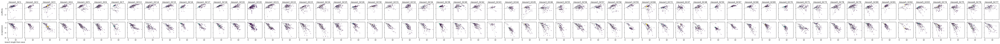

In [307]:
# fig, axes = plt.subplots(3, len(trees), figsize=(1.5 * len(trees), 6), sharex=True, sharey="row")
# note: skipping psr and some GCs
trees_to_plot = {gc: tree for gc, tree in trees.items() if not (gc.startswith("mouse7") or gc.startswith("mouse8") or sum(node.abundance for node in tree.tree.traverse()) < 20)}
fig, axes = plt.subplots(2, len(trees_to_plot), figsize=(1.5 * len(trees_to_plot), 4), sharex=True, sharey="row")

color_by = "LBR" #LBI

for i, (phenotype, phenotype_label) in enumerate(zip(("delta_bind_tdms", "delta_expr_tdms"#, "delta_psr_additive"
                                                      ),
                                                     (r"$\Delta$ affinity", r"$\Delta$ expression"#, r"$\Delta$ polyspecificity"
                                                      )
                                                     )):
    for j, (gc, tree) in enumerate(trees_to_plot.items()):
        points = []
        lines = []
        colors = []
        
        for node in tree.tree.traverse():
            points.append((tree.tree.get_distance(node),
                           getattr(node, phenotype),
                           1 + 5 * node.abundance,
                           getattr(node, color_by)))
            if node.up is not None:
                lines.append([(tree.tree.get_distance(node.up), getattr(node.up, phenotype)),
                              (tree.tree.get_distance(node), getattr(node, phenotype))])
            colors.append(getattr(node, color_by))

#         sim_lines = []
#         for sim_idx, sim_tree in enumerate(sim_trees[gc][0]):
#             for node in sim_tree.traverse():
#                 if node.up is not None:
#                     sim_lines.append([(sim_tree.get_distance(node.up), getattr(node.up, phenotype)),
#                                       (sim_tree.get_distance(node), getattr(node, phenotype))])
#         sim_lines_matched = []
#         for sim_idx, sim_tree in enumerate(sim_trees[gc][1]):
#             for node in sim_tree.traverse():
#                 if node.up is not None:
#                     sim_lines_matched.append([(sim_tree.get_distance(node.up), getattr(node.up, phenotype)),
#                                               (sim_tree.get_distance(node), getattr(node, phenotype))])
        lc = mc.LineCollection(lines, colors="k", linewidths=0.3, alpha=0.5, zorder=3)
#         sim_lc = mc.LineCollection(sim_lines, colors="C0", linewidths=1, alpha=0.1, zorder=2)
#         sim_matched_lc = mc.LineCollection(sim_lines_matched, colors="C1", linewidths=1, alpha=0.1, zorder=2)

        ax = axes[i, j]
        ax.axhline(0, c="k", ls="--", lw=0.25, zorder=1)
#         if phenotype == "delta_expr":
#             ax.axhline(delta_expr_threshold, c="r", ls="--", lw=0.25, zorder=1)
        ax.add_collection(lc)
#         ax.add_collection(sim_lc)
#         ax.add_collection(sim_matched_lc)
        ax.scatter(*zip(*points), cmap="viridis", vmin=vmin_LB, vmax=vmax_LB, alpha=0.8, edgecolors="k", linewidths=0.2, zorder=4)
        if i == 0:
            ax.set_title(gc)
        ax.set_xlabel(None)
#         break
    axes[i, 0].set_ylabel(phenotype_label)
axes[-1, 0].set_xlabel("branch length from naive")
plt.tight_layout()
plt.savefig("output/plots/phenotype_trajectories.pdf")
plt.show()

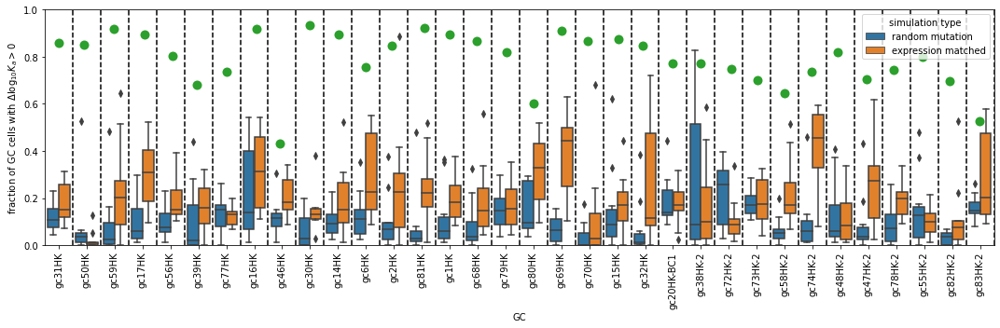

In [102]:
def tree_stat(tree, threshold=0):
    total = 0
    tail_count = 0
    for node in tree.traverse():
        total += node.abundance
        if node.delta_bind_additive > threshold:
            tail_count += node.abundance
    return tail_count / total

dat = []
threshold = 0 #np.log10(2)
for gc, tree in trees.items():
    dat.append([gc, False, None, tree_stat(tree.tree, threshold)])
    for rep_tree in sim_trees[gc][0]:
        dat.append([gc, True, "random mutation", tree_stat(rep_tree, threshold)])
    for rep_tree in sim_trees[gc][1]:
        dat.append([gc, True, "expression matched", tree_stat(rep_tree, threshold)])

stat_df = pd.DataFrame(dat, columns=["GC", "simulation", "simulation type", fr"fraction of GC cells with $\Delta\log_{{10}}K_a>{threshold}$"])    

plt.figure(figsize=(15, 5))
g = sns.boxplot(data=stat_df.loc[stat_df.simulation == True],
                x="GC", y=fr"fraction of GC cells with $\Delta\log_{{10}}K_a>{threshold}$", hue="simulation type",
                dodge=True
#                    split=True, inner="stick"
               )
sns.stripplot(data=stat_df.loc[stat_df.simulation == False],
              x="GC", y=fr"fraction of GC cells with $\Delta\log_{{10}}K_a>{threshold}$",
              color="C2", size=10)
plt.ylim(0, 1)
for item in g.get_xticklabels():
    item.set_rotation(90)
for tick_pos in g.get_xticks():
    plt.axvline(tick_pos + 0.5, c="k", ls="--")
plt.tight_layout()
plt.savefig("output/plots/selection_stat.pdf")
plt.show()

# sns.displot(data=stat_df, col="GC", x=fr"GC fraction with $\Delta\log_{{10}}K_a>{threshold}$", hue="simulation type", col_wrap=4)
# sns.displot(data=stat_df.loc[stat_df.simulation == False], col="GC", x=fr"GC fraction with $\Delta\log_{{10}}K_a>{threshold}$", hue="simulation type", col_wrap=4, rug=True)
# # plt.savefig("output/plots/selection_stat.pdf")
# plt.show()

## Convergent mutations

note: should change this to get only codon-wise first hits, maybe using leaf function and pre-order traversal (like in dNdS section). Currently has repeated points for aa mutations if multiple nt mutations are present.

In [104]:
naive_H = "NN" + naive[:igk_idx] + "NN"
naive_K = "NN" + naive[igk_idx:] + "NN"
# mutabilities of each nucleotide
contexts = [naive_H[(i - 2) : (i + 3)]
                for i in range(2, len(naive_H) - 2)
               ] + [naive_K[(i - 2) : (i + 3)]
                    for i in range(2, len(naive_K) - 2)
                   ]

dat = []
for gc, tree in trees.items():
    for node in tree.tree.traverse():
        if node.abundance > 0:
            for i, (nt_naive, nt_mut) in enumerate(zip(naive, node.sequence)):
                if nt_mut != nt_naive:
                    codon_start_idx = 3 * (i // 3)
                    codon_naive = naive[codon_start_idx:(codon_start_idx + 3)]
                    codon_pos = i % 3
                    assert codon_naive[codon_pos] == nt_naive
                    codon_mut = list(codon_naive)
                    codon_mut[codon_pos] = nt_mut
                    codon_mut = "".join(codon_mut)
                    aa_naive = Seq(codon_naive).translate()
                    aa_mut = Seq(codon_mut).translate()
                    if i < igk_idx:
                        chain = "H"
                        pos = igh_pos_map[i // 3]
                    else:
                        chain = "L"
                        pos = igk_pos_map[(i - igk_idx) // 3]
                    dat.append([f"{nt_naive}{i}{nt_mut}",
                                f"{chain}-{str(pos).zfill(3)}",
                                chain,
                                None if aa_mut == aa_naive else f"{aa_naive}{pos}({chain}){aa_mut}",
                                None if f"{aa_naive}{pos}({chain}){aa_mut}" not in dms_df.index else dms_df.loc[f"{aa_naive}{pos}({chain}){aa_mut}", "delta_bind"],
                                None if f"{aa_naive}{pos}({chain}){aa_mut}" not in dms_df.index else dms_df.loc[f"{aa_naive}{pos}({chain}){aa_mut}", "delta_expr"],
                                mutability[contexts[i]] * substitution.loc[contexts[i], nt_mut],
                                gc,
                                node.abundance,
                                node.LBI,
                                node.LBR])

mut_df = pd.DataFrame(dat, columns=("nt_mutation", "site", "chain", "aa_mutation", "delta_bind", "delta_expr", "mutation rate", "GCs", "cells", "LBI", "LBR"))
mut_df = mut_df.groupby("nt_mutation").agg({"aa_mutation": "first",
                                            "site": "first",
                                            "chain": "first",
                                            "mutation rate": "first",
                                            "delta_bind": "first",
                                            "delta_expr": "first",
                                            "GCs": "nunique",
                                            "cells": "sum",
                                            "LBI": "max",
                                            "LBR": "max"})
mut_df.sort_values("GCs", ascending=False)

,aa_mutation,site,chain,mutation rate,delta_bind,delta_expr,GCs,cells,LBI,LBR
nt_mutation,,,,,,,,,,
C286G,A105(H)G,H-105,H,0.000357,0.33100,-0.00561,69,2538,30.322766,11.264857
G166A,S64(H)N,H-064,H,0.004307,0.02258,-0.02185,68,432,21.626367,6.250306
G154A,S57(H)N,H-057,H,0.006154,-0.01297,-0.10773,68,795,22.275204,11.914122
G137A,None,H-051,H,0.007471,0.00000,0.00000,67,568,15.489914,9.815905
G590A,None,L-101,L,0.007471,0.00000,0.00000,63,291,10.580910,5.046174
...,...,...,...,...,...,...,...,...,...,...
G408T,A25(L)S,L-025,L,0.000026,0.01223,0.03259,1,1,1.432994,0.000000
G403T,C23(L)F,L-023,L,0.000095,-0.98224,-1.82662,1,1,1.843569,0.000000
G394T,S20(L)I,L-020,L,0.000058,-0.00536,0.02503,1,1,1.435683,0.000000


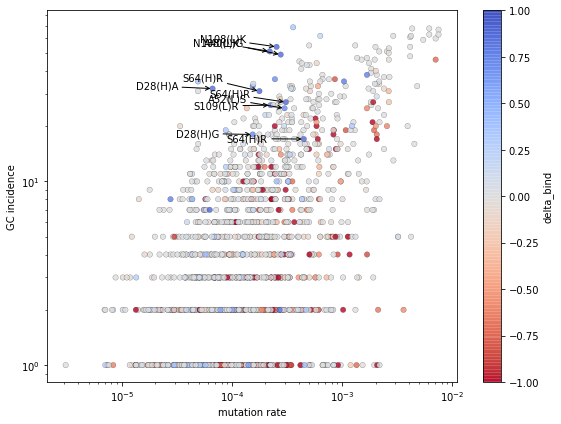

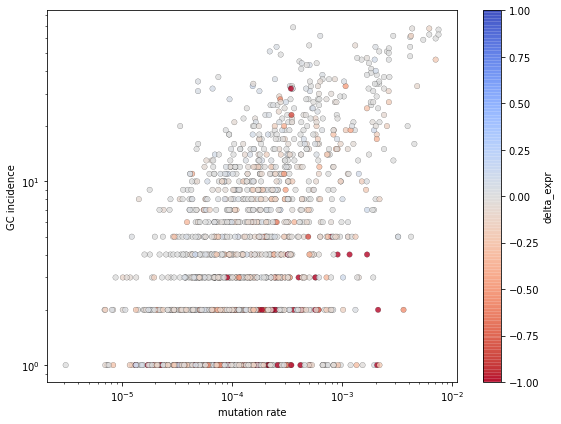

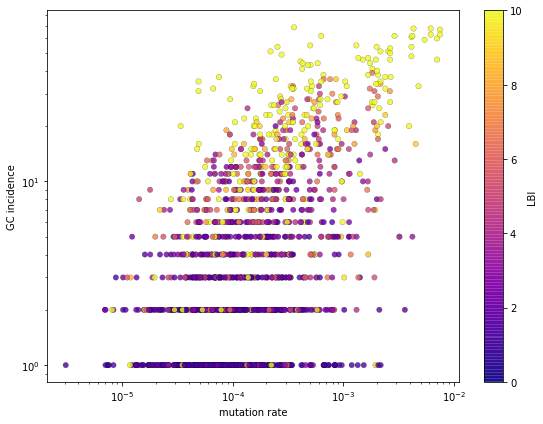

In [105]:
for prop in ("delta_bind", "delta_expr", "LBI"):
    if prop == "delta_bind":
        this_cmap = "coolwarm_r"
        this_vmin = -1
        this_vmax = 1
    elif prop == "delta_expr":
        this_cmap = "coolwarm_r"
        this_vmin = -1
        this_vmax = 1
    elif prop == "LBI":
        this_cmap = "plasma"
        this_vmin = vmin_LB
        this_vmax = vmax_LB
    plt.figure(figsize=(8, 6))
    plt.scatter(mut_df.loc[mut_df.delta_bind <= 0, "mutation rate"], mut_df.loc[mut_df.delta_bind <= 0, "GCs"], c=mut_df.loc[mut_df.delta_bind <= 0, prop], s=30,
                cmap=this_cmap, vmin=this_vmin, vmax=this_vmax, alpha=0.8, edgecolors="k", linewidths=0.2, zorder=0)
    plt.scatter(mut_df.loc[mut_df.delta_bind > 0, "mutation rate"], mut_df.loc[mut_df.delta_bind > 0, "GCs"], c=mut_df.loc[mut_df.delta_bind > 0, prop], s=30,
                cmap=this_cmap, vmin=this_vmin, vmax=this_vmax, alpha=0.8, edgecolors="k", linewidths=0.2 , zorder=1)
    if prop == "delta_bind":
        for _, row in mut_df.iterrows():
            if row.delta_bind > 0.7 and row.GCs > 13 and row["mutation rate"] < 1e-3:
                xy = np.array([row["mutation rate"], row.GCs])
                xytext = xy * np.array([0.2, 1 - 0.1 * np.random.randn()])
                plt.annotate(row["aa_mutation"], xy, xytext=xytext,
                             arrowprops=dict(arrowstyle="->", connectionstyle="arc3"))
    plt.xscale("log")
    plt.yscale("log")
    plt.xlabel("mutation rate")
    plt.ylabel("GC incidence")
    plt.colorbar(label=prop)
    plt.tight_layout()
    plt.savefig(f"output/plots/mutation_incidence.{prop}.pdf")
    plt.show()

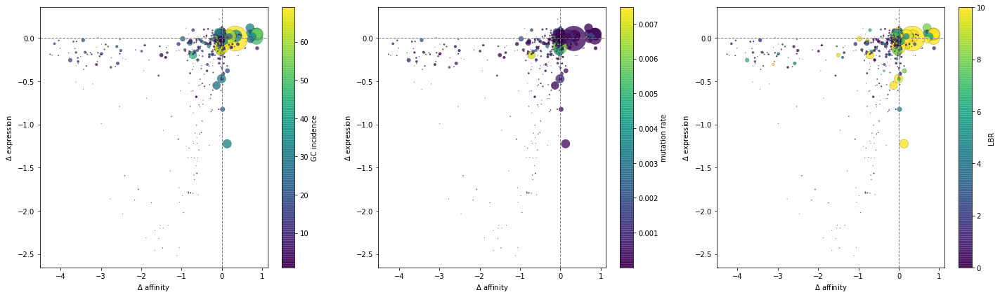

In [106]:
plt.figure(figsize=(20, 6))
plt.subplot(1, 3, 1)
plt.scatter(mut_df.delta_bind, mut_df.delta_expr, s=0.5*mut_df.cells, c=mut_df.GCs,
            cmap="viridis", alpha=0.8, edgecolors="k", linewidths=0.2, zorder=0)
plt.axvline(0, ls="--", lw=1, c="grey", zorder=1)
plt.axhline(0, ls="--", lw=1, c="grey", zorder=1)
plt.xlabel(r"$\Delta$ affinity")
plt.ylabel(r"$\Delta$ expression")
plt.colorbar(label="GC incidence")

plt.subplot(1, 3, 2)
plt.scatter(mut_df.delta_bind, mut_df.delta_expr, s=0.5*mut_df.cells, c=mut_df["mutation rate"],
            cmap="viridis", alpha=0.8, edgecolors="k", linewidths=0.2, zorder=0)
plt.axvline(0, ls="--", lw=1, c="grey", zorder=1)
plt.axhline(0, ls="--", lw=1, c="grey", zorder=1)
plt.xlabel(r"$\Delta$ affinity")
plt.ylabel(r"$\Delta$ expression")
plt.colorbar(label="mutation rate")

plt.subplot(1, 3, 3)
plt.scatter(mut_df.delta_bind, mut_df.delta_expr, s=0.5*mut_df.cells, c=mut_df.LBR,
            cmap="viridis", alpha=0.8, edgecolors="k", linewidths=0.2, zorder=0, vmax=10)
plt.axvline(0, ls="--", lw=1, c="grey", zorder=1)
plt.axhline(0, ls="--", lw=1, c="grey", zorder=1)
plt.xlabel(r"$\Delta$ affinity")
plt.ylabel(r"$\Delta$ expression")
plt.colorbar(label="LBR")

plt.tight_layout()
plt.savefig(f"output/plots/single_mut_GCs.pdf")
plt.show()

In [107]:
mut_df[(mut_df.delta_expr < -0.4) & (mut_df.cells > 10) & (mut_df.LBR > 5) & (mut_df.GCs > 10)]

,aa_mutation,site,chain,mutation rate,delta_bind,delta_expr,GCs,cells,LBI,LBR
nt_mutation,,,,,,,,,,
A442C,Y42(L)S,L-042,L,0.000345,0.01732,-0.82562,23,88,6.786382,5.046174
A442G,Y42(L)C,L-042,L,0.001071,-0.01042,-0.47209,33,308,42.066563,12.650237
T441A,Y42(L)N,L-042,L,0.000341,0.12851,-1.22449,32,312,33.837426,11.429015
T441C,Y42(L)H,L-042,L,0.000273,-0.13246,-0.54999,28,251,20.685283,14.468062
T519C,F76(L)L,L-076,L,0.000295,0.00246,-0.47632,11,40,12.536409,6.631863


What's linked to these?

2d mutation pair plot

In [109]:
dat = []
for gc, tree in trees.items():
    naive_igh_aa = aa(tree.tree.sequence[:igk_idx], igh_frame)
    naive_igk_aa = aa(tree.tree.sequence[igk_idx:], igk_frame)

    for node in tree.tree.traverse():
        if node.abundance:
            igh_aa = aa(node.sequence[:igk_idx], igh_frame)
            igk_aa = aa(node.sequence[igk_idx:], igk_frame)
            igh_mutations = mutations(naive_igh_aa, igh_aa, igh_pos_map, "(H)")
            igk_mutations = mutations(naive_igk_aa, igk_aa, igk_pos_map, "(L)")        
            all_mutations = igh_mutations + igk_mutations
            for i in range(len(all_mutations)):
                for j in range(i + 1, len(all_mutations)):
                    dat.append((all_mutations[i], all_mutations[j], gc))

list(set(dat))
            
#             if any("Y42(L)" in mut for mut in all_mutations):
#                 print(gc, node.abundance, all_mutations)

[('T96(H)A', 'Y42(L)N', 'mouse3_GC44'),
 ('S64(H)N', 'T65(H)A', 'mouse1_GC16'),
 ('E1(H)D', 'A105(H)G', 'mouse1_GC15'),
 ('Y55(L)S', 'S92(L)N', 'mouse4_GC73'),
 ('T82(H)S', 'N108(L)Q', 'mouse8_GC87'),
 ('N92(H)S', 'A105(H)G', 'mouse3_GC57'),
 ('T90(L)A', 'N108(L)K', 'mouse2_GC29'),
 ('T65(H)S', 'S109(L)N', 'mouse1_GC1'),
 ('S64(H)R', 'E101(L)D', 'mouse1_GC16'),
 ('K44(H)R', 'N108(L)K', 'mouse2_GC34'),
 ('F108(H)C', 'T116(H)A', 'mouse8_GC88'),
 ('K72(H)R', 'Q105(L)H', 'mouse8_GC89'),
 ('A105(H)G', 'S92(L)R', 'mouse3_GC43'),
 ('I76(H)F', 'Y88(H)S', 'mouse8_GC86'),
 ('A105(H)G', 'N28(L)D', 'mouse8_GC84'),
 ('A100(H)G', 'V15(L)A', 'mouse8_GC85'),
 ('Y87(H)C', 'A100(H)G', 'mouse8_GC89'),
 ('S70(H)Y', 'E101(L)D', 'mouse3_GC58'),
 ('I78(H)F', 'T96(H)I', 'mouse7_GC90'),
 ('T101(H)A', 'S121(H)P', 'mouse8_GC85'),
 ('G36(L)D', 'T37(L)S', 'mouse3_GC45'),
 ('L4(H)F', 'G36(L)E', 'mouse8_GC86'),
 ('S64(H)R', 'T37(L)L', 'mouse2_GC24'),
 ('A105(H)G', 'Q95(L)*', 'mouse2_GC24'),
 ('N40(H)I', 'V110(H)I', 

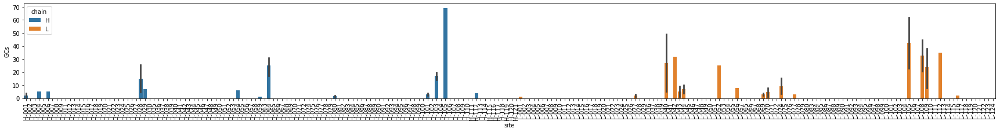

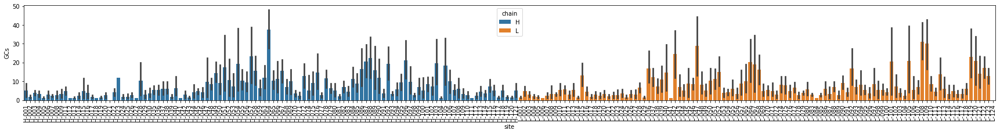

In [111]:
order = [f"{row.chain}-{str(row.site).zfill(3)}" for _, row in pos_df.iterrows() if row.chain != "link"]

plt.figure(figsize=(30, 3))
g = sns.barplot(data=mut_df[mut_df.delta_bind>0.1], x="site", y="GCs", hue="chain", dodge=False,
                order=order)
for item in g.get_xticklabels():
    item.set_rotation(90)
plt.show()

plt.figure(figsize=(30, 3))
g = sns.barplot(data=mut_df[mut_df.delta_expr<1.0], x="site", y="GCs", hue="chain", dodge=False,
                order=order)
for item in g.get_xticklabels():
    item.set_rotation(90)
plt.show()

# Distributions of affinity effects of mutations on trees

Let's look at phenotypic effects of *sitewise* first-step mutations. We can do this sitewise because we are using an additive model. This would also work with a global epistasis model, with an additive latent space.

In [66]:
# def hit_counts(tree):
#     node_generator = tree.tree.traverse()
#     root = next(node)
#     root.add_feature("hit counts", [0] * len(naive_igh_aa))
#     naive_igh_aa = aa(tree.tree.sequence[:igk_idx], igh_frame)
#     naive_igk_aa = aa(tree.tree.sequence[igk_idx:], igk_frame)
#     for node in node_generator:
#         igh_aa = aa(node.sequence[:igk_idx], igh_frame)
#         igk_aa = aa(node.sequence[igk_idx:], igk_frame)

In [101]:
# def mutation_effects(node):
#     if node.up is None:
#         return []
#     naive_igh_aa = aa(tree.tree.sequence[:igk_idx], igh_frame)
#     naive_igk_aa = aa(tree.tree.sequence[igk_idx:], igk_frame)
#     parent_igh_aa = aa(node.up.sequence[:igk_idx], igh_frame)
#     parent_igk_aa = aa(node.up.sequence[igk_idx:], igk_frame)
#     parent_igh_mutations = mutations(naive_igh_aa, parent_igh_aa, igh_pos_map, "(H)")
#     parent_igk_mutations = mutations(naive_igk_aa, parent_igk_aa, igk_pos_map, "(L)")
#     parent_mutations = parent_igh_mutations + parent_igk_mutations
    
#     igh_aa = aa(node.sequence[:igk_idx], igh_frame)
#     igk_aa = aa(node.sequence[igk_idx:], igk_frame)
#     igh_mutations = mutations(parent_igh_aa, igh_aa, igh_pos_map, "(H)")
#     igk_mutations = mutations(parent_igk_aa, igk_aa, igk_pos_map, "(L)")
#     node_mutations = igh_mutations + igk_mutations

#     for mutation in node_mutations:
#         match = [parent_mutation for parent_mutation in parent_mutations if parent_mutation[1:] == mutation[1:]]
# #         dms_df.mutation[dms_df.mutation.str[1:] == mutation[1:]]
#         assert len(match) < 2
#         print(match)
#         if len(match) = 0:
#             effect = dms_df.delta_bind[dms_df.mutation == mutation].iloc[0]
#             print(effect)
#         else:
#             print
# #         print(mutation)
# #         print(match)
    
# #     print(parent_igh_mutations + parent_igk_mutations)
# #     print(igh_mutations + igk_mutations)
    
# #     sum_delta_bind = dms_df.delta_bind[dms_df.mutation.isin(igh_mutations + igk_mutations)].sum()
    
#     return 

In [264]:
rows = []
for gc, tree in trees.items():
    for node in tree.tree.traverse():
        # need internal nodes for LB
#         if node.abundance > 0:
        rows.append([gc, node.abundance, node.LBI, node.LBR, node.delta_bind_tdms, node.delta_bind_additive, node.delta_expr_tdms, node.delta_expr_additive])
LBI_df = pd.DataFrame(rows, columns=["GC", "abundance", "LBI", "LBR", "delta_bind_tdms", "delta_bind_additive", "delta_expr_tdms", "delta_expr_additive"])
LBI_df

,GC,abundance,LBI,LBR,delta_bind_tdms,delta_bind_additive,delta_expr_tdms,delta_expr_additive
0,mouse1_GC1,0,9.858943,NaN,0.000000,0.00000,0.000000,0.00000
1,mouse1_GC1,1,1.162257,0.000000,0.217069,-0.06082,-0.463159,0.14827
2,mouse1_GC1,1,1.000148,0.000000,-0.666148,-3.45668,-4.993756,-1.05627
3,mouse1_GC1,1,5.218850,0.225363,-0.531296,-0.80796,-0.484772,-0.15104
4,mouse1_GC1,0,3.105732,1.672156,-3.386702,-7.71074,-1.497348,-0.77924
...,...,...,...,...,...,...,...,...
5566,mouse8_GC89,1,1.022942,0.000000,1.375150,1.85844,-2.768892,-0.21270
5567,mouse8_GC89,1,2.787414,0.000000,1.321078,2.05805,-2.627425,-0.02356
5568,mouse8_GC89,1,2.787414,0.000000,1.333047,2.05647,-2.658383,-0.14268
5569,mouse8_GC89,1,1.241900,0.000000,1.367573,2.11229,-2.727252,-0.08620


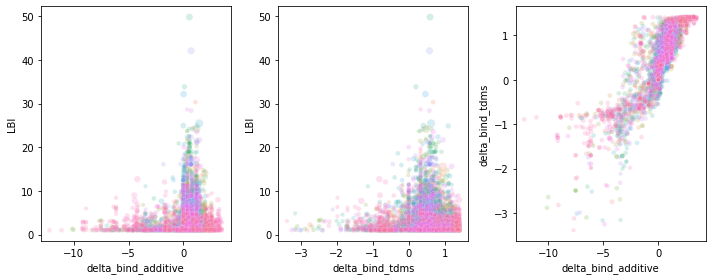

In [265]:
plt.figure(figsize=(10, 4))
plt.subplot(1, 3, 1)
sns.scatterplot(data=LBI_df, x="delta_bind_additive", y="LBI", size="abundance", hue="GC", legend=False, alpha=0.2)
plt.subplot(1, 3, 2)
sns.scatterplot(data=LBI_df, x="delta_bind_tdms", y="LBI", size="abundance", hue="GC", legend=False, alpha=0.2)
plt.subplot(1, 3, 3)
sns.scatterplot(data=LBI_df, x="delta_bind_additive", y="delta_bind_tdms", size="abundance", hue="GC", legend=False, alpha=0.2)
plt.tight_layout()
plt.savefig("output/plots/LBI_scatter.pdf")
plt.show()

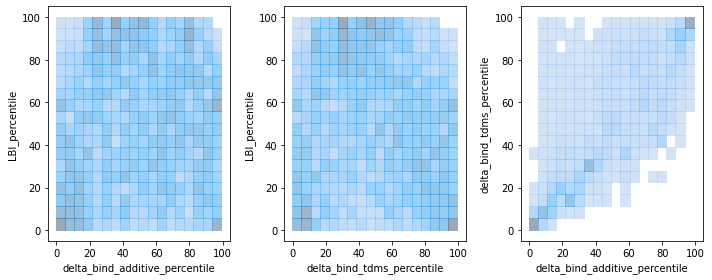

In [139]:
LBI_df["delta_bind_additive_percentile"] = [percentileofscore(LBI_df["delta_bind_additive"], x) for x in LBI_df["delta_bind_additive"]]
LBI_df["delta_bind_tdms_percentile"] = [percentileofscore(LBI_df["delta_bind_tdms"], x) for x in LBI_df["delta_bind_tdms"]]
LBI_df["LBI_percentile"] = [percentileofscore(LBI_df["LBI"], x) for x in LBI_df["LBI"]]

plt.figure(figsize=(10, 4))
plt.subplot(1, 3, 1)
sns.histplot(data=LBI_df, x="delta_bind_additive_percentile", y="LBI_percentile", legend=False, alpha=0.5)
plt.subplot(1, 3, 2)
sns.histplot(data=LBI_df, x="delta_bind_tdms_percentile", y="LBI_percentile", legend=False, alpha=0.5)
plt.subplot(1, 3, 3)
sns.histplot(data=LBI_df, x="delta_bind_additive_percentile", y="delta_bind_tdms_percentile", legend=False, alpha=0.5)
plt.tight_layout()
# plt.savefig("output/plots/LBI_scatter.pdf")
plt.show()

## Octet data

In [140]:
octet_df = pd.read_csv("data/211118 DMS vs. octet minimal.csv")

for row_idx, row in octet_df.iterrows():
    igh_mutations = [f"{(y := x.rstrip(','))[:-1]}(H){y[-1]}".rstrip(",") for x in row.HCmut.split() if "GL" not in x]
    igk_mutations = [f"{(y := x.rstrip(','))[:-1]}(L){y[-1]}".rstrip(",") for x in row.LCmut.split() if "GL" not in x]
    all_mutations = igh_mutations + igk_mutations
    if any("*" in x for x in all_mutations):
        delta_bind = None
    else:
        delta_bind = dms_df.delta_bind[all_mutations].sum()
    octet_df.loc[row_idx, "delta_bind_additive"] = delta_bind
    
    aa_seq = pos_df.amino_acid.copy()
    for mutation in all_mutations:
        chain = mutation[-3]
        pos = int(mutation[1:-4])
        wildtype = mutation[0]
        mutant = mutation[-1]
        idx = pos_df.index[(pos_df.site == pos) & (pos_df.chain == chain)]
        assert len(idx) == 1
        idx = idx[0]
        assert aa_seq[idx] == wildtype
        aa_seq[idx] = mutant
    tdms_prediction = tdms_model(tdms_model.seq_to_binary("".join(aa_seq))).detach()# - tdms_prediction_naive
    octet_df.loc[row_idx, "delta_bind_tdms"] = tdms_prediction[0].item()

octet_df["delta_bind_octet"] = np.log10(octet_df.octet_Kd_foldchange_avg)
    
octet_df

,ID,HCmut,LCmut,aa_mut_total,deltaKd_additive_foldchange,deltaKd_additive,octet_Kd_foldchange_avg,kd,kon,kdis,R^2,delta_bind_additive,delta_bind_tdms,delta_bind_octet
0,#26 Fab4,"K49R, Y58F",A40G,3,7.462082,0.87286,6.364276,2.840000e-09,126300,0.000359,0.9993,0.87286,0.387297,0.803749
1,A40G,GL,A40G,1,7.172326,0.85566,6.952912,4.210000e-09,90900,0.000383,0.9997,0.85566,0.272536,0.842167
2,A40V,GL,A40V,1,0.193201,-0.71399,0.642593,5.400000e-08,142000,0.007670,0.9746,-0.71399,-1.111057,-0.192064
3,"A40V, N108D",GL,"A40V, N108D",2,0.031422,-1.50277,0.376934,7.110000e-08,111000,0.007920,0.9266,-1.50277,-1.854077,-0.423735
4,D28A,D28A,GL,1,6.835810,0.83479,5.774278,3.810000e-09,225000,0.000858,0.9944,0.83479,0.357808,0.761498
5,EH1,"D28A, K44R, S64G","A40G, Y42F, A52S, Q105H, N108Y",8,2558.998315,3.40807,308.192458,7.690000e-11,933000,0.000072,0.9919,3.40807,1.219445,2.488822
6,EH2,"D28A, K49R, S64G","A40G, Y42F, A52S, Q105H, N108Y",8,2154.269337,3.33330,383.495146,6.180000e-11,1030000,0.000063,0.9947,3.33330,1.212977,2.583760
7,EH3,"D28A, K44R, K49R, S64G","A40G, Y42F, A52S, Q105H, N108Y",9,2499.769702,3.39790,361.280488,6.560000e-11,1050000,0.000069,0.9900,3.39790,1.234029,2.557845
8,GL,GL,GL,0,1.000000,0.00000,1.000000,2.600000e-08,86700,0.002260,0.9900,0.00000,-0.161065,0.000000
9,K44R,K44R,GL,1,1.160379,0.06460,0.986547,2.230000e-08,152000,0.003400,0.9950,0.06460,0.162699,-0.005882


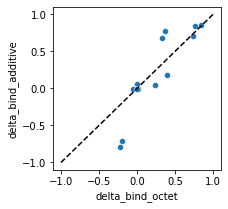

In [141]:
# single mutants
plt.figure(figsize=(3, 3))
sns.scatterplot(data=octet_df.loc[octet_df.aa_mut_total == 1], x="delta_bind_octet", y="delta_bind_additive")
plt.plot((-1, 1), (-1, 1), 'k--')
plt.show()

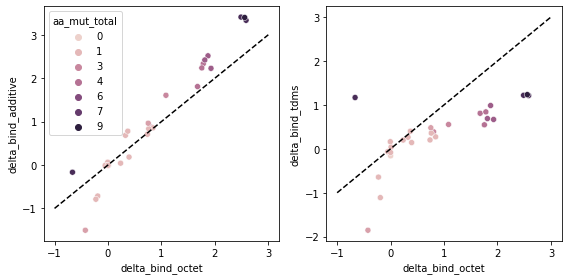

In [142]:
fig, axes = plt.subplots(1, 2, figsize=(8, 4))
sns.scatterplot(data=octet_df, x="delta_bind_octet", y="delta_bind_additive", hue="aa_mut_total", ax=axes[0])
axes[0].plot((-1, 3), (-1, 3), 'k--')
sns.scatterplot(data=octet_df, x="delta_bind_octet", y="delta_bind_tdms", hue="aa_mut_total", legend=False, ax=axes[1])
axes[1].plot((-1, 3), (-1, 3), 'k--')
plt.tight_layout()
plt.savefig("output/plots/octet.pdf")
plt.show()

## Clonal bursts / inertial proliferation

Find the elbows

In [143]:
dat = []
burst_thresh = 10
for gc, tree in trees.items():
    for node in tree.tree.traverse():
        for child in node.children:
            delta_delta_bind = child.delta_bind_additive - node.delta_bind_additive
            delta_delta_expr = child.delta_expr_additive - node.delta_expr_additive
            dat.append([gc, tree.tree.get_distance(node), node.delta_bind_additive, node.LBR, node.LBR >= burst_thresh, delta_delta_bind, delta_delta_expr, child.dist])
burst_df = pd.DataFrame(dat, columns=("GC", "parent divergence", r"parent $\Delta$ affinity", "parent LBR", "parent burst", r"$\Delta\Delta$ affinity", r"$\Delta\Delta$ expression", "branch length (number of mutations)"))
burst_df

,GC,parent divergence,parent $\Delta$ affinity,parent LBR,parent burst,$\Delta\Delta$ affinity,$\Delta\Delta$ expression,branch length (number of mutations)
0,mouse1_GC1,0.0,0.00000,NaN,False,-0.06082,0.14827,4.0
1,mouse1_GC1,0.0,0.00000,NaN,False,-3.45668,-1.05627,11.0
2,mouse1_GC1,0.0,0.00000,NaN,False,-0.80796,-0.15104,1.0
3,mouse1_GC1,0.0,0.00000,NaN,False,-7.71074,-0.77924,4.0
4,mouse1_GC1,0.0,0.00000,NaN,False,0.33100,-0.00561,1.0
...,...,...,...,...,...,...,...,...
5492,mouse8_GC89,19.0,2.06606,0.584759,False,-0.20762,-0.15254,5.0
5493,mouse8_GC89,19.0,2.06944,1.107766,False,-0.01139,0.01139,1.0
5494,mouse8_GC89,19.0,2.06944,1.107766,False,-0.01297,-0.10773,1.0
5495,mouse8_GC89,19.0,2.06944,1.107766,False,0.04285,-0.05125,3.0


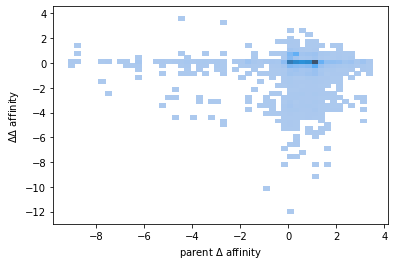

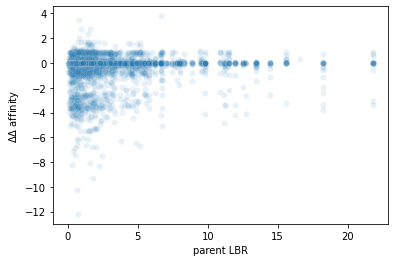

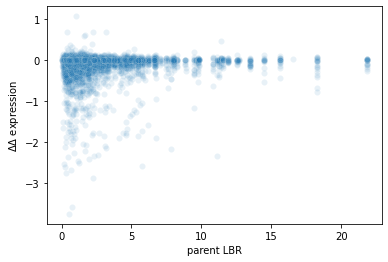

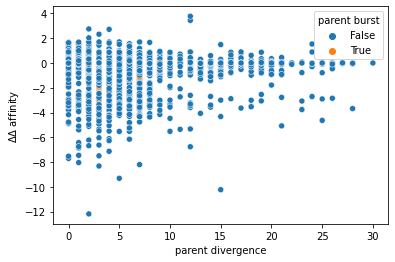

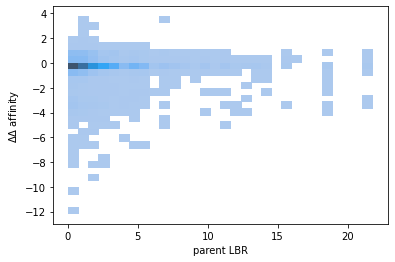

...

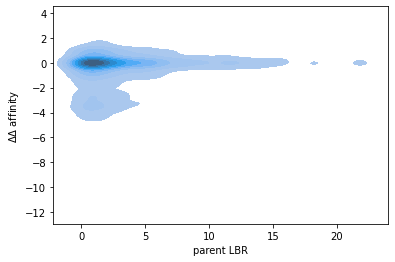

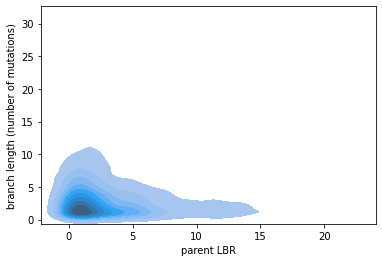

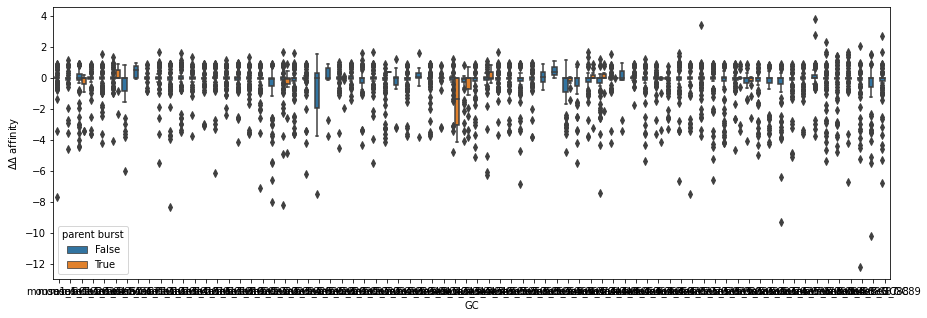

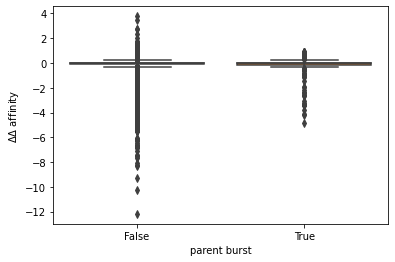

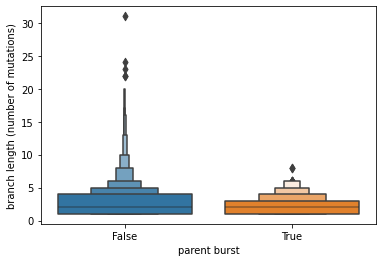

In [144]:
sns.histplot(data=burst_df, x=r"parent $\Delta$ affinity", y=r"$\Delta\Delta$ affinity", bins=50)
plt.show()

sns.scatterplot(data=burst_df, x="parent LBR", y=r"$\Delta\Delta$ affinity", alpha=0.1)#, hue="parent burst")
plt.show()

sns.scatterplot(data=burst_df, x="parent LBR", y=r"$\Delta\Delta$ expression", alpha=0.1)#, hue="parent burst")
plt.show()

sns.scatterplot(data=burst_df, x="parent divergence", y=r"$\Delta\Delta$ affinity", hue="parent burst")
plt.show()

sns.histplot(data=burst_df, x="parent LBR", y=r"$\Delta\Delta$ affinity", bins=30)#, hue="parent burst")
plt.show()

sns.histplot(data=burst_df, x="parent LBR", y="branch length (number of mutations)", bins=30)#, hue="parent burst")
plt.show()

sns.kdeplot(data=burst_df, x="parent LBR", y=r"$\Delta\Delta$ affinity", fill=True)#, hue="parent burst")
plt.show()

sns.kdeplot(data=burst_df, x="parent LBR", y="branch length (number of mutations)", fill=True)#, hue="parent burst")
plt.show()

plt.figure(figsize=(15, 5))
sns.boxplot(data=burst_df, y=r"$\Delta\Delta$ affinity", x="GC", hue="parent burst")
plt.show()

sns.boxplot(data=burst_df, y=r"$\Delta\Delta$ affinity", x="parent burst")
plt.show()

sns.boxenplot(data=burst_df, y="branch length (number of mutations)", x="parent burst")
plt.show()

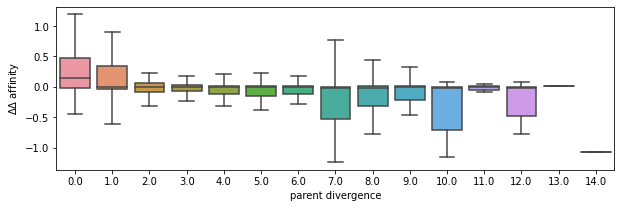

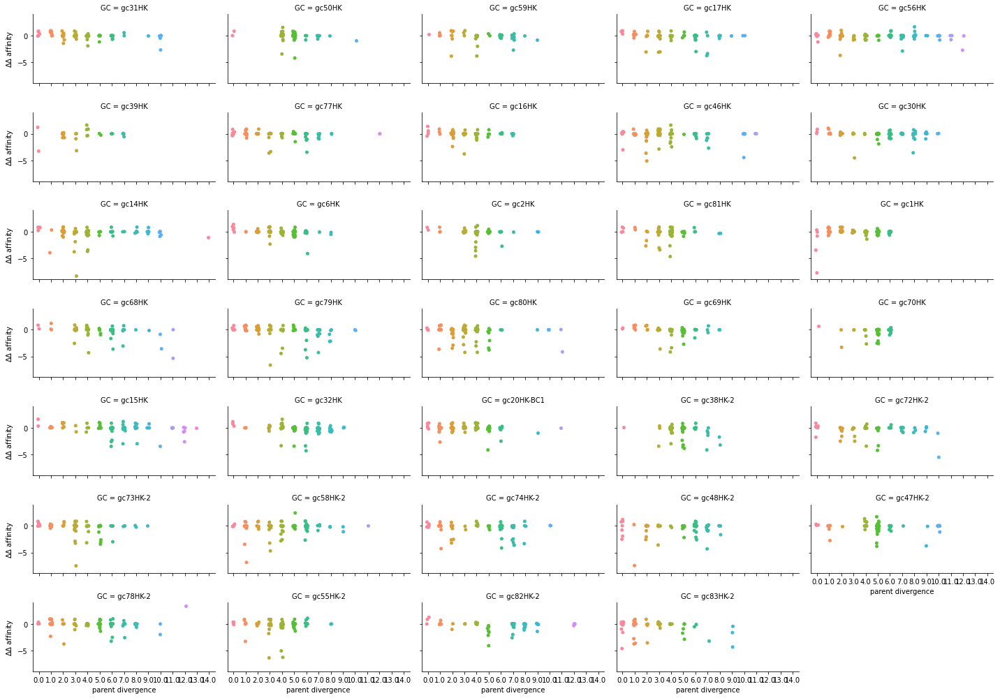

In [120]:
plt.figure(figsize=(10, 3))
sns.boxplot(data=burst_df, x="parent divergence", y=r"$\Delta\Delta$ affinity", showfliers=False)#, alpha=0.1)
# sns.lineplot(data=burst_df, x="parent divergence", y=r"$\Delta\Delta$ affinity")
plt.show()

sns.catplot(data=burst_df, kind="strip", col="GC", x="parent divergence", y=r"$\Delta\Delta$ affinity", aspect=2, height=2, col_wrap=5)#, legend=False)

plt.show()

### DMS-view

In [127]:
site_df = (dms_df[['position', 'delta_bind', 'delta_expr', 'delta_psr']]
           .melt(id_vars=['position'], var_name='condition')
           # to avoid multiindex, apply functions to the 'series' "value" ([])
           # not a dataframe ([[]])
           .groupby(['position', 'condition'])['value']
           .agg(('mean', 'max'))
           .reset_index()
           .rename(columns={'position': 'site', 'mean': 'site_mean', 'max': 'site_max'})
)
site_df['condition'] = site_df['condition'].map({'delta_bind': 'binding',
                                                 'delta_expr': 'expression',
                                                 'delta_psr': 'polyspecificity'})
site_df

,site,condition,site_mean,site_max
0,1,binding,0.081294,0.53365
1,1,expression,-0.029753,0.06551
2,1,polyspecificity,0.045481,0.58174
3,2,binding,-0.059908,0.28272
4,2,expression,-0.031882,0.06128
...,...,...,...,...
655,234,expression,-0.015218,0.11993
656,234,polyspecificity,-0.006957,0.15285
657,235,binding,-0.002362,0.04792
658,235,expression,0.047940,0.17410


In [128]:
mut_df = (dms_df[['position', 'delta_bind', 'delta_expr', 'delta_psr', 'mutant']]
          .rename(columns={'position': 'site', 'mutant': 'mutation'}))
mut_df = mut_df.melt(id_vars=['site', 'mutation'],
                     var_name='condition',
                     value_name='mut_delta')
mut_df['condition'] = mut_df['condition'].map({'delta_bind': 'binding',
                                              'delta_expr': 'expression',
                                              'delta_psr': 'polyspecificity'})
mut_df

,site,mutation,condition,mut_delta
0,1,A,binding,0.03110
1,1,C,binding,-0.01243
2,1,D,binding,-0.02948
3,1,E,binding,0.00000
4,1,F,binding,0.06180
...,...,...,...,...
13195,235,S,polyspecificity,0.07866
13196,235,T,polyspecificity,0.02896
13197,235,V,polyspecificity,-0.07899
13198,235,W,polyspecificity,0.05415


In [129]:
meta_df = dms_df[['position', 'wildtype', 'chain', 'position_IMGT']].copy().drop_duplicates()
meta_df['label_site'] = meta_df[['chain', 'position_IMGT', 'wildtype']].apply(lambda x: f'{x[2]}{x[1]}({x[0]})', axis=1)
meta_df = (meta_df[['position', 'wildtype', 'label_site']]
           .rename(columns={'position': 'site', 'chain': 'protein_chain', 'position_IMGT': 'protein_site'})
          )
meta_df['protein_chain'] = 'A'
meta_df['protein_site'] = meta_df['site']
meta_df

,site,wildtype,label_site,protein_chain,protein_site
mutation,,,,,
E1(H)A,1,E,E1(H),A,1
V2(H)A,2,V,V2(H),A,2
Q3(H)A,3,Q,Q3(H),A,3
L4(H)A,4,L,L4(H),A,4
Q5(H)A,5,Q,Q5(H),A,5
...,...,...,...,...,...
L120(L)A,231,L,L120(L),A,231
E121(L)A,232,E,E121(L),A,232
I122(L)A,233,I,I122(L),A,233


In [130]:
dmsview_df = pd.merge(site_df, mut_df, how='outer').merge(meta_df, how='outer')
dmsview_df

,site,condition,site_mean,site_max,mutation,mut_delta,wildtype,label_site,protein_chain,protein_site
0,1,binding,0.081294,0.53365,A,0.03110,E,E1(H),A,1
1,1,binding,0.081294,0.53365,C,-0.01243,E,E1(H),A,1
2,1,binding,0.081294,0.53365,D,-0.02948,E,E1(H),A,1
3,1,binding,0.081294,0.53365,E,0.00000,E,E1(H),A,1
4,1,binding,0.081294,0.53365,F,0.06180,E,E1(H),A,1
...,...,...,...,...,...,...,...,...,...,...
13195,235,polyspecificity,0.008772,0.24375,S,0.07866,R,R124(L),A,235
13196,235,polyspecificity,0.008772,0.24375,T,0.02896,R,R124(L),A,235
13197,235,polyspecificity,0.008772,0.24375,V,-0.07899,R,R124(L),A,235
13198,235,polyspecificity,0.008772,0.24375,W,0.05415,R,R124(L),A,235


In [131]:
dmsview_df.to_csv("output/dms-view/dms-view.csv")

In [132]:
target_sites = 'Q43(L),Q44(L),K45(L),P46(L),G47(L),Q48(L),S49(L),P50(L),K51(L)'

## Mutabilities on trees

In [133]:
max_mut = 0
min_mut = np.inf
for gc, tree in trees.items():        
    for node in tree.tree.traverse():
        sequence_H = "NN" + node.sequence[:igk_idx] + "NN"
        sequence_K = "NN" + node.sequence[igk_idx:] + "NN"
        # mutabilities of each nucleotide
        contexts = [sequence_H[(i - 2) : (i + 3)]
                        for i in range(2, len(sequence_H) - 2)
                       ] + [sequence_K[(i - 2) : (i + 3)]
                            for i in range(2, len(sequence_K) - 2)
                           ]
        mutabilities = np.array([mutability[context] for context in contexts])
        mutability_total = mutabilities.sum()
        if mutability_total > max_mut:
            max_mut = mutability_total
        if mutability_total < min_mut:
            min_mut = mutability_total
        node.add_feature("mutability", mutability_total)

gc31HK


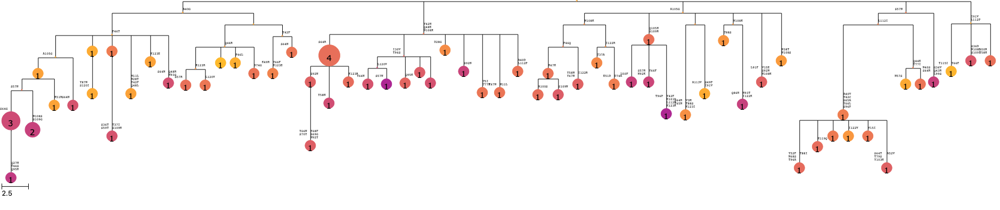

gc50HK


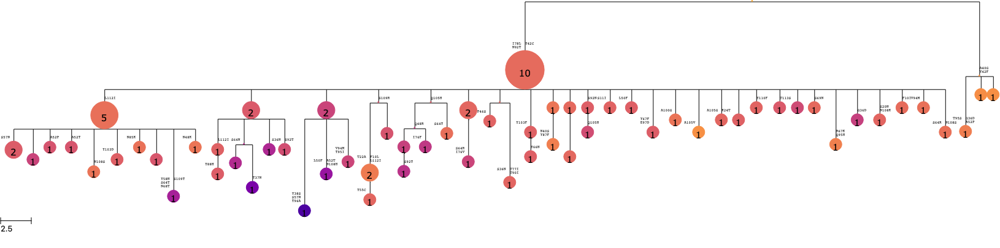

gc59HK


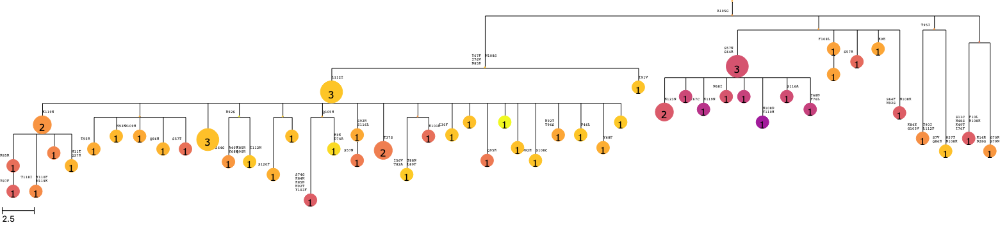

gc17HK


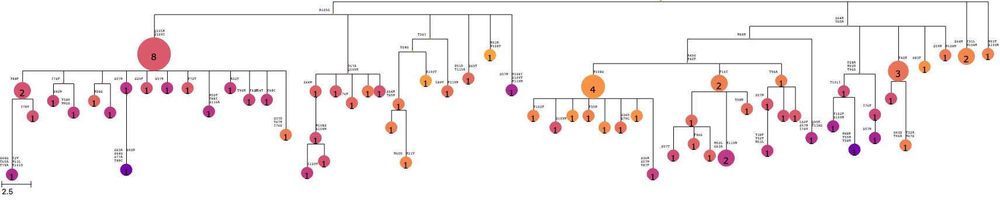

gc56HK


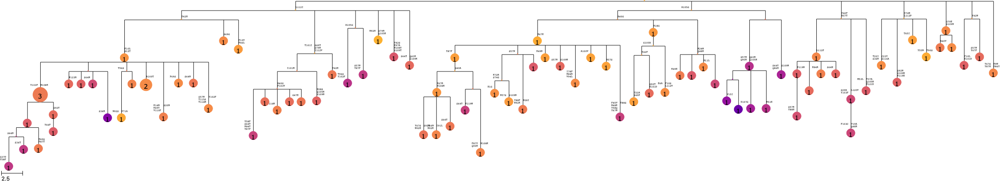

gc39HK


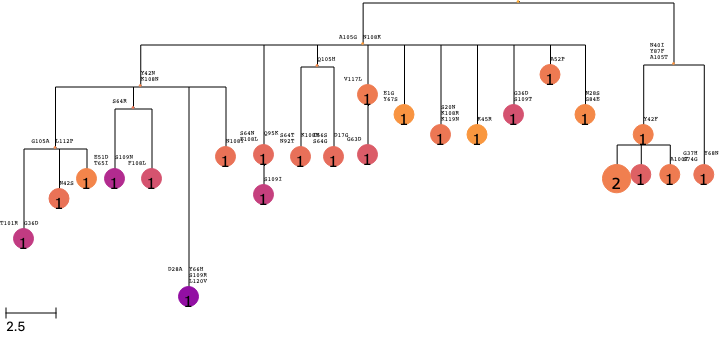

gc77HK


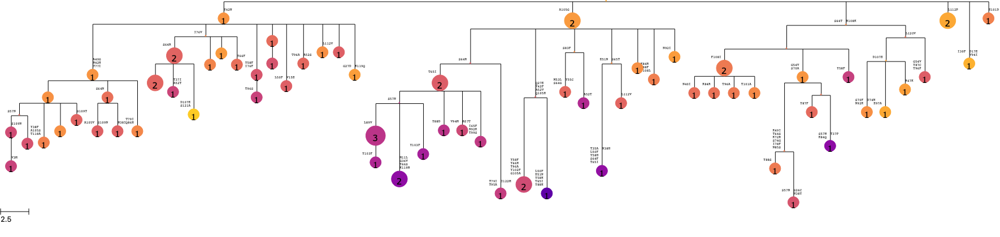

gc16HK


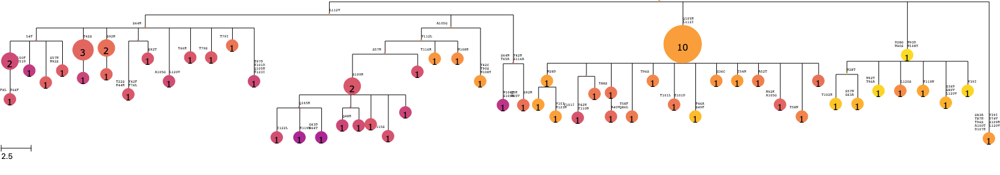

gc46HK


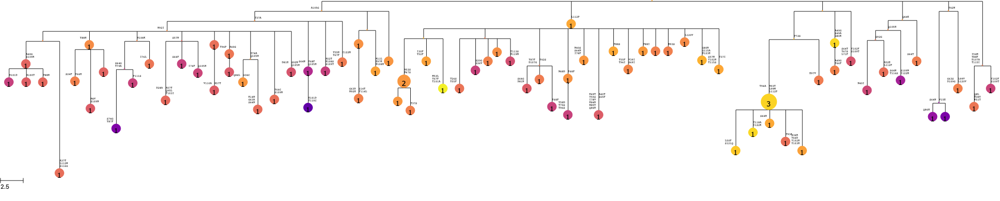

gc30HK


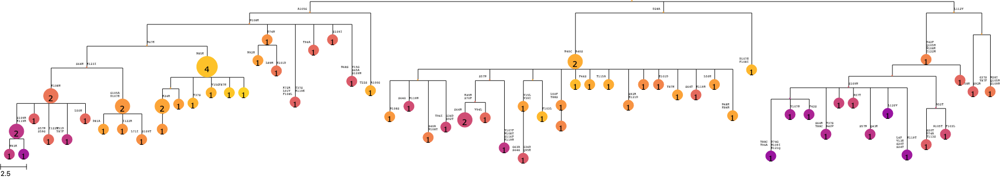

gc14HK


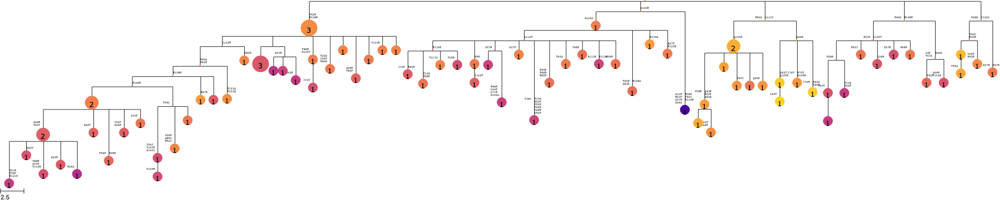

gc6HK


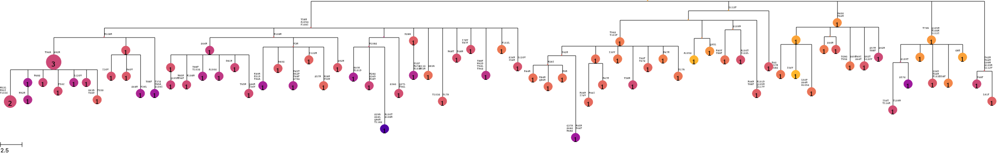

gc2HK


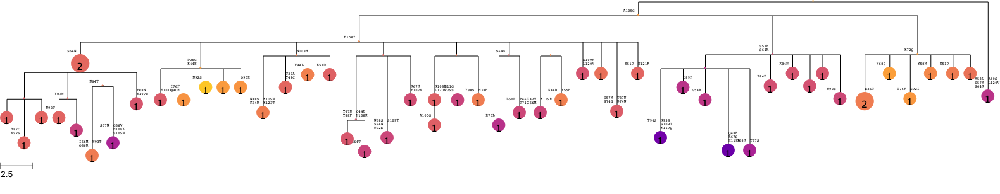

gc81HK


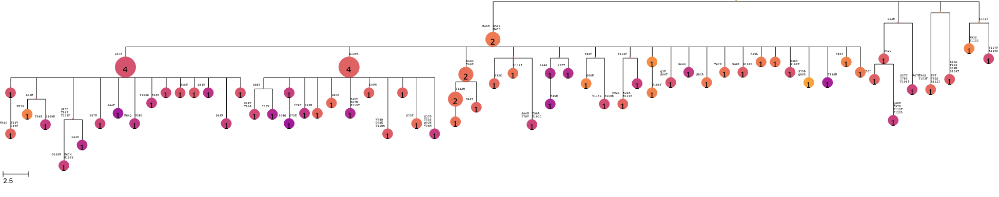

gc1HK


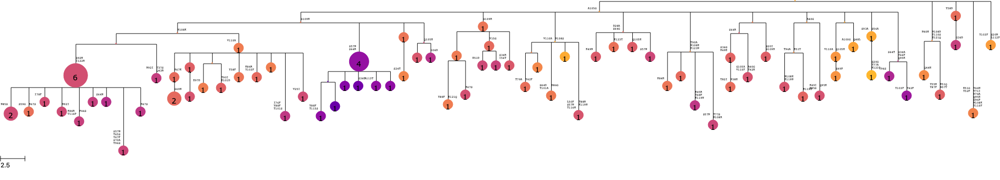

gc68HK


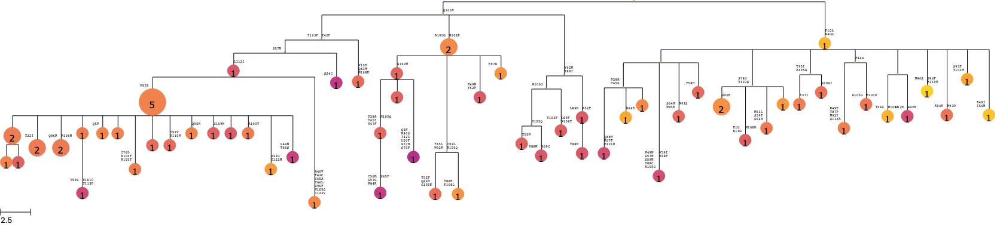

gc79HK


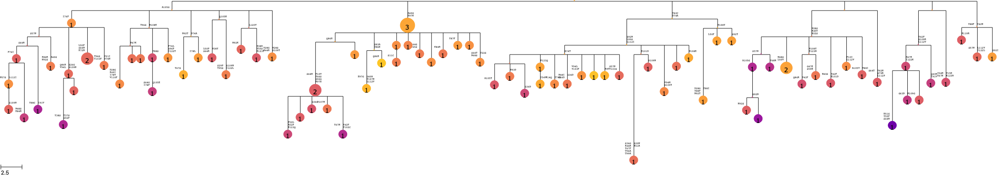

gc80HK


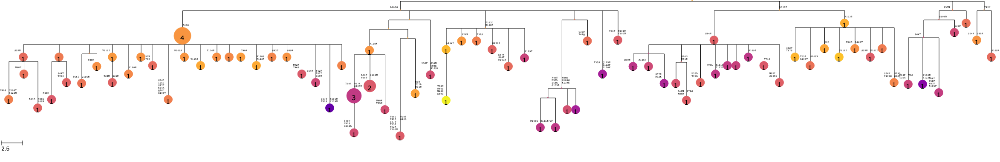

gc69HK


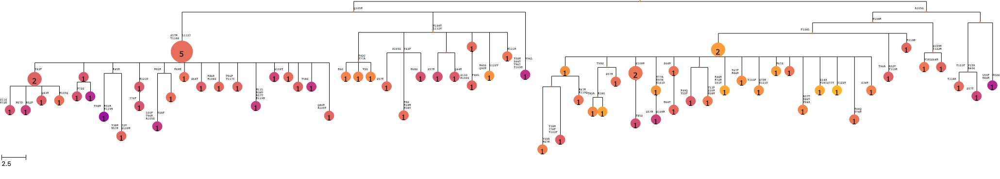

gc70HK


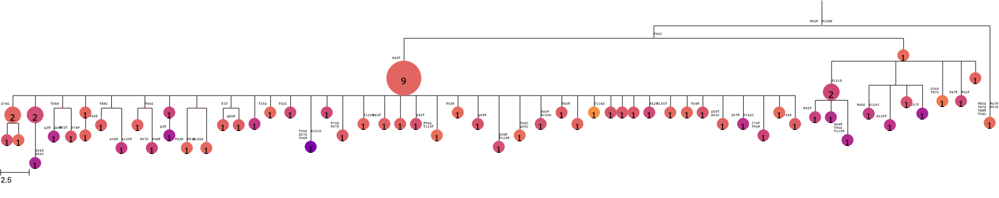

gc15HK


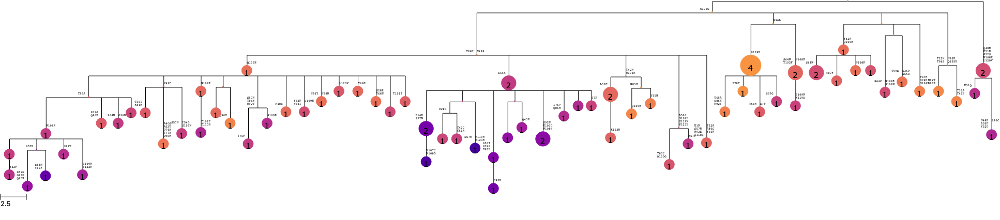

gc32HK


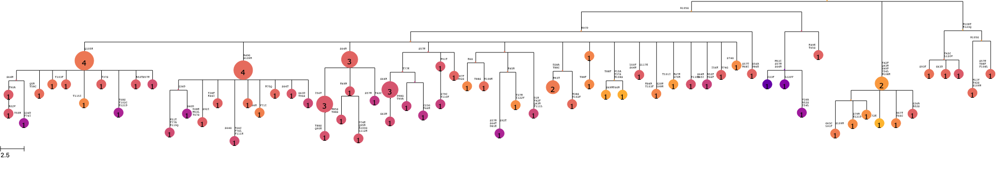

gc20HK-BC1


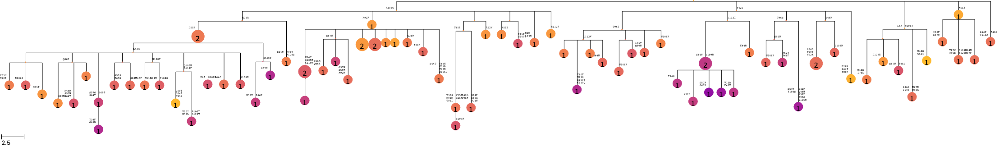

gc38HK-2


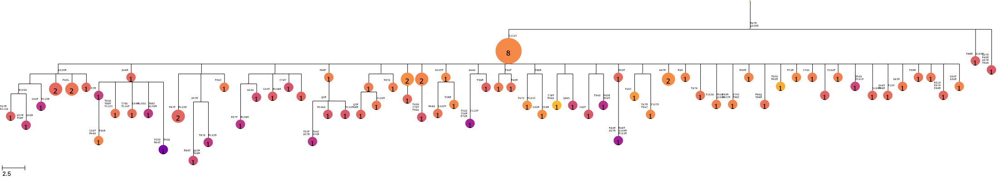

gc72HK-2


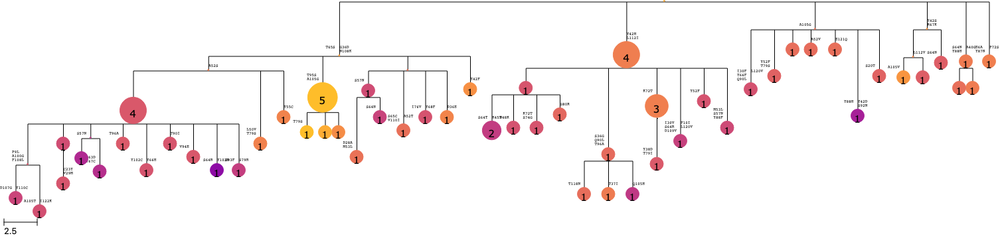

gc73HK-2


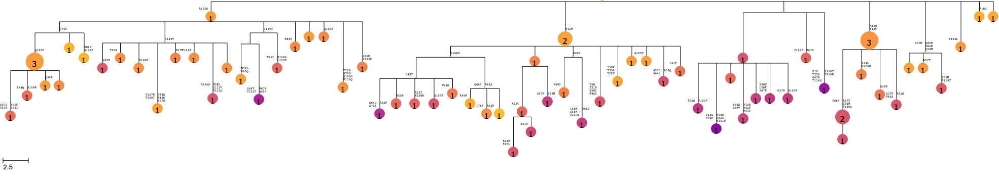

gc58HK-2


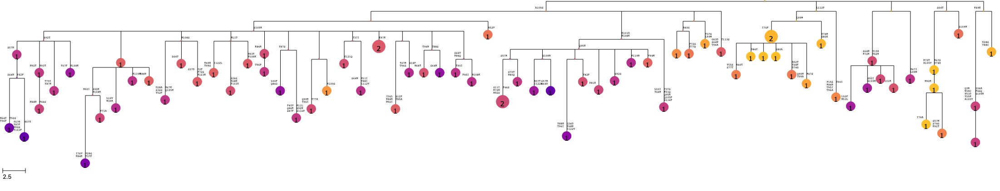

gc74HK-2


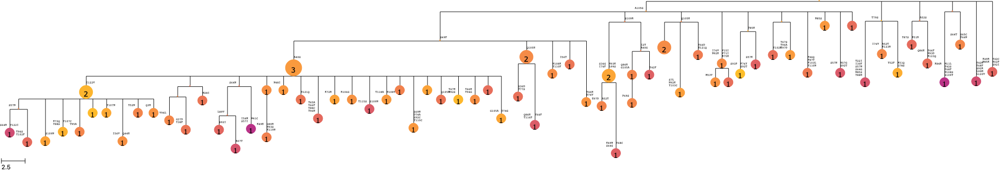

gc48HK-2


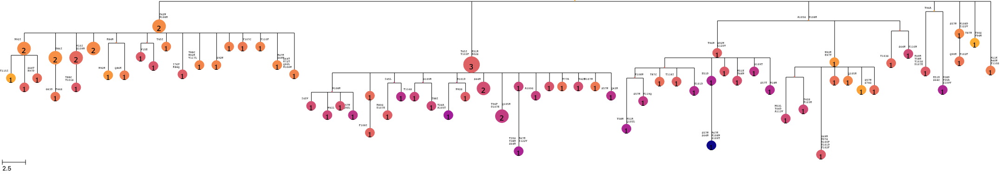

gc47HK-2


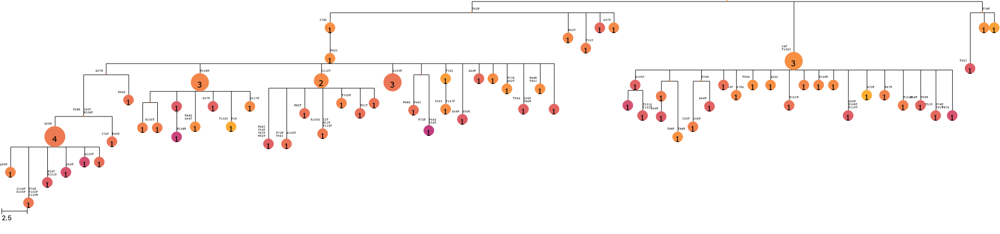

gc78HK-2


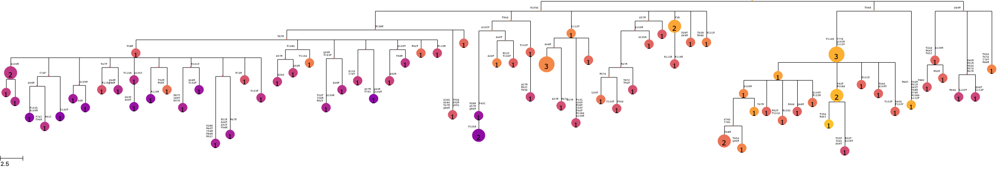

gc55HK-2


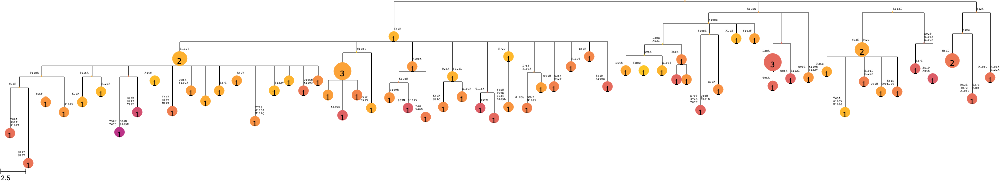

gc82HK-2


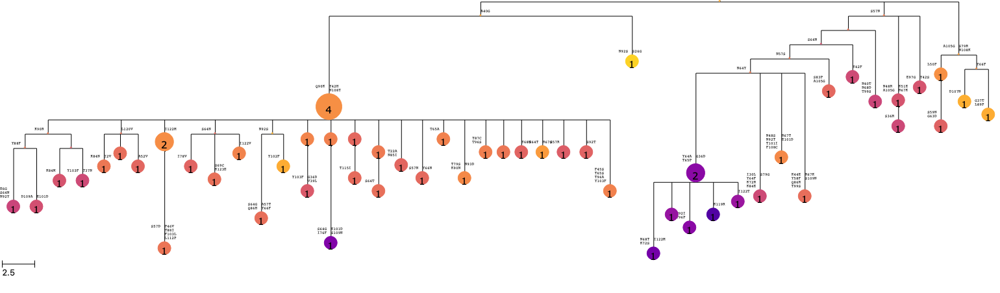

gc83HK-2


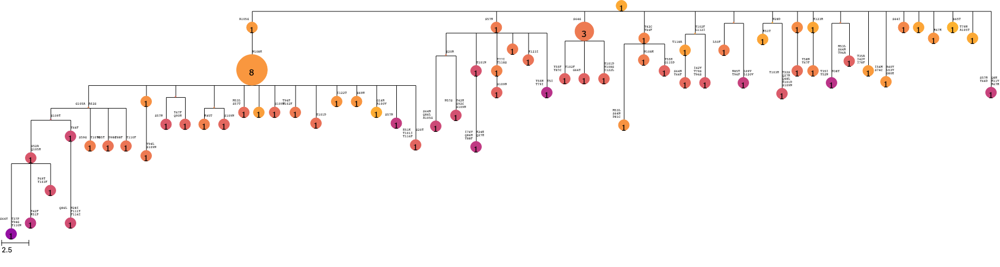

In [374]:
for gc, tree in trees.items():
    print(gc)
    colormap = tree.feature_colormap("mutability", cmap='plasma', vmin=min_mut, vmax=max_mut)
    for file in (f"output/plots/colormapped_gctrees/{gc}.mutability.svg", "%%inline"):
        rendering = tree.render(file, scale=20,
                            colormap=colormap,
                            frame=igh_frame, frame2=igk_frame, chain_split=igk_idx,
                            position_map=igh_pos_map, position_map2=igk_pos_map)
    display(rendering)

In [135]:
dat = []
for gc, tree in trees.items():        
    for node in tree.tree.traverse():
        dat.append([node.mutability, node.LBI])
mut_node_df = pd.DataFrame(dat, columns=("mutability", "LBI"))
mut_node_df

,mutability,LBI
0,0.585461,9.226658
1,0.586123,4.995467
2,0.575242,6.394071
3,0.582127,11.321017
4,0.574861,8.995503
...,...,...
2835,0.565565,4.173093
2836,0.563110,1.002497
2837,0.564685,1.429431
2838,0.557652,1.021380


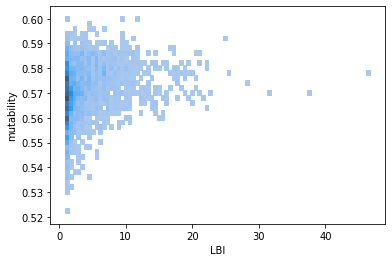

In [136]:
sns.histplot(data=mut_node_df, x="LBI", y="mutability")
plt.show()

## Distributions of phenotypes

**NOTE: trying tdms here!!!**

In [341]:
dat = []
for mousegc, tree in trees.items():
    mouse, gc = mousegc.split("_")
    mouse = mouse.lstrip("mouse")
    if mouse in ("7", "8"):
        print(f"skipping 10-week {mousegc}")
        continue
    if sum(node.abundance for node in tree.tree.traverse()) < 20:
        print(f"skipping low-abundance {mousegc}")
        continue
    gc = gc.lstrip("GC")
    
    clade_sizes = [sum(node.abundance for node in child.traverse()) for child in tree.tree.children]
    dom_score = max(clade_sizes) / sum(clade_sizes)
    max_LBR = np.nanmax([node.LBR for node in tree.tree.traverse()])
    
    for node in tree.tree.traverse():
        if node.abundance:
            dat.append([mouse, gc, dom_score, max_LBR, node.name, node.LBR, node.abundance, tree.tree.get_distance(node), node.delta_bind_tdms, node.delta_expr_tdms])

cell_df = pd.DataFrame(dat, columns=("mouse", "GC", "NDS", "maxLBR", "id", "LBR", "abundance", "divergence", r"$\Delta$ affinity", r"$\Delta$ expression"))

# cell_df.to_csv("/Users/wdewitt/Downloads/cell_distributions.csv")
cell_df

skipping low-abundance mouse1_GC11
skipping low-abundance mouse1_GC12
skipping low-abundance mouse2_GC28
skipping low-abundance mouse2_GC29
skipping low-abundance mouse2_GC39
skipping low-abundance mouse3_GC41
skipping low-abundance mouse3_GC64
skipping low-abundance mouse3_GC65
skipping low-abundance mouse4_GC63
skipping 10-week mouse7_GC90
skipping 10-week mouse8_GC84
skipping 10-week mouse8_GC85
skipping 10-week mouse8_GC86
skipping 10-week mouse8_GC87
skipping 10-week mouse8_GC88
skipping 10-week mouse8_GC89


,mouse,GC,NDS,maxLBR,id,LBR,abundance,divergence,$\Delta$ affinity,$\Delta$ expression
0,1,1,0.930233,4.531324,seq13,0.000000,1,4.0,0.217069,-0.463159
1,1,1,0.930233,4.531324,seq67,0.000000,1,11.0,-0.666148,-4.993756
2,1,1,0.930233,4.531324,seq72,0.225363,1,1.0,-0.531296,-0.484772
3,1,1,0.930233,4.531324,seq56,0.000000,1,3.0,-1.288873,-1.168497
4,1,1,0.930233,4.531324,seq75,0.000000,1,9.0,-2.820110,-3.062262
...,...,...,...,...,...,...,...,...,...,...
3831,6,77,0.354839,3.738641,seq11,0.000000,1,10.0,0.951050,-1.385422
3832,6,77,0.354839,3.738641,seq2,0.188066,2,12.0,1.063719,-2.612172
3833,6,77,0.354839,3.738641,seq36,0.554128,3,8.0,0.989085,-1.510946
3834,6,77,0.354839,3.738641,seq49,0.000000,1,10.0,0.699267,-1.779222


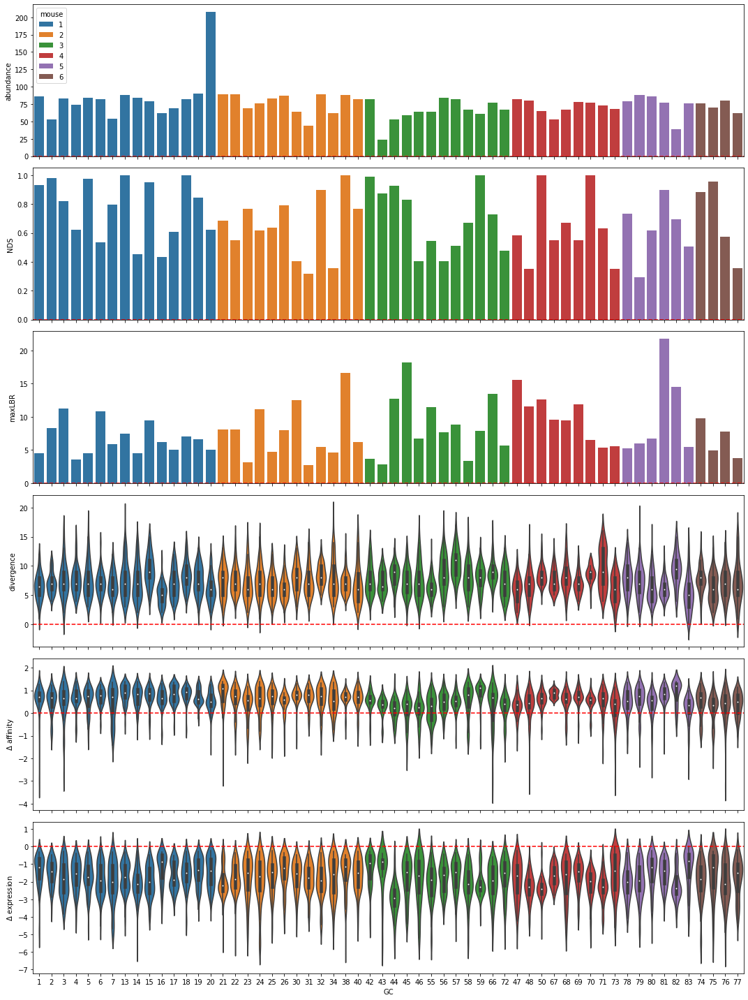

In [340]:
# sns.displot(data=cell_df, kind="kde", col="GC", x=r"$\Delta$ affinity", y=r"$\Delta$ expression",
#             weights="abundance",# bins=30,
#             col_wrap=4, height=2)
# plt.tight_layout()
# plt.show()

# sns.catplot(data=cell_df, kind="violin", y=r"$\Delta$ affinity", x="GC", sharex=False, row="mouse", weights="abundance", alpha=0.2)
# plt.show()

# sns.histplot(data=cell_df, hue="GC", x=r"$\Delta$ affinity",
#             weights="abundance", legend=False)
# plt.tight_layout()
# plt.show()

fig, axes = plt.subplots(6, 1, sharex="col", figsize=(15, 20))

sns.barplot(data=cell_df, x="GC", hue="mouse", y="abundance", ci=False, estimator=sum, dodge=False, ax=axes[0])
sns.move_legend(axes[0], "upper left")
axes[0].set(xlabel=None)
axes[0].axhline(0, ls="--", c="red")

sns.barplot(data=cell_df, x="GC", hue="mouse", y="NDS", ci=False, dodge=False, ax=axes[1])
axes[1].get_legend().remove()
axes[1].set(xlabel=None)
axes[1].axhline(0, ls="--", c="red")

sns.barplot(data=cell_df, x="GC", hue="mouse", y="maxLBR", ci=False, dodge=False, ax=axes[2])
axes[2].get_legend().remove()
axes[2].set(xlabel=None)
axes[2].axhline(0, ls="--", c="red")

ax = sns.violinplot(data=cell_df, x="GC", hue="mouse", y="divergence", weights="abundance", dodge=False, legend=False, ax=axes[3])
axes[3].get_legend().remove()
axes[3].set(xlabel=None)
axes[3].axhline(0, ls="--", c="red")

ax = sns.violinplot(data=cell_df, x="GC", hue="mouse", y=r"$\Delta$ affinity", weights="abundance", dodge=False, legend=False, ax=axes[4])
axes[4].get_legend().remove()
axes[4].set(xlabel=None)
axes[4].axhline(0, ls="--", c="red")

ax = sns.violinplot(data=cell_df, x="GC", hue="mouse", y=r"$\Delta$ expression", weights="abundance", dodge=False, legend=False, ax=axes[5])
axes[5].get_legend().remove()
axes[5].axhline(0, ls="--", c="red")

plt.tight_layout()
plt.savefig("output/plots/cell_distributions.pdf")
plt.show()

# sns.kdeplot(data=cell_df, hue="GC", x=r"$\Delta$ affinity", y=r"$\Delta$ expression",
#             weights="abundance", legend=False)
# plt.tight_layout()
# plt.show()

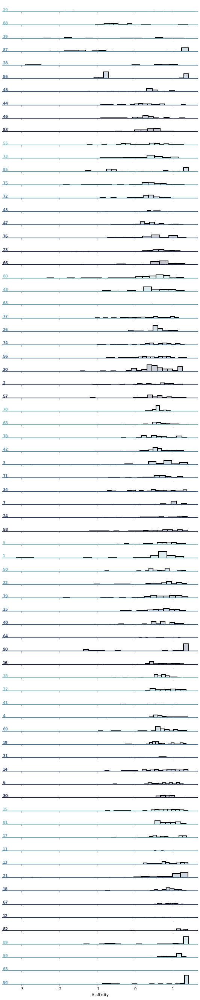

In [258]:
# rank by mean affinity
wm = lambda x: np.average(x, weights=cell_df.loc[x.index, "abundance"])
order = cell_df.groupby("GC").agg({r"$\Delta$ affinity": wm}).sort_values(r"$\Delta$ affinity").index

# Initialize the FacetGrid object
pal = sns.cubehelix_palette(10, rot=-.25, light=.7)
g = sns.FacetGrid(cell_df, row="GC", hue="GC",
                  row_order=order,
                  hue_order=order,
                  aspect=15, height=.5, palette=pal)

# Draw the densities in a few steps
g.map(sns.histplot, r"$\Delta$ affinity", weights=cell_df.abundance,
      bins=20, # bw_adjust=.5,
      clip_on=False,
      fill=True, alpha=1, linewidth=1.5)
g.map(sns.histplot, r"$\Delta$ affinity", weights=cell_df.abundance,
      clip_on=False, color="w", lw=2,
      bins=20, # bw_adjust=.5
     )

# passing color=None to refline() uses the hue mapping
g.refline(y=0, linewidth=2, linestyle="-", color=None, clip_on=False)


# Define and use a simple function to label the plot in axes coordinates
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, fontweight="bold", color=color,
            ha="left", va="center", transform=ax.transAxes)


g.map(label, r"$\Delta$ affinity")

# Set the subplots to overlap
g.figure.subplots_adjust(hspace=-.25)

# Remove axes details that don't play well with overlap
g.set_titles("")
g.set(yticks=[], ylabel="")
g.despine(bottom=True, left=True)
g.tight_layout()

In [140]:
sumstat_df = cell_df.groupby("GC").agg({r"$\Delta$ affinity": lambda x: sum(x > 0) / len(x),
                                         "LBR": max}).rename(columns={r"$\Delta$ affinity": r"affinity improvement fraction",
                                                                      "LBR": "max LBR"})
sumstat_df

,affinity improvement fraction,max LBR
GC,,
gc14HK,0.896907,4.551124
gc15HK,0.873563,9.463747
gc16HK,0.887324,6.466040
gc17HK,0.873418,5.017800
gc1HK,0.872340,4.225640
gc20HK-BC1,0.783505,3.946538
gc2HK,0.850746,8.186872
gc30HK,0.928571,12.551436
gc31HK,0.848837,5.381685


<AxesSubplot:xlabel='max LBR', ylabel='affinity improvement fraction'>

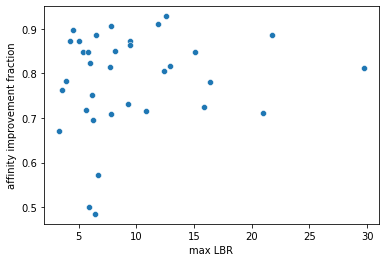

In [141]:
sns.scatterplot(data=sumstat_df, y="affinity improvement fraction", x="max LBR")

<ipython-input-142-e60004ff62f1>:28: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


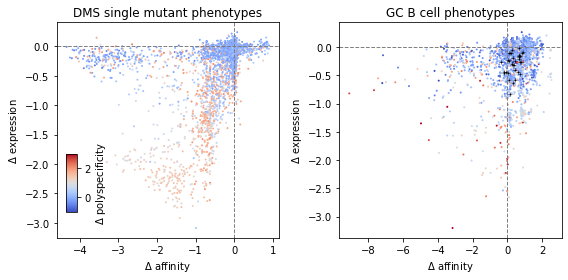

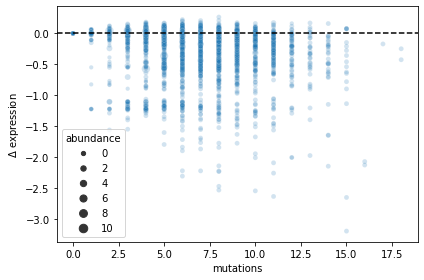

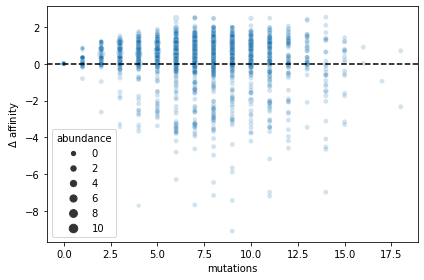

In [142]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(8, 4))

axes[0].scatter(dms_df.delta_bind, dms_df.delta_expr, c=dms_df.delta_psr, s=1, cmap="coolwarm", vmin=-1, vmax=3)
axes[0].axvline(0, ls="--", lw=1, c="grey")
axes[0].axhline(0, ls="--", lw=1, c="grey")
axes[0].set_xlabel(r"$\Delta$ affinity")
axes[0].set_ylabel(r"$\Delta$ expression")
axes[0].set_title("DMS single mutant phenotypes")

foo = axes[1].scatter(cell_df[r"$\Delta$ affinity"], cell_df[r"$\Delta$ expression"], c=cell_df[r"$\Delta$ polyspecificity"], s=cell_df.abundance, cmap="coolwarm", vmin=-1, vmax=3, zorder=0)
axes[1].axvline(0, ls="--", lw=1, c="grey", zorder=1)
axes[1].axhline(0, ls="--", lw=1, c="grey", zorder=1)
# Define a lambda function to compute the weighted mean:
wm = lambda x: np.average(x, weights=cell_df.loc[x.index, "abundance"])
cell_df_gc = cell_df.groupby("GC").agg({r"$\Delta$ affinity": wm,
                                        r"$\Delta$ expression": wm,
                                        r"$\Delta$ polyspecificity": wm,
                                        "abundance": "sum"})
axes[1].scatter(cell_df_gc[r"$\Delta$ affinity"], cell_df_gc[r"$\Delta$ expression"], c="k", s=10, linewidths=.5, cmap="coolwarm", vmin=-1, vmax=3, marker="+", zorder=2)
axes[1].set_xlabel(r"$\Delta$ affinity")
axes[1].set_ylabel(r"$\Delta$ expression")
axes[1].set_title("GC B cell phenotypes")

fig.subplots_adjust(right=0.8)
cbar_ax = fig.add_axes([.12, 0.25, 0.02, 0.2])
fig.colorbar(foo, cax=cbar_ax, label=r"$\Delta$ polyspecificity")

plt.tight_layout()
plt.savefig("output/plots/DMS_Vs_cell_phenotypes.pdf")
plt.show()


sns.scatterplot(data=cell_df, x=r"mutations", y=r"$\Delta$ expression", size="abundance", alpha=0.2)
plt.axhline(0, ls="--", c="k")
plt.tight_layout()
plt.show()

sns.scatterplot(data=cell_df, x=r"mutations", y=r"$\Delta$ affinity", size="abundance", alpha=0.2)
plt.axhline(0, ls="--", c="k")
plt.tight_layout()
plt.show()

1st plot is suggestive that expression degradation and affinity increase are not the same mutations. Let's look closer at this

In [143]:
dat = []
for gc, tree in trees.items():
    for node in tree.tree.traverse():
        if node.abundance:
            dat.append([gc, node.abundance, tree.tree.get_distance(node), node.delta_bind_additive, node.delta_expr_additive, node.delta_psr_additive])

gcmut_df = pd.DataFrame(dat, columns=("GC", "abundance", "mutations", r"$\Delta$ affinity", r"$\Delta$ expression", r"$\Delta$ polyspecificity"))
gcmut_df

,GC,abundance,mutations,$\Delta$ affinity,$\Delta$ expression,$\Delta$ polyspecificity
0,gc31HK,1,5.0,0.02777,-0.00359,-0.49514
1,gc31HK,1,5.0,-1.51624,-0.40323,-0.56967
2,gc31HK,1,6.0,-0.26601,-0.25516,0.16726
3,gc31HK,1,7.0,0.72164,-0.34072,-0.20558
4,gc31HK,1,5.0,1.01620,-0.05767,-0.09246
...,...,...,...,...,...,...
2288,gc83HK-2,1,9.0,1.02962,0.06592,0.22230
2289,gc83HK-2,1,14.0,-1.74805,-1.65148,2.52684
2290,gc83HK-2,1,11.0,0.57016,-0.26490,2.53541
2291,gc83HK-2,1,14.0,-0.60392,-2.14966,1.32374


## Adaptive trajectories

In [144]:
seq = naive
best_delta_bind_additive = 0
dat = [[0, "binding", 0],
       [0, "expression", 0],
       [0, "polyspecificity", 0]]
for step in range(1, 21):
    for i, nt in enumerate(seq):
        nts = list('ACGT')
        nts.remove(nt)
        for alt_nt in nts:
            neighbor = list(seq)
            neighbor[i] = alt_nt
            neighbor = "".join(neighbor)
            igh_aa = aa(neighbor[:igk_idx], igh_frame)
            igk_aa = aa(neighbor[igk_idx:], igk_frame)
            igh_mutations = mutations(naive_igh_aa, igh_aa, igh_pos_map, "(H)")
            igk_mutations = mutations(naive_igk_aa, igk_aa, igk_pos_map, "(L)")        
            all_mutations = igh_mutations + igk_mutations
            all_mutations = [mutation for mutation in all_mutations if "*" not in mutation]
            delta_bind_additive = dms_df.delta_bind[all_mutations].sum()
            if delta_bind_additive > best_delta_bind_additive:
                best_neighbor = neighbor
                best_delta_bind_additive = delta_bind_additive
                best_delta_expr_additive = dms_df.delta_expr[all_mutations].sum()
                best_delta_psr_additive = dms_df.delta_psr[all_mutations].sum()

    dat.append([step, "binding", best_delta_bind_additive])
    dat.append([step, "expression", best_delta_expr_additive])
    dat.append([step, "polyspecificity", best_delta_psr_additive])
    seq = best_neighbor

adaptive_df = pd.DataFrame(data=dat, columns=("mutations", "phenotype", r"$\Delta$ wrt naive"))
adaptive_df


,mutations,phenotype,$\Delta$ wrt naive
0,0,binding,0.00000
1,0,expression,0.00000
2,0,polyspecificity,0.00000
3,1,binding,0.87245
4,1,expression,-0.11810
...,...,...,...
58,19,expression,-0.60056
59,19,polyspecificity,4.42673
60,20,binding,10.66586
61,20,expression,-0.57233


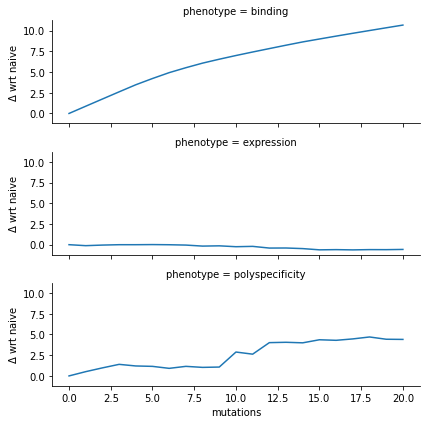

In [145]:
sns.relplot(data=adaptive_df, x="mutations", y=r"$\Delta$ wrt naive", row="phenotype", kind="line", height=2, aspect=3)
plt.show()

## Dominance score

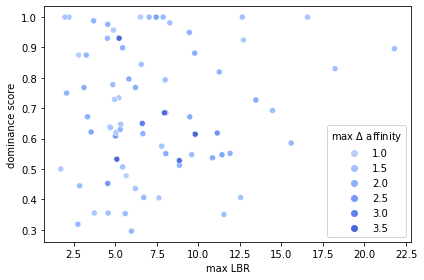

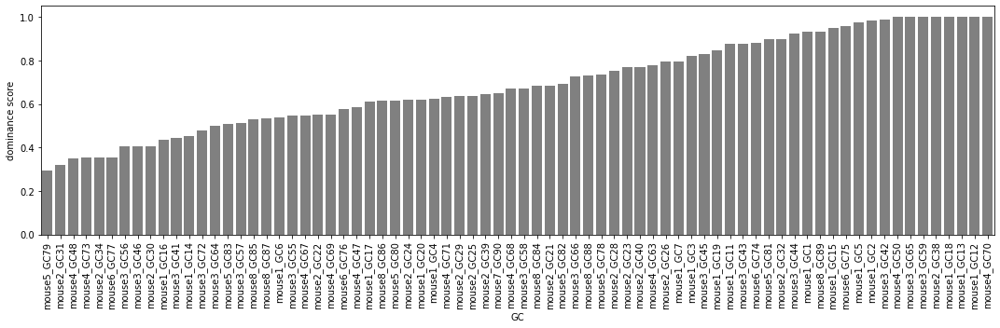

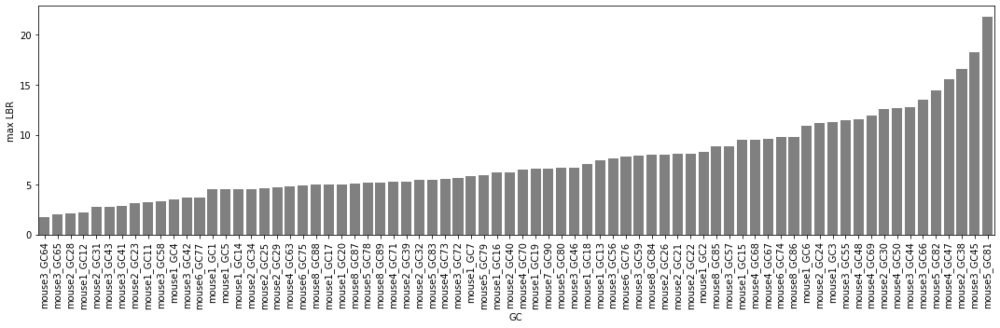

In [337]:
dat = []
for gc, tree in trees.items():
    clade_sizes = [sum(node.abundance for node in child.traverse()) for child in tree.tree.children]
#     dom_idx = np.argmax(clade_sizes)
#     score = clade_sizes[dom_idx] / sum(clade_sizes)
    score = max(clade_sizes) / sum(clade_sizes)
#     max_LBR = np.nanmax([node.LBR for node in tree.tree.children[dom_idx].traverse()])
    max_LBR = np.nanmax([node.LBR for node in tree.tree.traverse()])
#     max_delta_bind = np.nanmax([node.delta_bind_additive for node in tree.tree.children[dom_idx].traverse()])
    max_delta_bind = np.nanmax([node.delta_bind_additive for node in tree.tree.traverse()])
#     min_delta_bind = np.nanmin([node.delta_bind_additive for node in tree.tree.children[dom_idx].traverse()])
    min_delta_bind = np.nanmin([node.delta_bind_additive for node in tree.tree.traverse()])
#     max_delta_bind = max_delta_bind if abs(max_delta_bind) > abs(min_delta_bind) else min_delta_bind
    dat.append([gc, score, max_LBR, max_delta_bind])

dom_df = pd.DataFrame(dat, columns=("GC", "dominance score", "max LBR", r"max $\Delta$ affinity"))
sns.scatterplot(data=dom_df, x="max LBR", y="dominance score", hue=r"max $\Delta$ affinity",
                palette="coolwarm_r", hue_norm=(-4,4))
plt.tight_layout()
plt.savefig("output/plots/dominanceVsLBR.pdf")
plt.show()

plt.figure(figsize=(15, 5))
g = sns.barplot(data=dom_df.sort_values("dominance score"), x="GC", y="dominance score", color="grey")
g.set_xticklabels(g.get_xticklabels(), rotation=90)
plt.tight_layout()
plt.savefig("output/plots/dominance.pdf")
plt.show()

plt.figure(figsize=(15, 5))
g = sns.barplot(data=dom_df.sort_values("max LBR"), x="GC", y="max LBR", color="grey")
g.set_xticklabels(g.get_xticklabels(), rotation=90)
plt.tight_layout()
# plt.savefig("output/plots/LBR.pdf")
plt.show()

# dom_df.to_csv("output/domVsLBR.csv")

In [812]:
seq_incidence = defaultdict(list)
for gc, tree in trees.items():
    for node in tree.tree.traverse():
        if node.abundance:
            seq_incidence[node.sequence].append((gc, node.name, tree.tree.get_distance(node)))

# remove single GC incidence
for seq, gclist in list(seq_incidence.items()):
    if len(gclist) == 1:
        del seq_incidence[seq]
        
seq_incidence

defaultdict(list,
            {'GAGGTGCAGCTTCAGGAGTCAGGACCTAGCCTCGTGAAACCTTCTCAGACTCTGTCCCTCACCTGTTCTGTCACTGGCGACTCCATCACCAGTGGTTACTGGAACTGGATCCGGAAATTCCCAGGGAATAAACTTGAGTACATGGGGTACATAAGCTACAGTGGTAGCACTTACTACAATCCATCTCTCAAAAGTCGAATCTCCATCACTCGAGACACATCCAAGAACCAGTACTACCTGCAGTTGAATTCTGTGACTACTGAGGACACAGCCACATATTACTGTGGAAGGGACTTCGATGTCTGGGGCGCAGGGACCACGGTCACCGTCTCCTCAGACATTGTGATGACTCAGTCTCAAAAATTCATGTCCACATCAGTAGGAGACAGGGTCAGCGTCACCTGCAAGGCCAGTCAGAATGTGGGTACTAATGTAGCCTGGTATCAACAGAAACCAGGGCAATCTCCTAAAGCACTGATTTACTCGGCATCCTACAGGTACAGTGGAGTCCCTGATCGCTTCACAGGCAGTGGATCTGGGACAGATTTCACTCTCACCATCAGCAATGTGCAGTCTGAAGACTTGGCAGAGTATTTCTGTCAGCAATATAACAGCTATCCTCTCACGTTCGGCTCGGGGACTAAGCTAGAAATAAAA': [('gc77HK',
               'seq54',
               1.0),
              ('gc14HK', 'seq29', 3.0),
              ('gc73HK-2', 'seq21', 1.0),
              ('gc83HK-2', 'seq20', 1.0)],
             'GAGGTGCAGCTTCAGGAGTCAGGACCTAGCCTCGTGAAACCTTCTCAGACTCTGTCCCTCACCTGTTCTGTCACTGGCGACTCCATCACCAGTGGTTACTGGAACTGGATCC

## Biophysical properties

In [815]:
# a new version of this function to keep things in register. NOTE: assumes integer number of codons
def mutations2(naive_aa, aa):
    return [(pos, aa1, aa2)
            for pos, (aa1, aa2) in enumerate(zip(naive_aa, aa))
            if aa1 != aa2]



for gc, tree in trees.items():

    naive_aa = aa(tree.tree.sequence, 1)

    for node in tree.tree.traverse():

        node_aa = aa(node.sequence, 1)
        all_mutations = mutations2(naive_aa, node_aa)
        charge_profile = np.zeros_like(naive_aa)
        # gravy profile
        # aromaticity_profile
        
        for pos, wt, mut in all_mutations:
            

# pa = ProteinAnalysis("".join(pos_df.amino_acid))

# gravy_naive = pa.gravy()
# charge_naive = pa.charge_at_pH(7.4)

# for row_idx, row in dms_df.iterrows():
#     aa_seq = pos_df.amino_acid.copy()
#     assert aa_seq.loc[row.position] == row.wildtype
#     aa_seq.loc[row.position] = row.mutant
#     pa = ProteinAnalysis("".join(aa_seq))
#     dms_df.loc[row_idx, "delta_gravy"] = pa.gravy() - gravy_naive
#     dms_df.loc[row_idx, "delta_charge"] = pa.charge_at_pH(7.4) - charge_naive

[]
[(186, 'I', 'V'), (207, 'L', 'P')]
[(51, 'S', 'N')]
[(95, 'A', 'G')]
[(147, 'Y', 'H'), (153, 'Q', 'E'), (203, 'N', 'K')]
[(145, 'A', 'G')]
[(44, 'L', 'R'), (52, 'Y', 'H'), (186, 'I', 'V'), (207, 'L', 'P')]
[(141, 'G', 'D'), (186, 'I', 'V'), (203, 'N', 'D'), (204, 'S', 'I'), (207, 'L', 'P')]
[(105, 'T', 'I'), (164, 'Y', 'F'), (186, 'I', 'V'), (207, 'L', 'P')]
[(34, 'N', 'S'), (51, 'S', 'N'), (55, 'S', 'R'), (141, 'G', 'V'), (148, 'Q', 'R'), (194, 'L', 'S')]
[(51, 'S', 'N'), (207, 'L', 'I')]
[(95, 'A', 'G'), (143, 'N', 'T'), (203, 'N', 'S')]
[(81, 'L', 'F'), (95, 'A', 'G'), (126, 'V', 'E'), (187, 'S', 'N'), (203, 'N', 'H')]
[(95, 'A', 'G'), (203, 'N', 'K')]
[(95, 'A', 'G')]
[(95, 'A', 'G'), (200, 'Q', 'H'), (204, 'S', 'R')]
[(95, 'A', 'G'), (203, 'N', 'K')]
[(145, 'A', 'D'), (147, 'Y', 'H'), (153, 'Q', 'E'), (203, 'N', 'K'), (207, 'L', 'P')]
[(58, 'Y', 'N'), (122, 'M', 'L'), (147, 'Y', 'H'), (153, 'Q', 'E'), (203, 'N', 'K')]
[(116, 'T', 'I'), (147, 'Y', 'H'), (153, 'Q', 'E'), (174, 'T

[(55, 'S', 'N'), (95, 'A', 'G'), (142, 'T', 'A'), (166, 'Y', 'F'), (196, 'E', 'D'), (200, 'Q', 'H'), (205, 'Y', 'C')]
[(71, 'D', 'H'), (82, 'N', 'I'), (95, 'A', 'G'), (142, 'T', 'A'), (187, 'S', 'N'), (200, 'Q', 'H')]
[(82, 'N', 'I'), (95, 'A', 'G'), (142, 'T', 'A'), (164, 'Y', 'C'), (204, 'S', 'R')]
[(82, 'N', 'I'), (95, 'A', 'G'), (142, 'T', 'A'), (171, 'D', 'A'), (200, 'Q', 'H')]
[(82, 'N', 'I'), (86, 'T', 'P'), (95, 'A', 'G'), (142, 'T', 'A'), (145, 'A', 'G')]
[(82, 'N', 'I'), (95, 'A', 'G'), (142, 'T', 'A')]
[(51, 'S', 'N'), (82, 'N', 'I'), (95, 'A', 'G'), (142, 'T', 'A')]
[(82, 'N', 'I'), (95, 'A', 'G'), (142, 'T', 'A'), (203, 'N', 'K')]
[(78, 'Y', 'H'), (82, 'N', 'I'), (95, 'A', 'G'), (142, 'T', 'A')]
[(82, 'N', 'I'), (95, 'A', 'G'), (142, 'T', 'A')]
[(12, 'K', 'N'), (54, 'G', 'A'), (55, 'S', 'N'), (82, 'N', 'I'), (95, 'A', 'G'), (142, 'T', 'A'), (171, 'D', 'A'), (200, 'Q', 'H')]
[(76, 'Q', 'L'), (82, 'N', 'I'), (95, 'A', 'G'), (141, 'G', 'C'), (142, 'T', 'A'), (171, 'D', 'A'), 

[(84, 'V', 'A'), (139, 'N', 'H'), (145, 'A', 'G'), (147, 'Y', 'H'), (203, 'N', 'K'), (217, 'I', 'M')]
[(55, 'S', 'T'), (145, 'A', 'G'), (147, 'Y', 'H'), (203, 'N', 'K'), (217, 'I', 'M')]
[(55, 'S', 'R'), (56, 'T', 'I'), (145, 'A', 'G'), (147, 'Y', 'H'), (203, 'N', 'K'), (217, 'I', 'M')]
[(84, 'V', 'L'), (85, 'T', 'I'), (93, 'Y', 'F'), (99, 'D', 'N'), (111, 'S', 'L'), (145, 'A', 'G'), (147, 'Y', 'H'), (203, 'N', 'K'), (217, 'I', 'M')]
[(55, 'S', 'G'), (56, 'T', 'I'), (145, 'A', 'G'), (147, 'Y', 'H'), (203, 'N', 'K'), (217, 'I', 'M')]
[(54, 'G', 'N'), (55, 'S', 'R'), (56, 'T', 'I'), (145, 'A', 'G'), (147, 'Y', 'H'), (203, 'N', 'K'), (217, 'I', 'M')]
[(55, 'S', 'R'), (56, 'T', 'I'), (78, 'Y', 'N'), (83, 'S', 'P'), (106, 'T', 'M'), (145, 'A', 'G'), (147, 'Y', 'H'), (203, 'N', 'K'), (217, 'I', 'M')]
[(55, 'S', 'R'), (56, 'T', 'I'), (145, 'A', 'G'), (147, 'Y', 'H'), (187, 'S', 'T'), (203, 'N', 'K'), (217, 'I', 'M')]
[(55, 'S', 'R'), (56, 'T', 'I'), (145, 'A', 'G'), (147, 'Y', 'H'), (156, 'K'

[(76, 'Q', 'R'), (93, 'Y', 'F'), (147, 'Y', 'F'), (200, 'Q', 'H'), (203, 'N', 'H'), (207, 'L', 'I')]
[(20, 'T', 'I'), (93, 'Y', 'F'), (147, 'Y', 'F'), (200, 'Q', 'H'), (207, 'L', 'I')]
[(93, 'Y', 'F'), (147, 'Y', 'F'), (200, 'Q', 'H'), (207, 'L', 'I')]
[(89, 'T', 'S'), (93, 'Y', 'F'), (147, 'Y', 'F'), (196, 'E', 'D'), (200, 'Q', 'H'), (207, 'L', 'I'), (208, 'T', 'P')]
[(93, 'Y', 'F'), (147, 'Y', 'F'), (200, 'Q', 'H'), (207, 'L', 'I')]
[(93, 'Y', 'F'), (147, 'Y', 'F'), (200, 'Q', 'H'), (207, 'L', 'I')]
[]
[(78, 'Y', 'F'), (147, 'Y', 'N')]
[]
[]
[(147, 'Y', 'C'), (171, 'D', 'A')]
[(145, 'A', 'G'), (192, 'E', 'K')]
[(95, 'A', 'G')]
[(78, 'Y', 'F'), (147, 'Y', 'N'), (187, 'S', 'I')]
[(51, 'S', 'N'), (78, 'Y', 'F'), (147, 'Y', 'N'), (207, 'L', 'V'), (217, 'I', 'L')]
[(78, 'Y', 'F'), (147, 'Y', 'N'), (214, 'K', 'R')]
[(50, 'I', 'M'), (58, 'Y', 'H'), (126, 'V', 'E'), (218, 'K', 'R')]
[(147, 'Y', 'F'), (204, 'S', 'R'), (207, 'L', 'V')]
[(55, 'S', 'T'), (147, 'Y', 'H'), (176, 'S', 'R'), (207, '

[(95, 'A', 'G'), (145, 'A', 'G'), (192, 'E', 'D'), (204, 'S', 'R')]
[(95, 'A', 'G'), (192, 'E', 'D'), (200, 'Q', 'H')]
[(57, 'Y', 'N'), (78, 'Y', 'F'), (95, 'A', 'G'), (126, 'V', 'A'), (142, 'T', 'S'), (192, 'E', 'D'), (203, 'N', 'S')]
[(78, 'Y', 'F'), (95, 'A', 'G'), (126, 'V', 'A'), (142, 'T', 'S'), (167, 'S', 'N'), (192, 'E', 'D'), (203, 'N', 'S')]
[(78, 'Y', 'F'), (95, 'A', 'G'), (192, 'E', 'D')]
[(26, 'D', 'A'), (78, 'Y', 'C'), (95, 'A', 'G'), (143, 'N', 'S'), (192, 'E', 'D'), (197, 'Y', 'F')]
[(26, 'D', 'A'), (78, 'Y', 'C'), (95, 'A', 'G'), (188, 'N', 'T'), (192, 'E', 'D')]
[(95, 'A', 'G'), (112, 'D', 'H'), (147, 'Y', 'F'), (148, 'Q', 'R'), (192, 'E', 'D'), (206, 'P', 'L')]
[(95, 'A', 'G'), (150, 'K', 'R'), (192, 'E', 'D')]
[(5, 'E', 'G'), (95, 'A', 'G'), (192, 'E', 'D')]
[(51, 'S', 'N'), (95, 'A', 'G'), (192, 'E', 'D')]
[(51, 'S', 'N'), (95, 'A', 'G'), (156, 'K', 'T'), (192, 'E', 'D')]
[(51, 'S', 'N'), (95, 'A', 'G'), (174, 'T', 'K'), (192, 'E', 'D')]
[(51, 'S', 'N'), (55, 'S', 

[(95, 'A', 'G'), (151, 'P', 'Q'), (182, 'F', 'V'), (198, 'F', 'L'), (205, 'Y', 'N')]
[(95, 'A', 'G')]
[(95, 'A', 'G'), (180, 'T', 'K')]
[(66, 'I', 'V'), (82, 'N', 'K'), (95, 'A', 'G'), (126, 'V', 'I'), (169, 'V', 'I'), (172, 'R', 'H')]
[(95, 'A', 'G'), (200, 'Q', 'H')]
[(95, 'A', 'G'), (204, 'S', 'R')]
[(95, 'A', 'G'), (154, 'S', 'P')]
[(58, 'Y', 'S'), (86, 'T', 'A'), (87, 'E', 'D'), (95, 'A', 'G')]
[(95, 'A', 'G'), (197, 'Y', 'F')]
[(51, 'S', 'K'), (95, 'A', 'G'), (180, 'T', 'K')]
[(83, 'S', 'P'), (95, 'A', 'G'), (173, 'F', 'Y'), (180, 'T', 'K'), (187, 'S', 'T')]
[(66, 'I', 'V'), (82, 'N', 'K'), (95, 'A', 'G'), (126, 'V', 'I'), (169, 'V', 'I'), (172, 'R', 'H')]
[(47, 'M', 'V'), (66, 'I', 'V'), (82, 'N', 'K'), (95, 'A', 'G'), (126, 'V', 'I'), (169, 'V', 'I'), (172, 'R', 'H')]
[(95, 'A', 'G'), (164, 'Y', 'D'), (200, 'Q', 'H'), (216, 'E', 'Q')]
[(6, 'S', 'L'), (82, 'N', 'K'), (93, 'Y', 'C'), (95, 'A', 'G'), (200, 'Q', 'H')]
[(95, 'A', 'G'), (200, 'Q', 'H')]
[(95, 'A', 'G'), (113, 'I', 'T

[(52, 'Y', 'N'), (77, 'Y', 'H'), (95, 'A', 'G'), (203, 'N', 'K'), (204, 'S', 'R')]
[(52, 'Y', 'N'), (77, 'Y', 'H'), (95, 'A', 'G'), (203, 'N', 'K'), (204, 'S', 'R')]
[(52, 'Y', 'N'), (55, 'S', 'N'), (77, 'Y', 'H'), (86, 'T', 'A'), (95, 'A', 'G'), (188, 'N', 'I'), (203, 'N', 'K')]
[(52, 'Y', 'N'), (55, 'S', 'N'), (66, 'I', 'F'), (77, 'Y', 'H'), (95, 'A', 'G'), (198, 'F', 'L'), (203, 'N', 'K'), (204, 'S', 'N')]
[]
[(147, 'Y', 'H')]
[(207, 'L', 'I')]
[(95, 'A', 'G')]
[(147, 'Y', 'N')]
[(96, 'R', 'G'), (147, 'Y', 'H'), (203, 'N', 'K'), (217, 'I', 'M')]
[(145, 'A', 'G'), (147, 'Y', 'H')]
[(187, 'S', 'T'), (200, 'Q', 'H'), (204, 'S', 'N'), (207, 'L', 'I')]
[(82, 'N', 'K'), (147, 'Y', 'C'), (207, 'L', 'I')]
[(80, 'Q', 'L'), (95, 'A', 'G'), (214, 'K', 'R'), (217, 'I', 'V')]
[(95, 'A', 'G')]
[(95, 'A', 'G'), (203, 'N', 'S')]
[(45, 'E', 'D'), (90, 'A', 'G'), (147, 'Y', 'N')]
[(51, 'S', 'N'), (147, 'Y', 'N')]
[(147, 'Y', 'N'), (214, 'K', 'T')]
[(76, 'Q', 'H'), (141, 'G', 'N'), (147, 'Y', 'T')]
[(

[(69, 'T', 'N'), (95, 'A', 'T')]
[(163, 'S', 'T')]
[(165, 'R', 'K')]
[]
[(55, 'S', 'I')]
[(50, 'I', 'M'), (64, 'S', 'C'), (145, 'A', 'V'), (158, 'L', 'V'), (177, 'G', 'E')]
[(29, 'T', 'A'), (36, 'I', 'V'), (68, 'I', 'F')]
[]
[(218, 'K', 'R')]
[]
[(139, 'N', 'D')]
[]
[(197, 'Y', 'F'), (207, 'L', 'I')]
[(147, 'Y', 'C'), (164, 'Y', 'F')]
[(55, 'S', 'G')]
[(51, 'S', 'N')]
[(95, 'A', 'G')]
[(47, 'M', 'L'), (55, 'S', 'R'), (86, 'T', 'A')]
[(29, 'T', 'I'), (46, 'Y', 'N'), (143, 'N', 'Y')]
[(52, 'Y', 'N'), (58, 'Y', 'F'), (218, 'K', 'R')]
[]
[(93, 'Y', 'H'), (133, 'T', 'S'), (138, 'Q', 'R'), (139, 'N', 'D'), (153, 'Q', 'L'), (196, 'E', 'D'), (204, 'S', 'N')]
[(139, 'N', 'D'), (156, 'K', 'T')]
[(75, 'N', 'T'), (86, 'T', 'P'), (194, 'L', 'V'), (215, 'L', 'V')]
[(44, 'L', 'F')]
[(36, 'I', 'V'), (69, 'T', 'S'), (86, 'T', 'S'), (197, 'Y', 'F'), (207, 'L', 'I')]
[(108, 'T', 'A'), (197, 'Y', 'F'), (207, 'L', 'I')]
[(147, 'Y', 'C'), (160, 'Y', 'H'), (164, 'Y', 'F'), (210, 'G', 'D')]
[(147, 'Y', 'C'), 

# dNdS

In [362]:
from Bio.codonalign.codonseq import CodonSeq

# an arbitrary tree to get the naive seq from
tree = trees[next(iter(trees))]
padded_igh = "NN" + tree.tree.sequence[:igk_idx] + "NN"
padded_igk = "NN" + tree.tree.sequence[igk_idx:] + "NN"
# mutabilities of each nucleotide
contexts = [padded_igh[(i - 2) : (i + 3)]
                for i in range(2, len(padded_igh) - 2)
               ] + [padded_igk[(i - 2) : (i + 3)]
                    for i in range(2, len(padded_igk) - 2)
                   ]
assert len(contexts) == len(tree.tree.sequence)

# mutation rates at each site in naive
mutation_rates_nt = pd.concat((mutability[context] * substitution.loc[context] for context in contexts), axis=1).T.reset_index()

# now we want the above at the codon level
codons = CodonSeq(tree.tree.sequence)

# dataframe for counting S/NS mutations
df_dNdS = pd.DataFrame(0, index=range(codons.get_codon_num()), columns=["mu_S", "mu_NS", "n_S", "n_NS"])

# AA properties
df_prop = pd.DataFrame(index=range(codons.get_codon_num()), columns=["hydrophobicity"])

for codon_idx in range(codons.get_codon_num()):
    codon = CodonSeq(codons.get_codon(codon_idx))
    aa = codon.translate()
    pa = ProteinAnalysis(aa)
    df_prop.loc[codon_idx, "hydrophobicity"] = pa.gravy()
    for codon_pos in range(3):
        idx = 3 * codon_idx + codon_pos
        assert tree.tree.sequence[idx] == codon[codon_pos]
        for alt_nt in "ACGT":
            if alt_nt != tree.tree.sequence[idx]:
                mutated_codon = list(codon)
                mutated_codon[codon_pos] = alt_nt
                mutated_codon = CodonSeq("".join(mutated_codon))
                mutated_aa = mutated_codon.translate()
                df_dNdS.loc[codon_idx, "mu_S" if mutated_aa == aa else "mu_NS"] += mutation_rates_nt.loc[idx, alt_nt]

<AxesSubplot:>

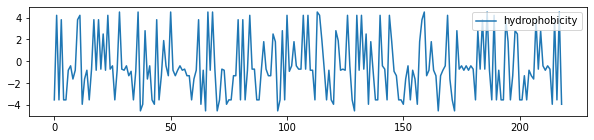

In [363]:
df_prop.plot(figsize=(10, 2))

Ok now we compare this to variant data from replay trees, looking at site-wise first-step mutations

In [364]:
for ct, (gc, tree) in enumerate(trees.items()):
    for codon_idx in range(codons.get_codon_num()):
        def is_leaf_fn(node):
            if node.up:
                node_codon = CodonSeq(CodonSeq(node.sequence).get_codon(codon_idx))
                parent_codon = CodonSeq(CodonSeq(node.up.sequence).get_codon(codon_idx))
                if parent_codon != node_codon:
                    return True
            return False
        for node in tree.tree.traverse(strategy="preorder", is_leaf_fn=is_leaf_fn):
            if node.up:
                node_codon = CodonSeq(CodonSeq(node.sequence).get_codon(codon_idx))
                parent_codon = CodonSeq(CodonSeq(node.up.sequence).get_codon(codon_idx))
                if hamming_distance(node_codon, parent_codon) == 1:
                    node_aa = node_codon.translate()
                    parent_aa = parent_codon.translate()
                    df_dNdS.loc[codon_idx, "n_S" if node_aa == parent_aa else "n_NS"] += 1

In [365]:
df_dNdS["dNdS"] = np.nan
# at least n_thresh to compute dNdS
n_thresh = 10
df_dNdS.loc[df_dNdS.n_S >= n_thresh, "dNdS"] = (df_dNdS.loc[df_dNdS.n_S >= n_thresh, "n_NS"] / df_dNdS.loc[df_dNdS.n_S >= n_thresh, "n_S"]) / (df_dNdS.loc[df_dNdS.n_S >= n_thresh, "mu_NS"] / df_dNdS.loc[df_dNdS.n_S >= n_thresh, "mu_S"])
df_dNdS["chain"] = ["H" if 3 * codon_idx < igk_idx else "L" for codon_idx in range(codons.get_codon_num())]
df_dNdS["codon position"] = [f"H-{codon_idx}" if 3 * codon_idx < igk_idx else f"L-{codon_idx - igk_idx // 3}" for codon_idx in range(codons.get_codon_num())]
df_dNdS.set_index("codon position", inplace=True)
df_dNdS

,mu_S,mu_NS,n_S,n_NS,dNdS,chain
codon position,,,,,,
H-0,0.000475,0.001164,7,7,NaN,H
H-1,0.002213,0.002288,0,1,NaN,H
H-2,0.004204,0.003232,1,8,NaN,H
H-3,0.000195,0.005730,1,5,NaN,H
H-4,0.000685,0.000855,0,3,NaN,H
...,...,...,...,...,...,...
L-102,0.006154,0.003313,67,63,1.746646,L
L-103,0.004963,0.002297,71,39,1.186695,L
L-104,0.000757,0.002474,21,21,0.305951,L


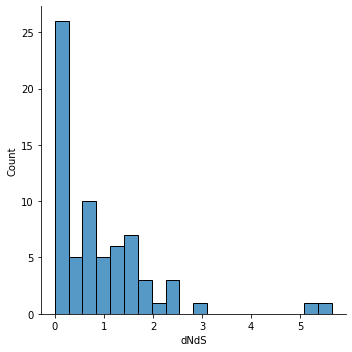

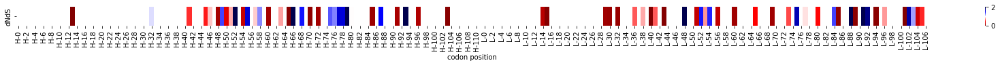

In [366]:
sns.displot(df_dNdS, x="dNdS", bins=20)
plt.savefig("output/plots/dNdS_histogram.pdf")
plt.show()

# plt.figure(figsize=(30, 4))
# g = sns.barplot(data=df_dNdS, x="codon position", y="dNdS", hue="chain")
# for item in g.get_xticklabels():
#     item.set_rotation(90)
# plt.axhline(0)
# plt.axhline(1)
# plt.savefig("output/plots/dNdS.pdf")
# plt.show()

plt.figure(figsize=(30, 0.5))
sns.heatmap(df_dNdS.dNdS.to_frame().T, center=1, vmin=0, vmax=2, cmap="seismic_r")
for item in g.get_xticklabels():
    item.set_rotation(90)
plt.savefig("output/plots/dNdS.pdf")
plt.show()

In [334]:
sum(df_dNdS.n_S >= n_thresh) / len(df_dNdS)

0.2922374429223744

In [346]:
pa = ProteinAnalysis("Q")
pa.gravy()

-3.5